In [1]:
import os
os.chdir("./..")

In [66]:
from numpy import logical_and as l_and, logical_not as l_not

In [2]:
import cv2
import numpy as np
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.metrics import confusion_matrix
from src.utils.metrics import precision, sentitivity, specificity, accuracy, f1_score, dice_score ,calculate_metrics_multiclass_segmentation
from src.utils.images import count_pixels

from src.utils.metrics import calculate_metrics_multiclass_segmentation

# Semantic segmentation

In [10]:
root_gt = "/home/carlos/Documentos/proyectos/breast_cancer/Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/masks/"
root= "/home/carlos/Documentos/proyectos/breast_cancer/runs/20231117_092137/fold_0/segs/"
patients = list(set([x.replace("_seg.png","").replace("_seg_postprocessed.png","") for x in sorted(os.listdir(root))]))

gt_class = []
pred_class = []
dices = []
for n, p in enumerate(patients):
#     if p != 'malignant_120':
#         continue

    ground_truth = cv2.imread(root_gt + f"{p.split('_')[0]}_id_{p.split('_')[1]}_mask.png", 0)
    if p.split('_')[0] == 'malignant':
        ground_truth[ground_truth >= 254] = 2
    else:
        ground_truth[ground_truth >= 254] = 1
#     print(count_pixels(ground_truth))
#     print(p.split('_')[0])
    mask_preprocessed = cv2.imread(root + f"{p}_seg.png", 0)
    mask_postprocessed = cv2.imread(root + f"{p}_seg_postprocessed.png", 0)
    
    counter = count_pixels(mask_postprocessed)
    label1, label2 = counter.get(1, 0), counter.get(2, 0)
    gt_class.append(0 if p.split("_")[0] == 'benign' else 1)
    pred_class.append(0 if label1 > label2 else 1)
    
    dice_pre = calculate_metrics_multiclass_segmentation(ground_truth, mask_preprocessed, 'A')['DICE']
    dice = calculate_metrics_multiclass_segmentation(ground_truth, mask_postprocessed, 'A')['DICE']
    dices.append(dice)
    print(f"DICE for patient {p}: PRE -> {round(dice_pre, 3)} \tPRO -> {round(dice,3)}")
    # Create a custom colormap with black, green, and red colors
    cmap = colors.ListedColormap(['black', 'green', 'red'])
    bounds = [0, 1, 2, 3]
    norm = colors.BoundaryNorm(bounds, cmap.N)

    # Create a figure and subplots
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 10))


    # Plot first subplot
    axs[0].imshow(mask_preprocessed, cmap=cmap, norm=norm)
    axs[0].set_title('Mask preprocessed', fontsize=22)

    # Plot second subplot
    axs[1].imshow(mask_postprocessed, cmap=cmap, norm=norm)
    axs[1].set_title('Mask postprocessed', fontsize=22)
    

    axs[2].imshow(ground_truth, cmap=cmap, norm=norm)
    axs[2].set_title('Ground Truth', fontsize=22)

    # Adjust spacing between subplots
    plt.tight_layout()

    # Display the plot
    plt.show()

[ WARN:0@8022.807] global loadsave.cpp:244 findDecoder imread_('/home/carlos/Documentos/proyectos/breast_cancer/runs/20231117_092137/fold_0/segs/benign_344_seg_postprocessed.png'): can't open/read file: check file path/integrity


AttributeError: 'NoneType' object has no attribute 'shape'

In [6]:
cm = confusion_matrix(y_true=np.array(gt_class), y_pred=np.array(pred_class))

tn, fp, fn, tp = cm.ravel()

print(f"Precision: {precision(tp, fp)}")
print(f"Sensitivity: {sentitivity(tp, fn)}")
print(f"Specificity: {specificity(tn, fp)}")
print(f"Accuracy: {accuracy(tp, tn, fp, fn)}")
print(f"F1 score: {f1_score(tp, fp, fn)}")

print(f"DICE: {np.mean(dices)}")

Precision: 0.723404255319149
Sensitivity: 0.8292682926829268
Specificity: 0.7678571428571429
Accuracy: 0.7938144329896907
F1 score: 0.7727272727272727
DICE: 0.7054203771662741


## DICE by class

In [3]:
df = []
for fold in range(4):
    root_gt = "/home/carlos/Documentos/proyectos/breast_cancer/Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/masks/"
    root= f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20231117_095421/fold_{fold}/segs/"
    patients = list(set([x.replace("_seg.png","").replace("_seg_postprocessed.png","") for x in sorted(os.listdir(root))]))

    metrics = []
    for n, p in enumerate(patients):
    #     if n > 45:
    #         break
        mask = cv2.imread(root + f"{p}_seg.png", 0)
        ground_truth = cv2.imread(root_gt + f"{p.split('_')[0]}_id_{p.split('_')[1]}_mask.png", 0)
        if p.split('_')[0] == 'malignant':
            ground_truth[ground_truth >= 254] = 2
        else:
            ground_truth[ground_truth >= 254] = 1


        metrics.append(calculate_metrics_multiclass_segmentation(ground_truth, mask, p, num_classes=3, skip_background=False, averaging=False))
        

    DICE, Sensitivity, Specificity, Accuracy, Jaccard, Precision = [], [], [], [], [], []
    for record in metrics:
        DICE.append(record['DICE'])
        Sensitivity.append(record['Sensitivity'])
        Specificity.append(record['Specificity'])
        Accuracy.append(record['Accuracy'])
        Jaccard.append(record['Jaccard index'])
        Precision.append(record['Precision'])

    DICE = np.mean(np.array(DICE), axis=0)
    Sensitivity = np.nanmean(np.array(Sensitivity), axis=0)
    Specificity = np.nanmean(np.array(Specificity), axis=0)
    Accuracy = np.nanmean(np.array(Accuracy), axis=0)
    Jaccard = np.nanmean(np.array(Jaccard), axis=0)
    Precision = np.nanmean(np.array(Precision), axis=0)

    df.append(pd.DataFrame({
        'DICE': DICE, 
        'Sensitivity': Sensitivity,
        'Specificity': Specificity,
        'Accuracy': Accuracy,
        'Jaccard': Jaccard,
        'Precision': Precision,
        'class': ["background", "benign", "malignant"],
        'fold': [fold, fold, fold]
    }))

df = pd.concat(df)

In [4]:
grouped_results = df.groupby(["fold","class"]).mean().reset_index()
grouped_results = df.groupby(["class"]).mean().reset_index()
grouped_results

,class,DICE,Sensitivity,Specificity,Accuracy,Jaccard,Precision,fold
0,background,0.962978,0.953938,0.721136,0.938069,0.931498,0.974659,1.5
1,benign,0.325500,0.838402,0.975820,0.963633,0.278717,0.702232,1.5
2,malignant,0.213133,0.658015,0.966486,0.947750,0.175954,0.702319,1.5


In [6]:
round(df.mean(), 3).reset_index()

/tmp/ipykernel_48121/2715544465.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  round(df.mean(), 3).reset_index()


,index,0
0,DICE,0.501
1,Sensitivity,0.817
2,Specificity,0.888
3,Accuracy,0.950
4,Jaccard,0.462
5,Precision,0.793
6,fold,1.500


In [5]:
round(grouped_results, 3).sort_values('class').T

,0,1,2
class,background,benign,malignant
DICE,0.963,0.326,0.213
Sensitivity,0.954,0.838,0.658
Specificity,0.721,0.976,0.966
Accuracy,0.938,0.964,0.948
Jaccard,0.931,0.279,0.176
Precision,0.975,0.702,0.702
fold,1.5,1.5,1.5


# Multi-task learning: segmentation + classification

In [8]:
root = "/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/20230418_010705_Muli_FBSBTSUNET_24_alpha_0.7_batch_2/fold_0/segs/"

In [9]:
from numpy import logical_and as l_and, logical_not as l_not
dices = []
for n, p in enumerate(os.listdir(root)):
#     if p != 'malignant_120':
#         continue

    gt = cv2.imread(root_gt + f"{p.split('_')[0]}_id_{p.split('_')[1]}_mask.png", 0)
    seg = cv2.imread(root + f"/{p}", 0)

    tp = float(np.sum(l_and(seg, gt)))
    tn = float(np.sum(l_and(l_not(seg), l_not(gt))))
    fp = float(np.sum(l_and(seg, l_not(gt))))
    fn = float(np.sum(l_and(l_not(seg), gt)))
    dice =  dice_score(tp, fp, fn, gt, seg)
    dices.append(dice)
    print(f"DICE for patient {p}: {round(dice, 3)} ")

    # Create a figure and subplots
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 8))

    # Plot second subplot
    axs[0].imshow(seg, cmap=cmap, norm=norm)
    axs[0].set_title('Mask', fontsize=22)
    

    axs[1].imshow(gt, cmap=cmap, norm=norm)
    axs[1].set_title('Ground Truth', fontsize=22)

    # Adjust spacing between subplots
    plt.tight_layout()

    # Display the plot
    plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/20230418_010705_Muli_FBSBTSUNET_24_alpha_0.7_batch_2/fold_0/segs/'

In [5]:
print(f"DICE: {np.mean(dices)}")

DICE: nan


/home/carlos/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/carlos/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


## all images

DICE for patient malignant_170_seg.png: 0.92 


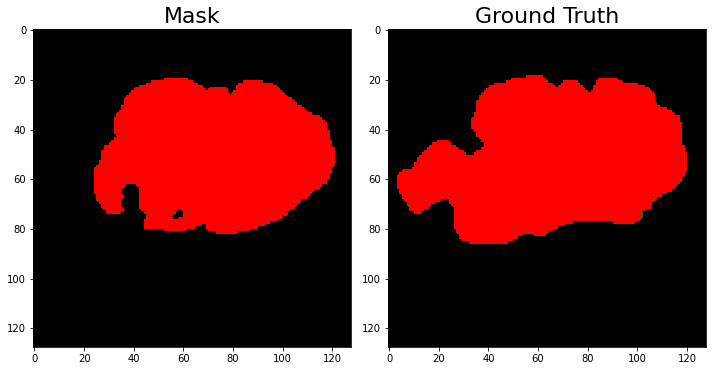

DICE for patient malignant_49_seg.png: 0.884 


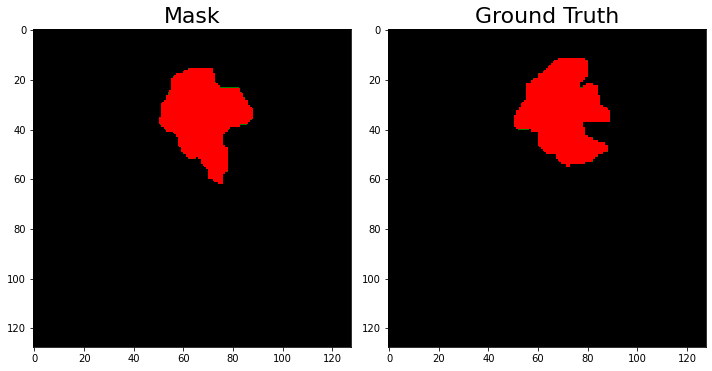

DICE for patient benign_75_seg.png: 0.831 


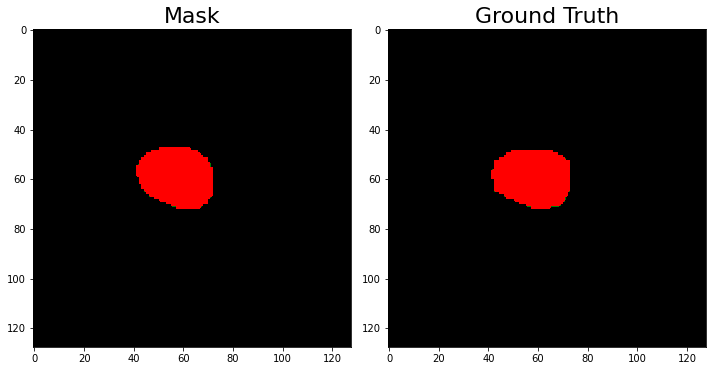

DICE for patient benign_193_seg.png: 0.954 


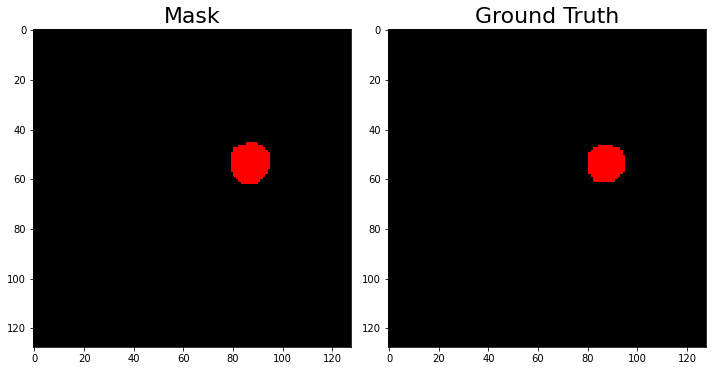

DICE for patient malignant_43_seg.png: 0.921 


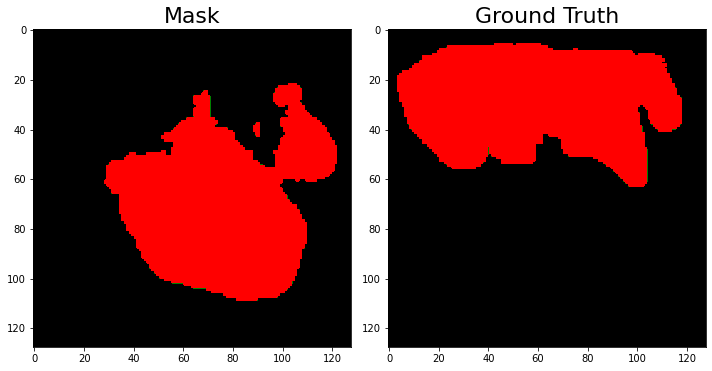

DICE for patient benign_364_seg.png: 0.151 


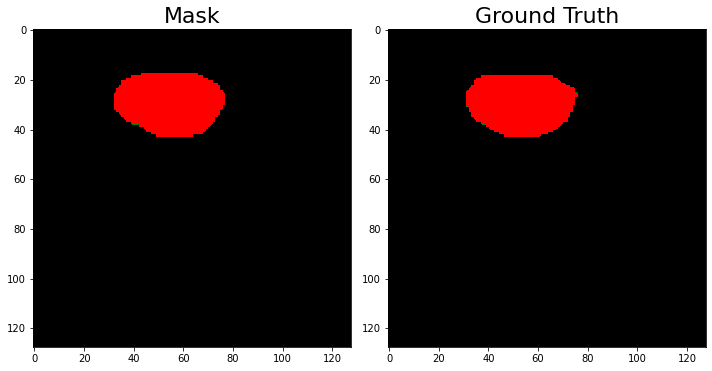

DICE for patient malignant_160_seg.png: 0.937 


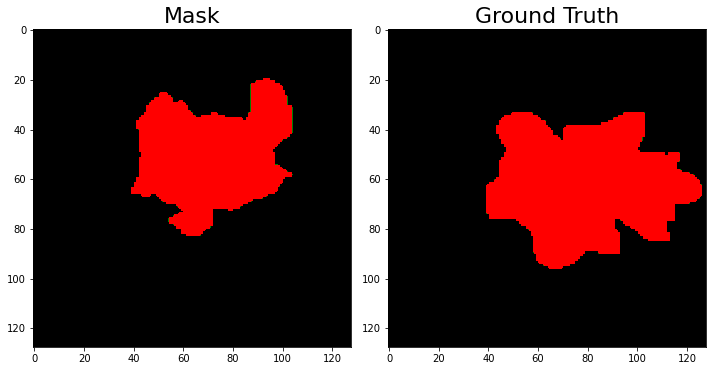

DICE for patient benign_23_seg.png: 0.66 


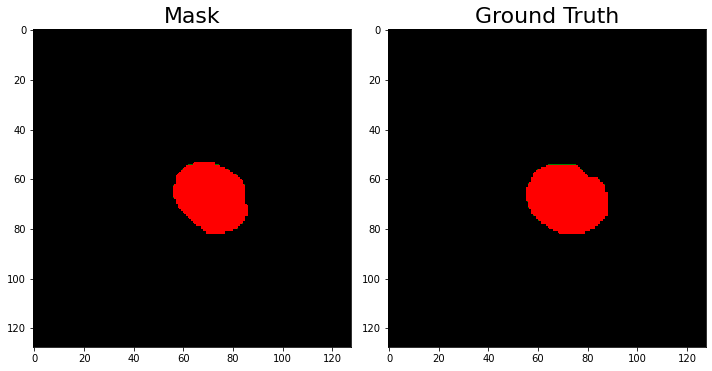

DICE for patient benign_29_seg.png: 0.925 


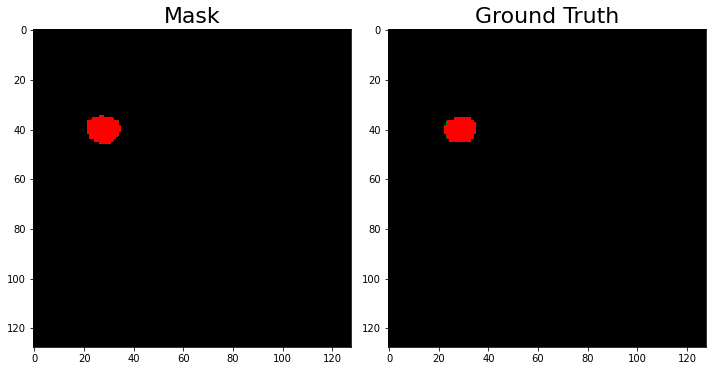

DICE for patient benign_390_seg.png: 0.887 


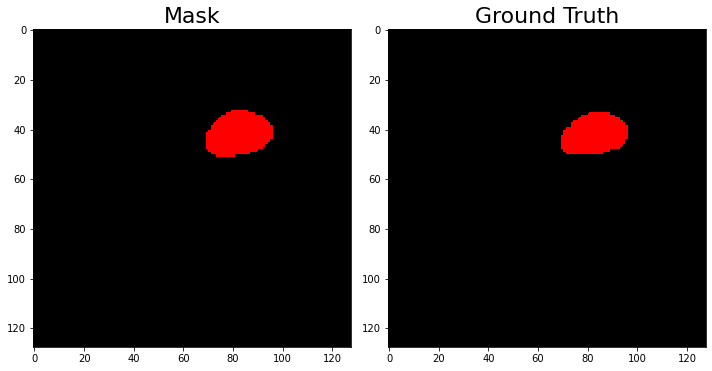

DICE for patient malignant_157_seg.png: 0.954 


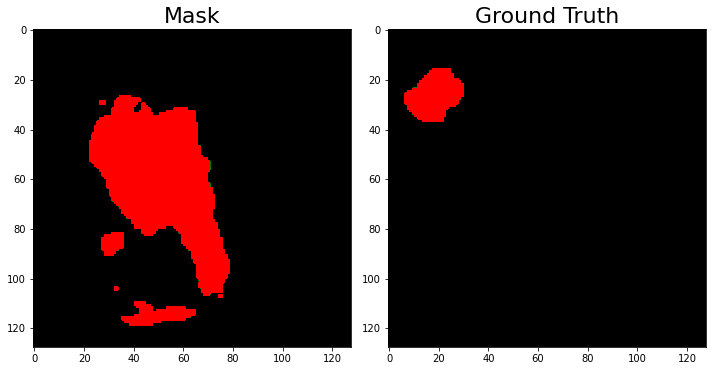

DICE for patient benign_34_seg.png: 0.001 


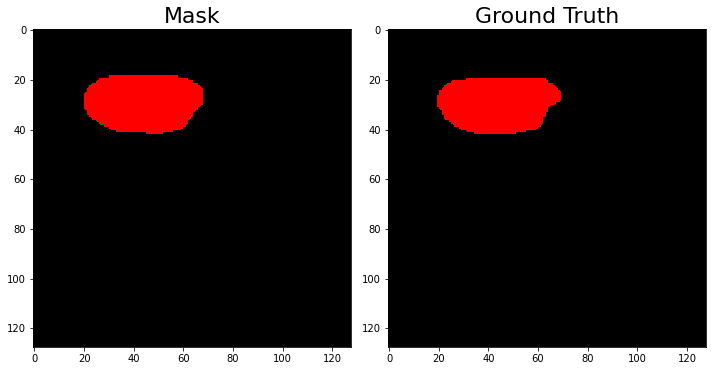

DICE for patient malignant_1_seg.png: 0.958 


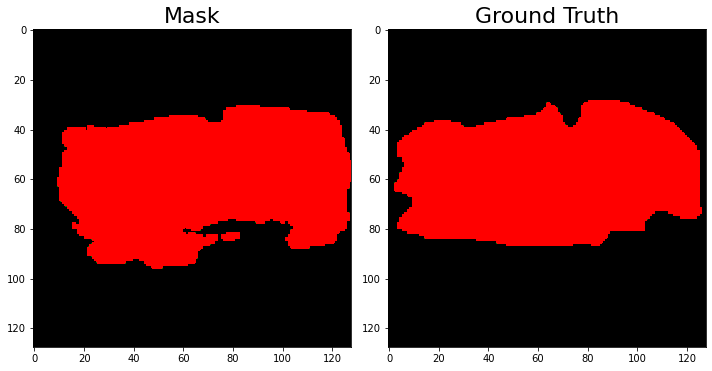

DICE for patient benign_26_seg.png: 0.874 


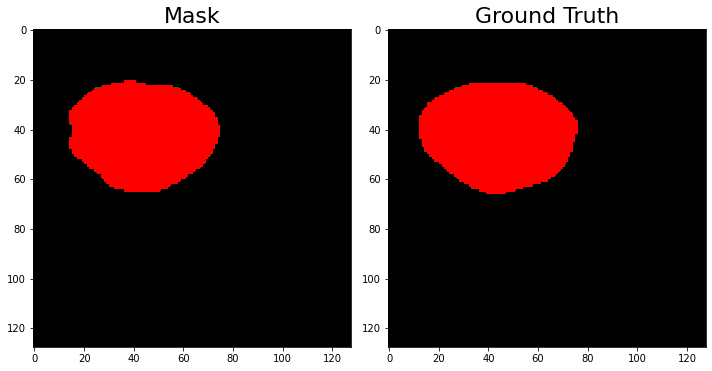

DICE for patient benign_101_seg.png: 0.964 


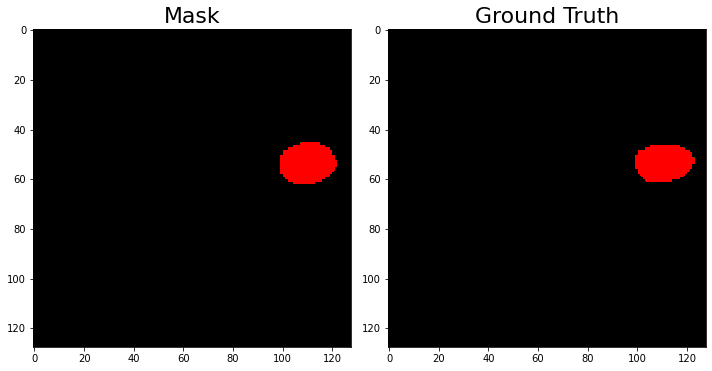

DICE for patient benign_350_seg.png: 0.94 


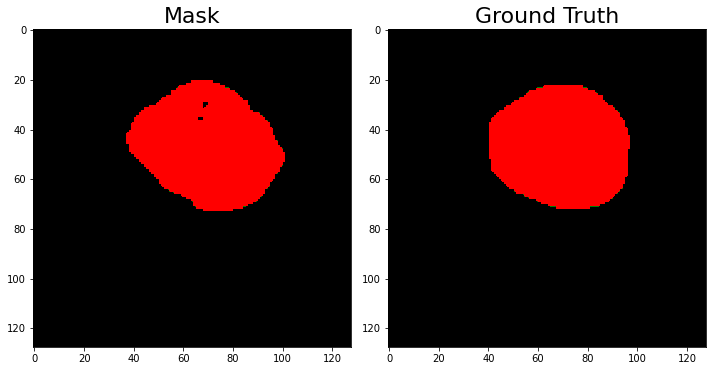

DICE for patient benign_168_seg.png: 0.941 


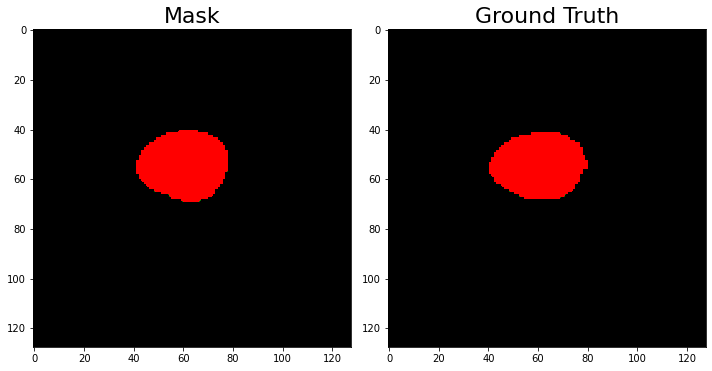

DICE for patient malignant_168_seg.png: 0.967 


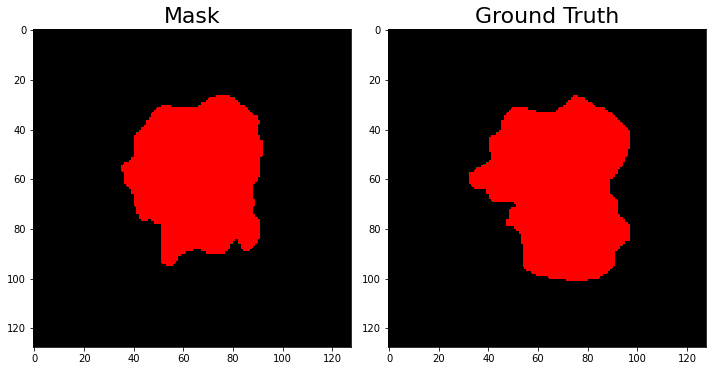

DICE for patient benign_104_seg.png: 0.868 


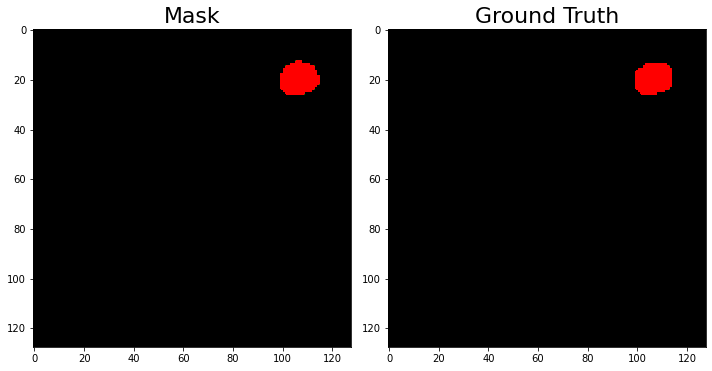

DICE for patient benign_344_seg.png: 0.962 


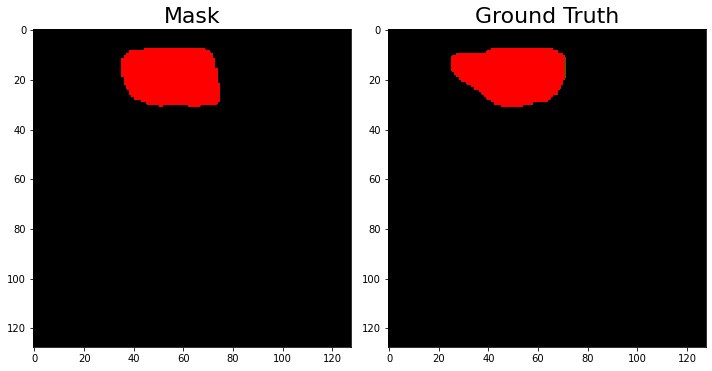

DICE for patient benign_111_seg.png: 0.842 


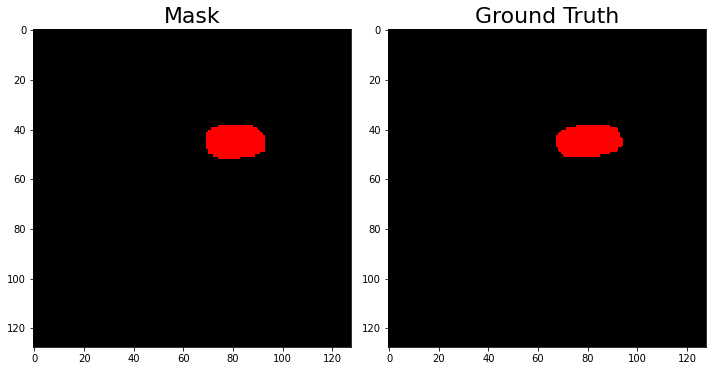

DICE for patient benign_56_seg.png: 0.92 


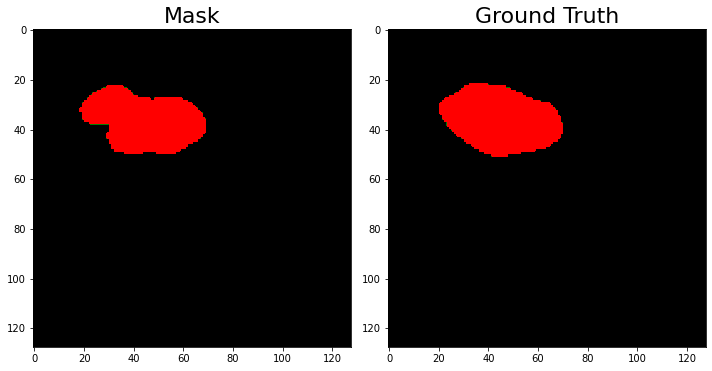

DICE for patient malignant_11_seg.png: 0.91 


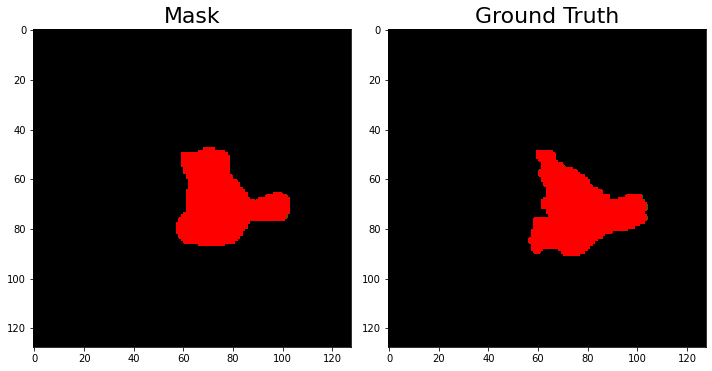

DICE for patient malignant_90_seg.png: 0.848 


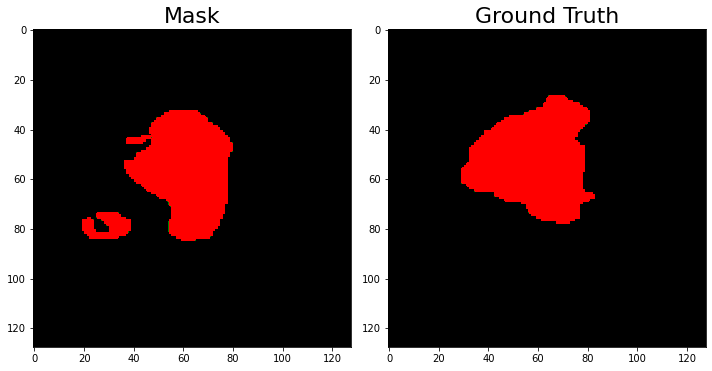

DICE for patient benign_358_seg.png: 0.782 


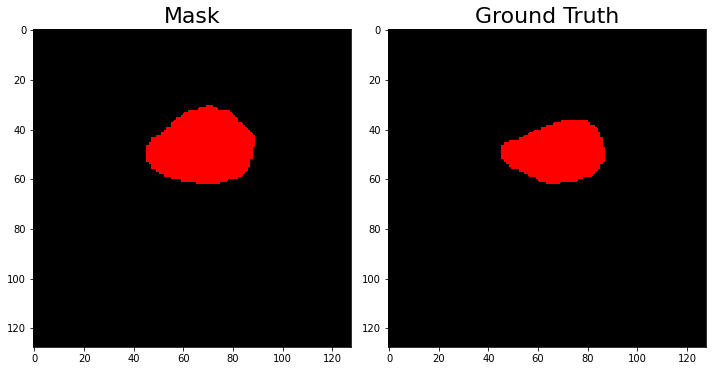

DICE for patient malignant_131_seg.png: 0.864 


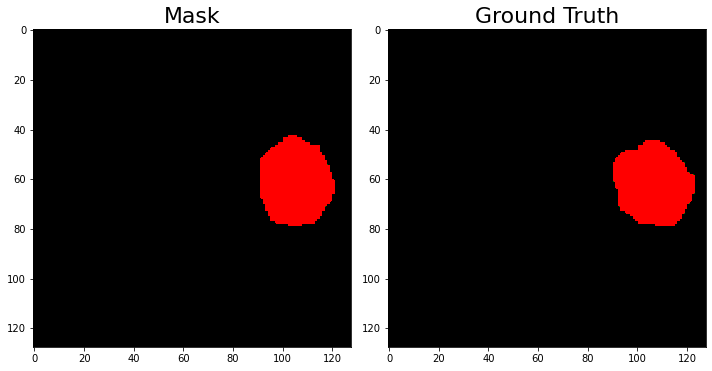

DICE for patient benign_48_seg.png: 0.926 


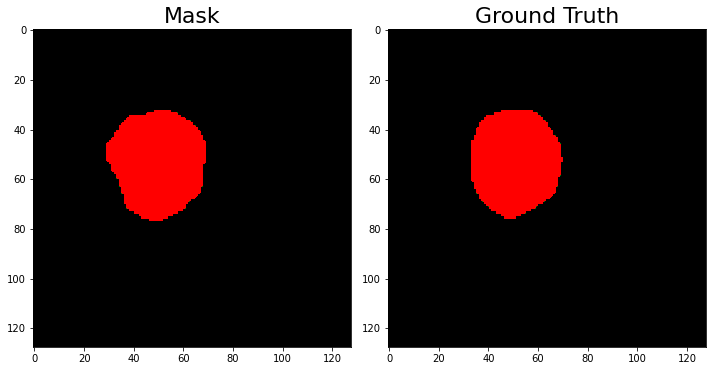

DICE for patient benign_403_seg.png: 0.949 


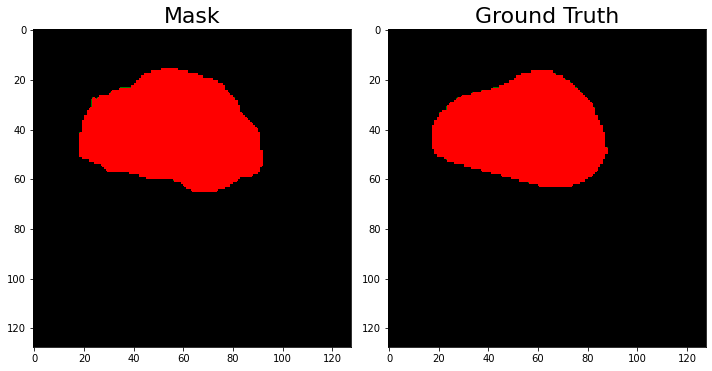

DICE for patient malignant_132_seg.png: 0.936 


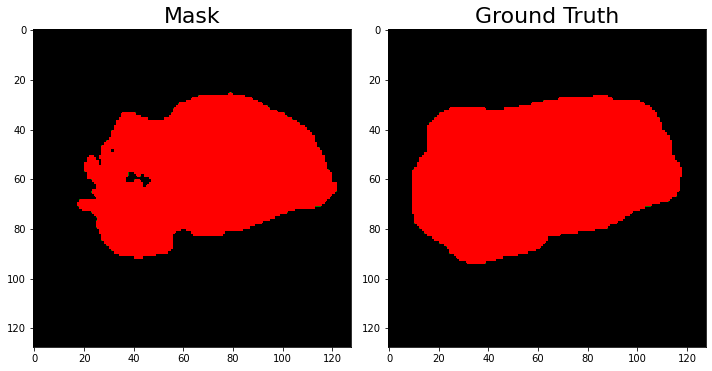

DICE for patient malignant_71_seg.png: 0.877 


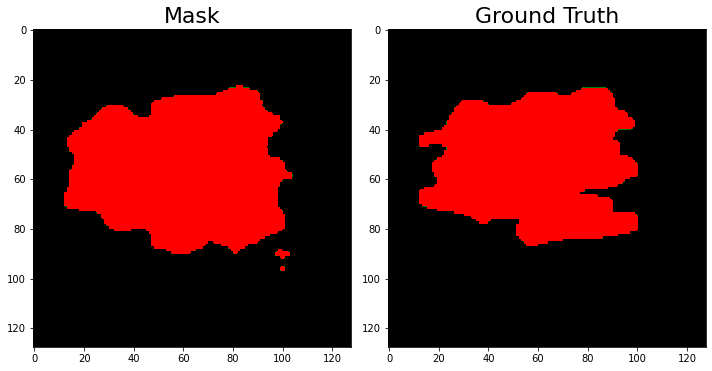

DICE for patient benign_314_seg.png: 0.916 


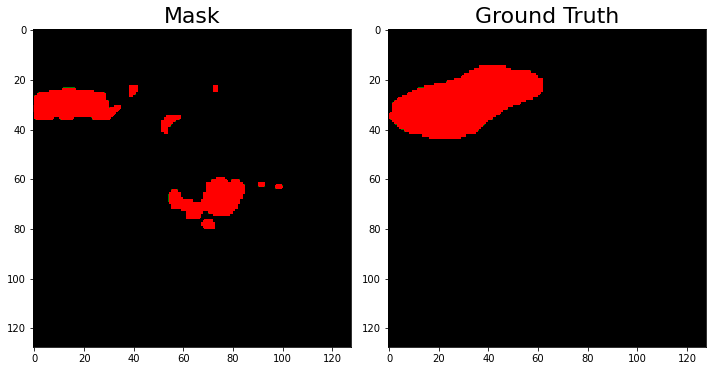

DICE for patient malignant_193_seg.png: 0.35 


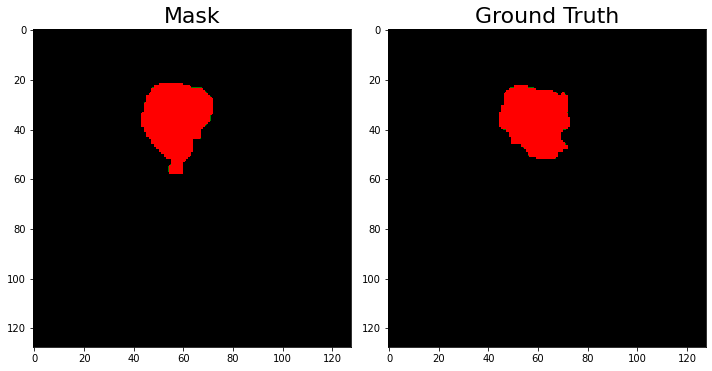

DICE for patient malignant_172_seg.png: 0.842 


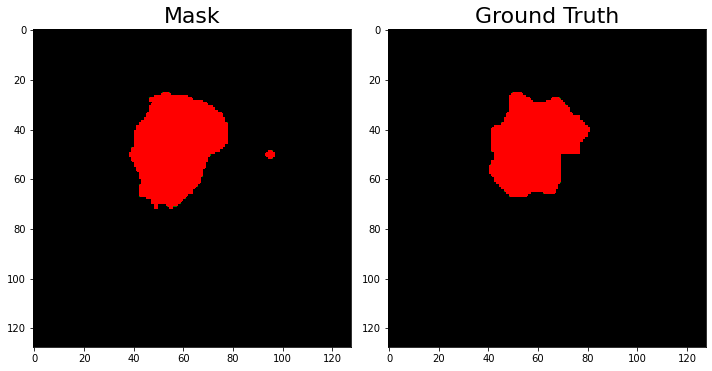

DICE for patient benign_377_seg.png: 0.908 


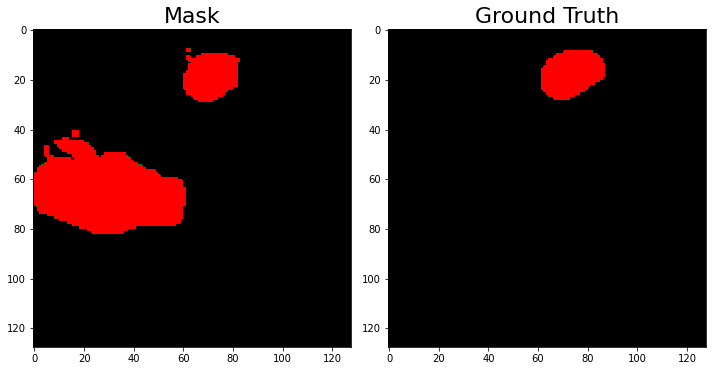

DICE for patient malignant_192_seg.png: 0.266 


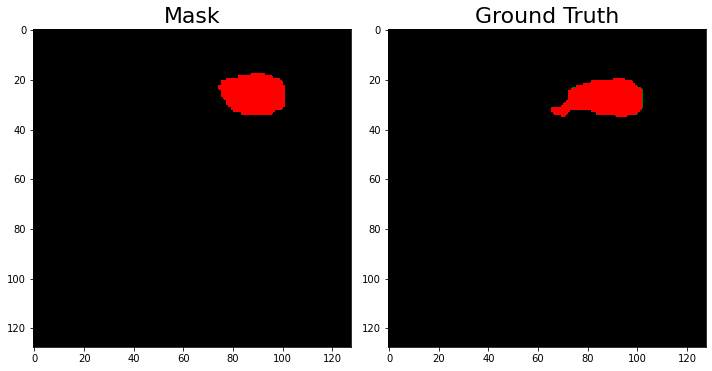

DICE for patient benign_355_seg.png: 0.816 


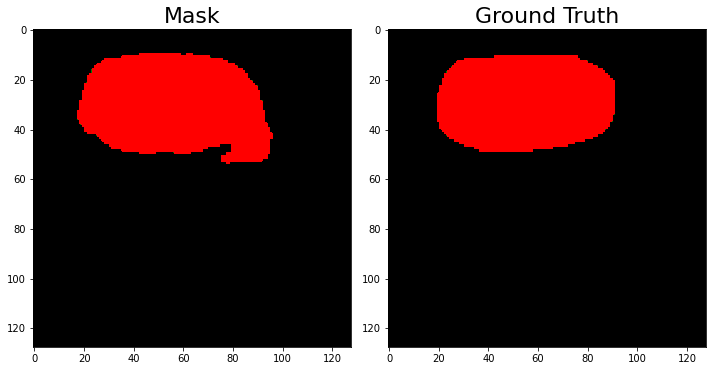

DICE for patient benign_161_seg.png: 0.932 


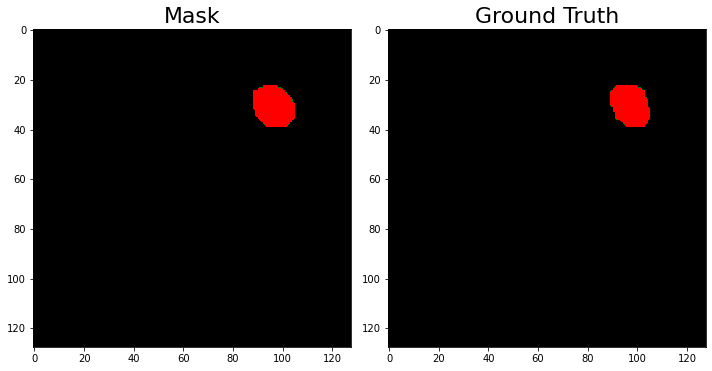

DICE for patient malignant_185_seg.png: 0.919 


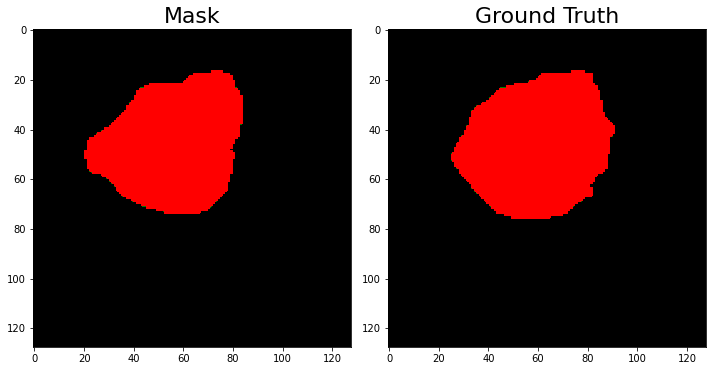

DICE for patient malignant_198_seg.png: 0.91 


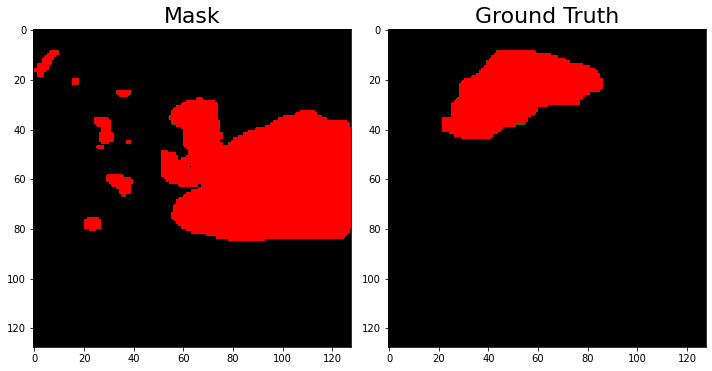

DICE for patient benign_54_seg.png: 0.028 


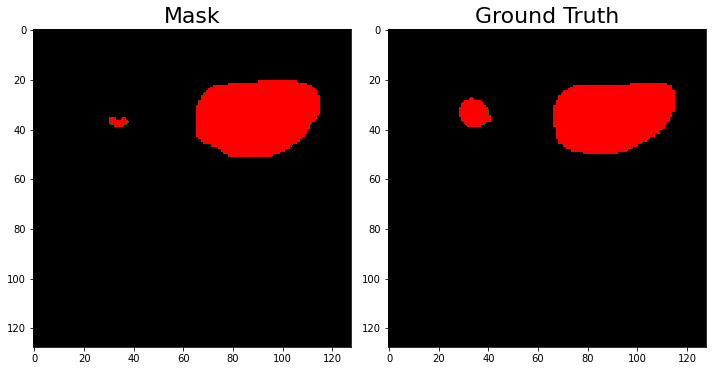

DICE for patient benign_77_seg.png: 0.913 


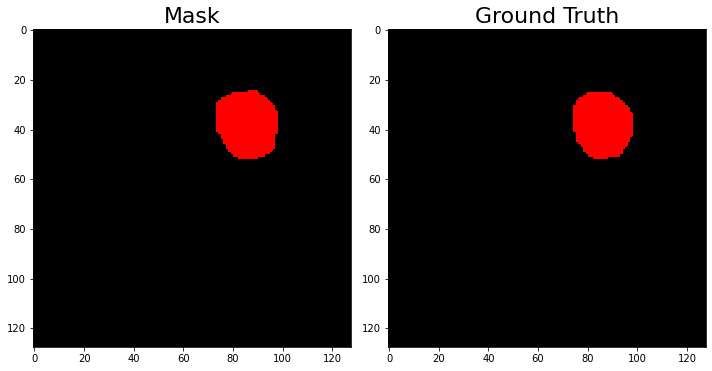

DICE for patient malignant_63_seg.png: 0.961 


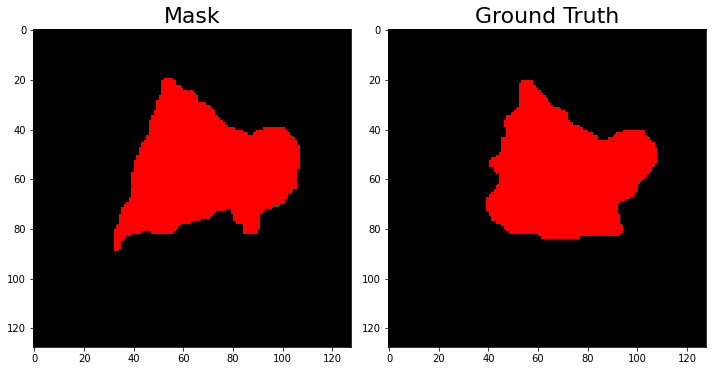

DICE for patient malignant_164_seg.png: 0.888 


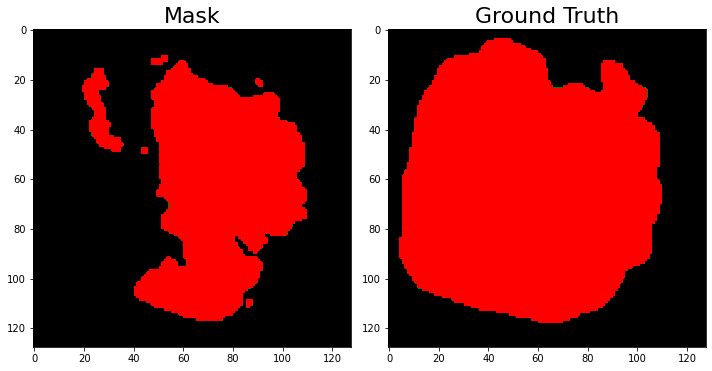

DICE for patient benign_122_seg.png: 0.667 


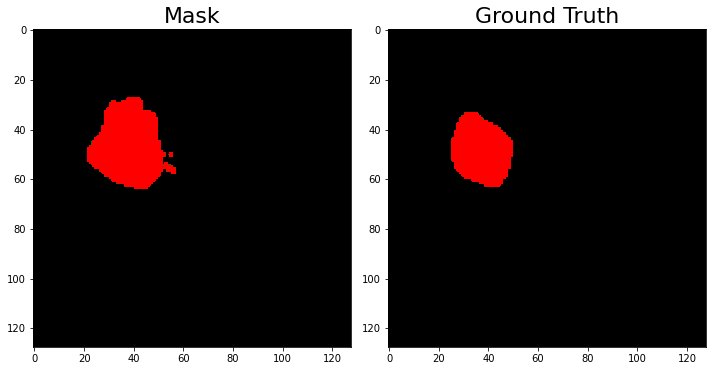

DICE for patient benign_142_seg.png: 0.799 


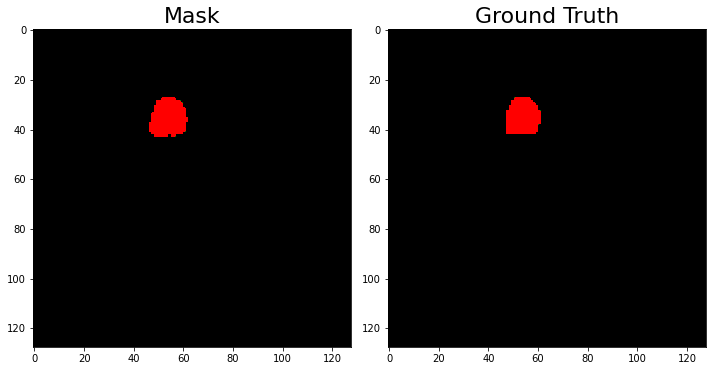

DICE for patient benign_46_seg.png: 0.942 


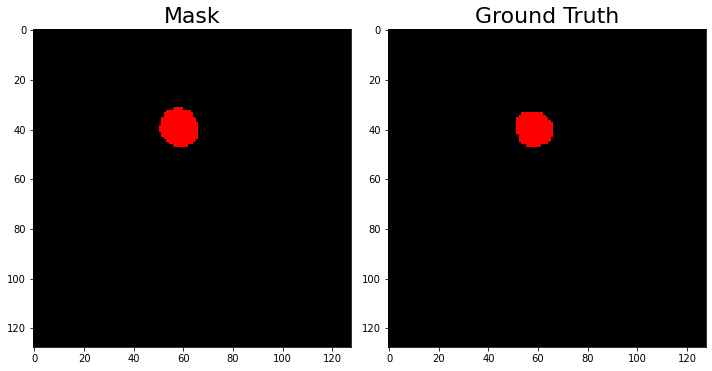

DICE for patient malignant_210_seg.png: 0.922 


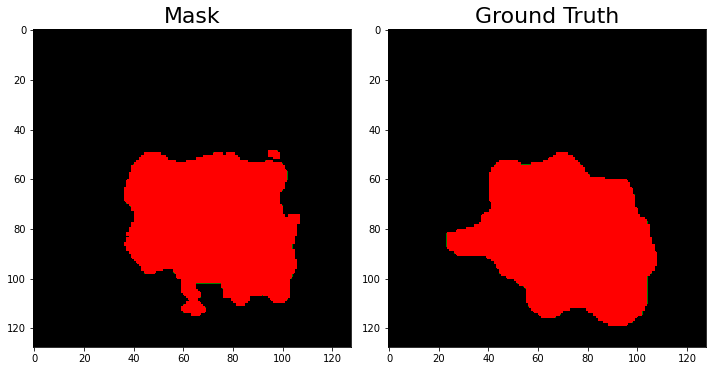

DICE for patient benign_47_seg.png: 0.861 


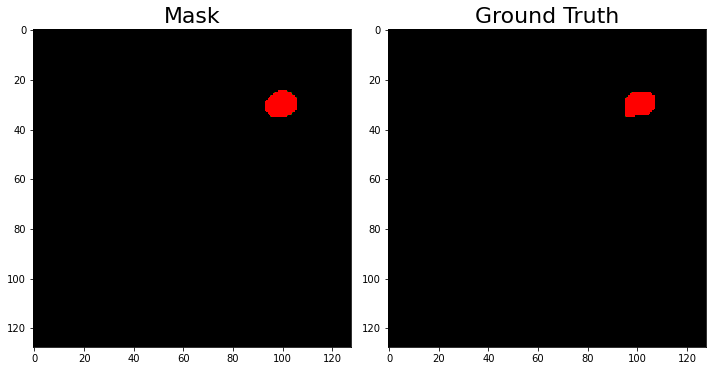

DICE for patient benign_106_seg.png: 0.841 


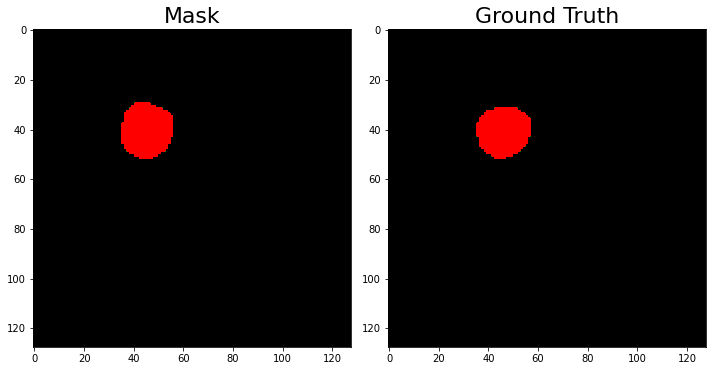

DICE for patient benign_97_seg.png: 0.935 


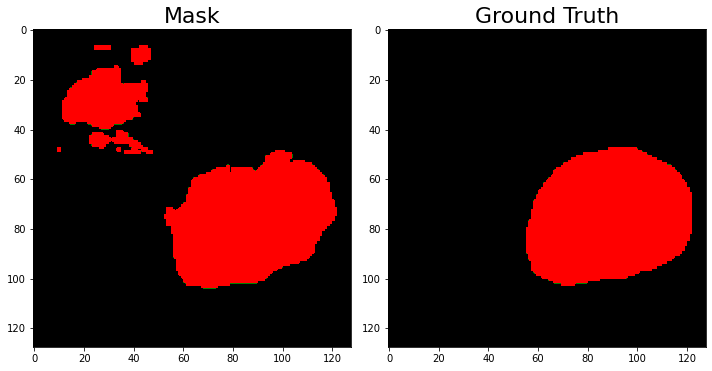

DICE for patient benign_420_seg.png: 0.82 


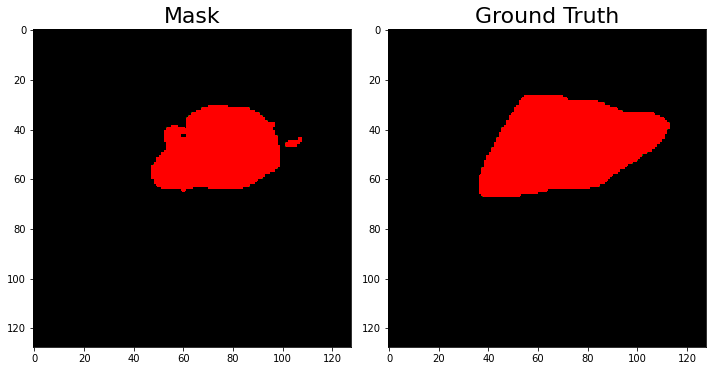

DICE for patient benign_40_seg.png: 0.757 


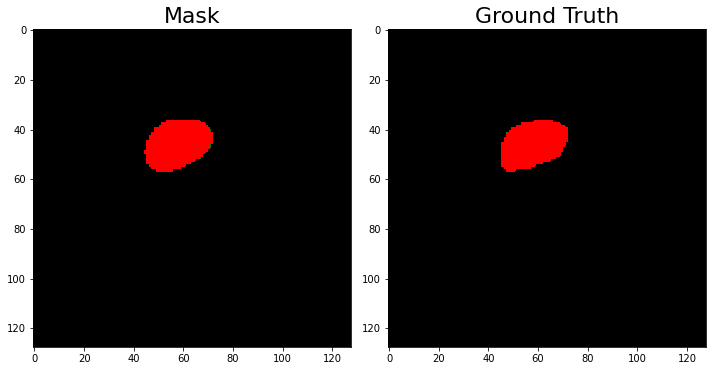

DICE for patient benign_429_seg.png: 0.958 


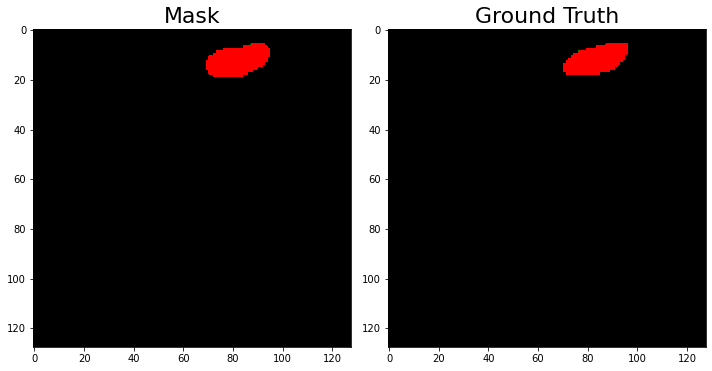

DICE for patient benign_432_seg.png: 0.907 


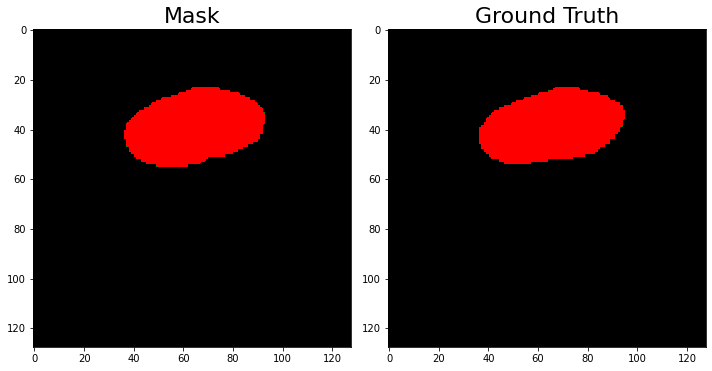

DICE for patient benign_351_seg.png: 0.961 


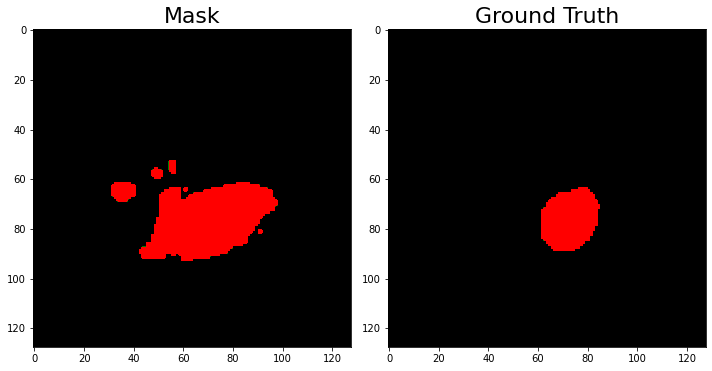

DICE for patient malignant_38_seg.png: 0.54 


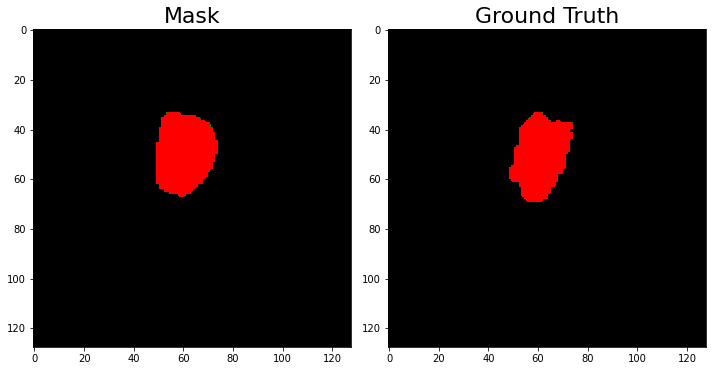

DICE for patient malignant_56_seg.png: 0.891 


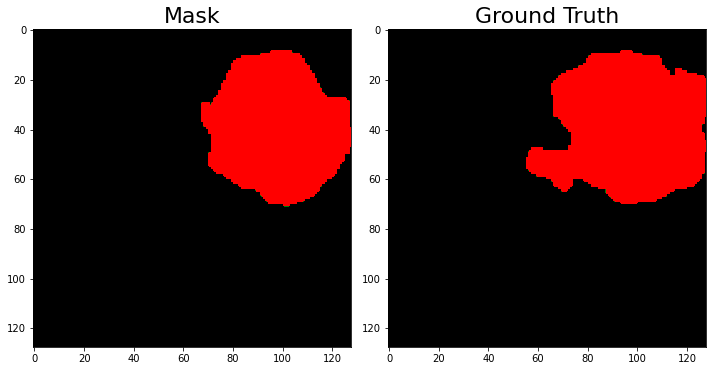

DICE for patient benign_313_seg.png: 0.892 


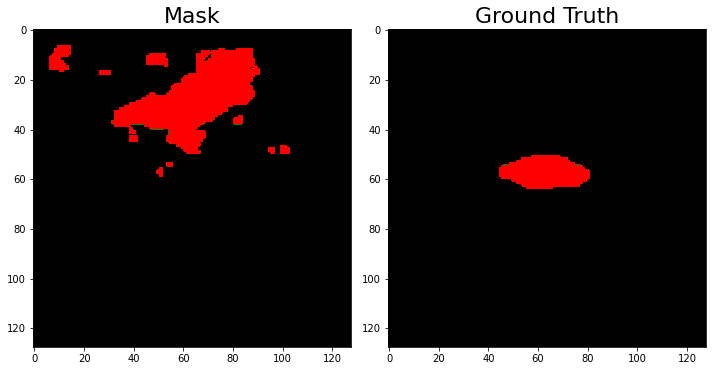

DICE for patient benign_391_seg.png: 0.008 


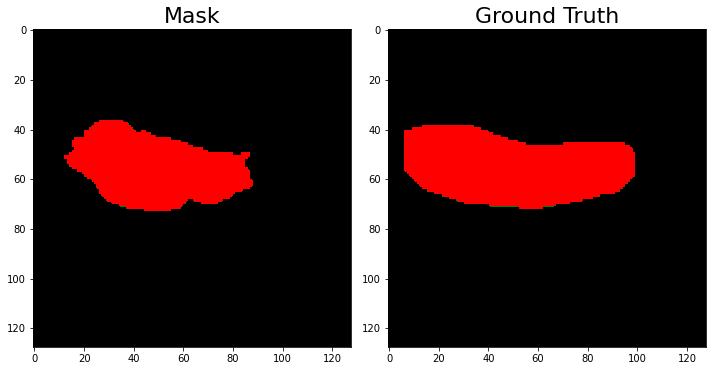

DICE for patient malignant_108_seg.png: 0.816 


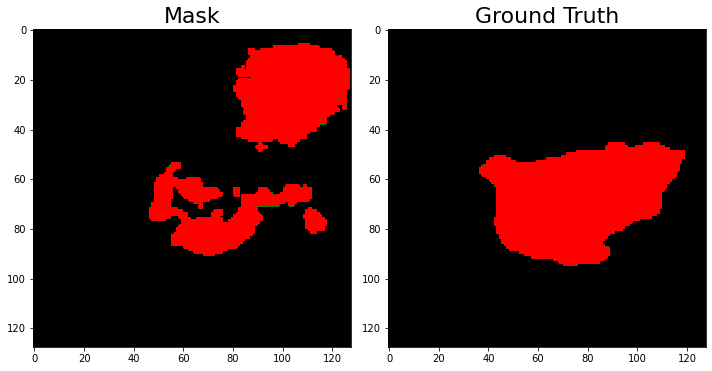

DICE for patient benign_79_seg.png: 0.341 


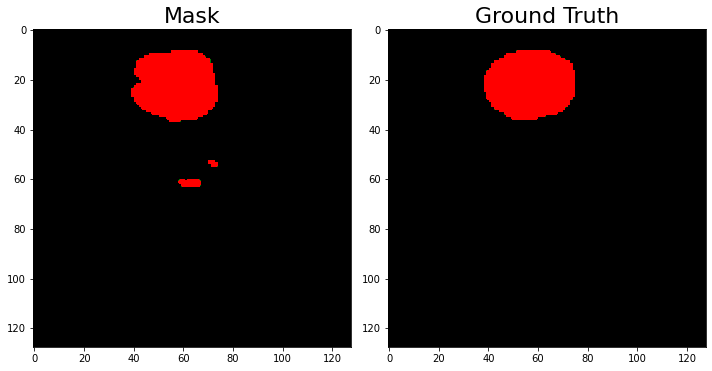

DICE for patient benign_380_seg.png: 0.929 


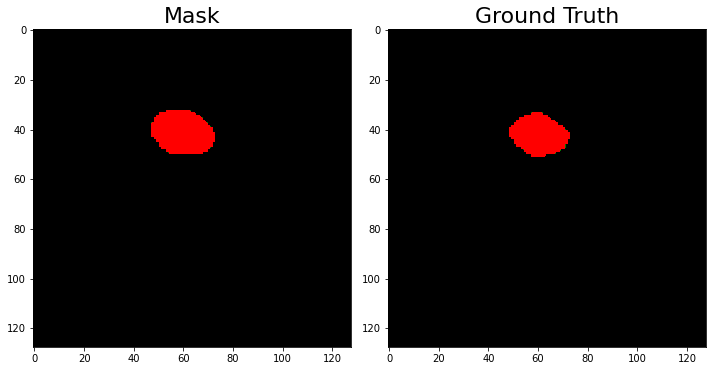

DICE for patient benign_394_seg.png: 0.89 


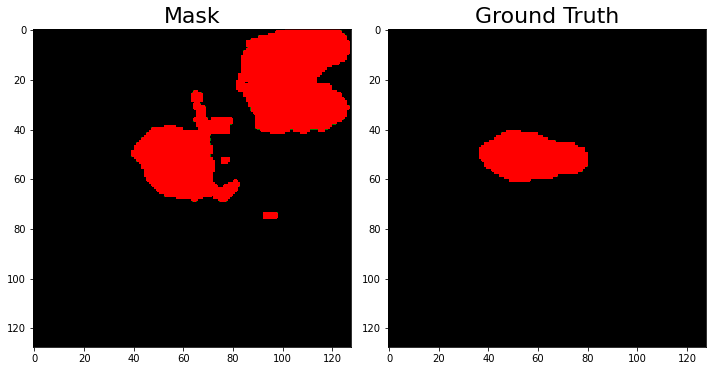

DICE for patient benign_346_seg.png: 0.333 


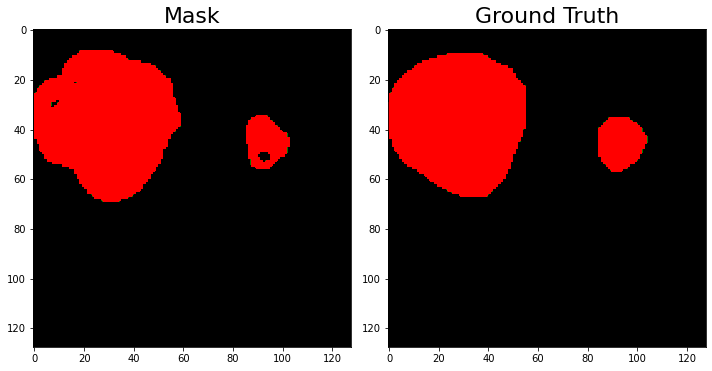

DICE for patient benign_121_seg.png: 0.944 


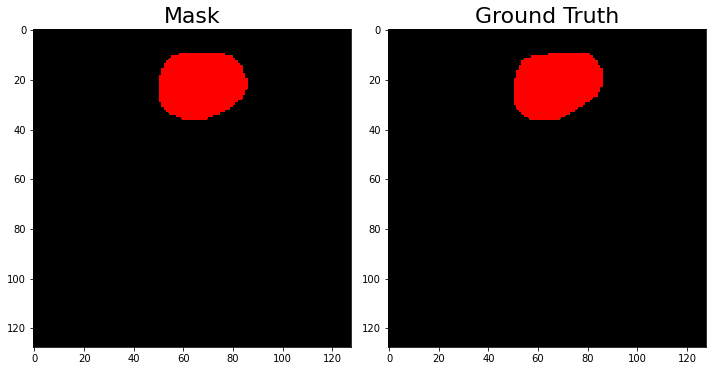

DICE for patient malignant_24_seg.png: 0.962 


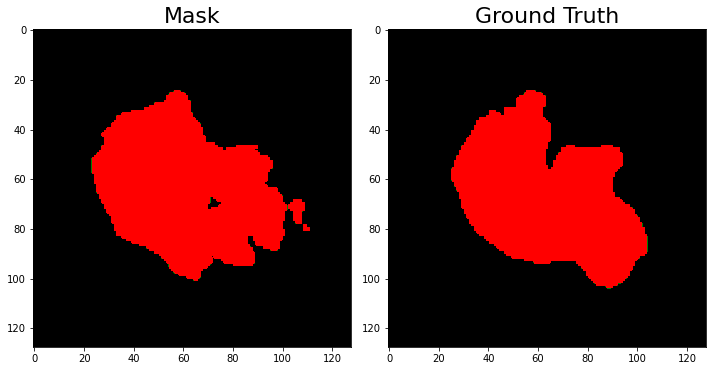

DICE for patient malignant_73_seg.png: 0.889 


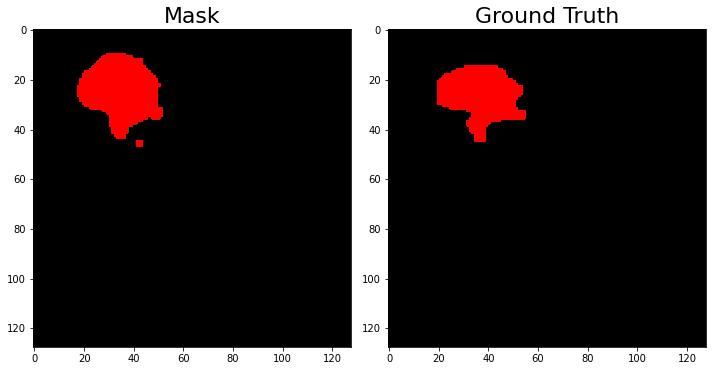

DICE for patient malignant_121_seg.png: 0.856 


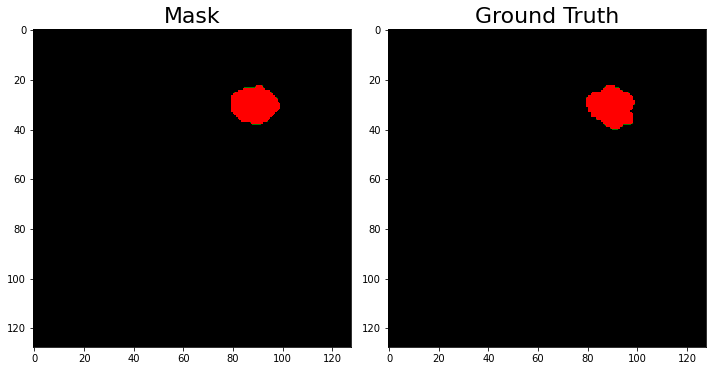

DICE for patient malignant_199_seg.png: 0.885 


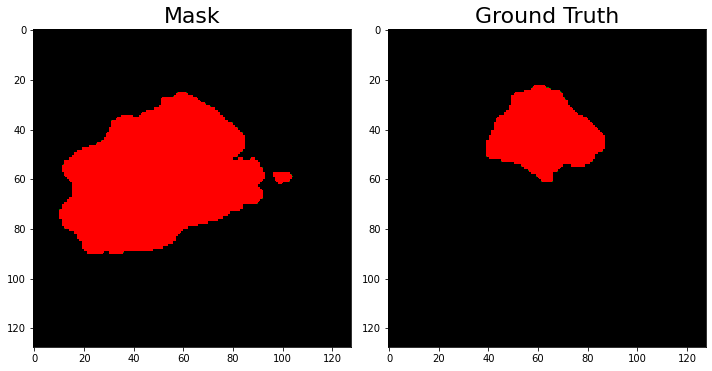

DICE for patient malignant_127_seg.png: 0.428 


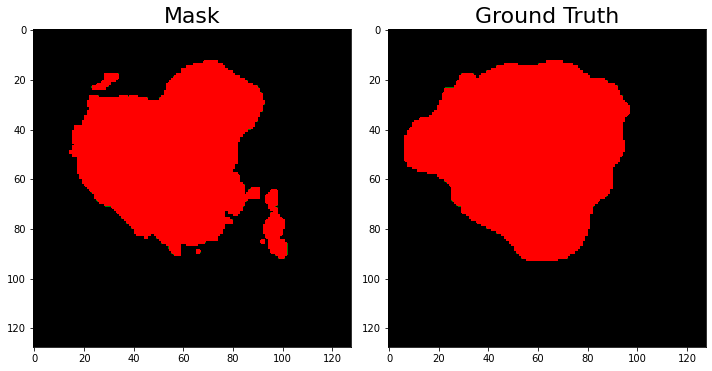

DICE for patient benign_363_seg.png: 0.857 


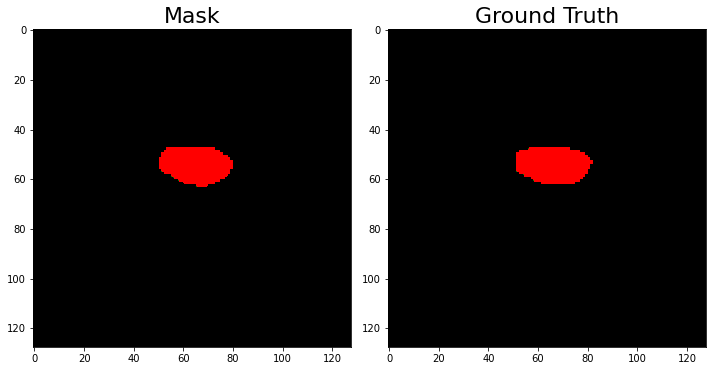

DICE for patient benign_376_seg.png: 0.948 


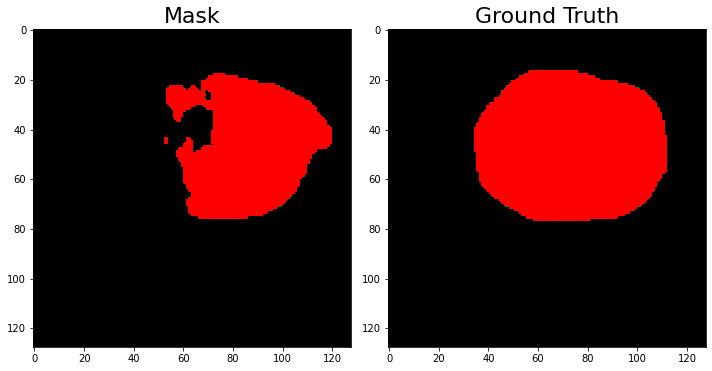

DICE for patient benign_185_seg.png: 0.747 


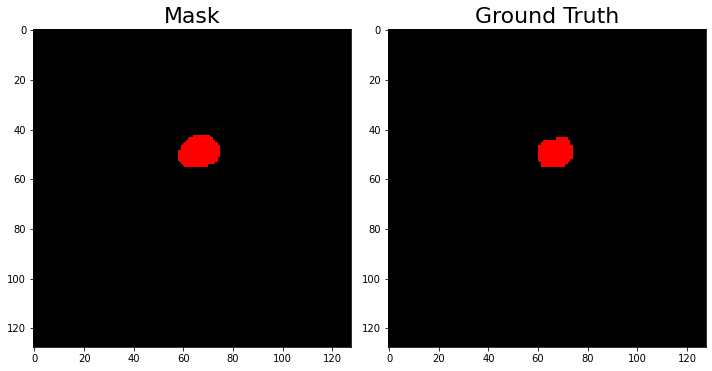

DICE for patient malignant_70_seg.png: 0.876 


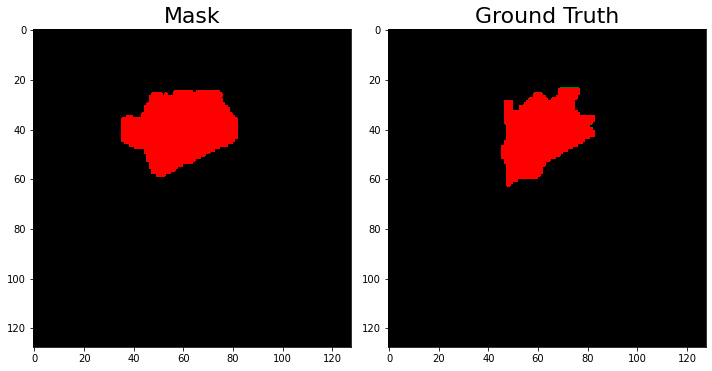

DICE for patient malignant_120_seg.png: 0.834 


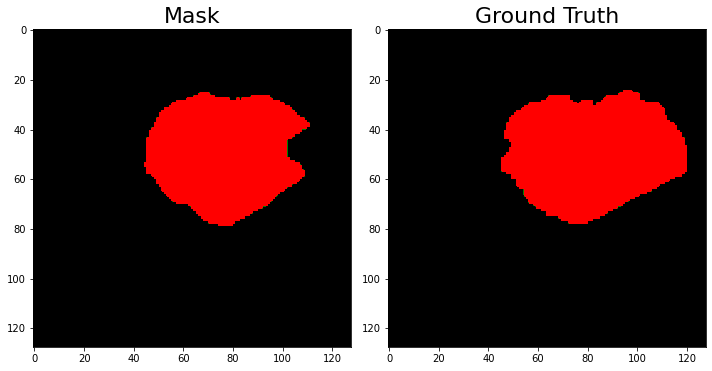

DICE for patient malignant_156_seg.png: 0.903 


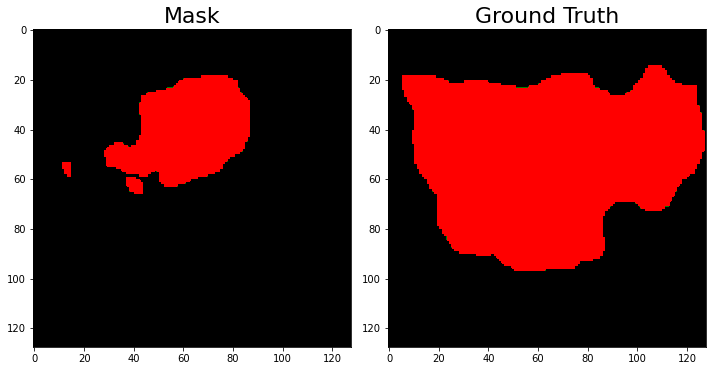

DICE for patient malignant_196_seg.png: 0.387 


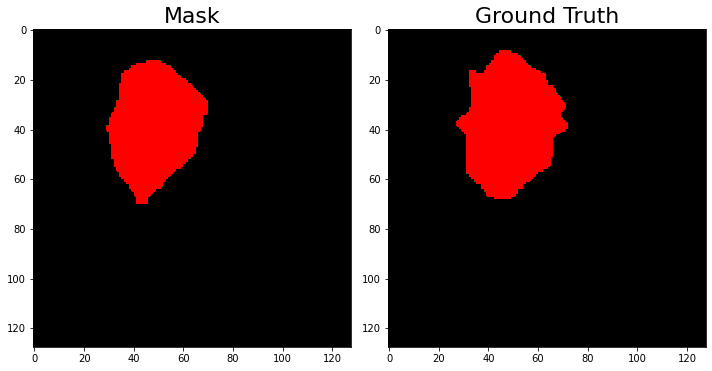

DICE for patient malignant_141_seg.png: 0.923 


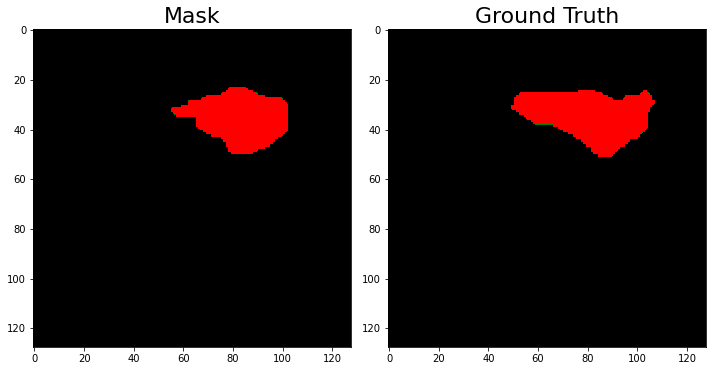

DICE for patient benign_82_seg.png: 0.846 


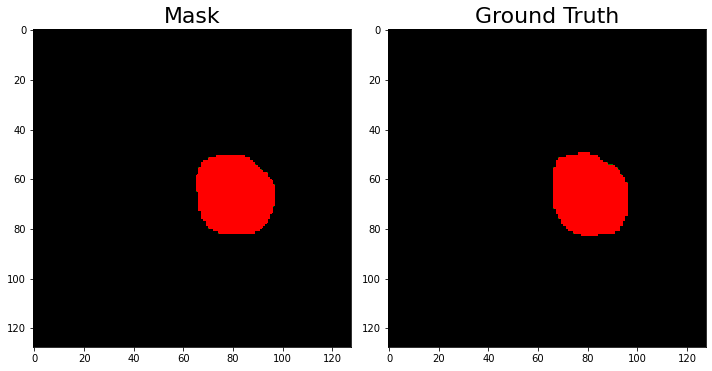

DICE for patient malignant_167_seg.png: 0.966 


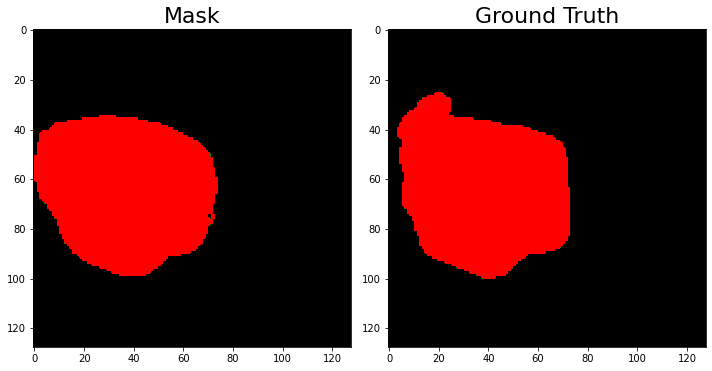

DICE for patient malignant_47_seg.png: 0.944 


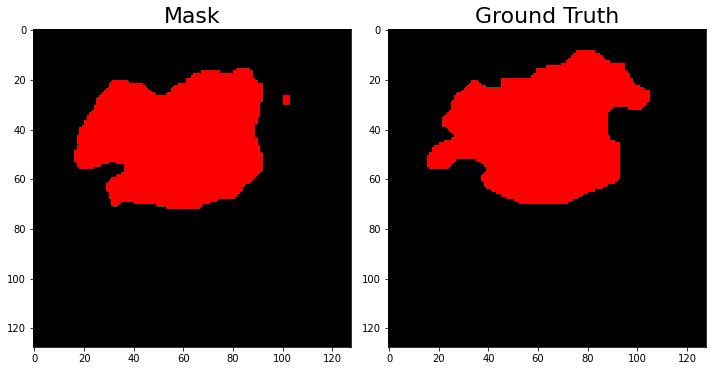

DICE for patient benign_366_seg.png: 0.883 


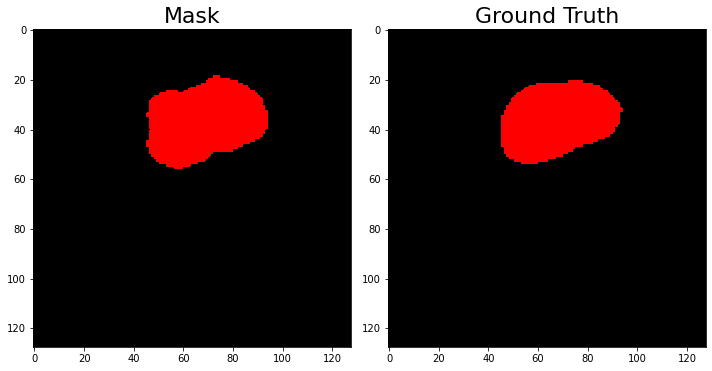

DICE for patient benign_144_seg.png: 0.933 


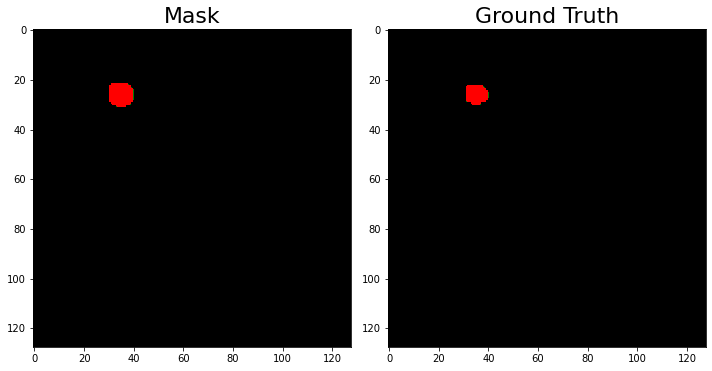

DICE for patient benign_89_seg.png: 0.81 


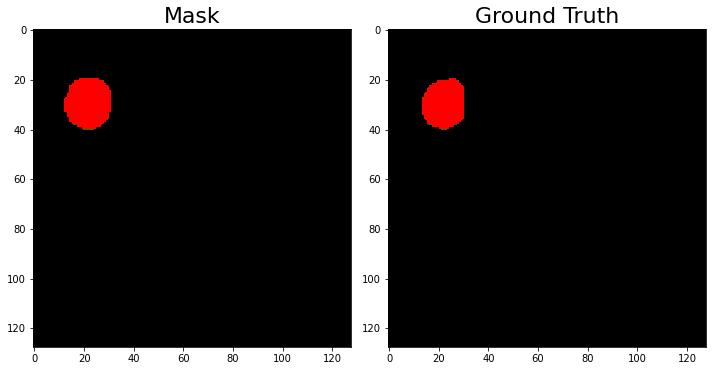

DICE for patient benign_88_seg.png: 0.934 


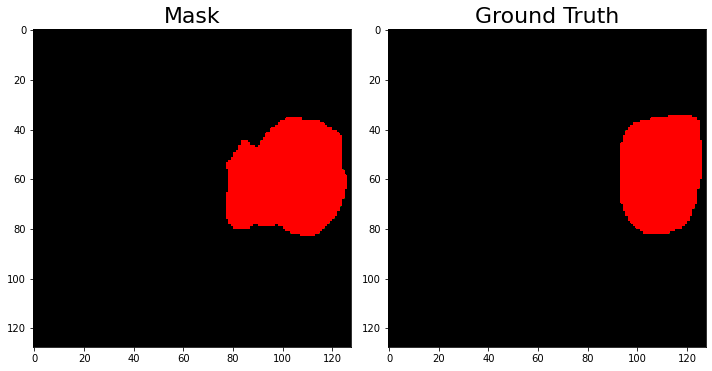

DICE for patient malignant_186_seg.png: 0.793 


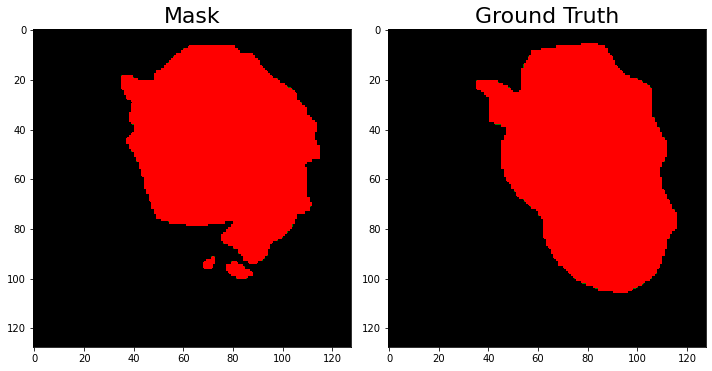

DICE for patient benign_90_seg.png: 0.864 


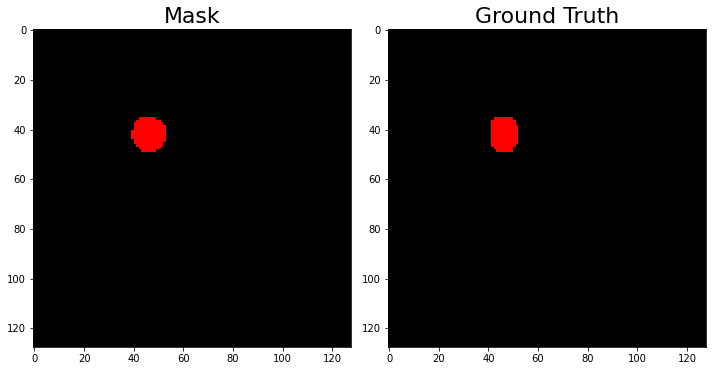

DICE for patient benign_179_seg.png: 0.913 


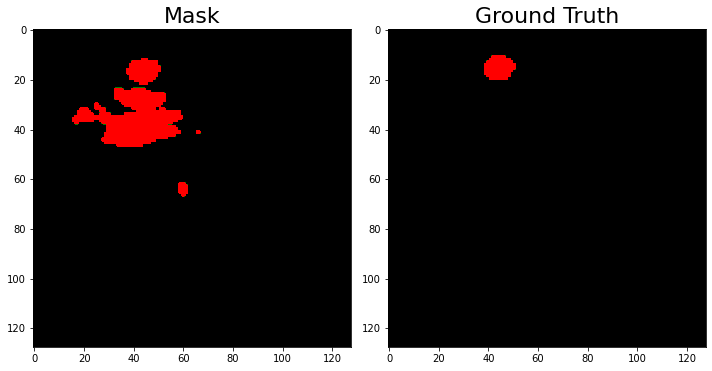

DICE for patient malignant_147_seg.png: 0.206 


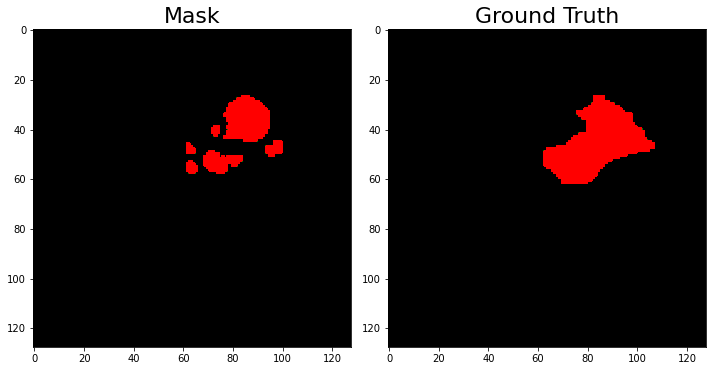

DICE for patient benign_176_seg.png: 0.591 


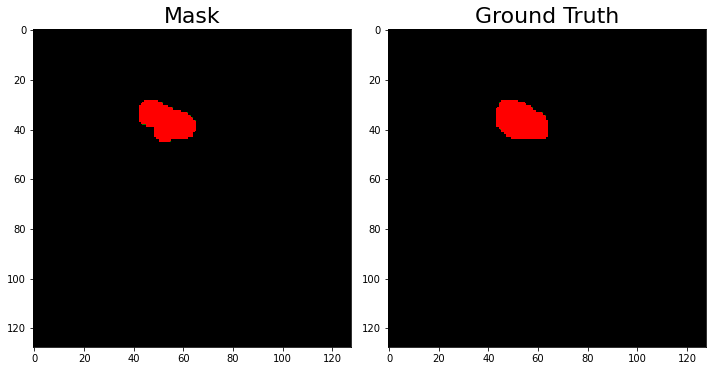

DICE for patient malignant_32_seg.png: 0.912 


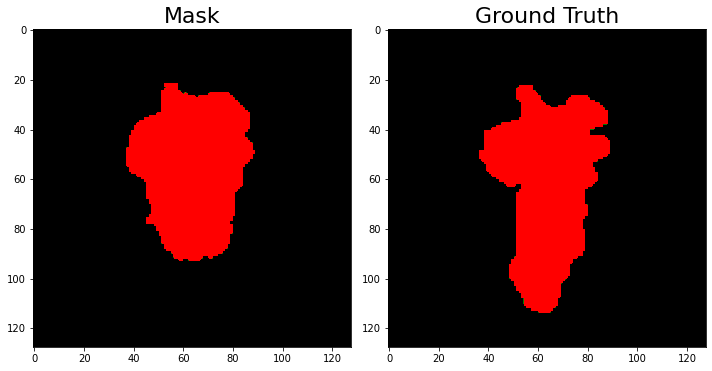

DICE for patient malignant_163_seg.png: 0.855 


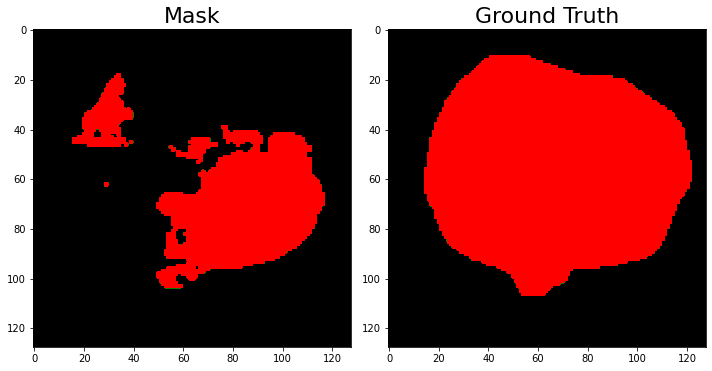

DICE for patient benign_159_seg.png: 0.559 


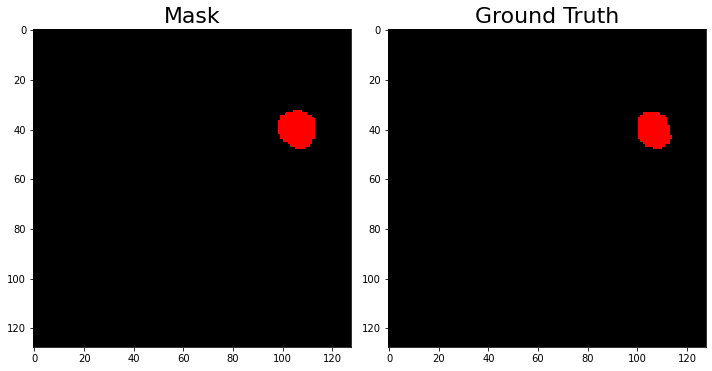

DICE for patient malignant_16_seg.png: 0.901 


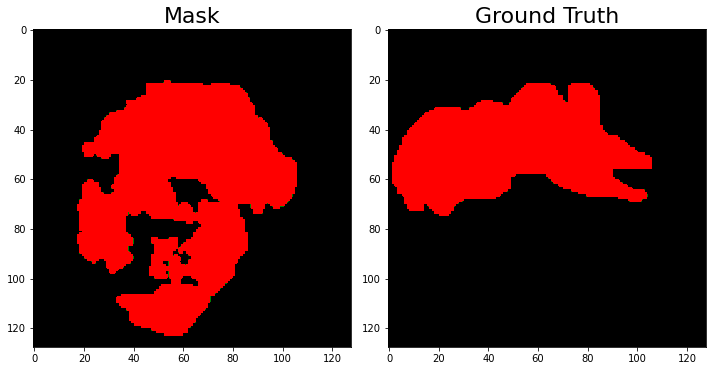

DICE for patient benign_27_seg.png: 0.596 


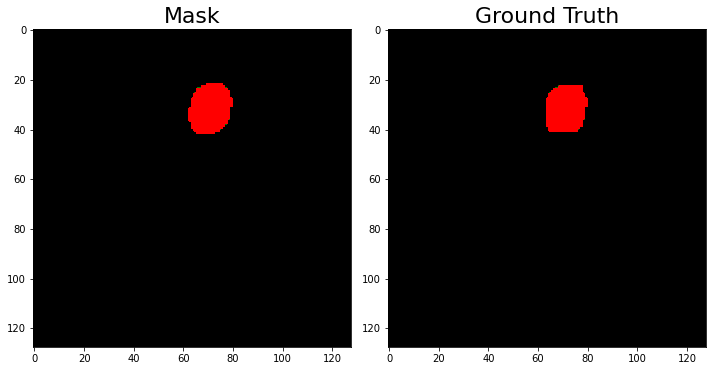

DICE for patient malignant_142_seg.png: 0.949 


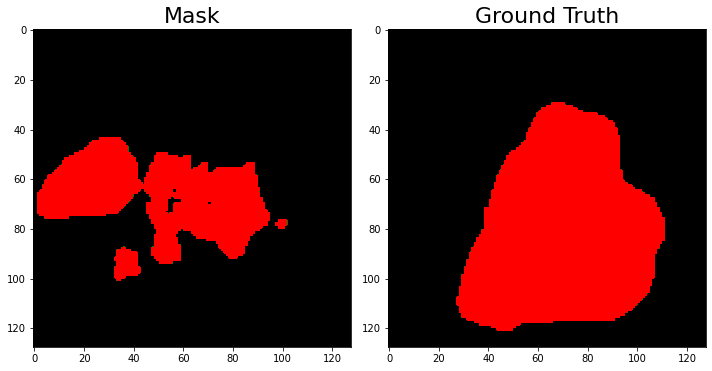

DICE for patient benign_365_seg.png: 0.402 


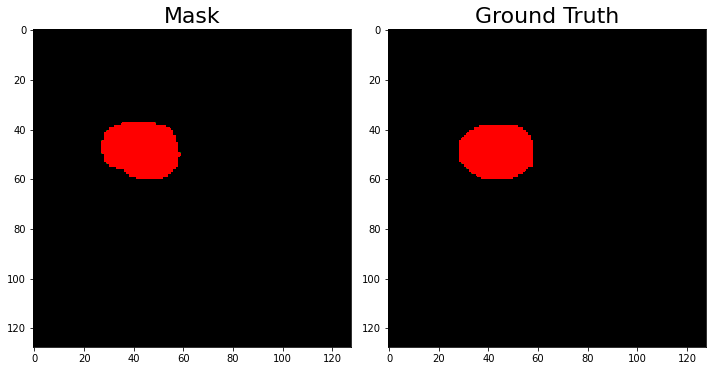

DICE for patient malignant_144_seg.png: 0.939 


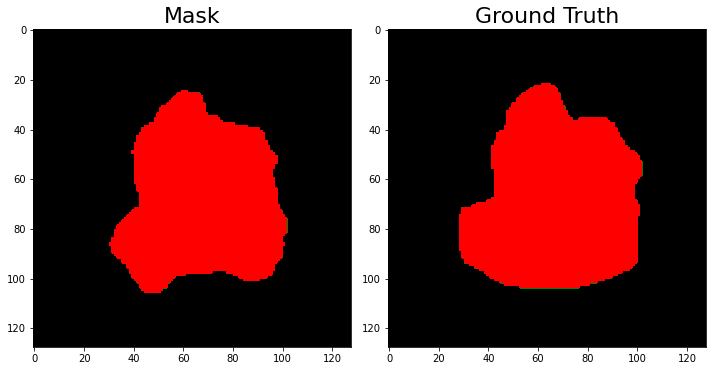

DICE for patient malignant_206_seg.png: 0.924 


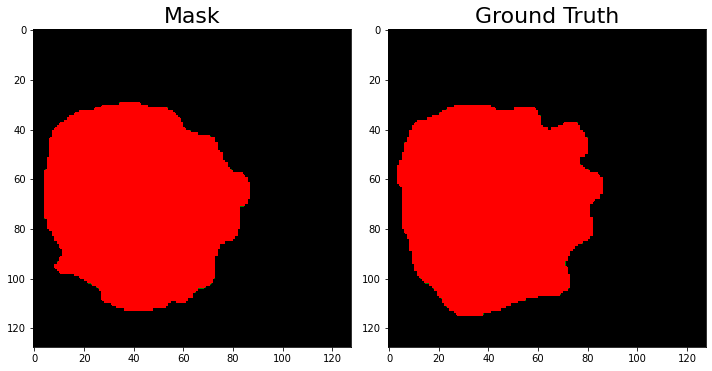

DICE for patient malignant_83_seg.png: 0.955 


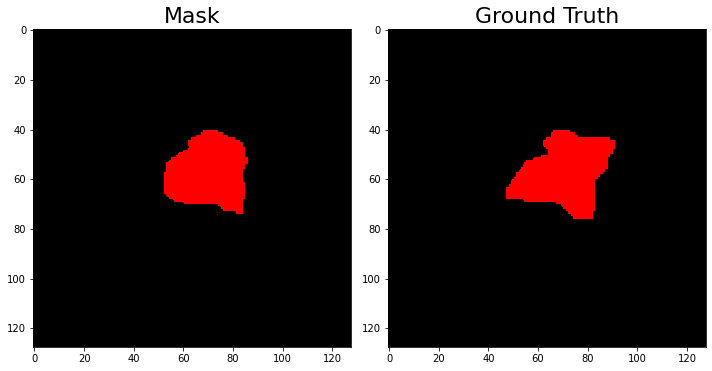

DICE for patient malignant_143_seg.png: 0.878 


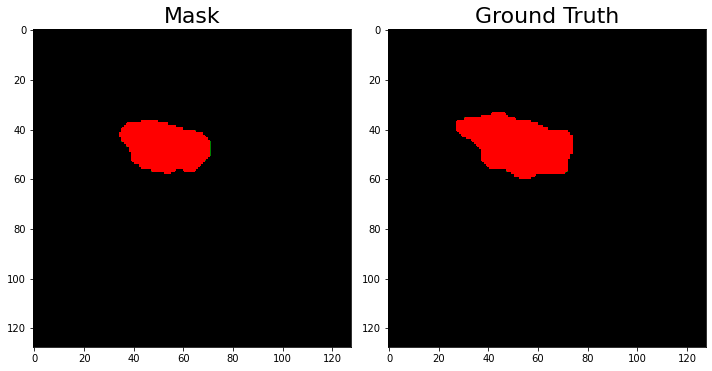

DICE for patient malignant_101_seg.png: 0.816 


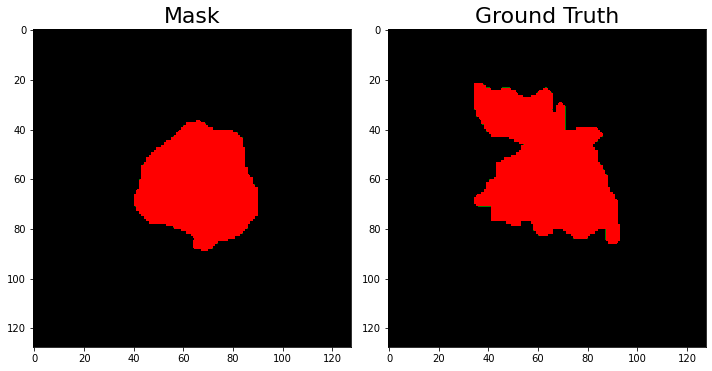

DICE for patient benign_192_seg.png: 0.798 


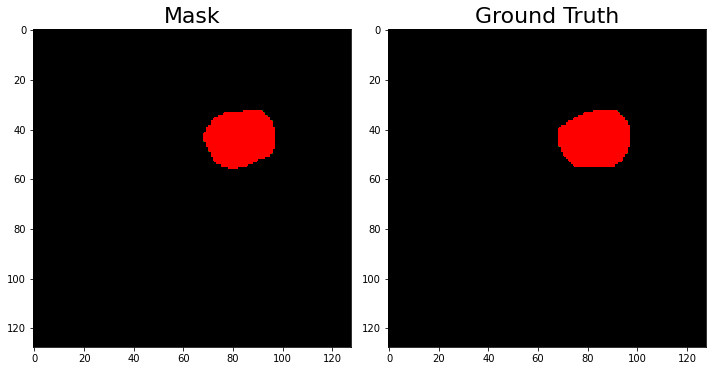

DICE for patient benign_341_seg.png: 0.961 


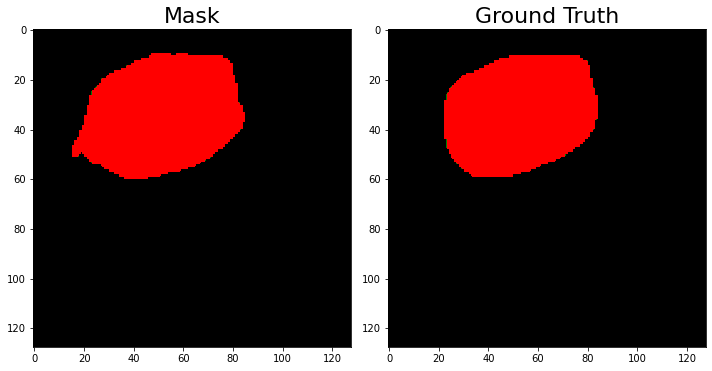

DICE for patient benign_348_seg.png: 0.963 


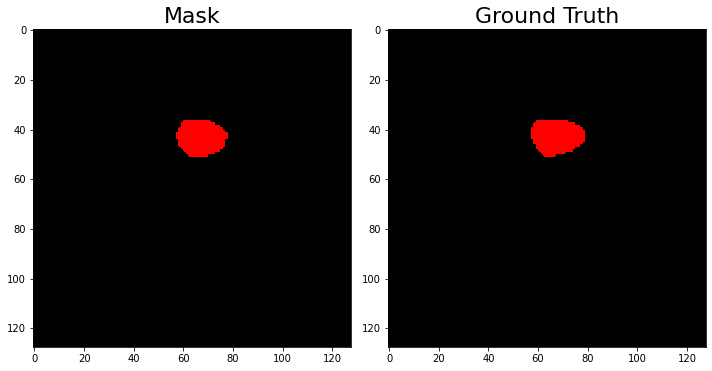

DICE for patient malignant_48_seg.png: 0.939 


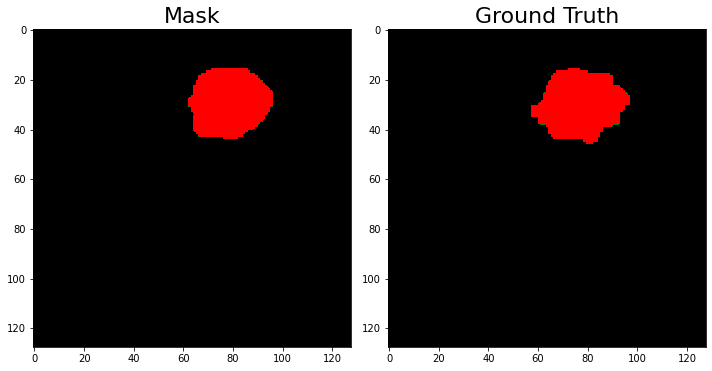

DICE for patient benign_166_seg.png: 0.922 


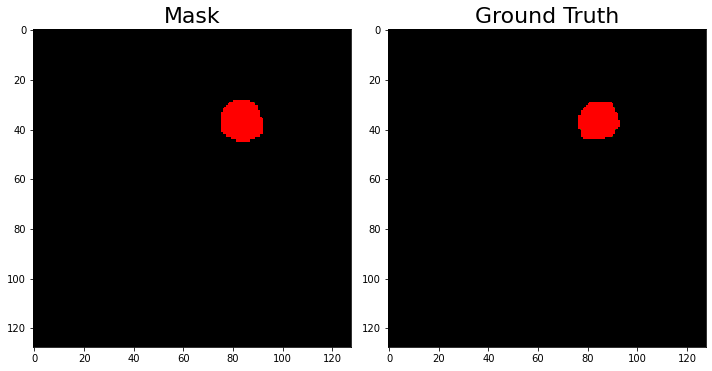

DICE for patient malignant_46_seg.png: 0.897 


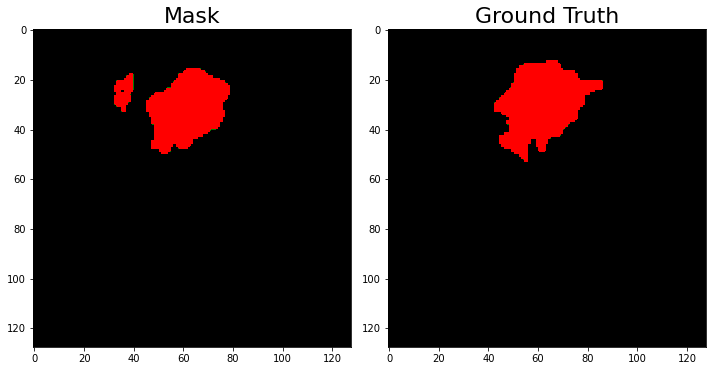

DICE for patient benign_53_seg.png: 0.821 


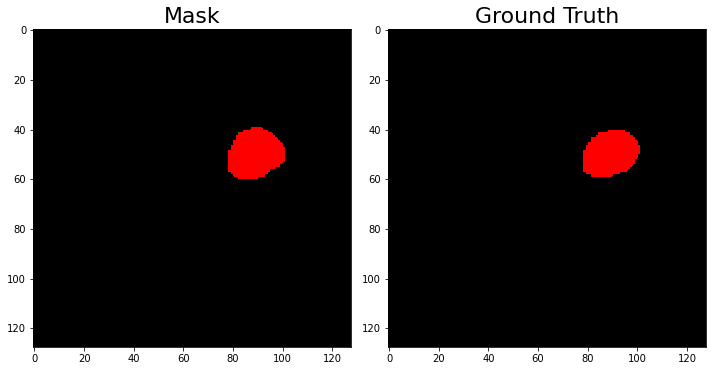

DICE for patient benign_402_seg.png: 0.94 


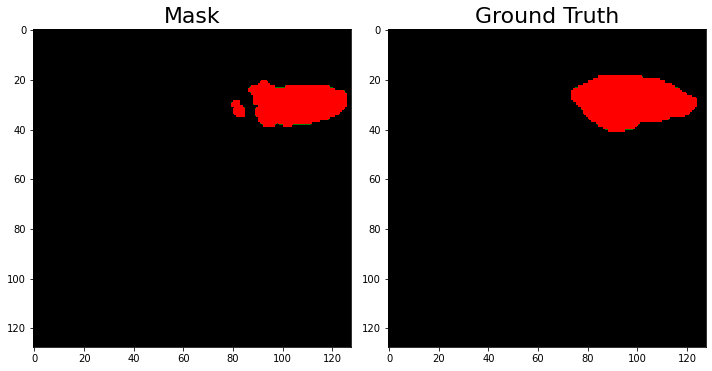

DICE for patient benign_146_seg.png: 0.712 


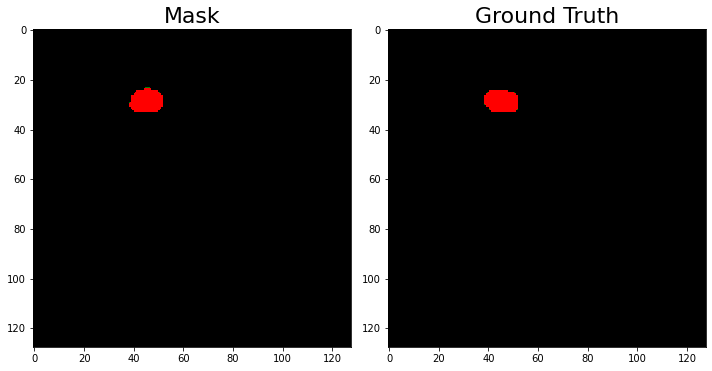

DICE for patient benign_91_seg.png: 0.921 


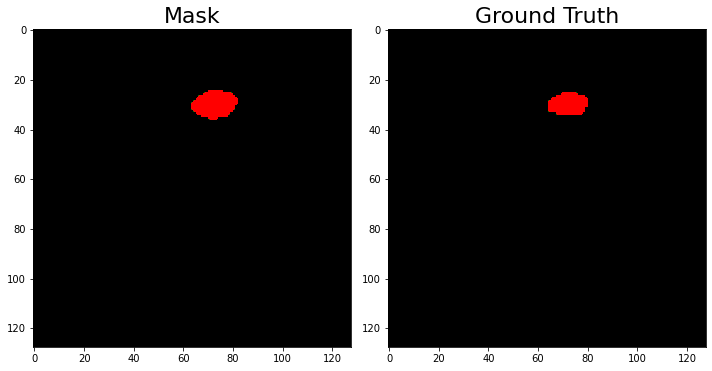

DICE for patient benign_374_seg.png: 0.835 


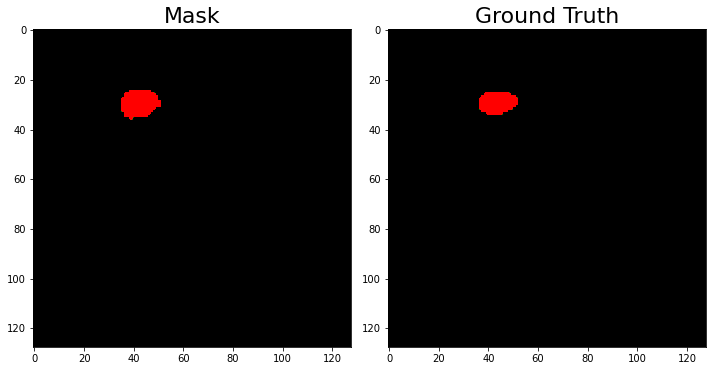

DICE for patient benign_189_seg.png: 0.835 


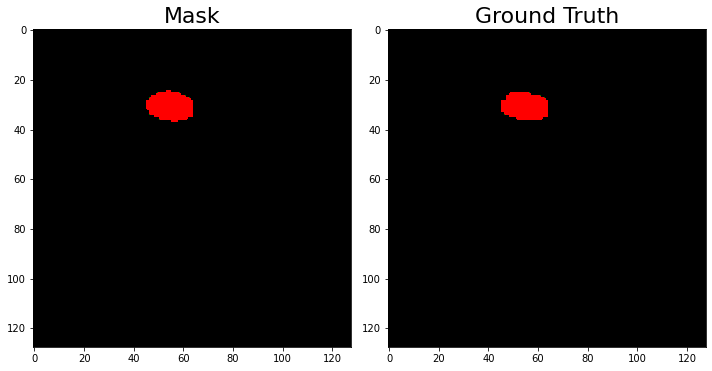

DICE for patient malignant_50_seg.png: 0.97 


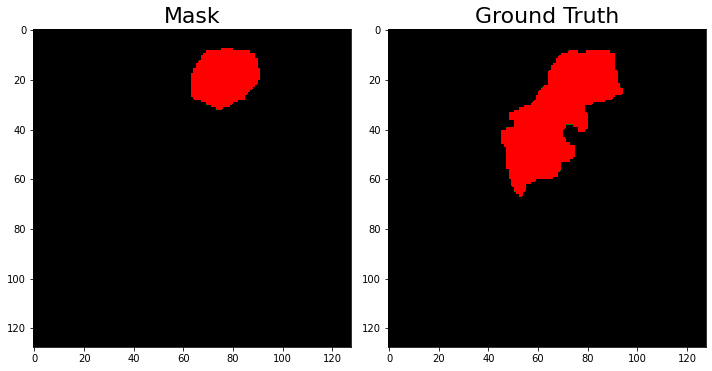

DICE for patient benign_32_seg.png: 0.513 


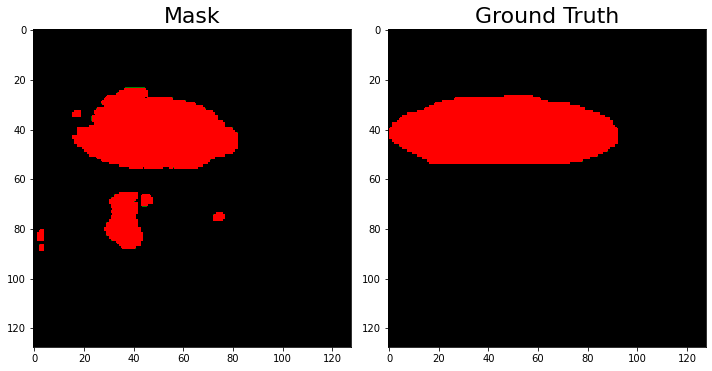

DICE for patient benign_317_seg.png: 0.733 


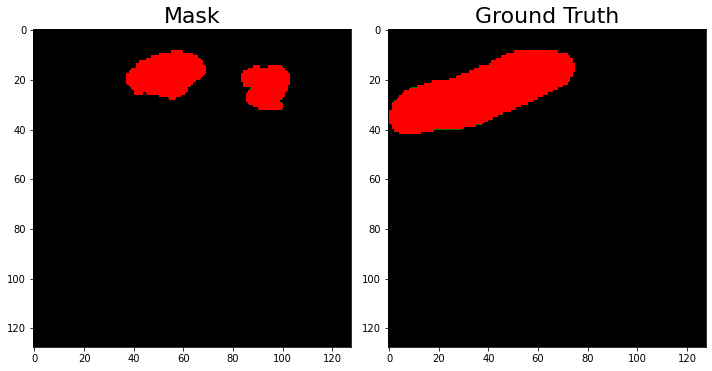

DICE for patient malignant_40_seg.png: 0.4 


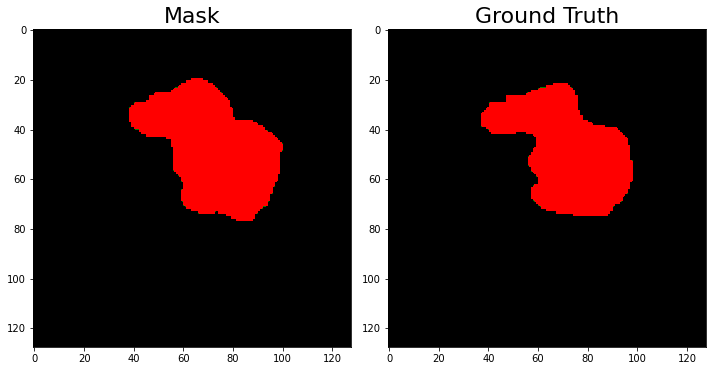

DICE for patient malignant_22_seg.png: 0.939 


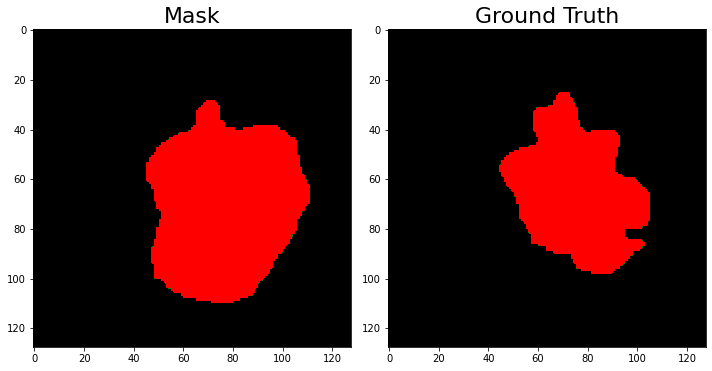

DICE for patient malignant_3_seg.png: 0.78 


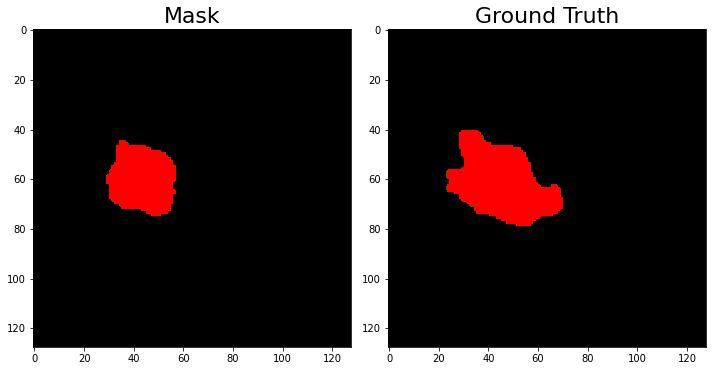

DICE for patient benign_389_seg.png: 0.746 


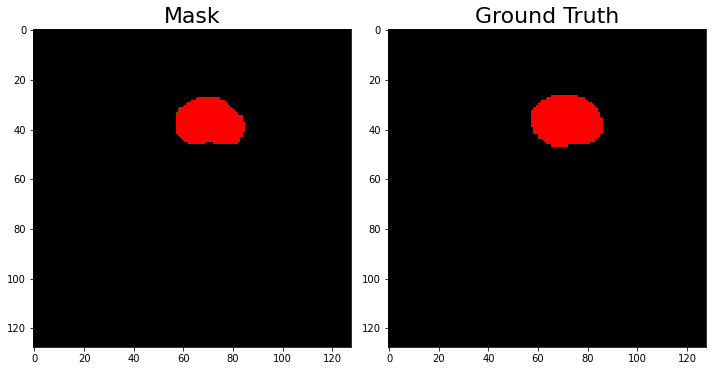

DICE for patient benign_78_seg.png: 0.912 


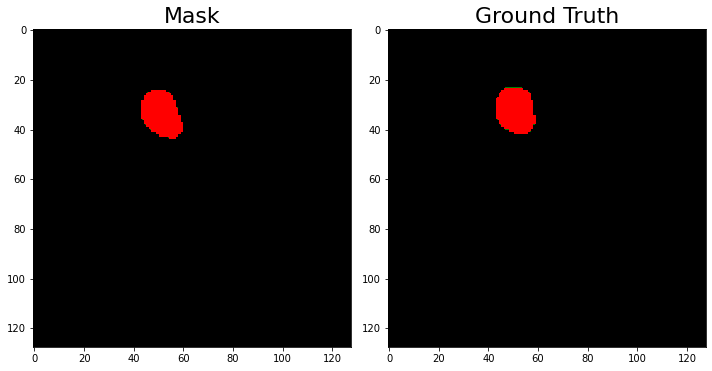

DICE for patient benign_334_seg.png: 0.903 


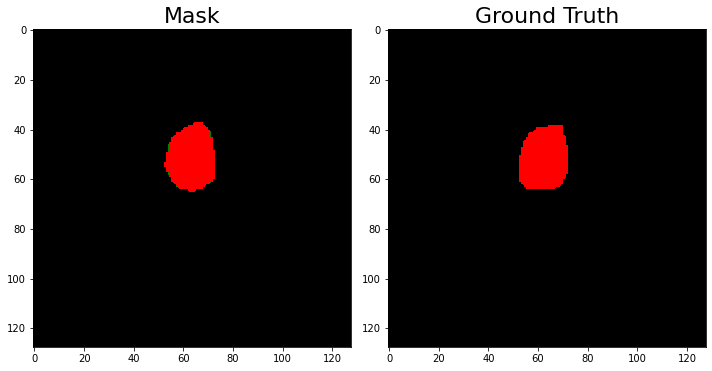

DICE for patient malignant_117_seg.png: 0.924 


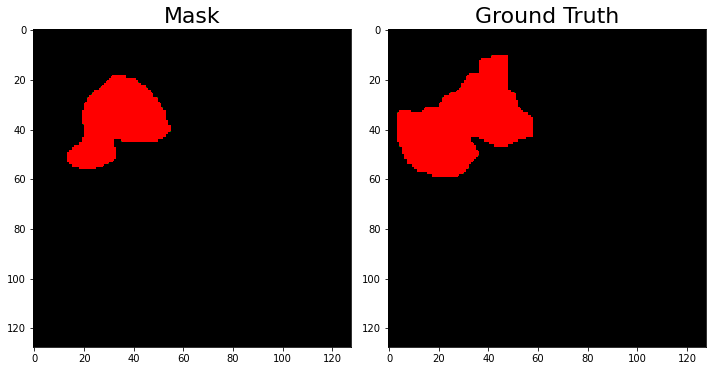

DICE for patient malignant_45_seg.png: 0.74 


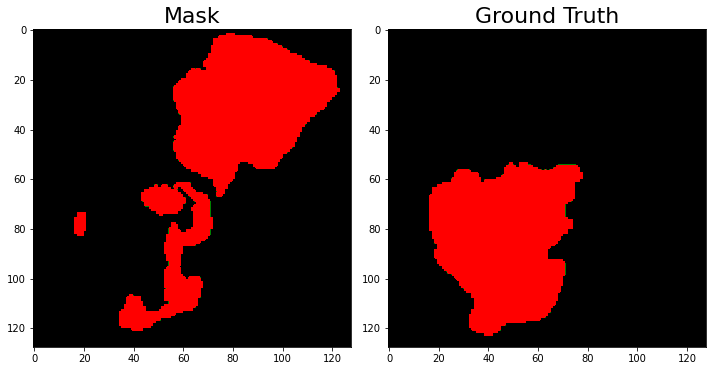

DICE for patient malignant_154_seg.png: 0.26 


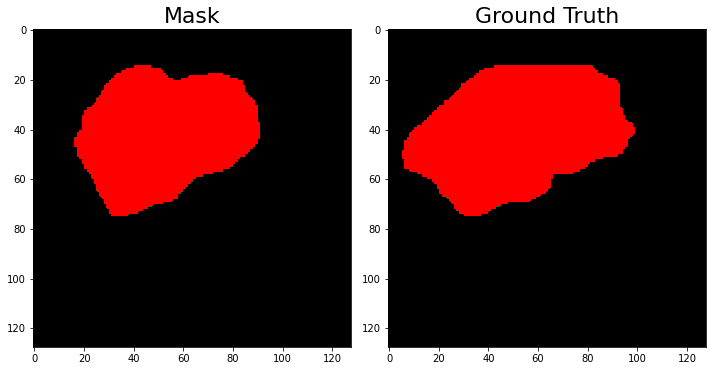

DICE for patient malignant_102_seg.png: 0.89 


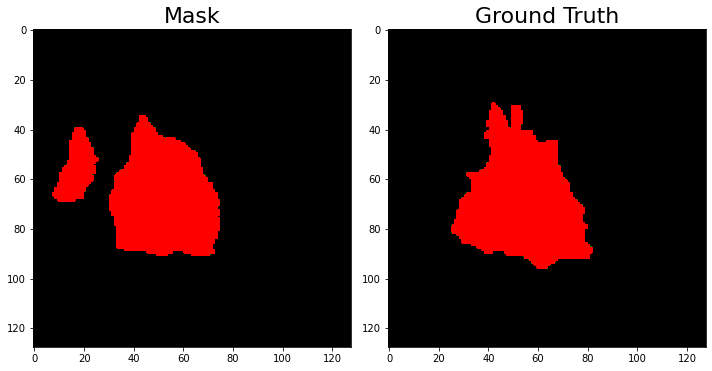

DICE for patient benign_87_seg.png: 0.82 


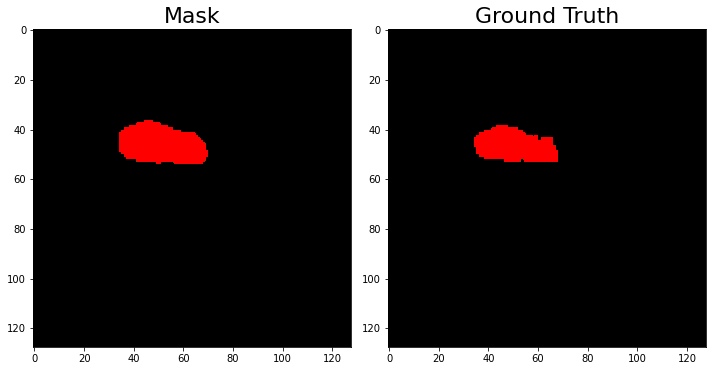

DICE for patient malignant_202_seg.png: 0.868 


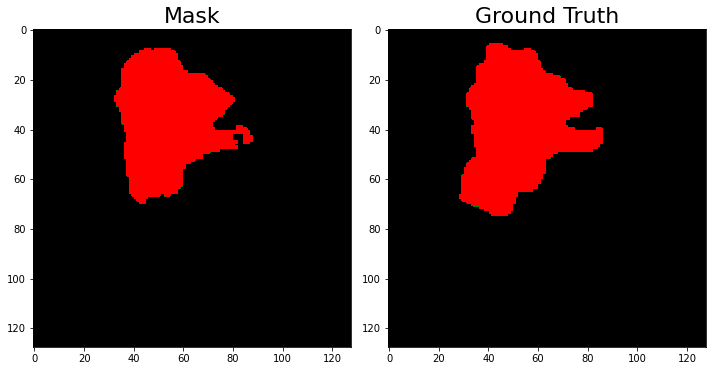

DICE for patient malignant_72_seg.png: 0.893 


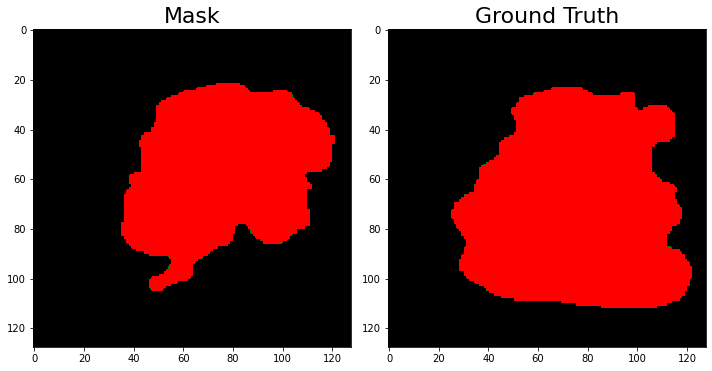

DICE for patient benign_94_seg.png: 0.763 


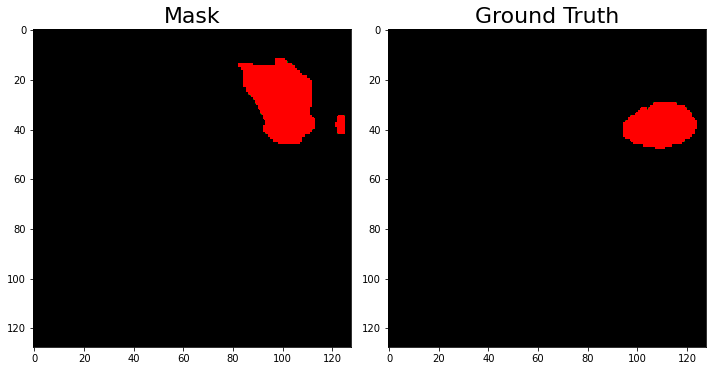

DICE for patient benign_123_seg.png: 0.388 


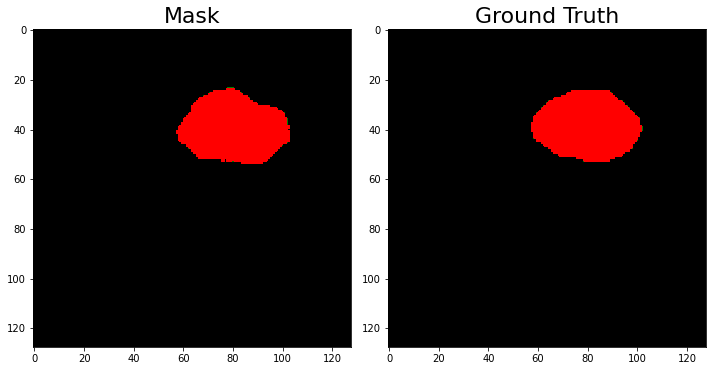

DICE for patient benign_137_seg.png: 0.927 


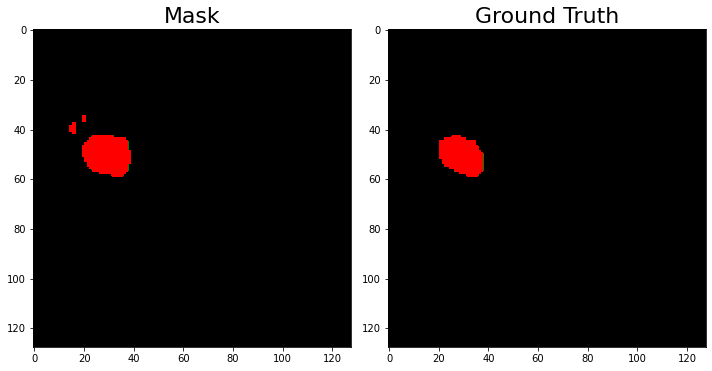

DICE for patient benign_375_seg.png: 0.891 


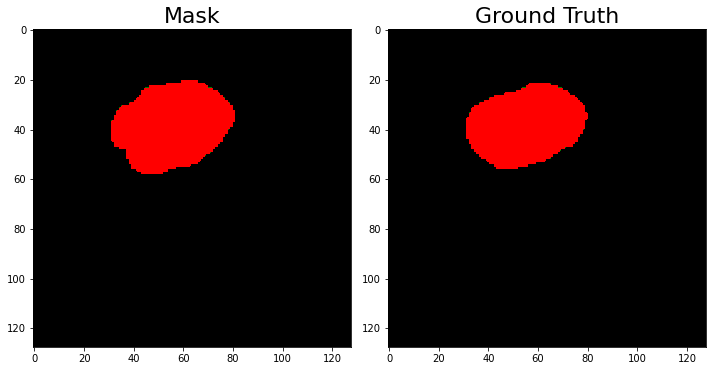

DICE for patient benign_24_seg.png: 0.939 


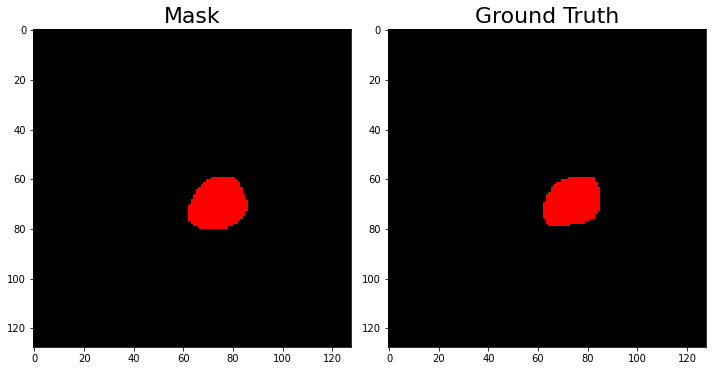

DICE for patient benign_20_seg.png: 0.932 


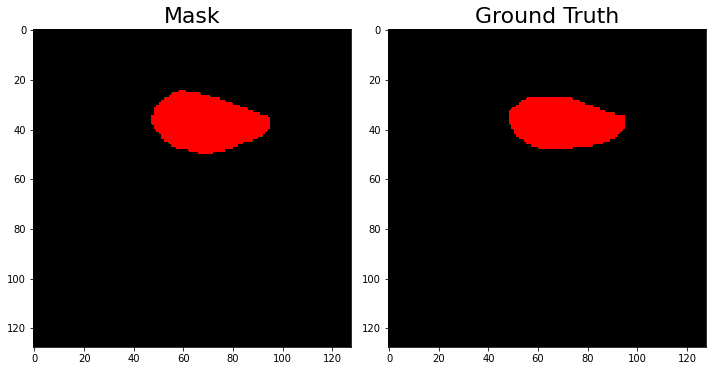

DICE for patient malignant_87_seg.png: 0.94 


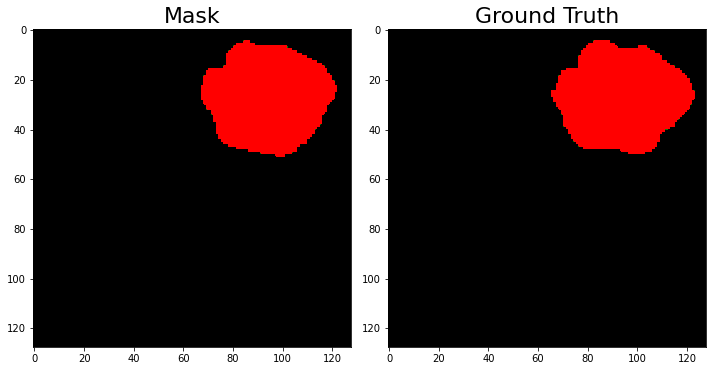

DICE for patient benign_49_seg.png: 0.961 


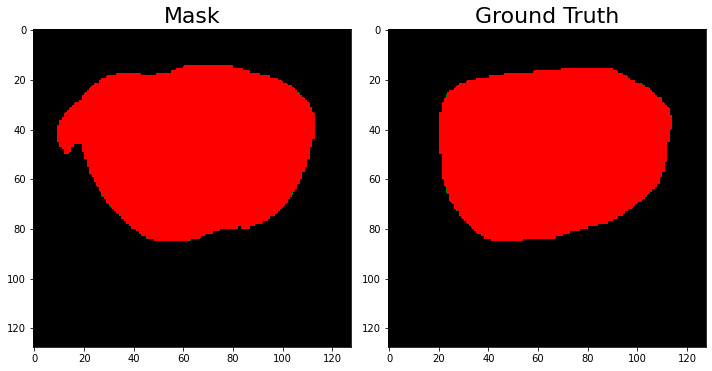

DICE for patient benign_359_seg.png: 0.953 


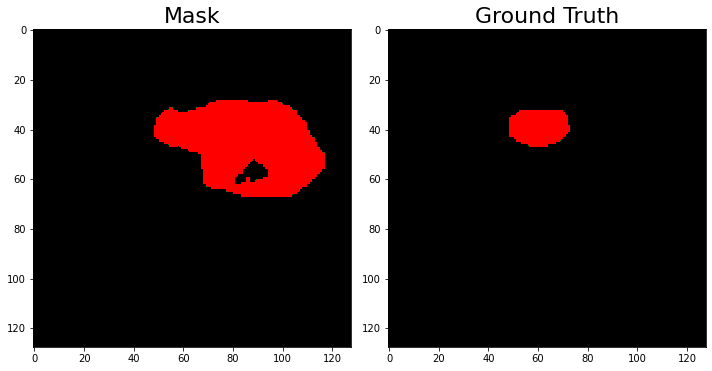

DICE for patient benign_92_seg.png: 0.268 


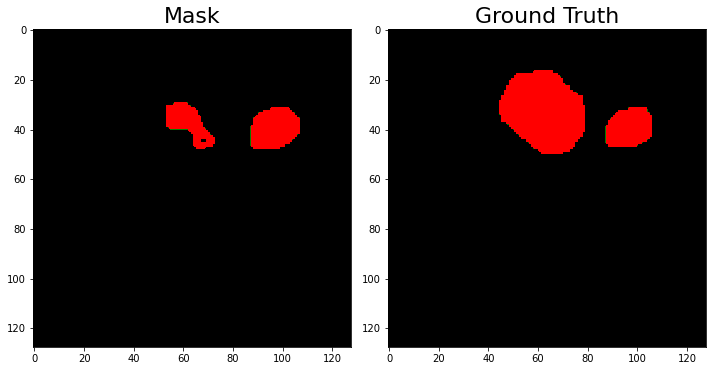

DICE for patient malignant_209_seg.png: 0.528 


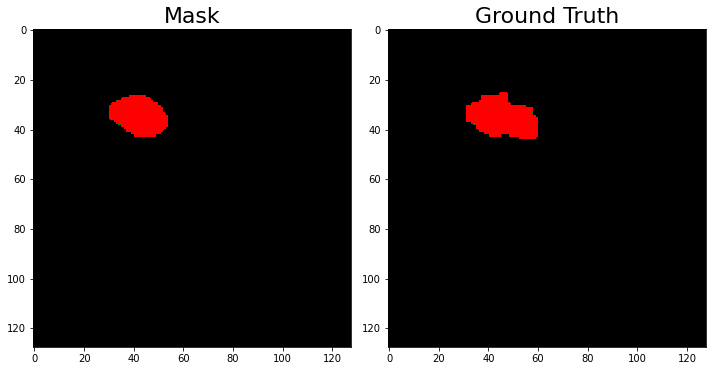

DICE for patient malignant_180_seg.png: 0.814 


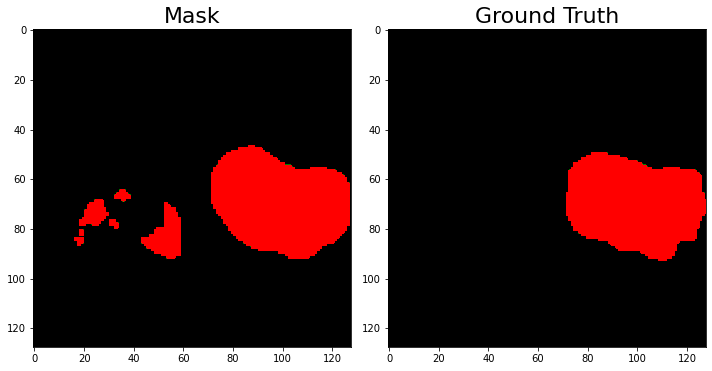

DICE for patient benign_187_seg.png: 0.886 


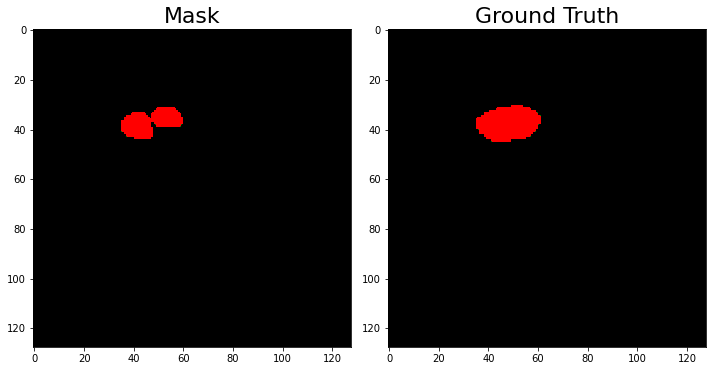

DICE for patient benign_186_seg.png: 0.767 


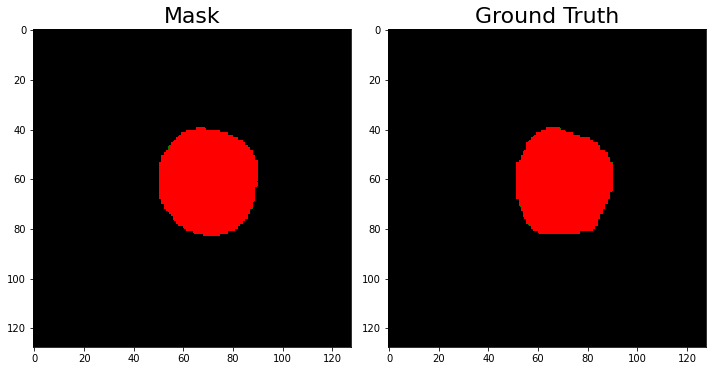

DICE for patient benign_115_seg.png: 0.966 


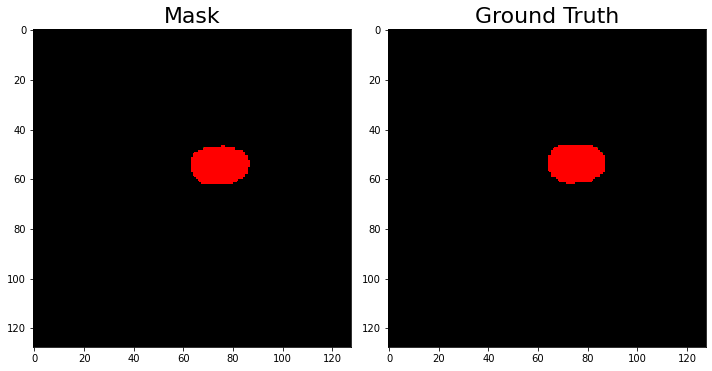

DICE for patient benign_198_seg.png: 0.915 


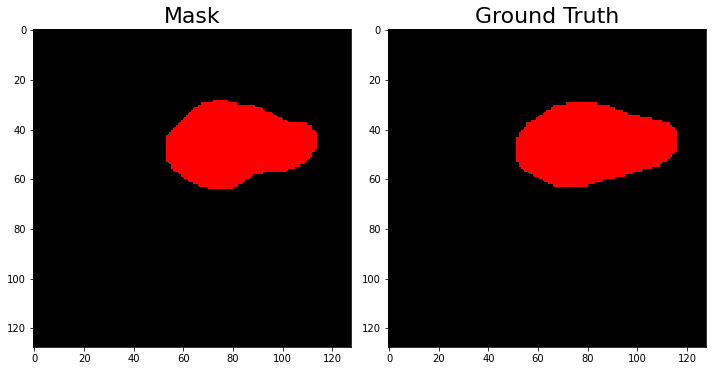

DICE for patient benign_190_seg.png: 0.952 


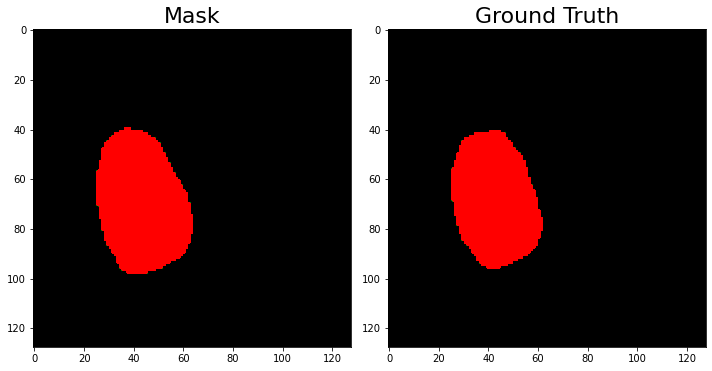

DICE for patient benign_93_seg.png: 0.941 


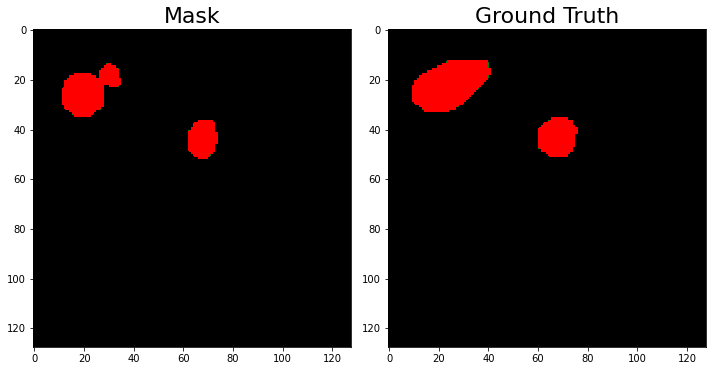

DICE for patient benign_119_seg.png: 0.757 


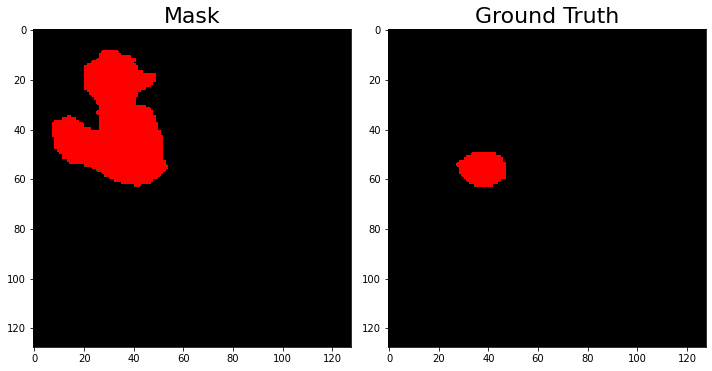

DICE for patient malignant_62_seg.png: 0.226 


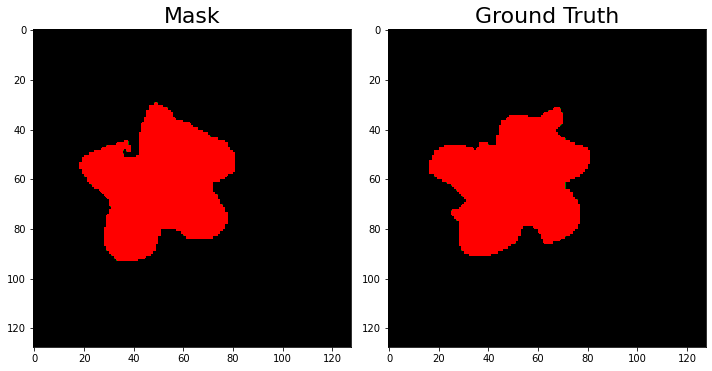

DICE for patient malignant_139_seg.png: 0.924 


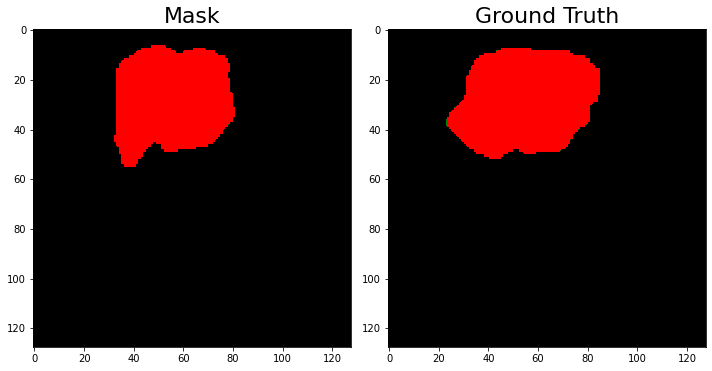

DICE for patient benign_283_seg.png: 0.907 


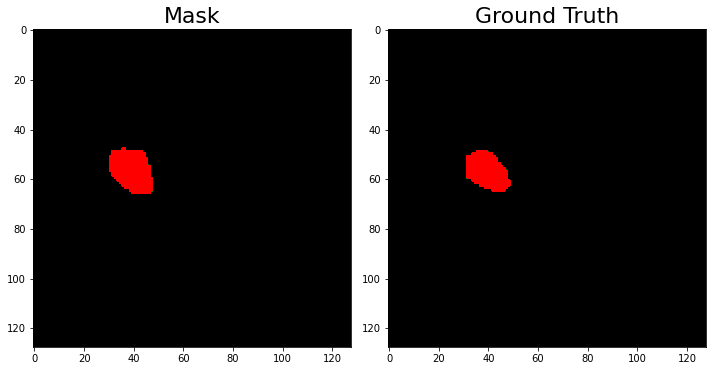

DICE for patient benign_112_seg.png: 0.887 


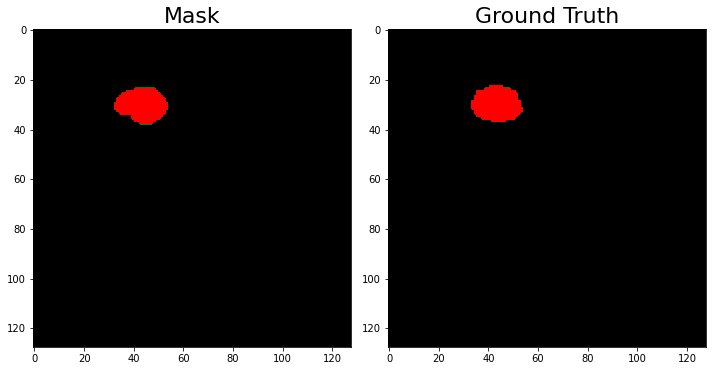

DICE for patient malignant_207_seg.png: 0.92 


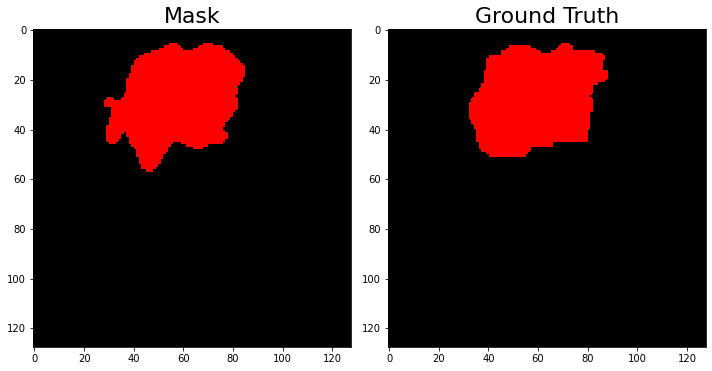

DICE for patient malignant_74_seg.png: 0.92 


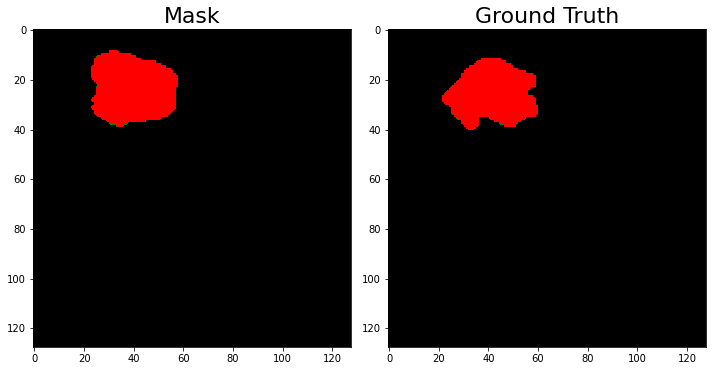

DICE for patient malignant_205_seg.png: 0.857 


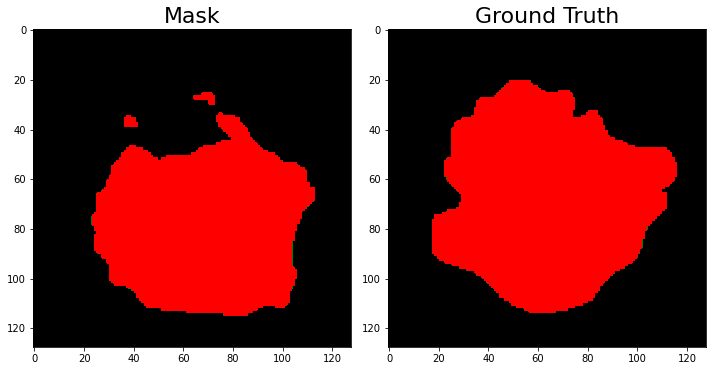

DICE for patient benign_114_seg.png: 0.808 


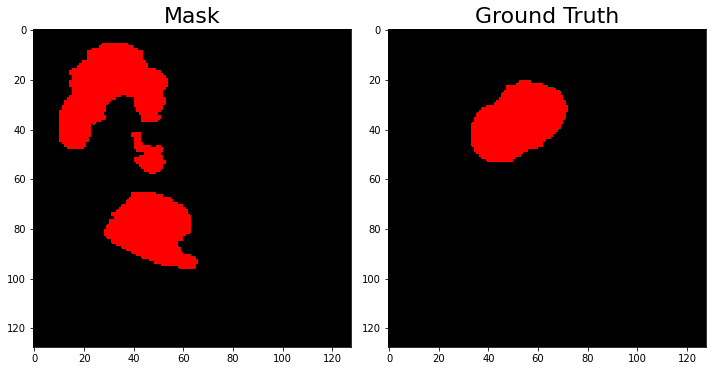

DICE for patient malignant_6_seg.png: 0.119 


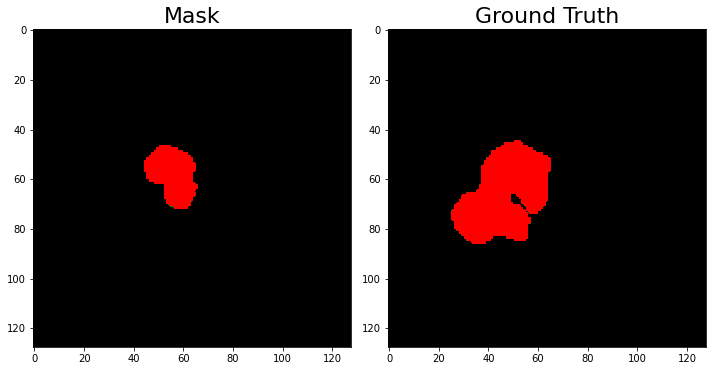

DICE for patient benign_149_seg.png: 0.497 


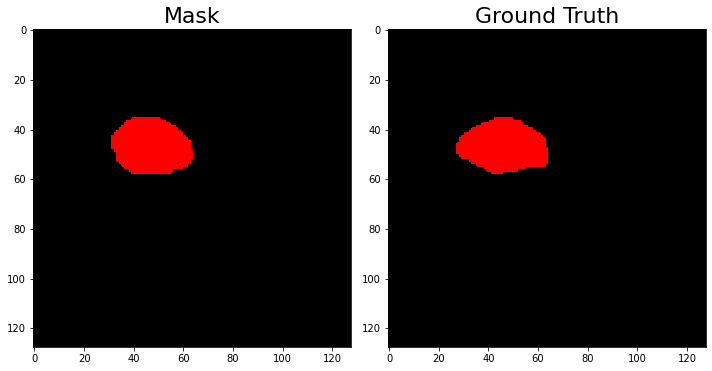

DICE for patient benign_428_seg.png: 0.927 


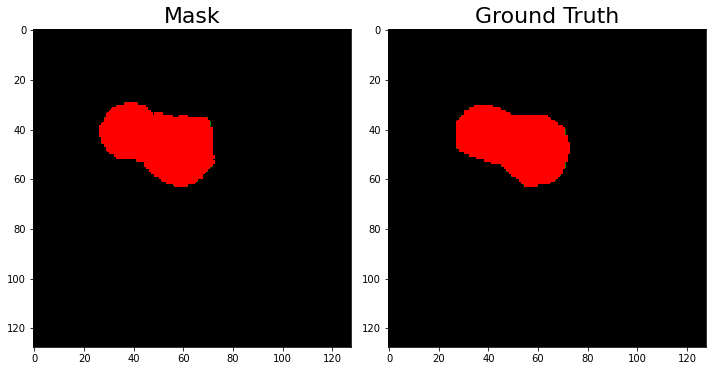

DICE for patient malignant_138_seg.png: 0.961 


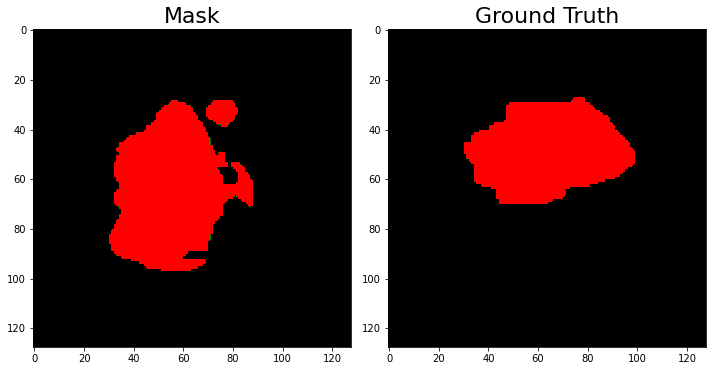

DICE for patient malignant_165_seg.png: 0.585 


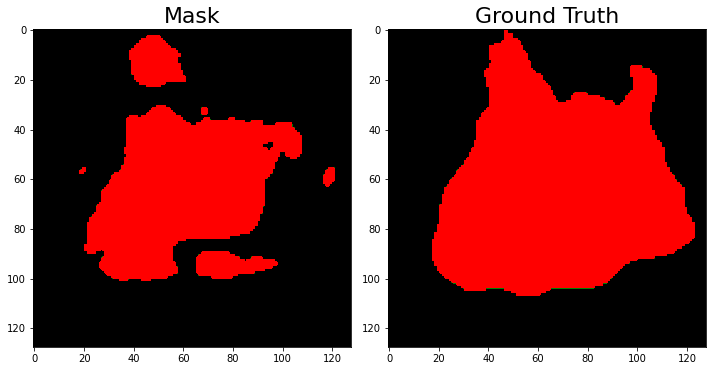

DICE for patient benign_315_seg.png: 0.735 


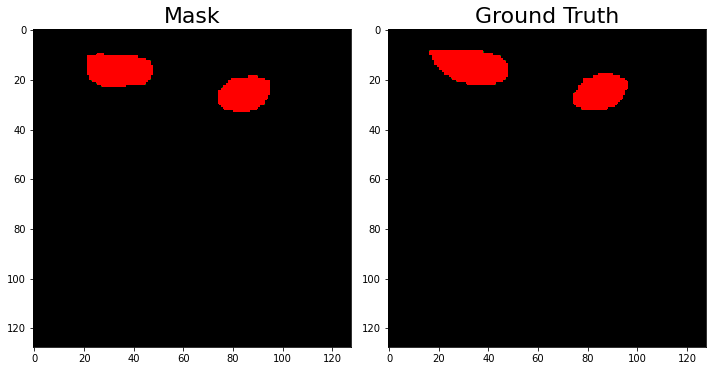

DICE for patient malignant_23_seg.png: 0.882 


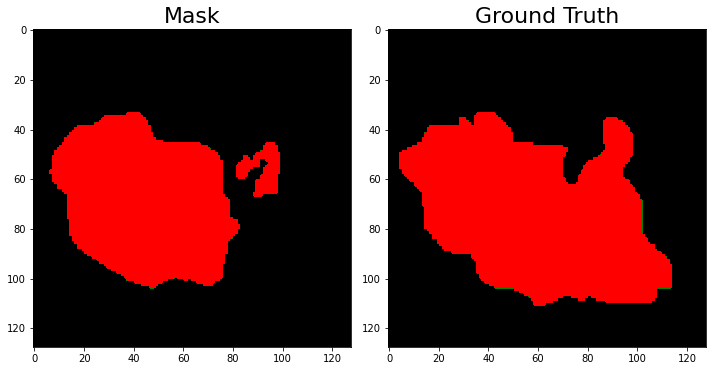

DICE for patient benign_183_seg.png: 0.781 


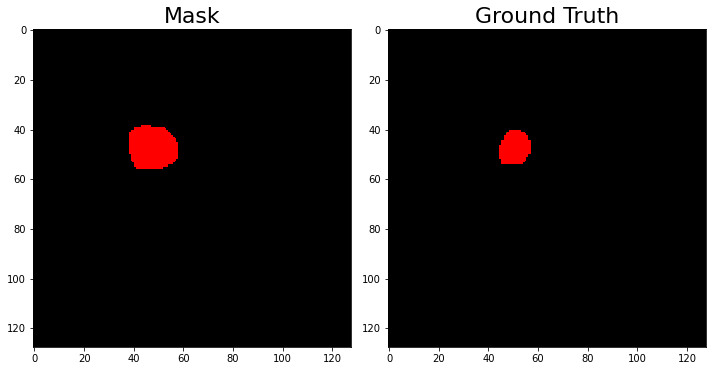

DICE for patient malignant_68_seg.png: 0.641 


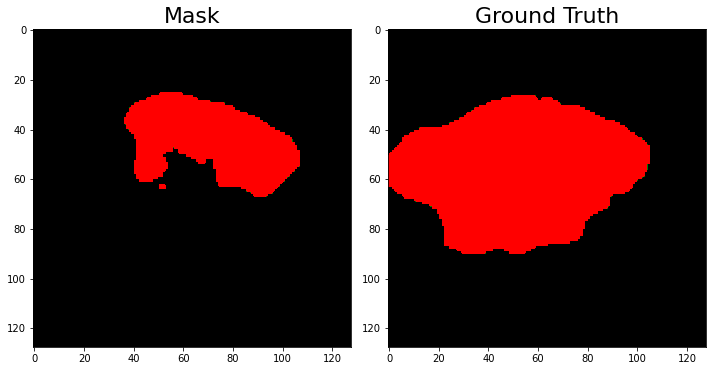

DICE for patient benign_414_seg.png: 0.528 


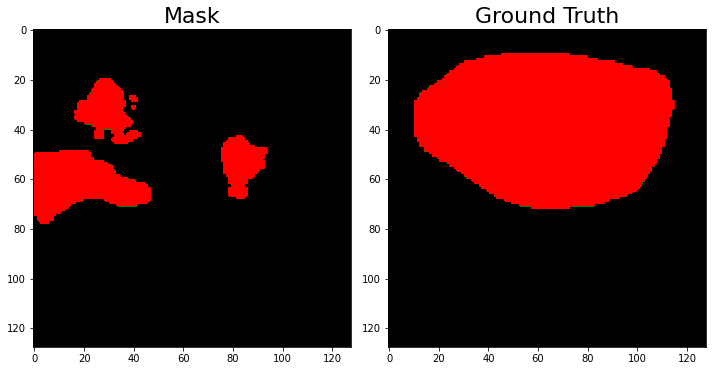

DICE for patient malignant_25_seg.png: 0.216 


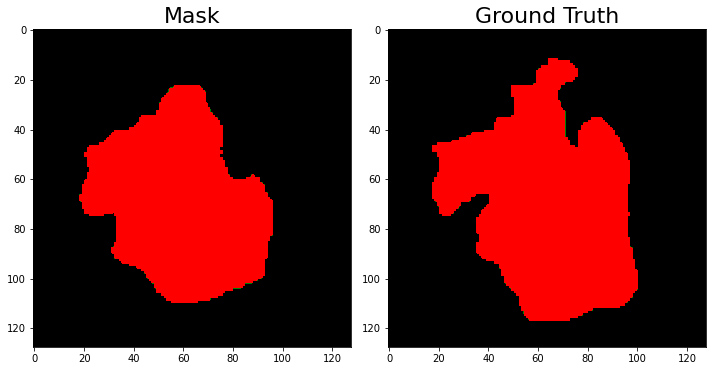

DICE for patient benign_98_seg.png: 0.854 


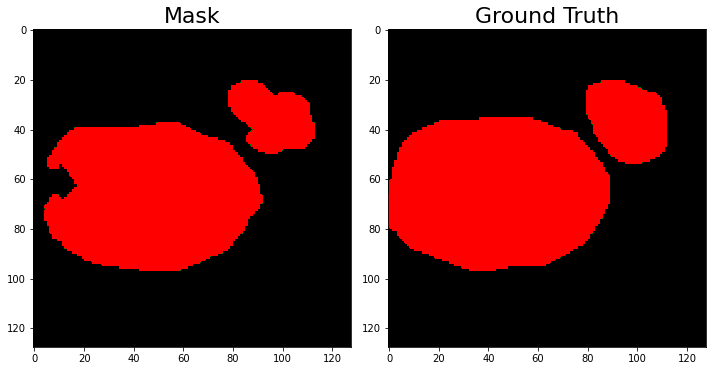

DICE for patient malignant_158_seg.png: 0.916 


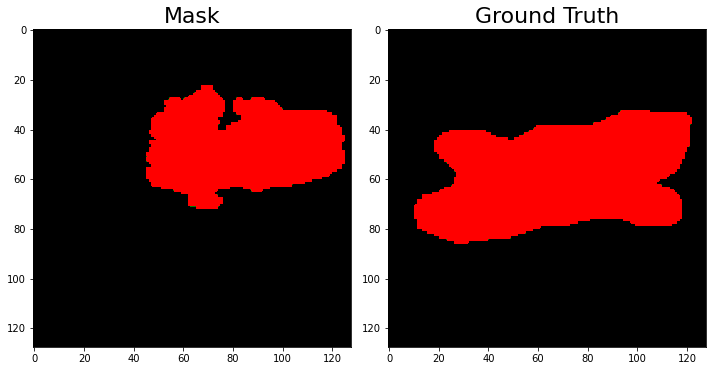

DICE for patient malignant_136_seg.png: 0.586 


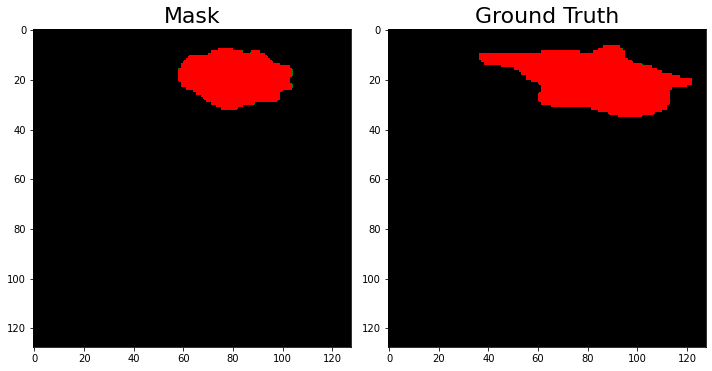

DICE for patient malignant_134_seg.png: 0.726 


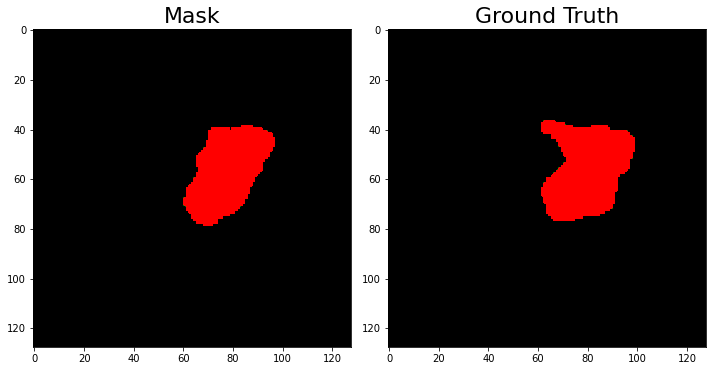

DICE for patient benign_160_seg.png: 0.855 


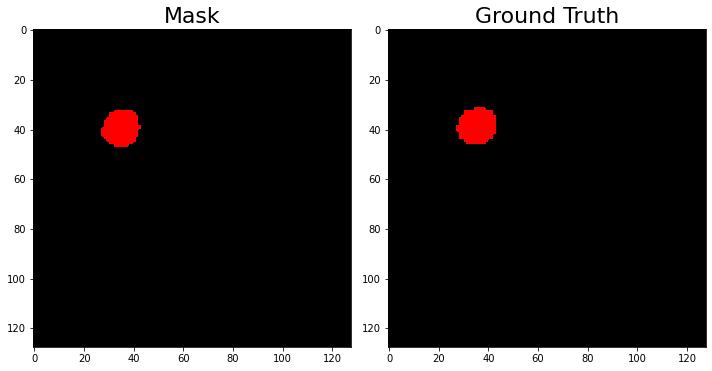

DICE for patient malignant_148_seg.png: 0.908 


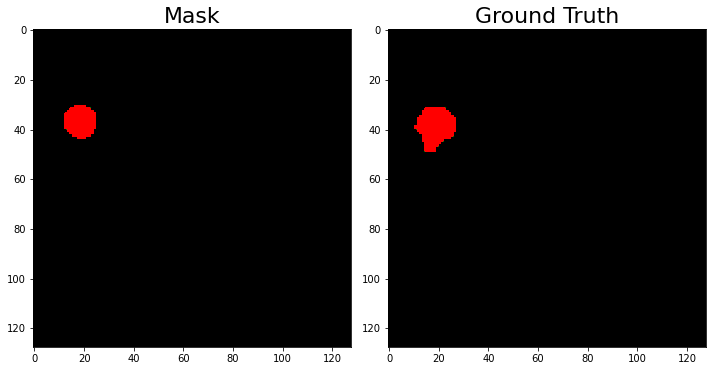

DICE for patient benign_427_seg.png: 0.776 


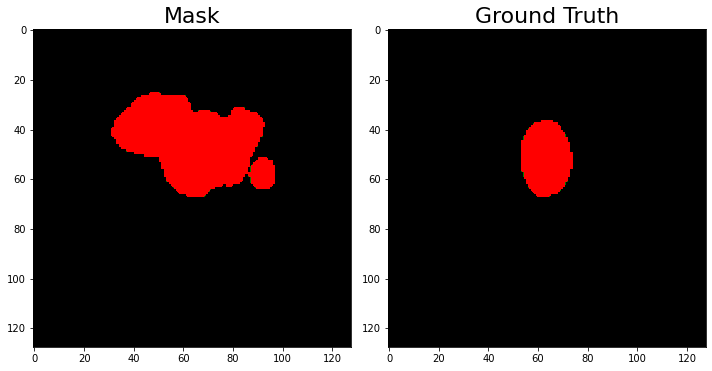

DICE for patient malignant_19_seg.png: 0.443 


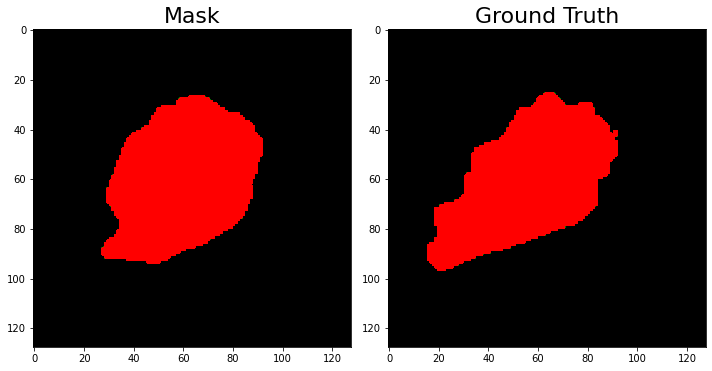

DICE for patient benign_73_seg.png: 0.871 


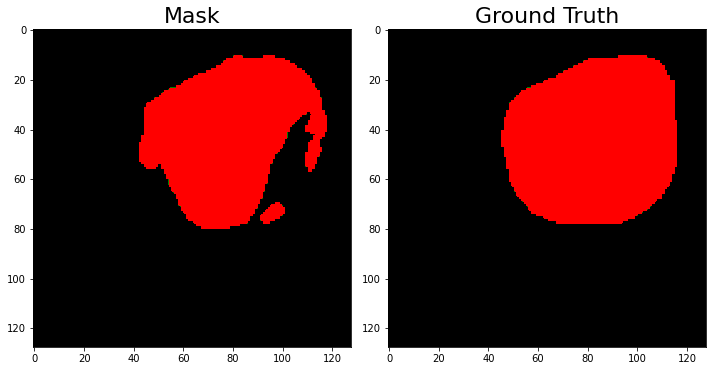

DICE for patient benign_408_seg.png: 0.877 


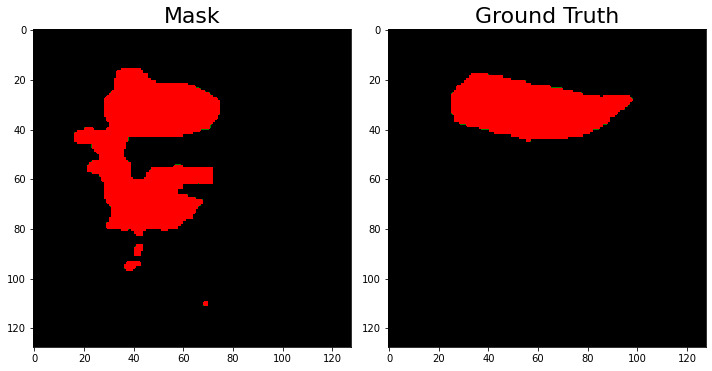

DICE for patient benign_76_seg.png: 0.523 


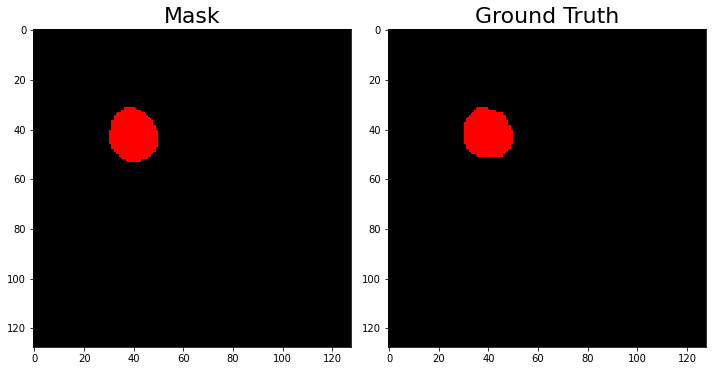

DICE for patient benign_165_seg.png: 0.951 


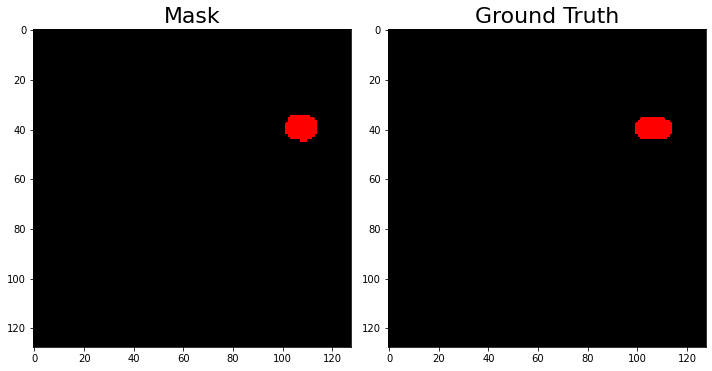

DICE for patient benign_175_seg.png: 0.862 


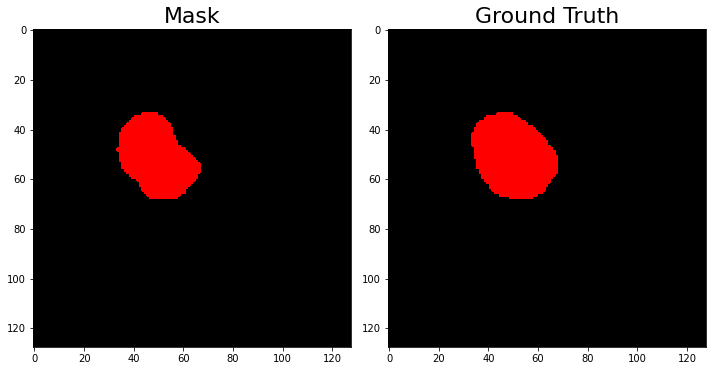

DICE for patient malignant_89_seg.png: 0.925 


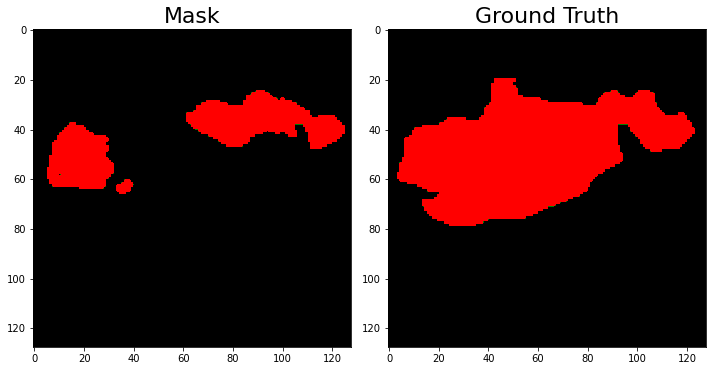

DICE for patient benign_39_seg.png: 0.483 


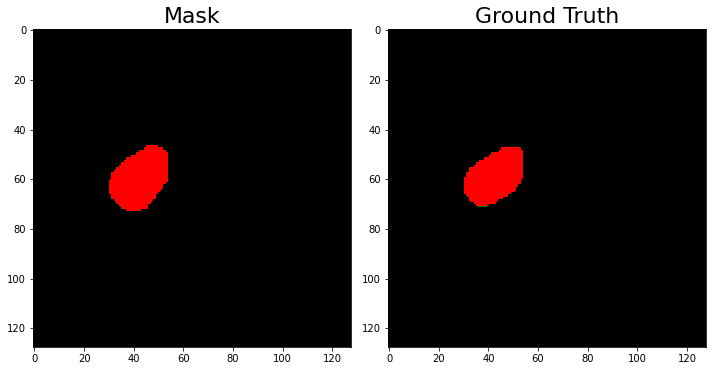

DICE for patient malignant_26_seg.png: 0.934 


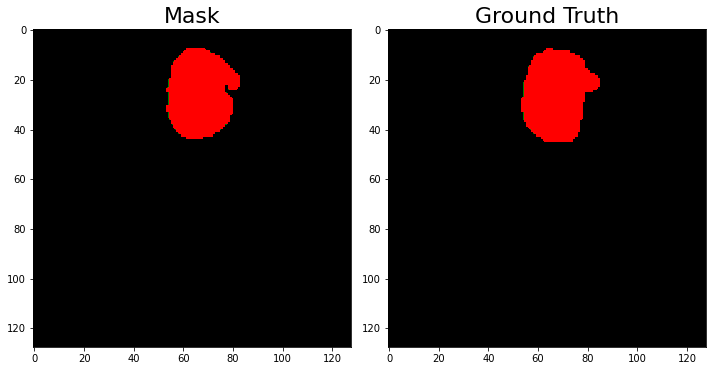

DICE for patient malignant_29_seg.png: 0.937 


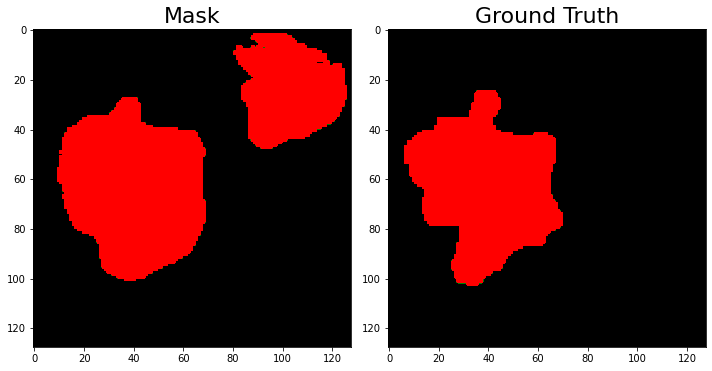

DICE for patient malignant_113_seg.png: 0.74 


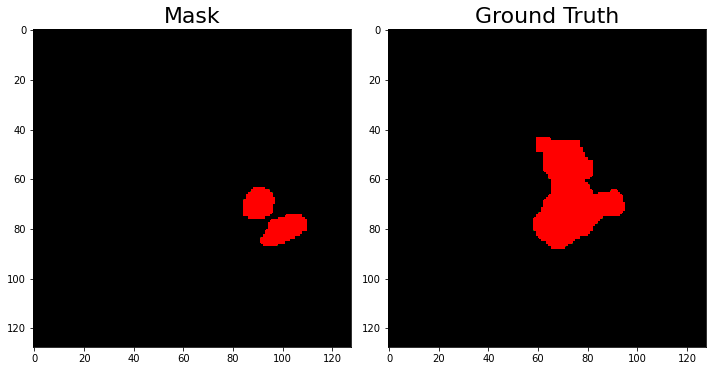

DICE for patient benign_340_seg.png: 0.143 


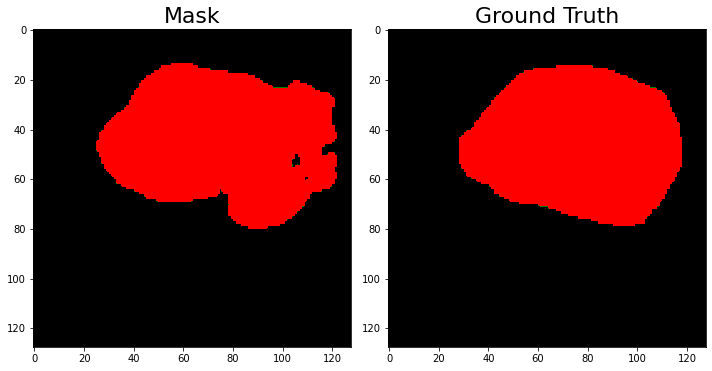

DICE for patient benign_22_seg.png: 0.922 


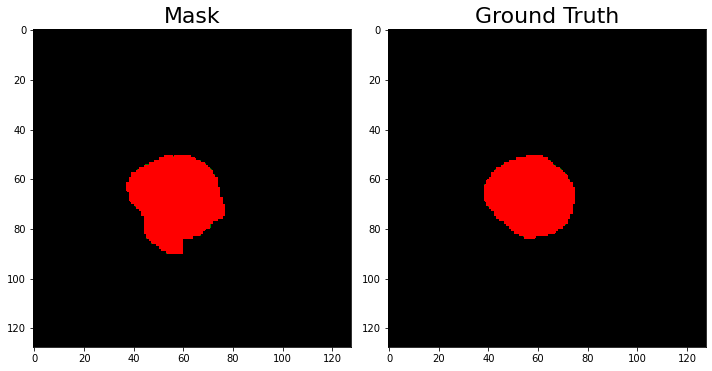

DICE for patient benign_181_seg.png: 0.91 


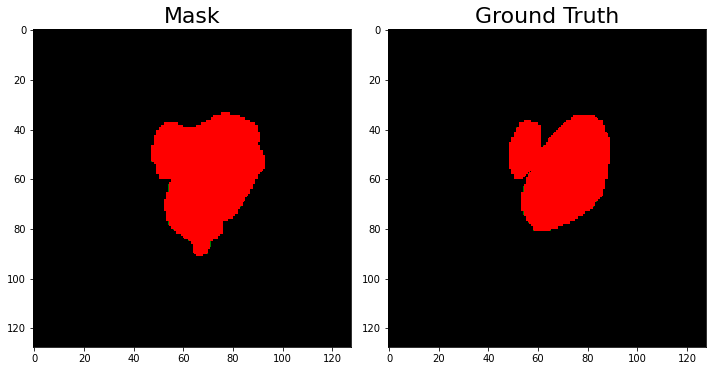

DICE for patient malignant_20_seg.png: 0.893 


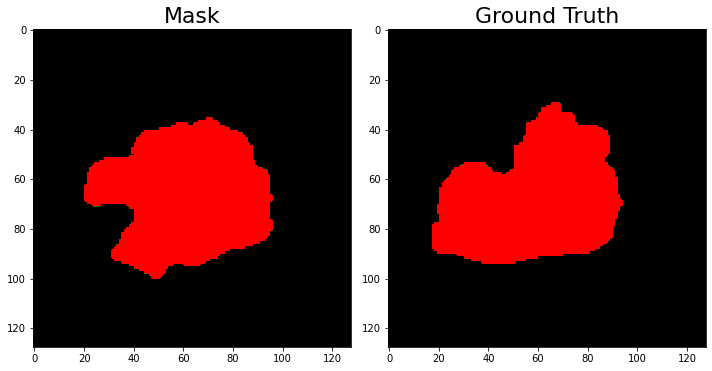

DICE for patient benign_430_seg.png: 0.846 


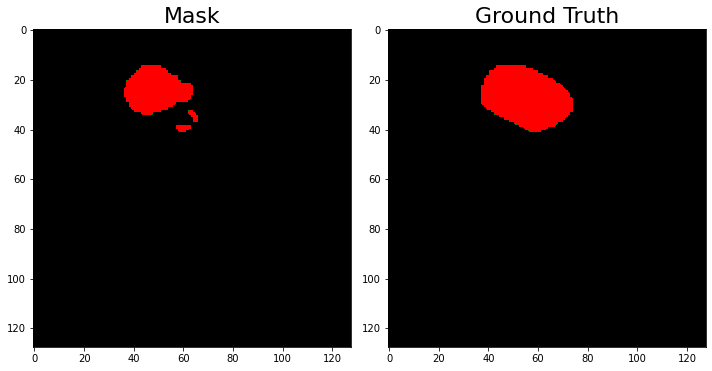

DICE for patient benign_336_seg.png: 0.686 


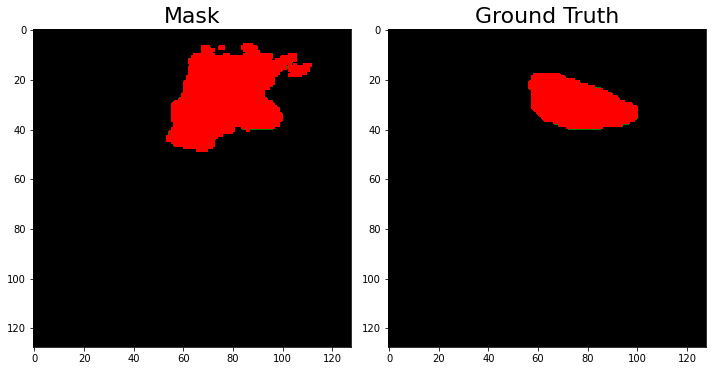

DICE for patient benign_212_seg.png: 0.608 


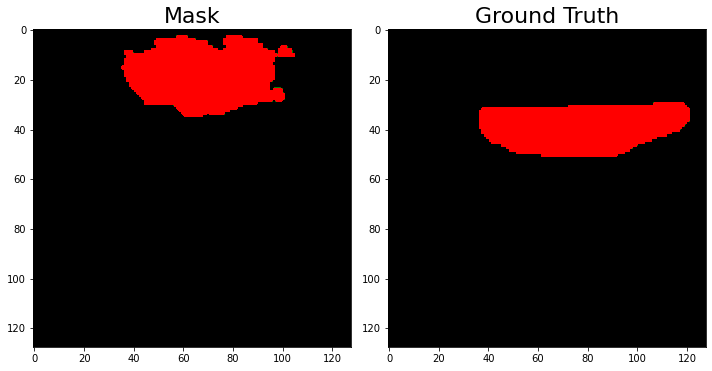

DICE for patient benign_343_seg.png: 0.036 


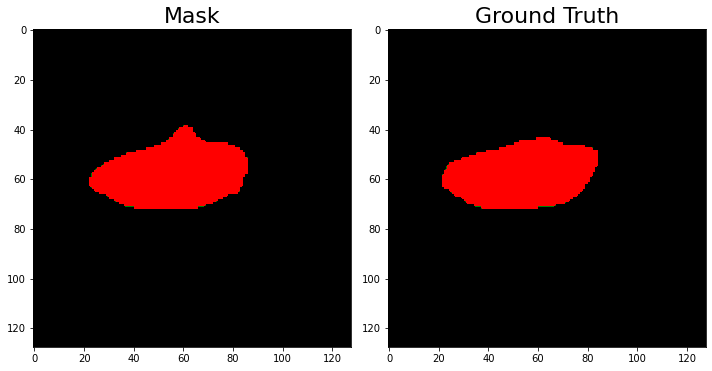

DICE for patient benign_196_seg.png: 0.938 


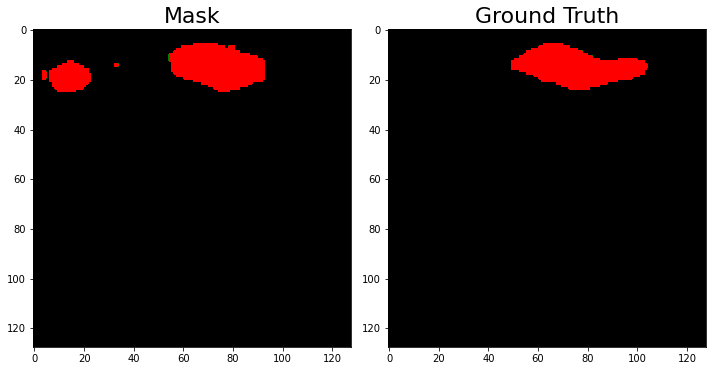

DICE for patient benign_145_seg.png: 0.751 


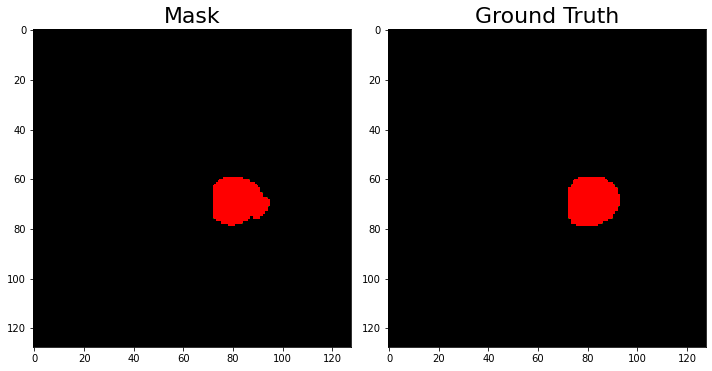

DICE for patient benign_102_seg.png: 0.938 


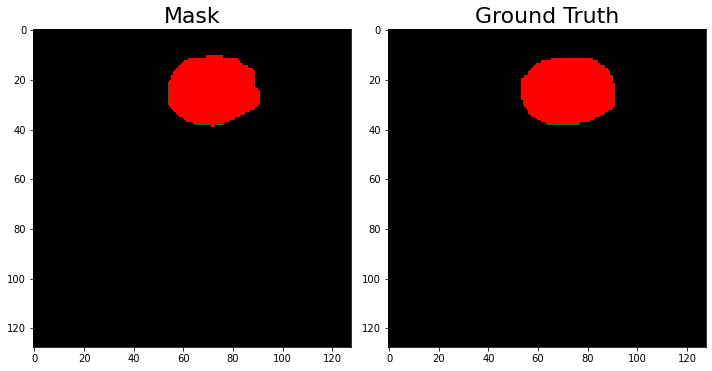

DICE for patient malignant_61_seg.png: 0.97 


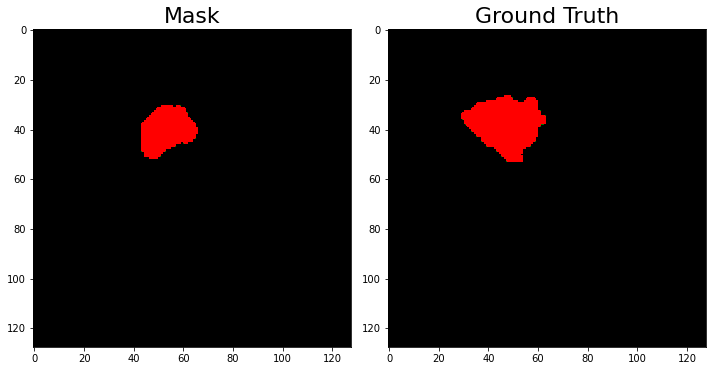

DICE for patient benign_36_seg.png: 0.636 


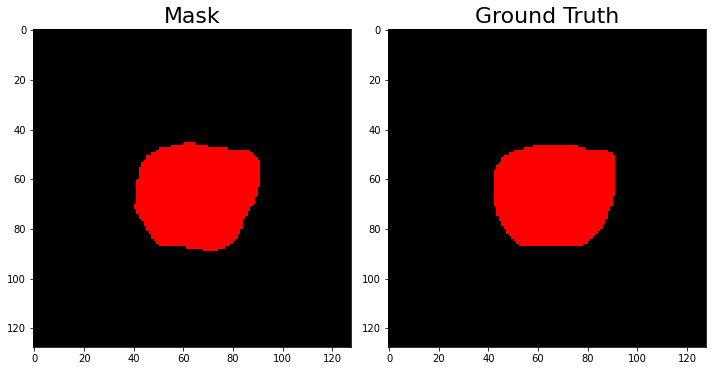

DICE for patient benign_370_seg.png: 0.964 


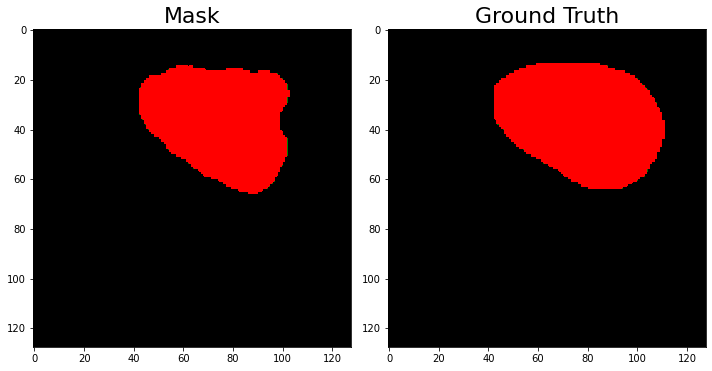

DICE for patient benign_184_seg.png: 0.917 


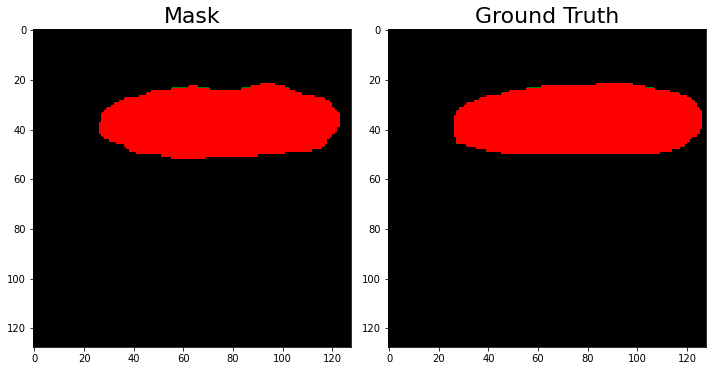

DICE for patient benign_383_seg.png: 0.948 


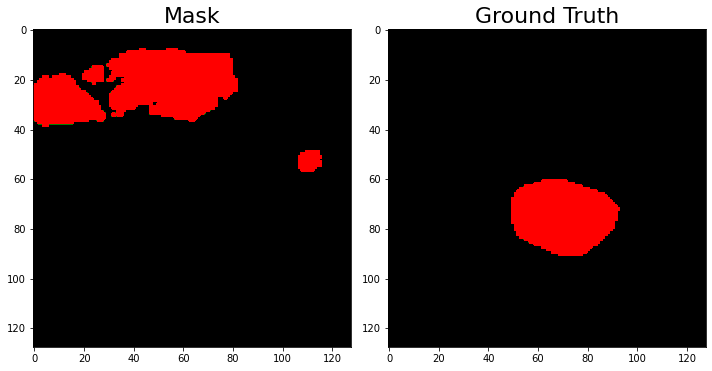

DICE for patient benign_125_seg.png: 0.0 


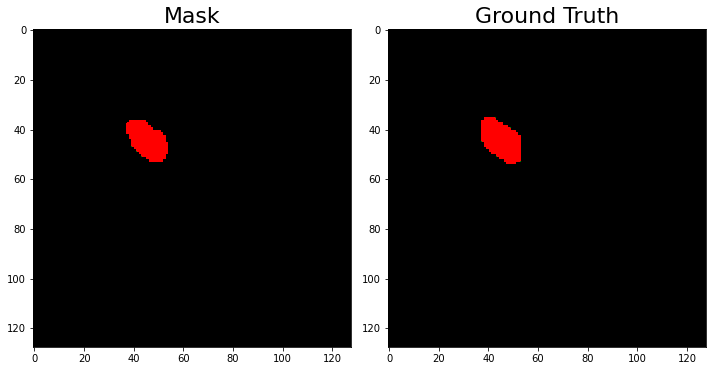

DICE for patient malignant_140_seg.png: 0.927 


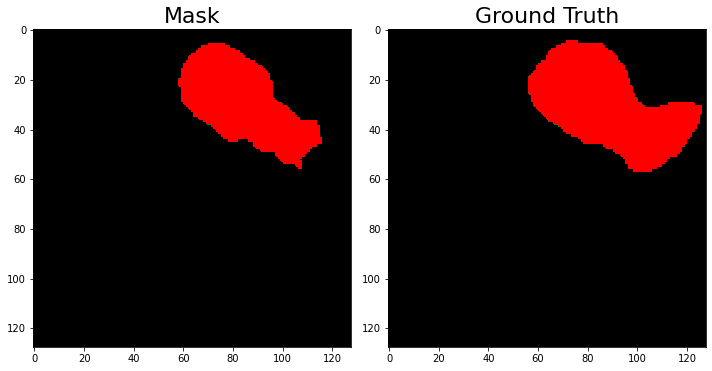

DICE for patient malignant_181_seg.png: 0.856 


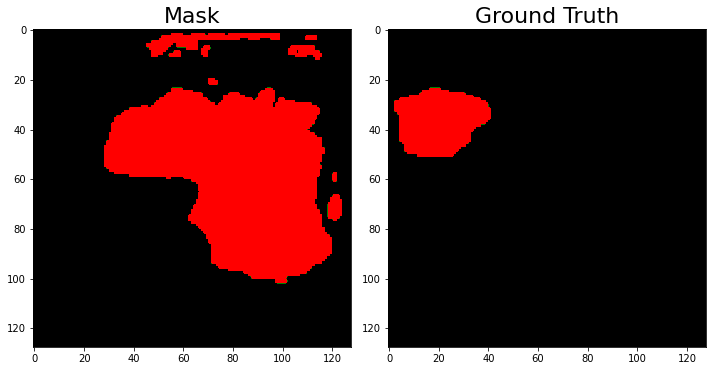

DICE for patient benign_392_seg.png: 0.019 


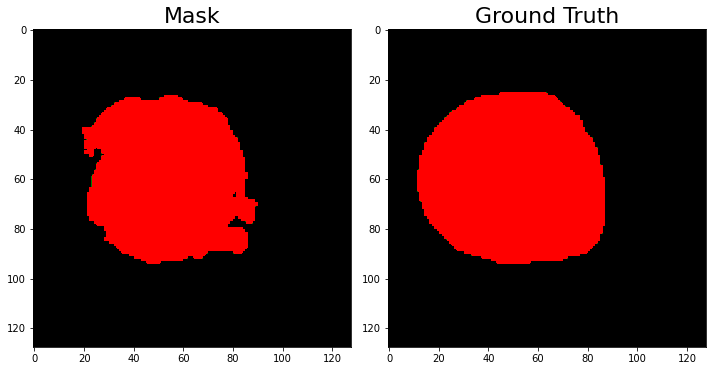

DICE for patient benign_31_seg.png: 0.909 


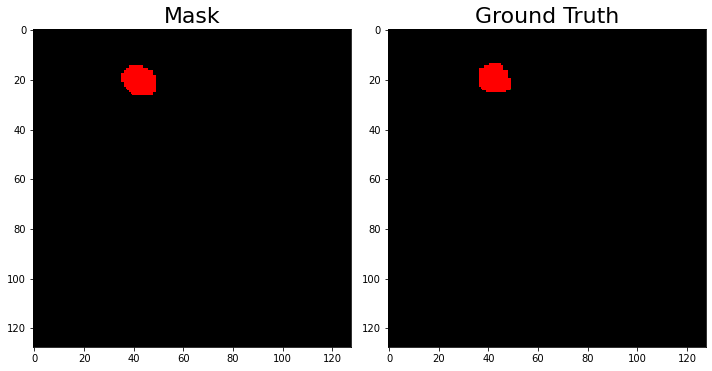

DICE for patient benign_61_seg.png: 0.901 


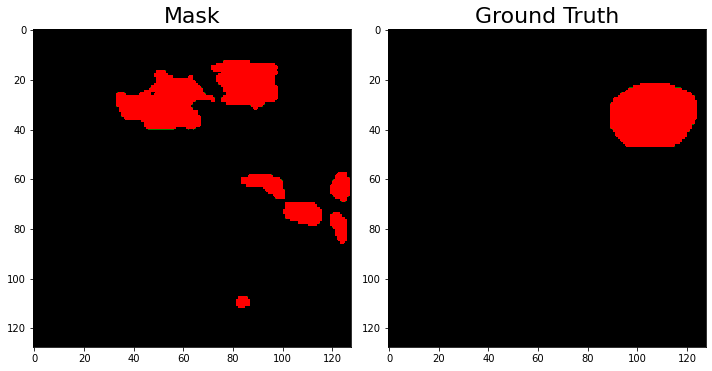

DICE for patient benign_362_seg.png: 0.024 


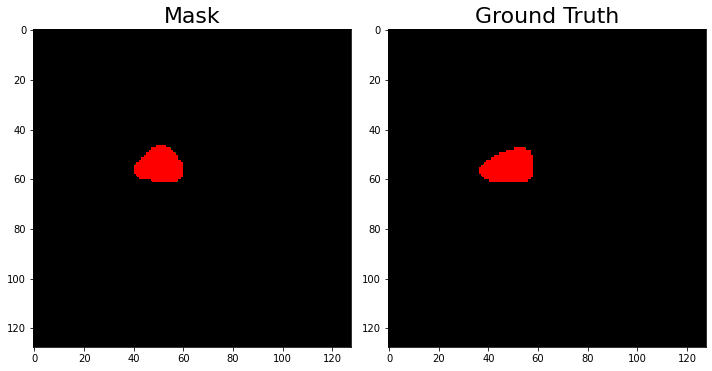

DICE for patient benign_381_seg.png: 0.85 


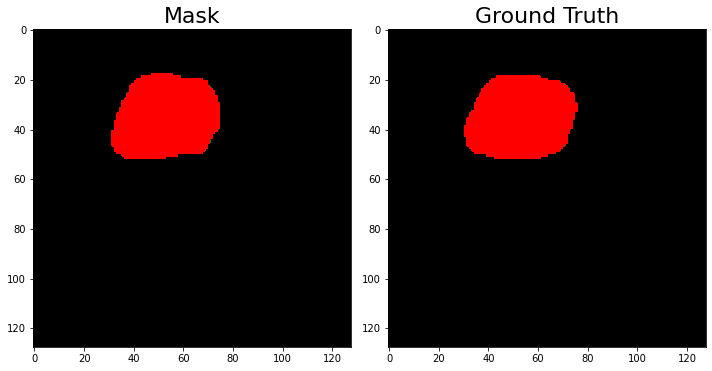

DICE for patient benign_108_seg.png: 0.966 


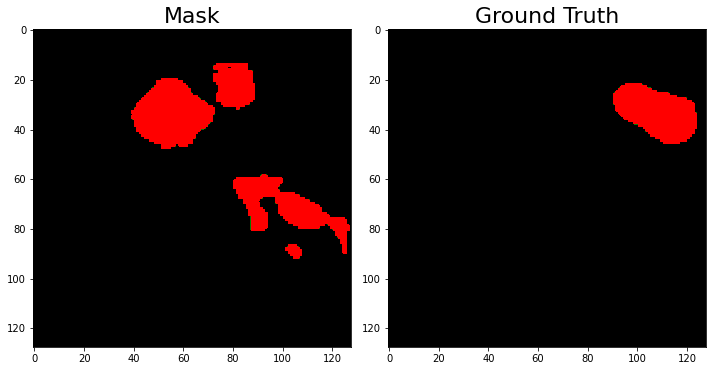

DICE for patient malignant_200_seg.png: 0.0 


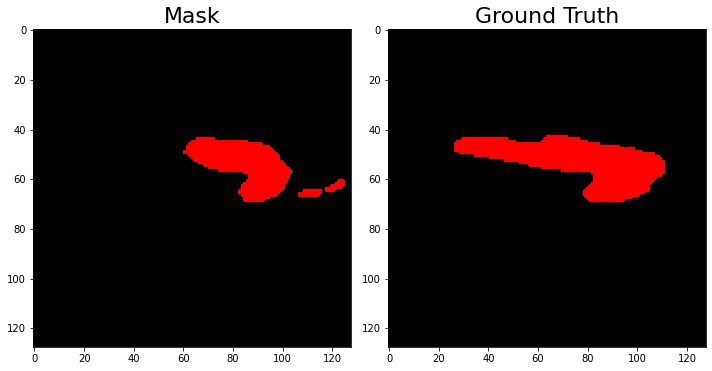

DICE for patient malignant_53_seg.png: 0.679 


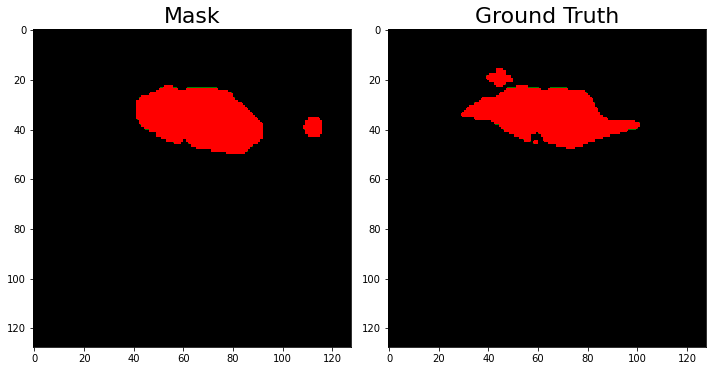

DICE for patient benign_100_seg.png: 0.84 


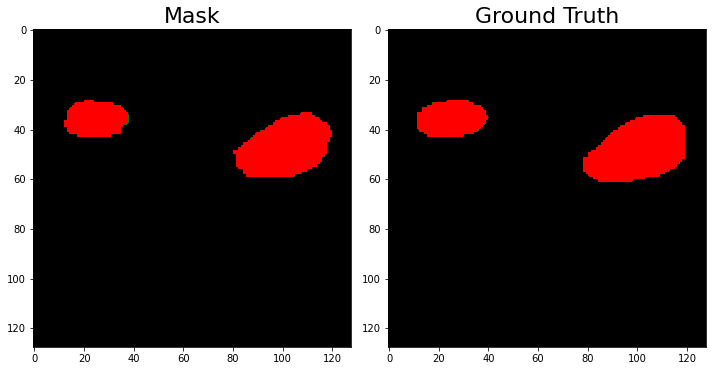

DICE for patient benign_416_seg.png: 0.922 


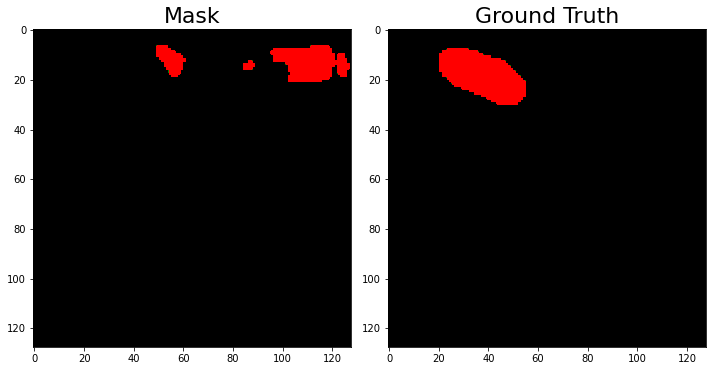

DICE for patient benign_409_seg.png: 0.0 


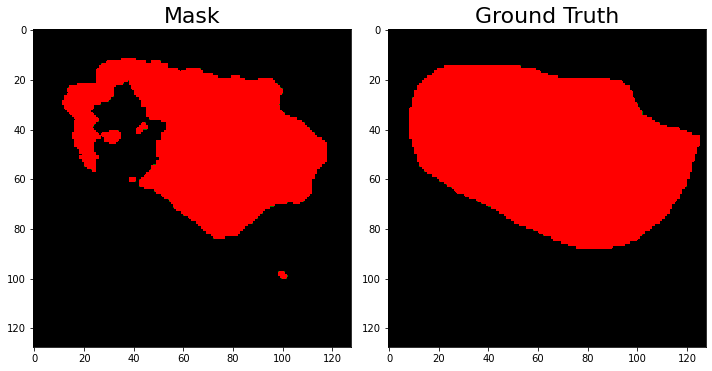

DICE for patient malignant_2_seg.png: 0.779 


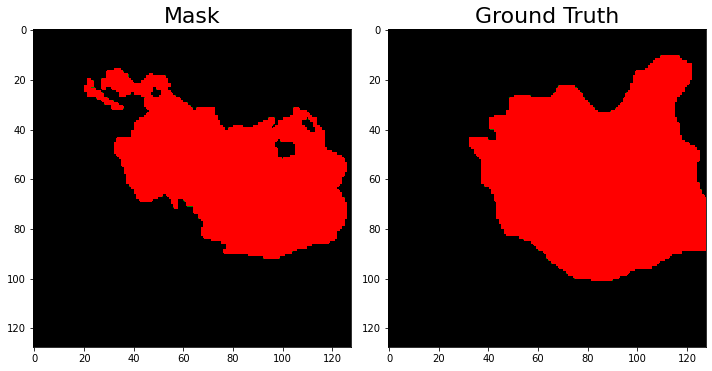

DICE for patient benign_72_seg.png: 0.785 


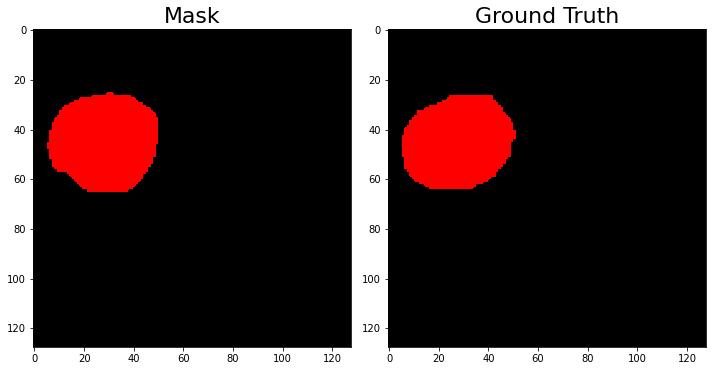

DICE for patient malignant_204_seg.png: 0.946 


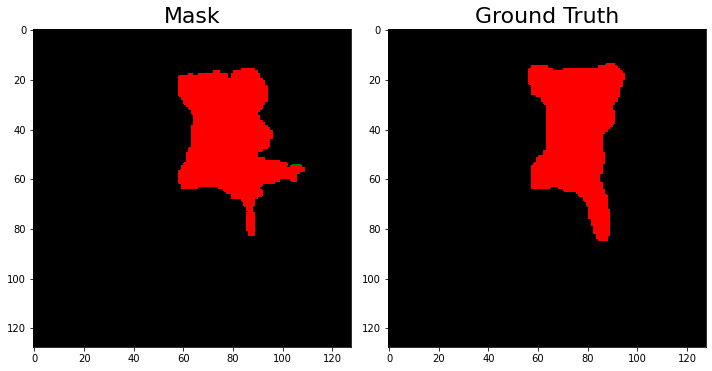

DICE for patient malignant_162_seg.png: 0.827 


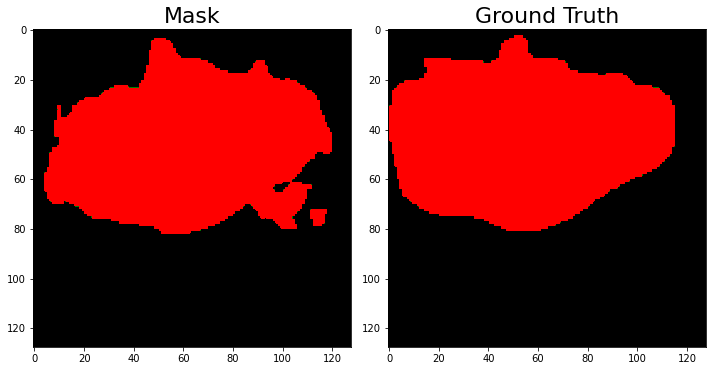

DICE for patient malignant_27_seg.png: 0.889 


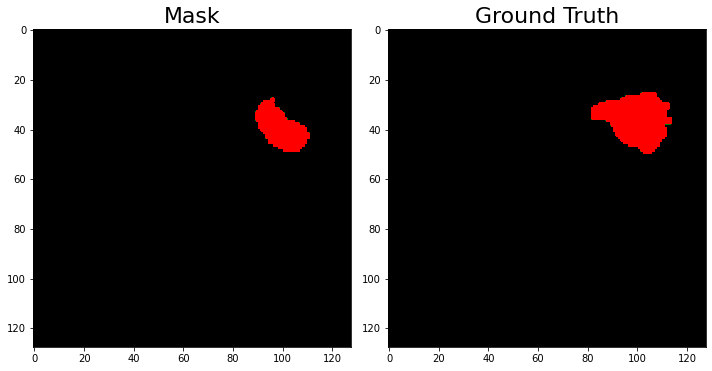

DICE for patient benign_436_seg.png: 0.674 


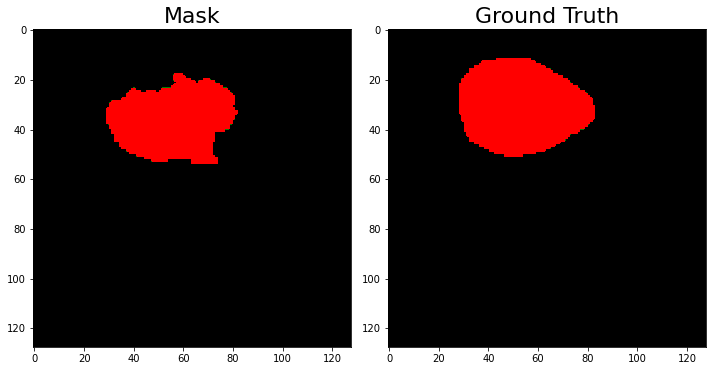

DICE for patient malignant_177_seg.png: 0.801 


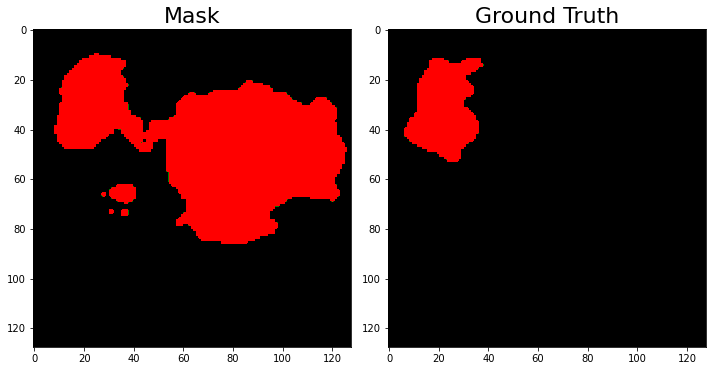

DICE for patient benign_407_seg.png: 0.267 


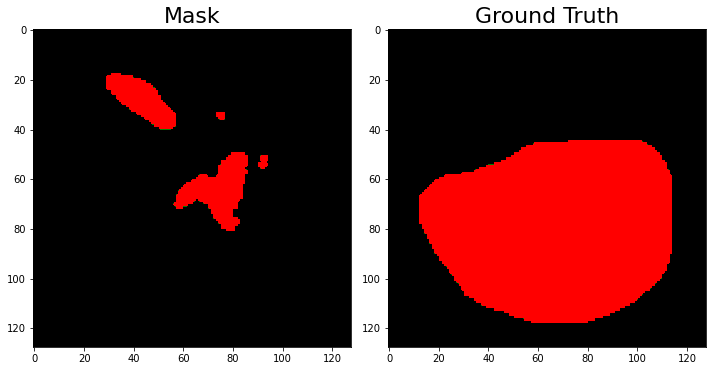

DICE for patient benign_41_seg.png: 0.128 


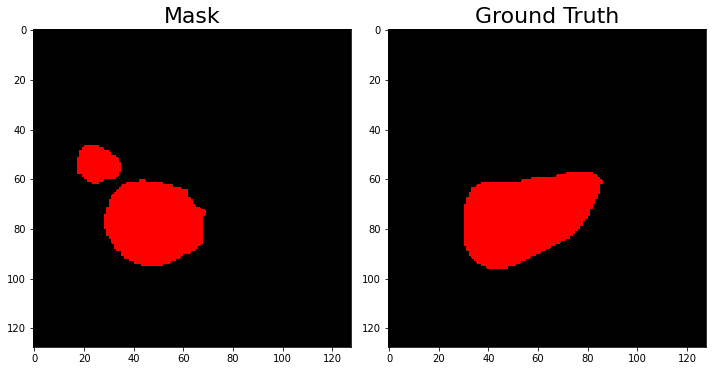

DICE for patient malignant_104_seg.png: 0.741 


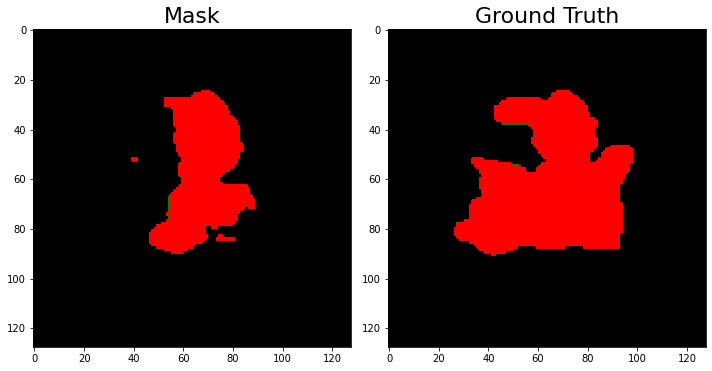

DICE for patient benign_338_seg.png: 0.65 


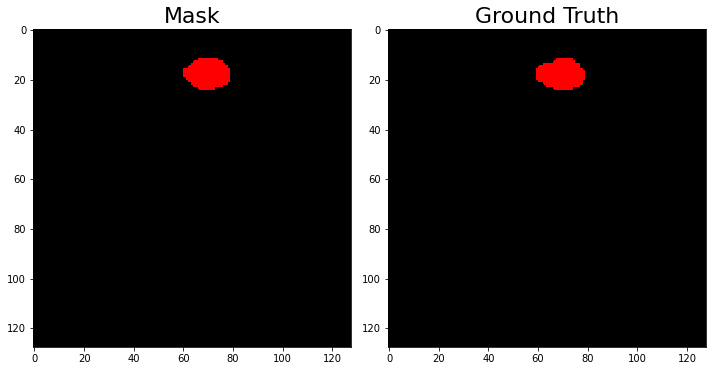

DICE for patient malignant_189_seg.png: 0.937 


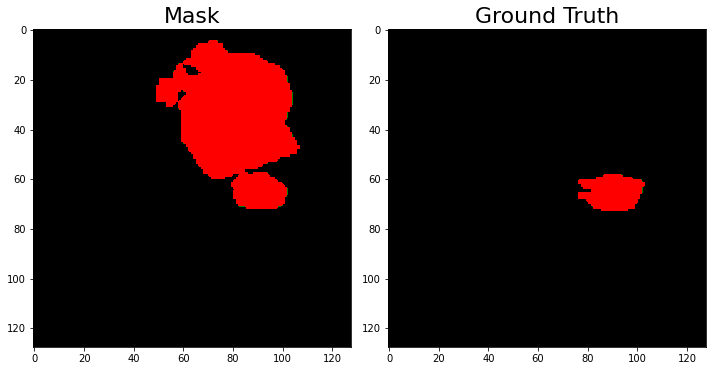

DICE for patient malignant_60_seg.png: 0.178 


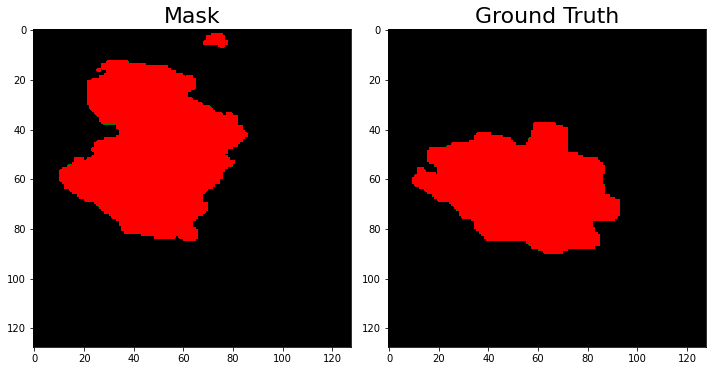

DICE for patient malignant_203_seg.png: 0.65 


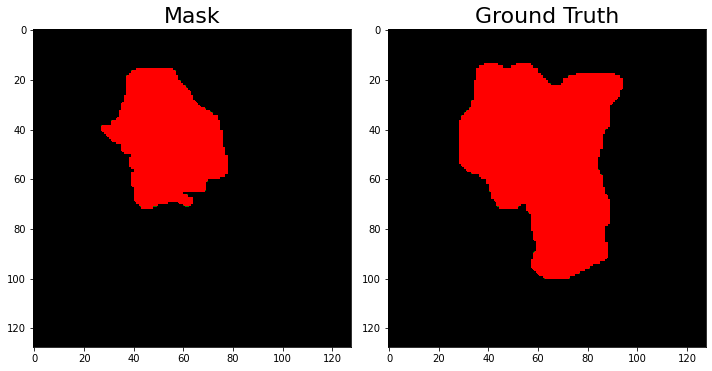

DICE for patient benign_386_seg.png: 0.641 


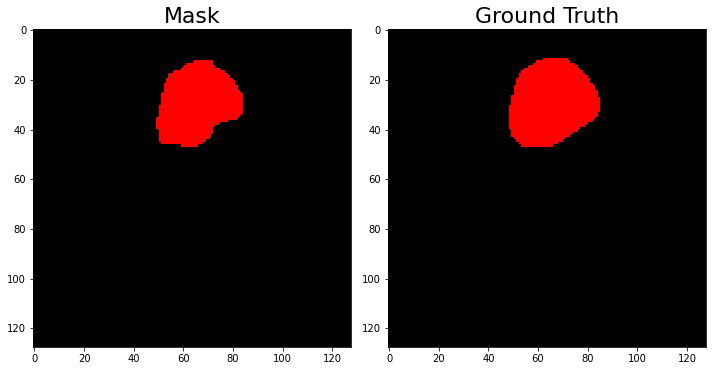

DICE for patient benign_360_seg.png: 0.926 


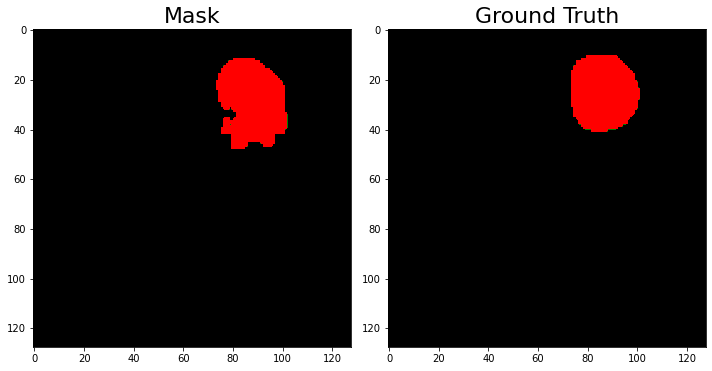

DICE for patient benign_71_seg.png: 0.815 


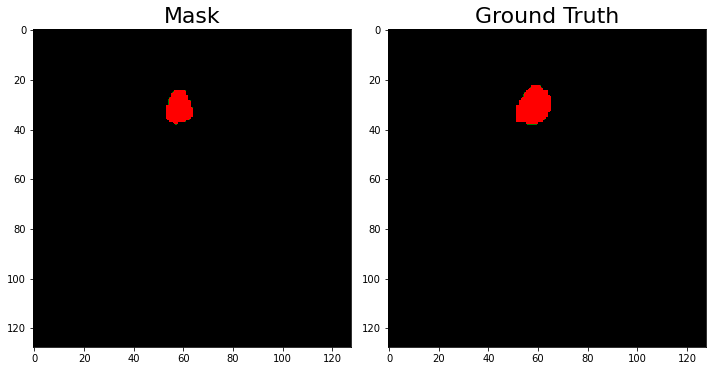

DICE for patient benign_418_seg.png: 0.782 


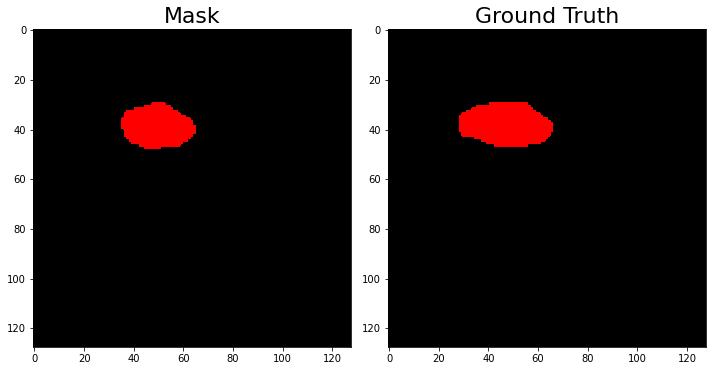

DICE for patient benign_148_seg.png: 0.853 


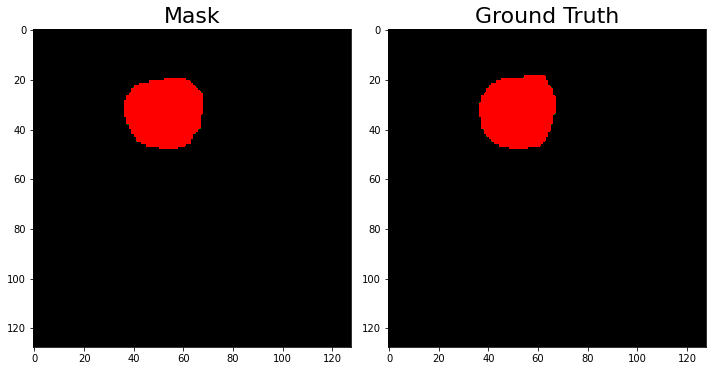

DICE for patient benign_124_seg.png: 0.959 


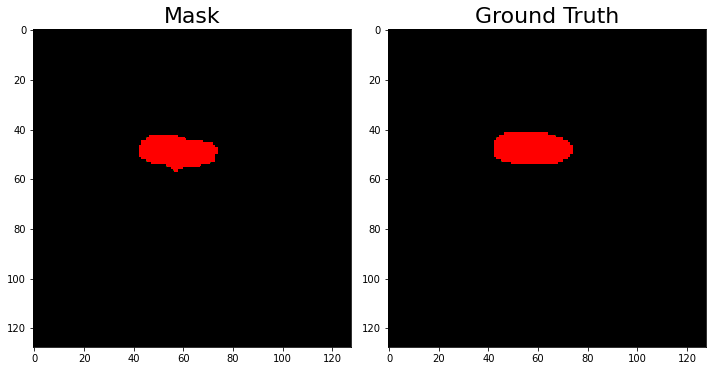

DICE for patient benign_143_seg.png: 0.879 


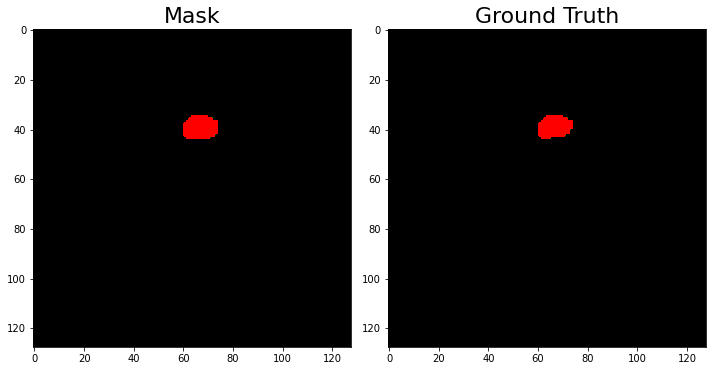

DICE for patient benign_371_seg.png: 0.947 


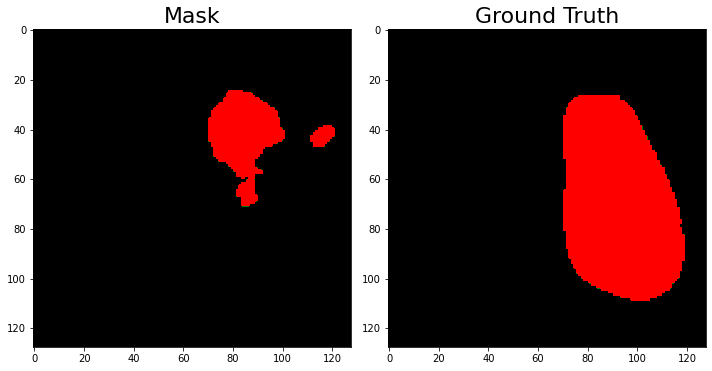

DICE for patient benign_349_seg.png: 0.372 


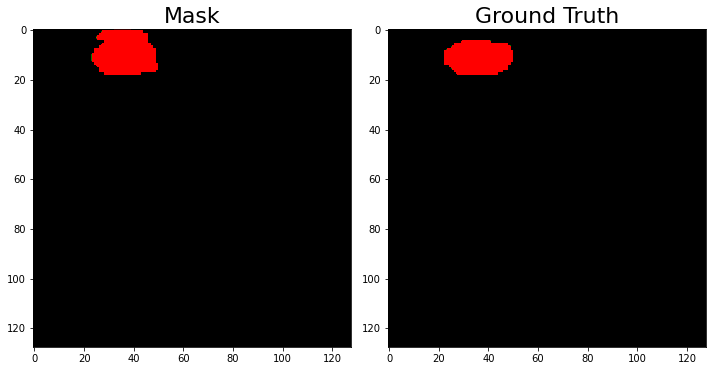

DICE for patient malignant_41_seg.png: 0.832 


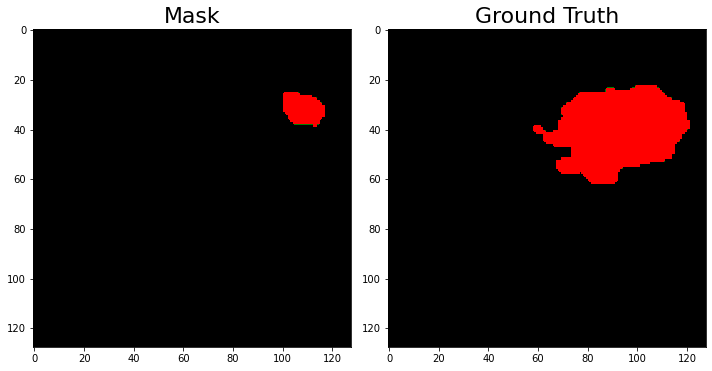

DICE for patient benign_352_seg.png: 0.188 


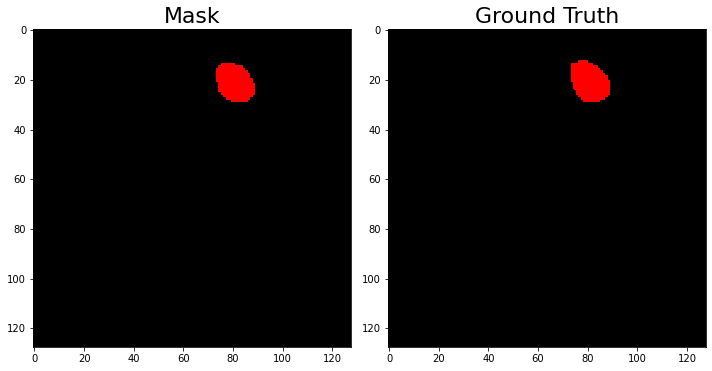

DICE for patient malignant_166_seg.png: 0.966 


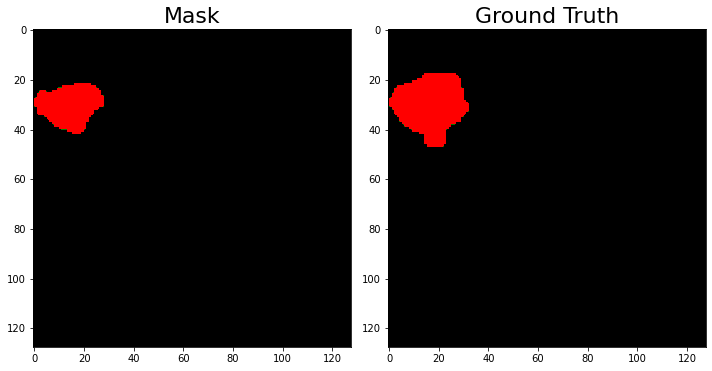

DICE for patient malignant_159_seg.png: 0.743 


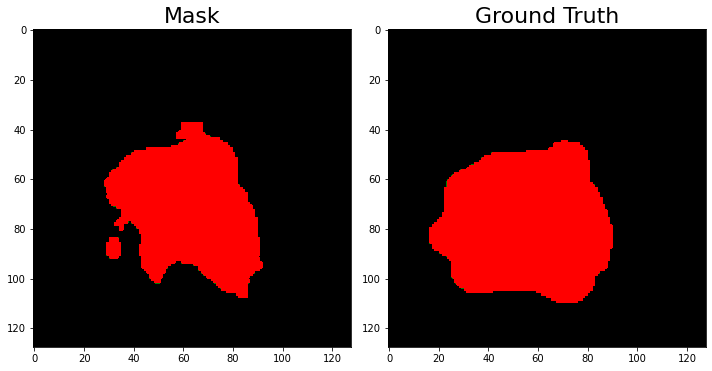

DICE for patient benign_388_seg.png: 0.793 


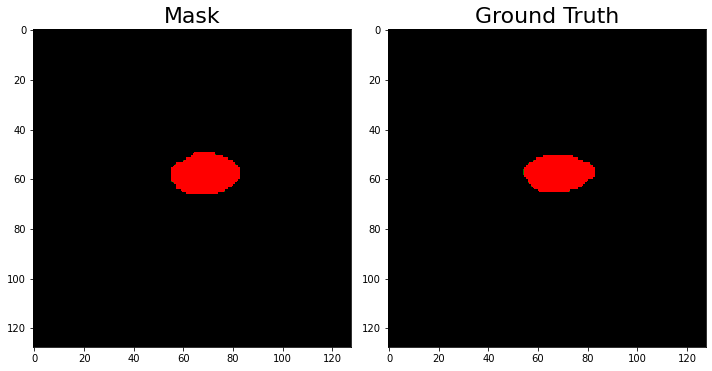

DICE for patient benign_43_seg.png: 0.918 


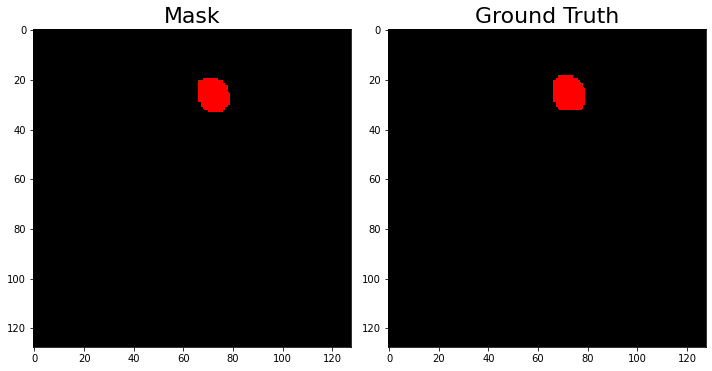

DICE for patient malignant_58_seg.png: 0.931 


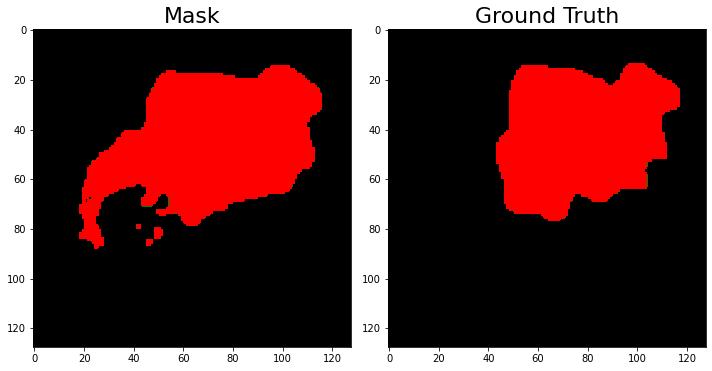

DICE for patient benign_354_seg.png: 0.87 


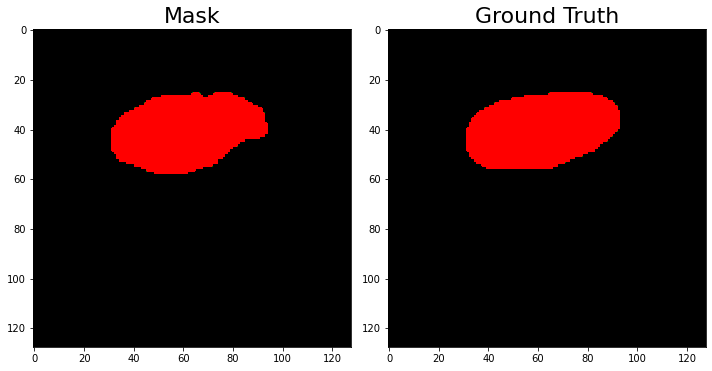

DICE for patient benign_107_seg.png: 0.954 


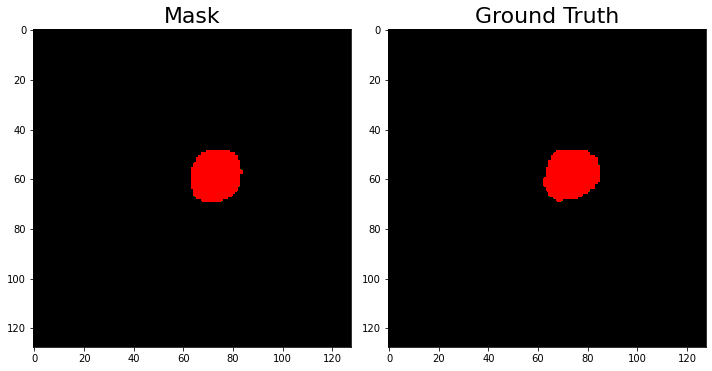

DICE for patient benign_243_seg.png: 0.939 


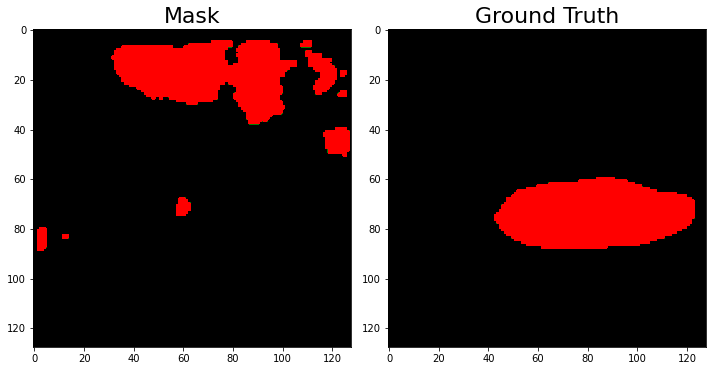

DICE for patient malignant_155_seg.png: 0.015 


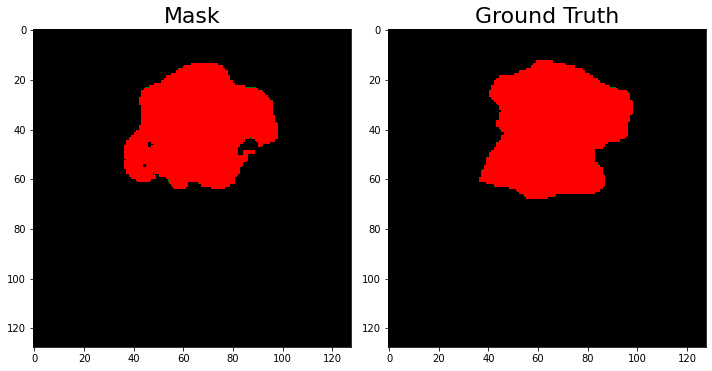

DICE for patient malignant_171_seg.png: 0.885 


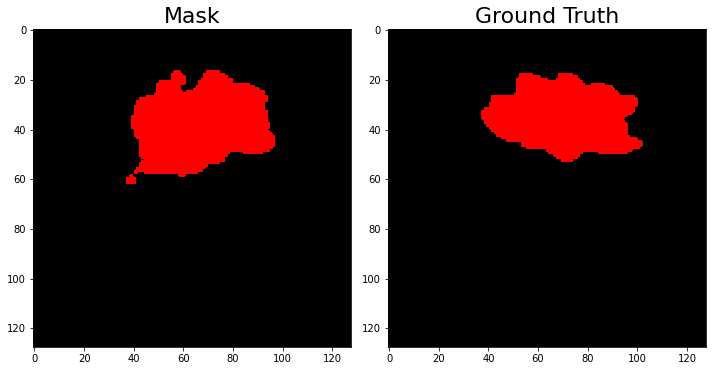

DICE for patient malignant_57_seg.png: 0.849 


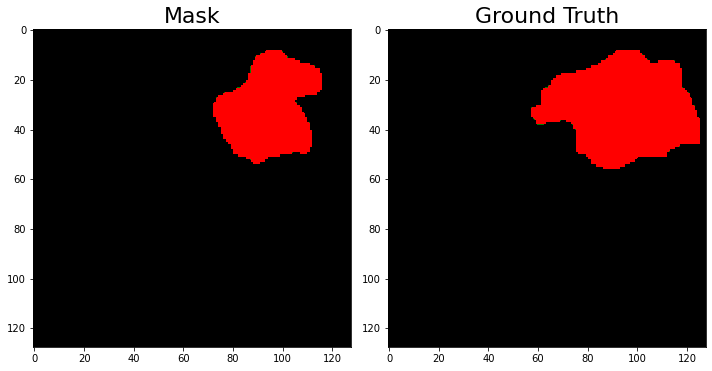

DICE for patient benign_384_seg.png: 0.757 


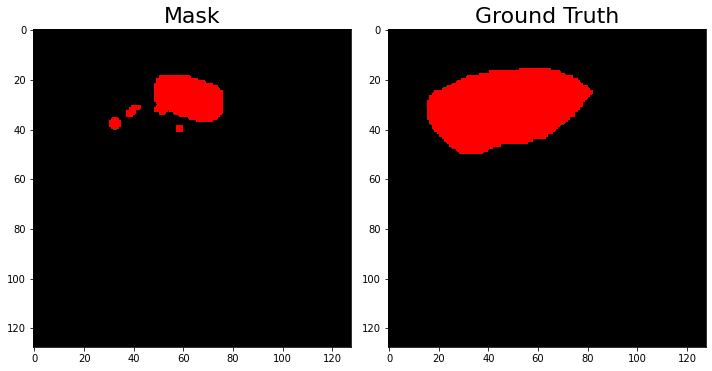

DICE for patient malignant_115_seg.png: 0.416 


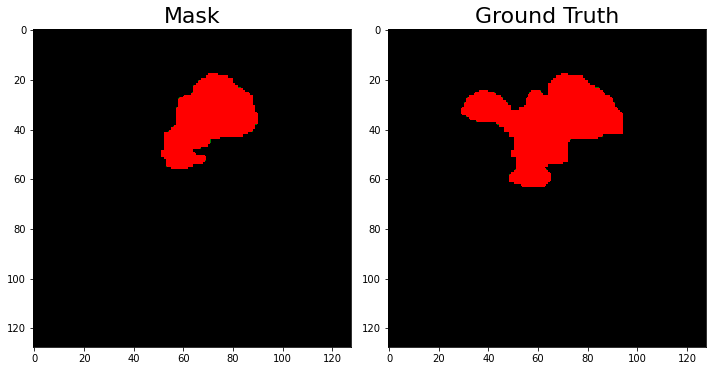

DICE for patient malignant_190_seg.png: 0.75 


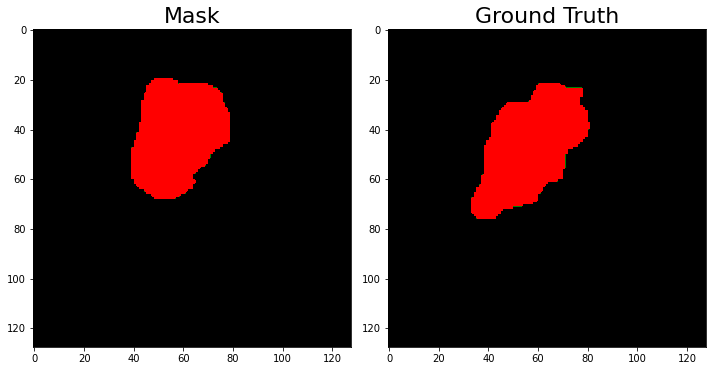

DICE for patient malignant_86_seg.png: 0.854 


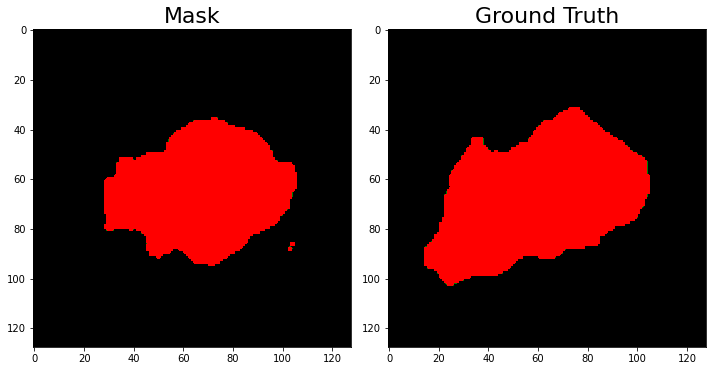

DICE for patient malignant_201_seg.png: 0.842 


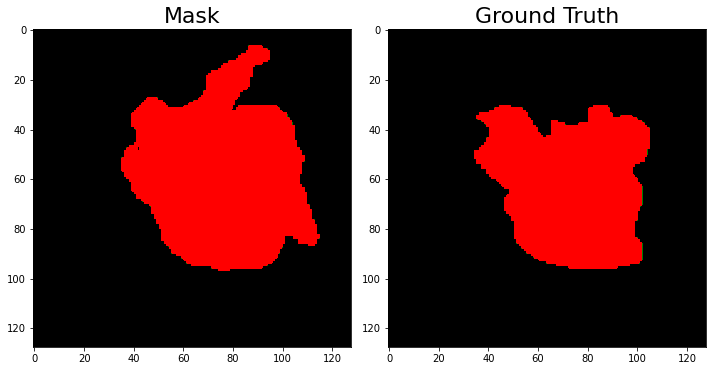

DICE for patient benign_387_seg.png: 0.85 


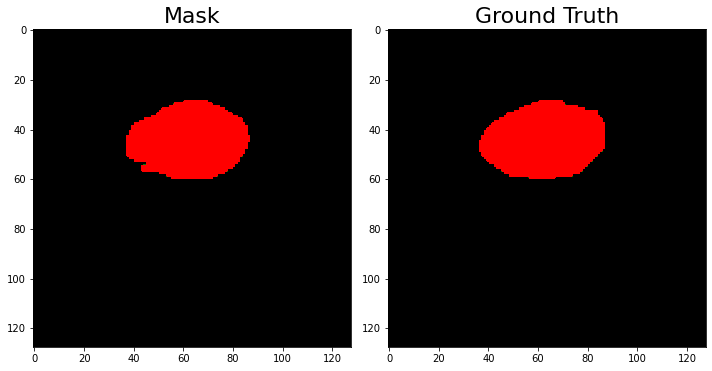

DICE for patient malignant_194_seg.png: 0.969 


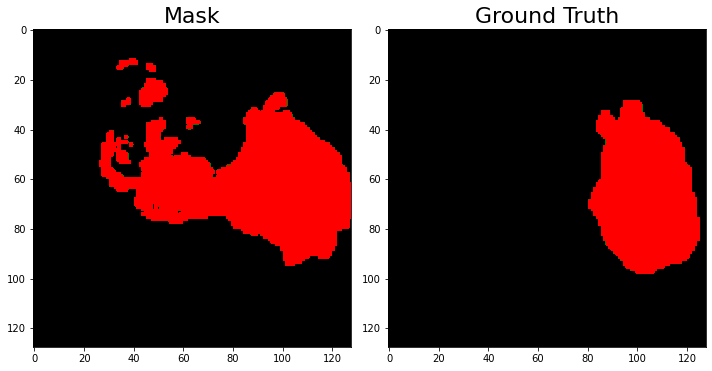

DICE for patient benign_59_seg.png: 0.681 


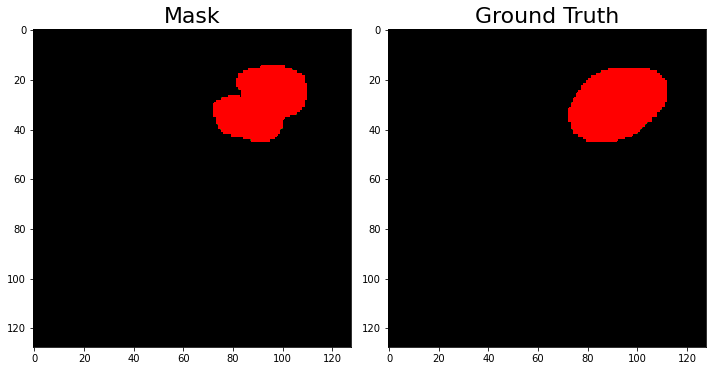

DICE for patient benign_171_seg.png: 0.91 


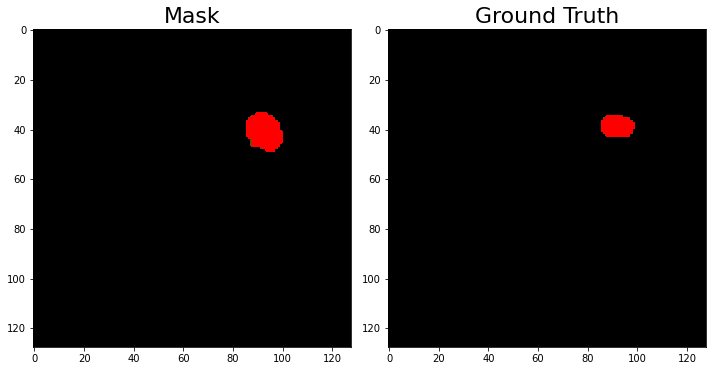

DICE for patient benign_361_seg.png: 0.705 


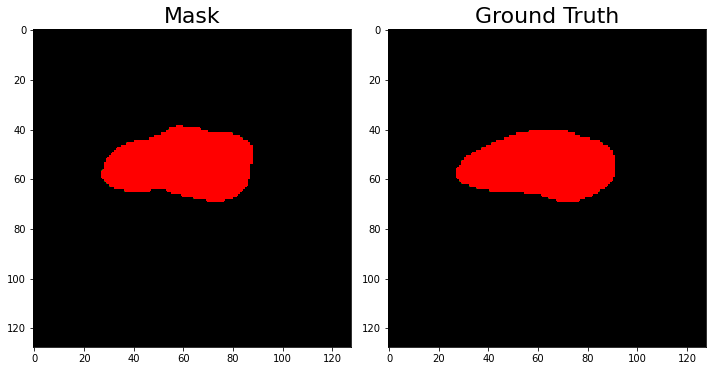

DICE for patient benign_120_seg.png: 0.949 


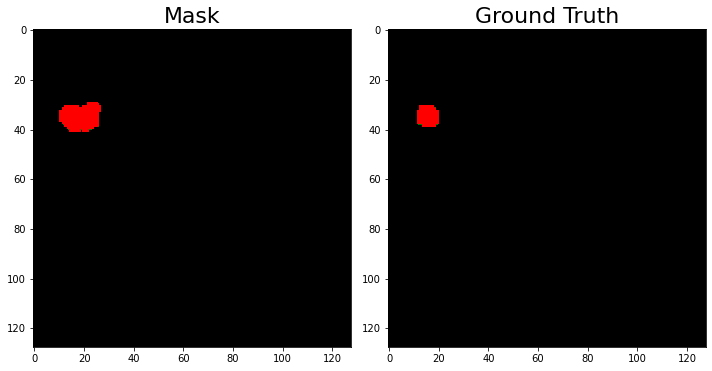

DICE for patient malignant_149_seg.png: 0.589 


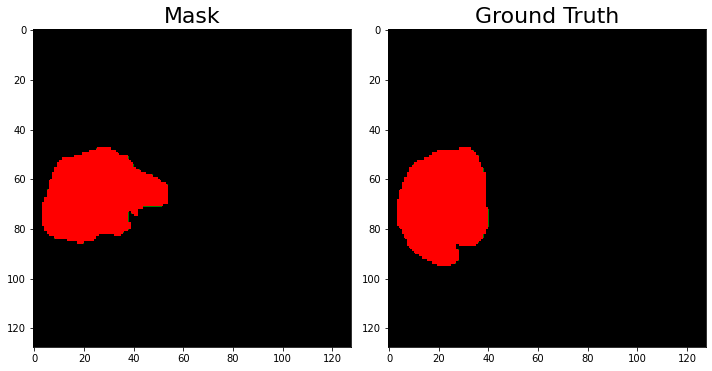

DICE for patient benign_401_seg.png: 0.824 


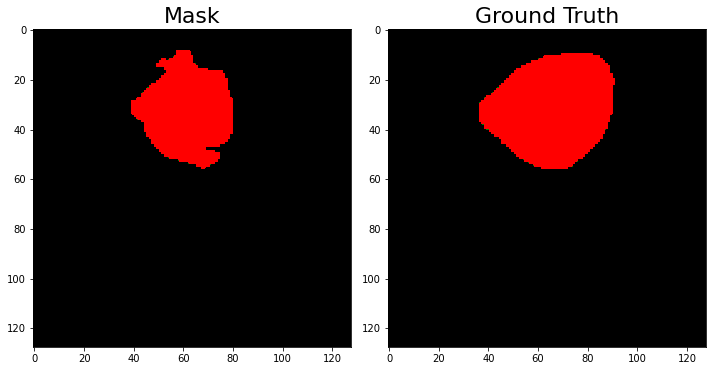

DICE for patient benign_379_seg.png: 0.782 


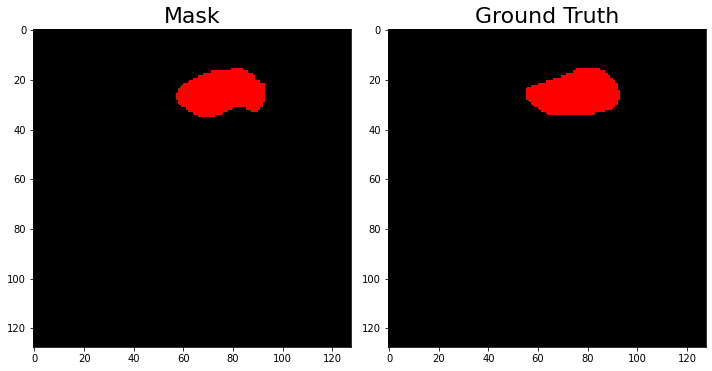

DICE for patient benign_95_seg.png: 0.923 


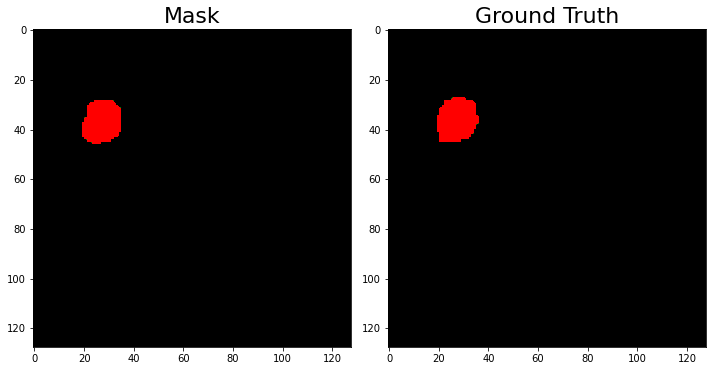

DICE for patient benign_169_seg.png: 0.925 


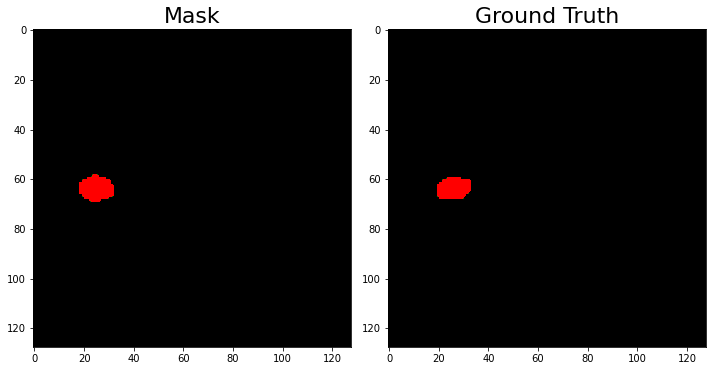

DICE for patient benign_174_seg.png: 0.879 


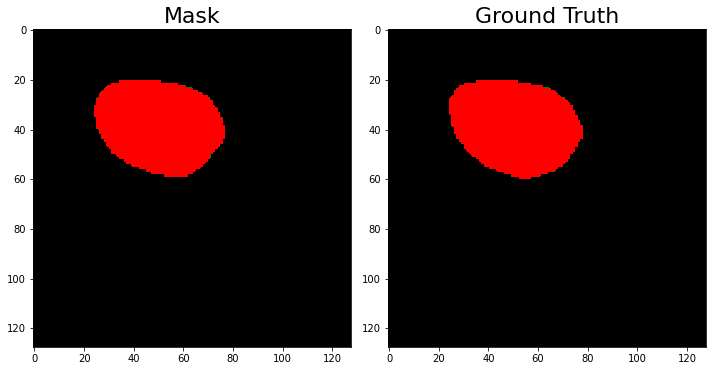

DICE for patient malignant_135_seg.png: 0.979 


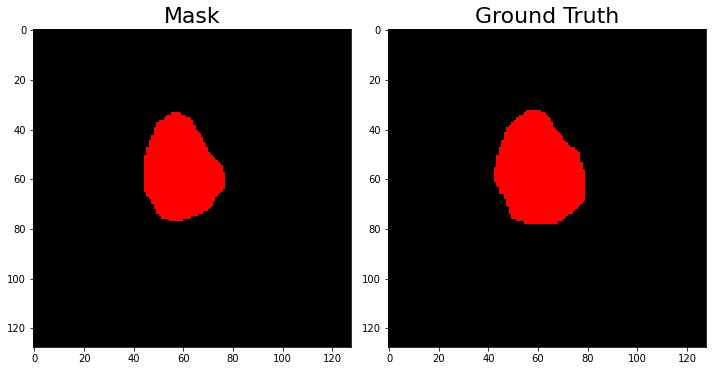

DICE for patient benign_57_seg.png: 0.897 


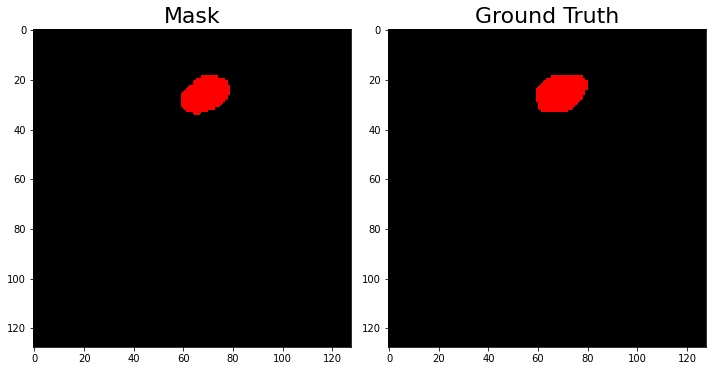

DICE for patient malignant_44_seg.png: 0.925 


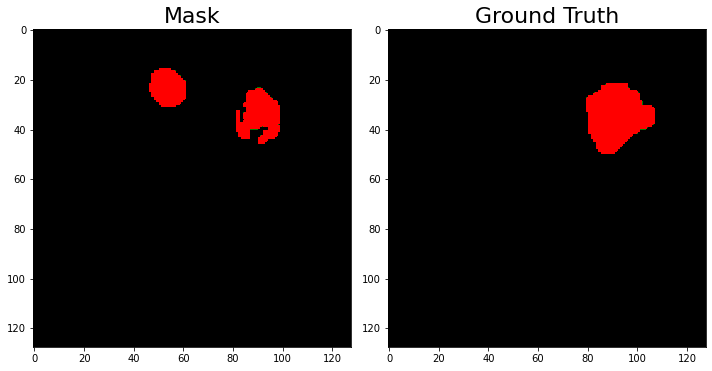

DICE for patient malignant_67_seg.png: 0.506 


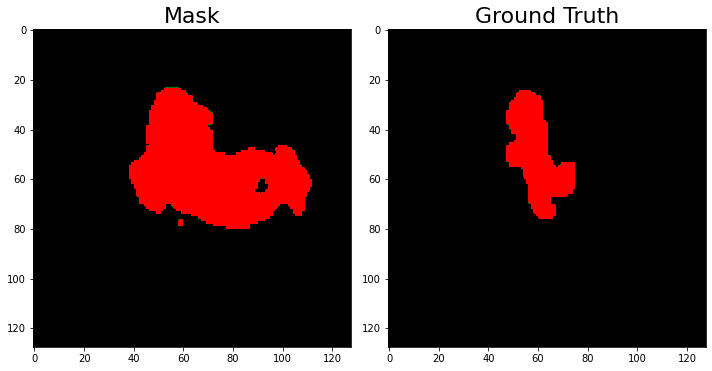

DICE for patient malignant_55_seg.png: 0.47 


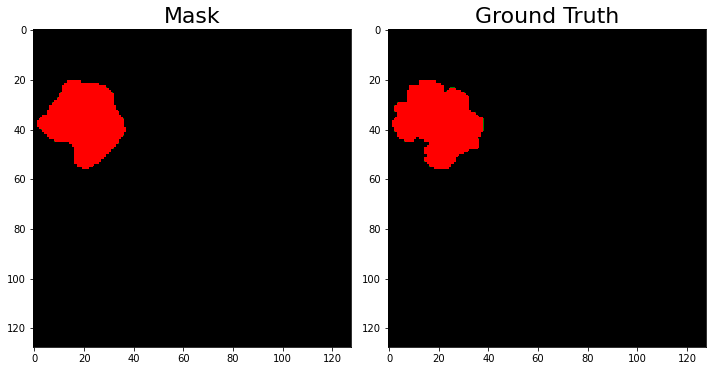

DICE for patient malignant_69_seg.png: 0.918 


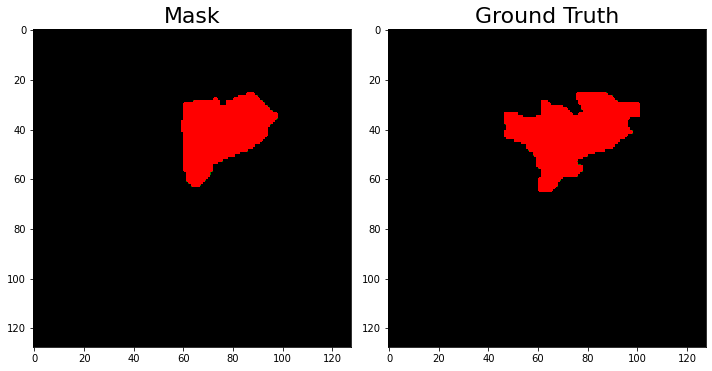

DICE for patient malignant_122_seg.png: 0.824 


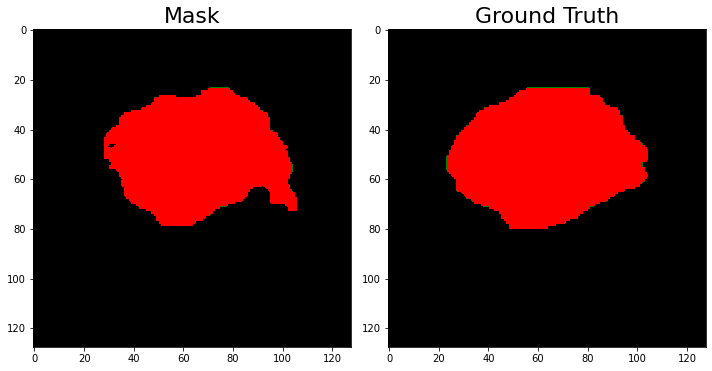

DICE for patient benign_67_seg.png: 0.917 


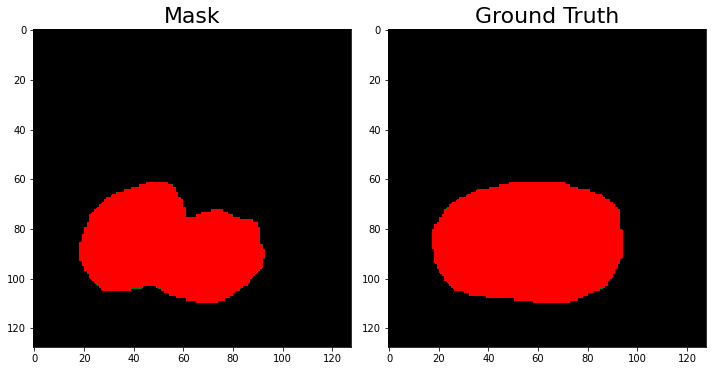

DICE for patient malignant_150_seg.png: 0.896 


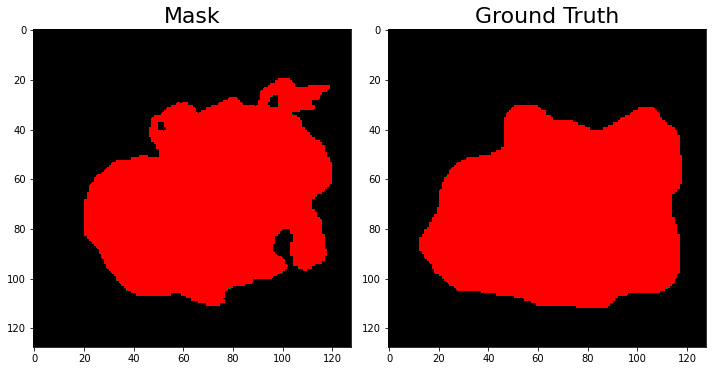

DICE for patient benign_357_seg.png: 0.883 


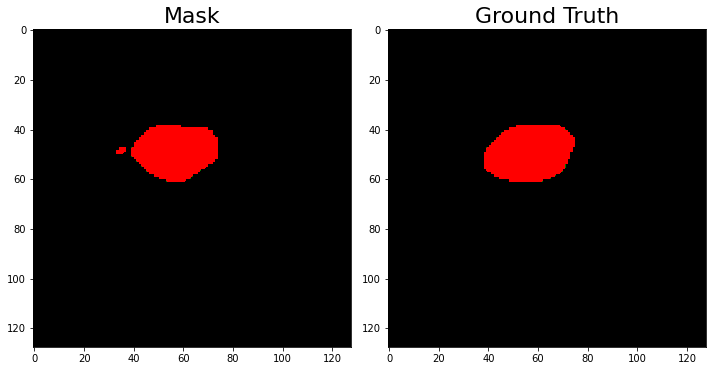

DICE for patient benign_393_seg.png: 0.918 


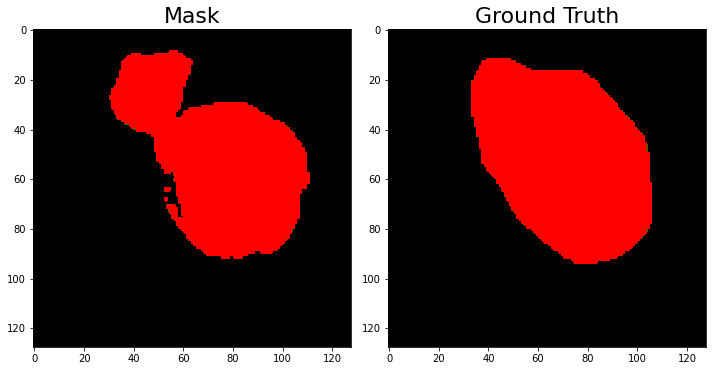

DICE for patient malignant_195_seg.png: 0.856 


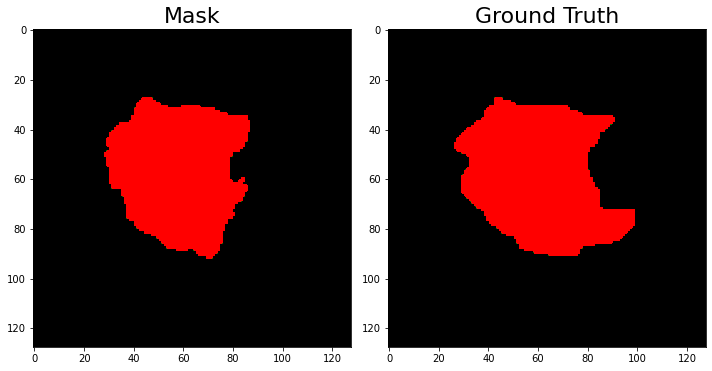

DICE for patient malignant_35_seg.png: 0.913 


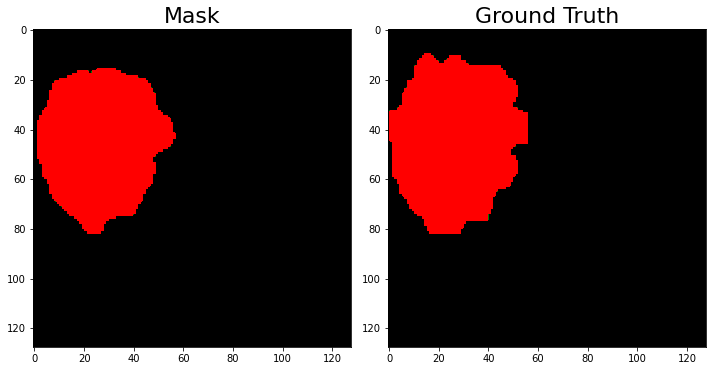

DICE for patient benign_116_seg.png: 0.927 


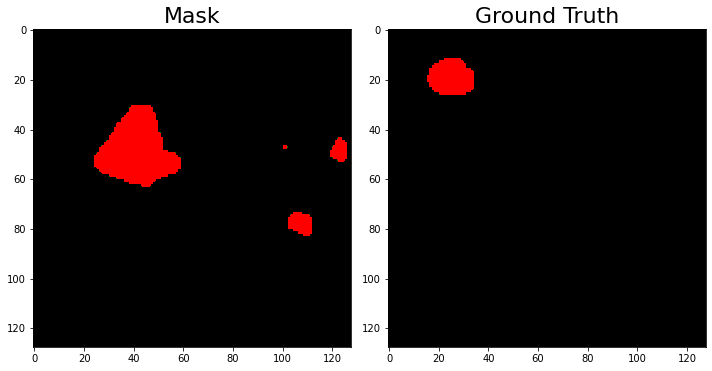

DICE for patient malignant_183_seg.png: 0.0 


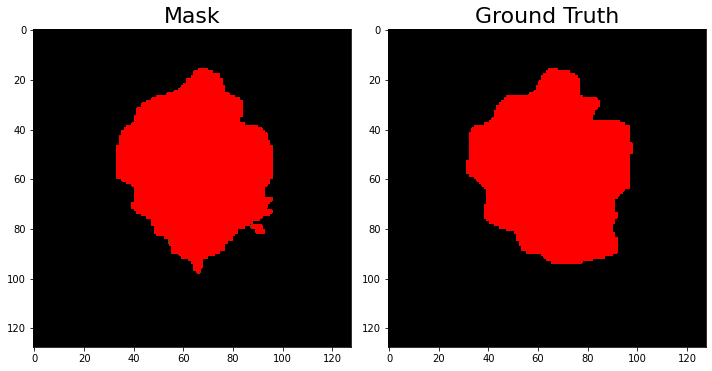

DICE for patient malignant_184_seg.png: 0.929 


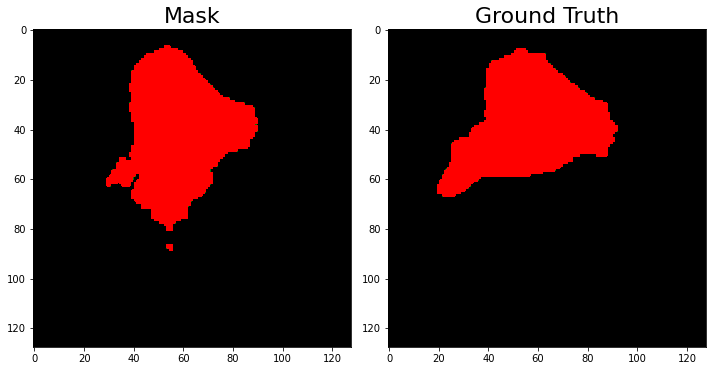

DICE for patient malignant_37_seg.png: 0.8 


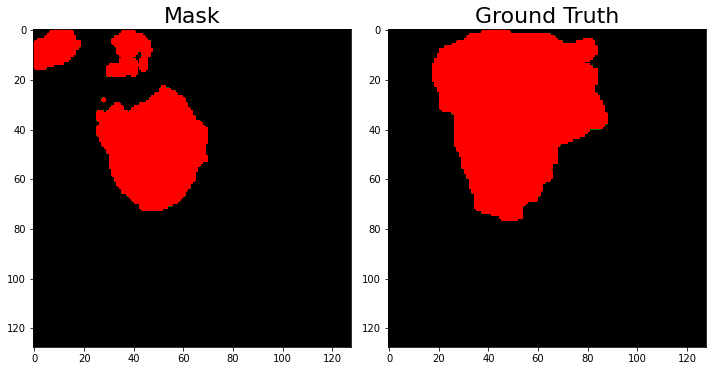

DICE for patient benign_410_seg.png: 0.61 


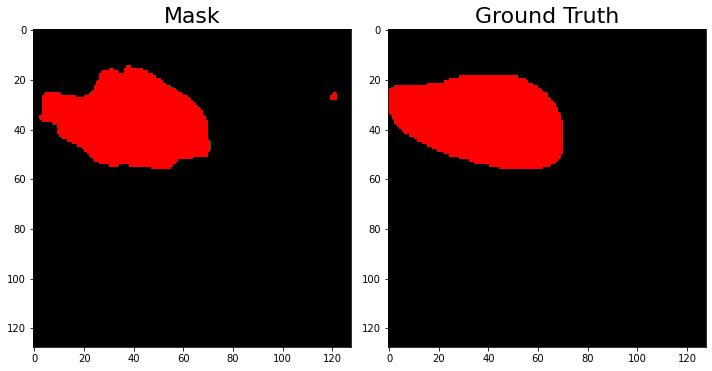

DICE for patient malignant_82_seg.png: 0.909 


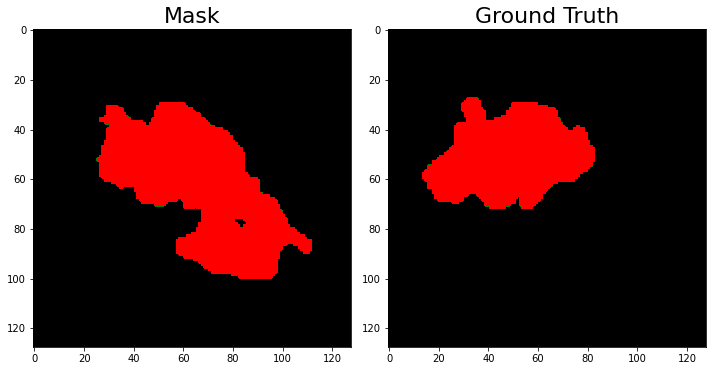

DICE for patient benign_195_seg.png: 0.626 


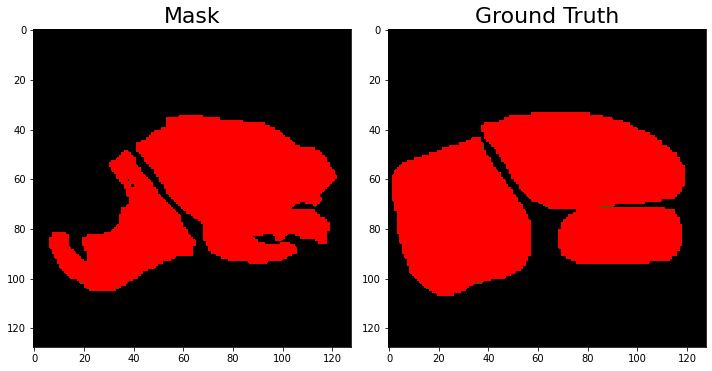

DICE for patient malignant_54_seg.png: 0.803 


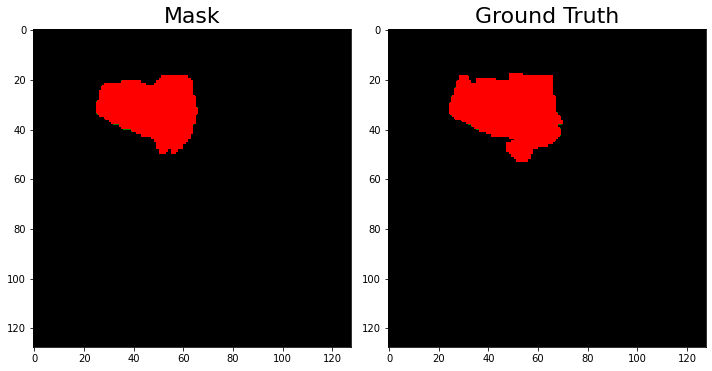

DICE for patient benign_28_seg.png: 0.899 


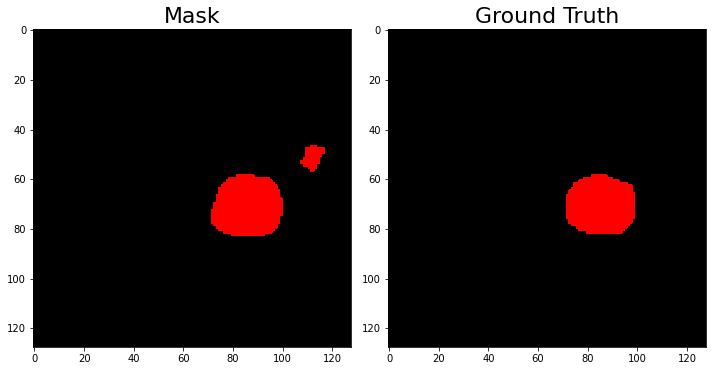

DICE for patient benign_182_seg.png: 0.896 


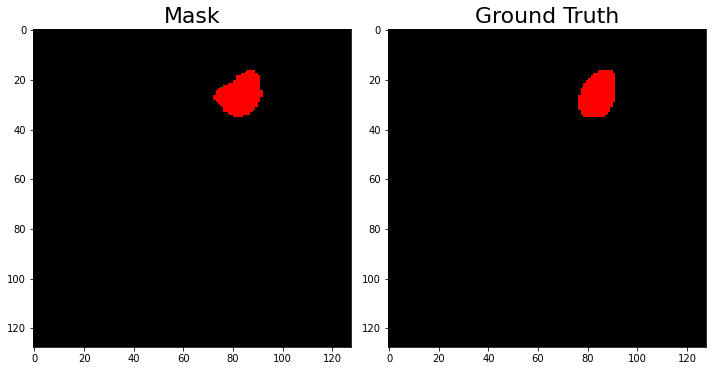

DICE for patient malignant_84_seg.png: 0.903 


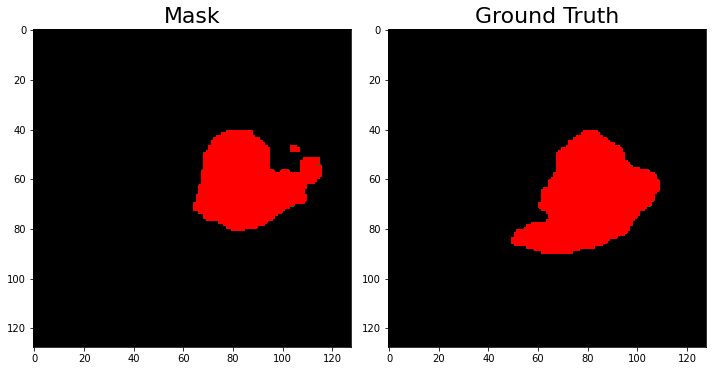

DICE for patient benign_180_seg.png: 0.782 


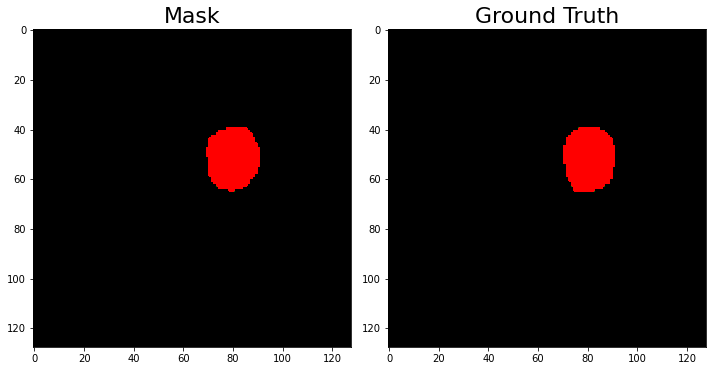

DICE for patient benign_167_seg.png: 0.955 


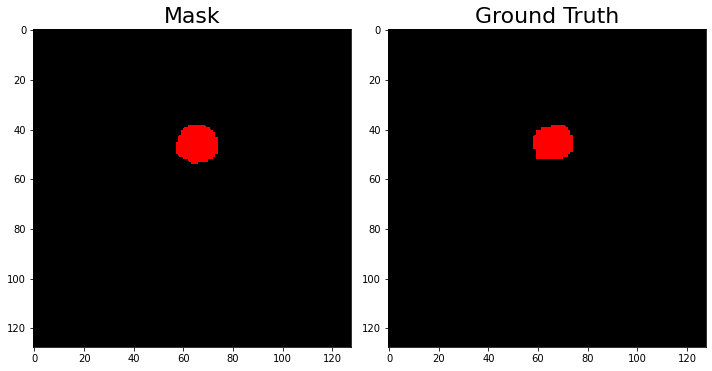

DICE for patient benign_162_seg.png: 0.914 


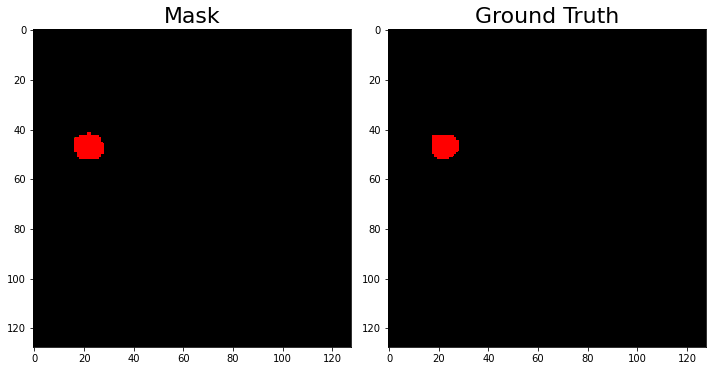

DICE for patient benign_170_seg.png: 0.915 


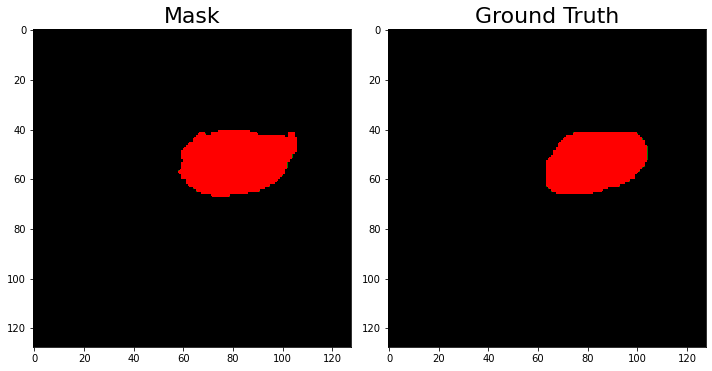

DICE for patient benign_103_seg.png: 0.9 


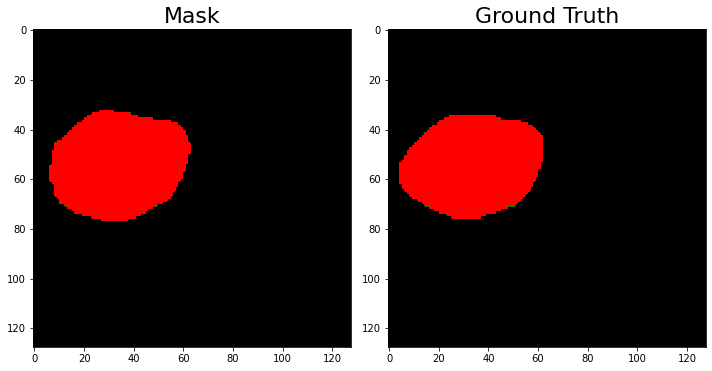

DICE for patient benign_369_seg.png: 0.963 


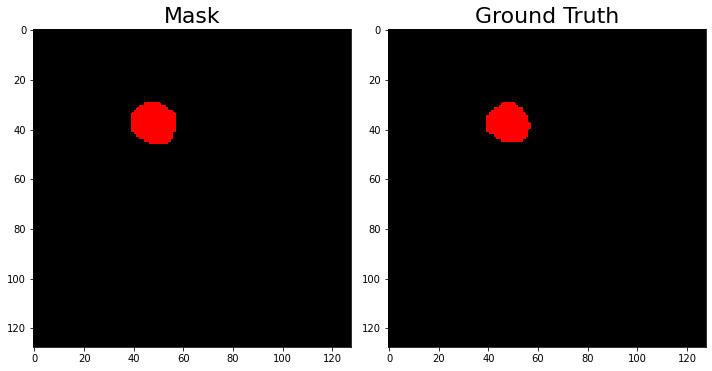

DICE for patient malignant_146_seg.png: 0.935 


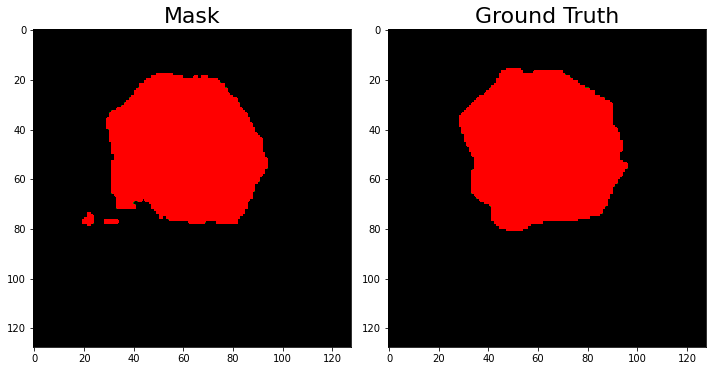

DICE for patient malignant_126_seg.png: 0.928 


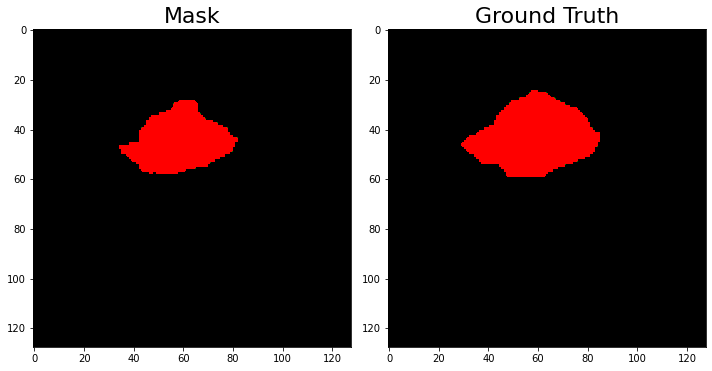

DICE for patient malignant_79_seg.png: 0.811 


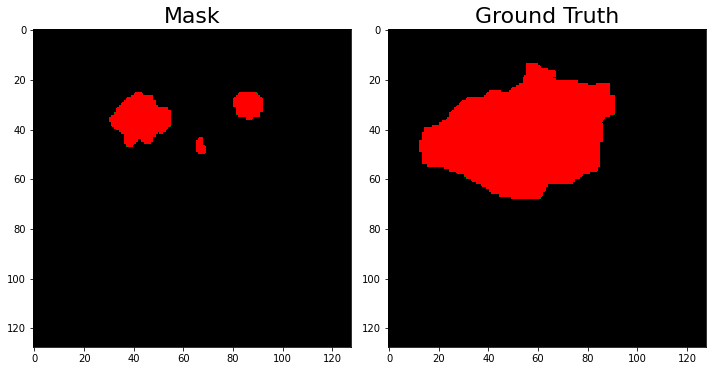

DICE for patient benign_398_seg.png: 0.265 


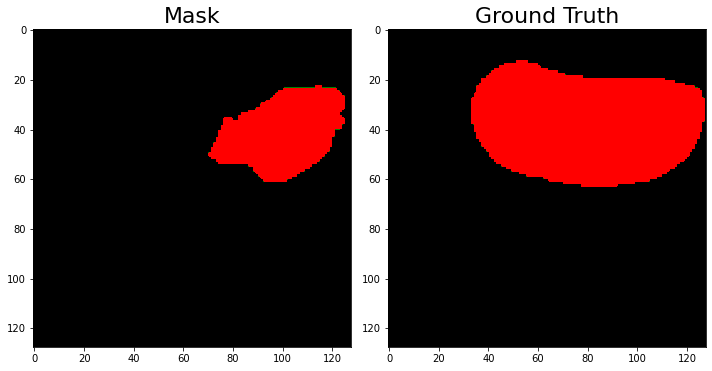

DICE for patient benign_178_seg.png: 0.541 


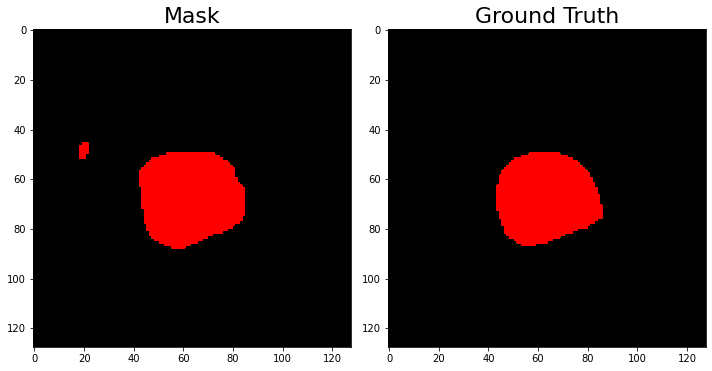

DICE for patient benign_63_seg.png: 0.956 


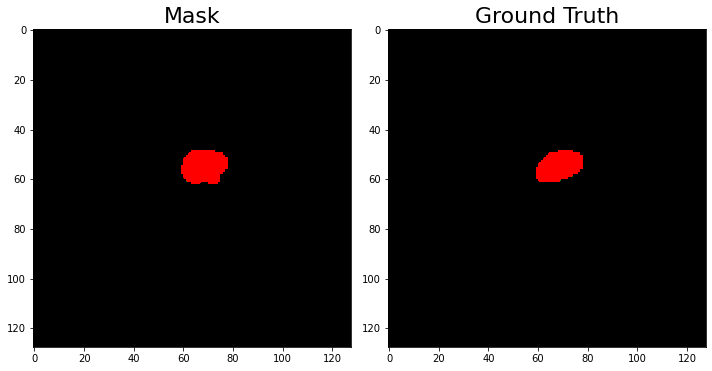

DICE for patient malignant_175_seg.png: 0.9 


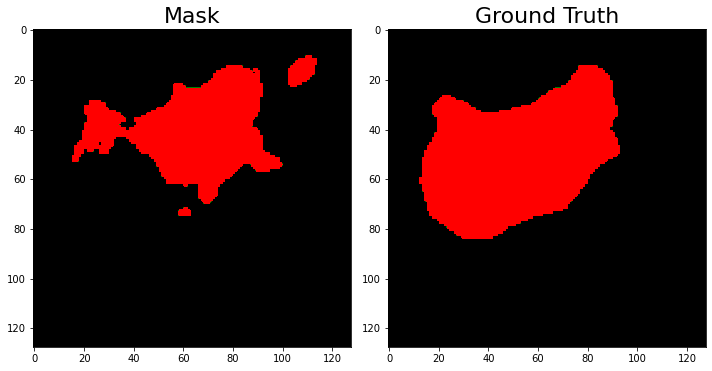

DICE for patient malignant_100_seg.png: 0.677 


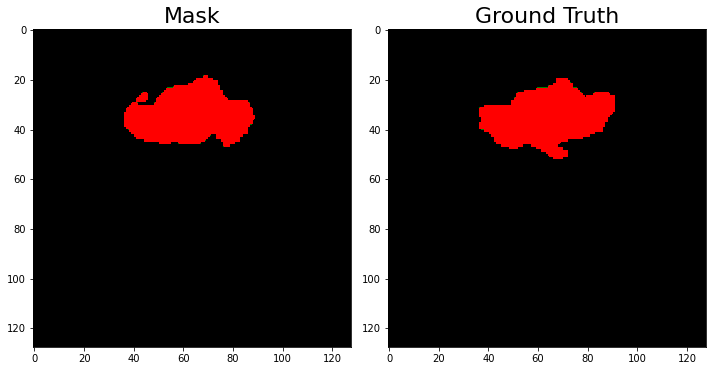

DICE for patient malignant_103_seg.png: 0.889 


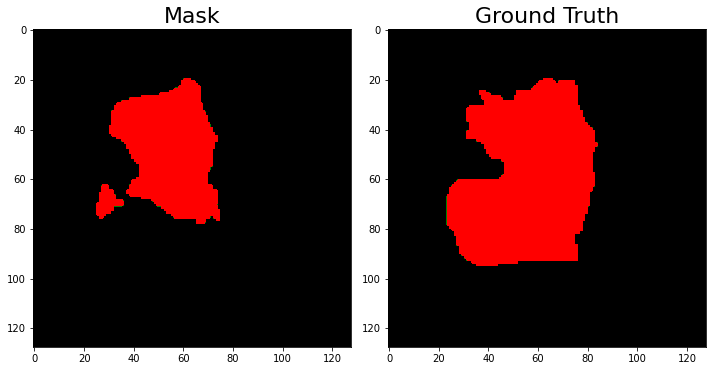

DICE for patient benign_434_seg.png: 0.651 


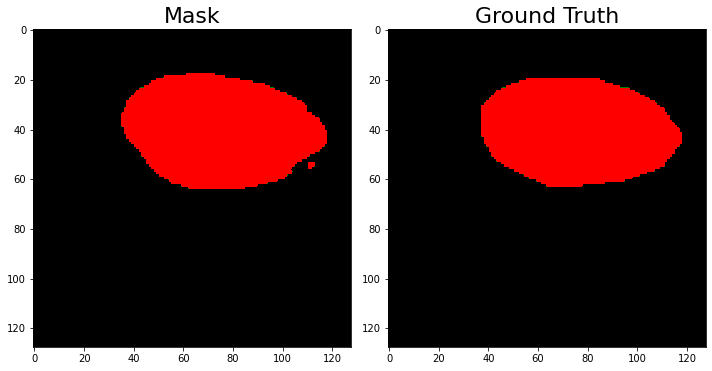

DICE for patient malignant_191_seg.png: 0.958 


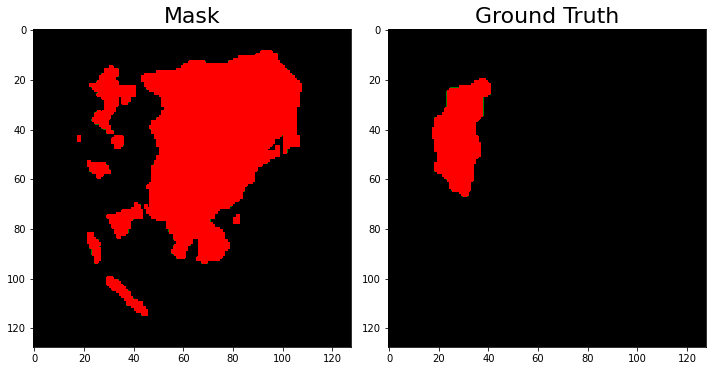

DICE for patient malignant_178_seg.png: 0.08 


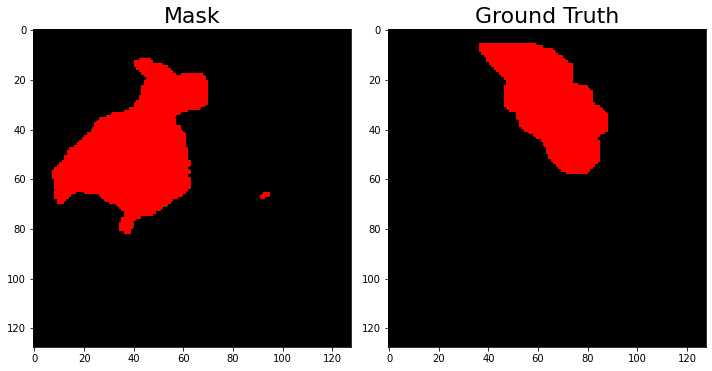

DICE for patient benign_368_seg.png: 0.234 


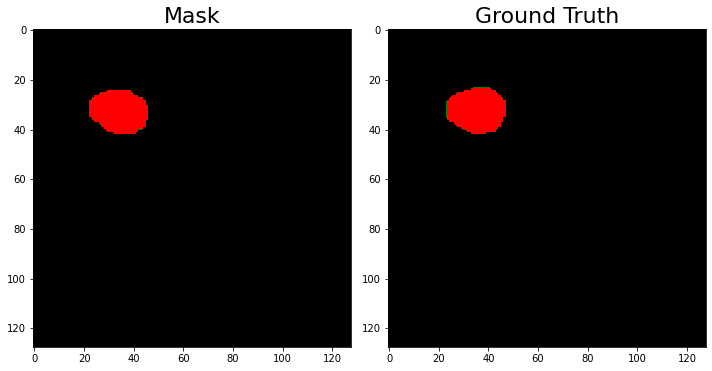

DICE for patient malignant_153_seg.png: 0.927 


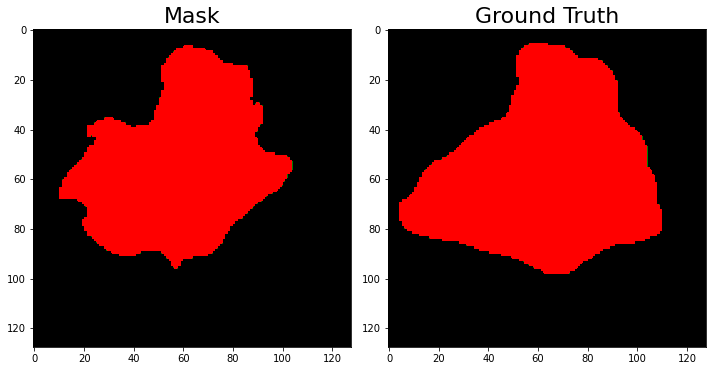

DICE for patient benign_113_seg.png: 0.858 


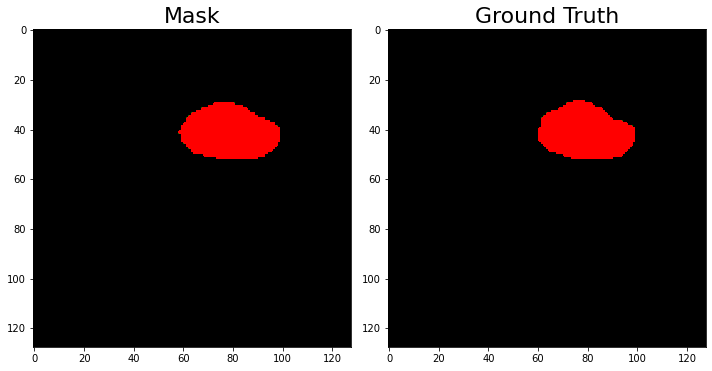

DICE for patient malignant_28_seg.png: 0.973 


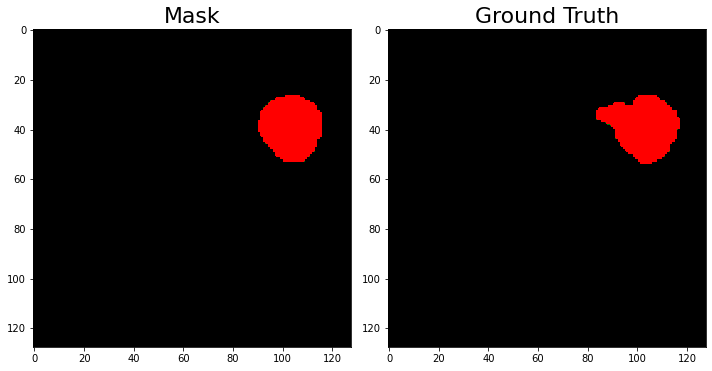

DICE for patient malignant_169_seg.png: 0.919 


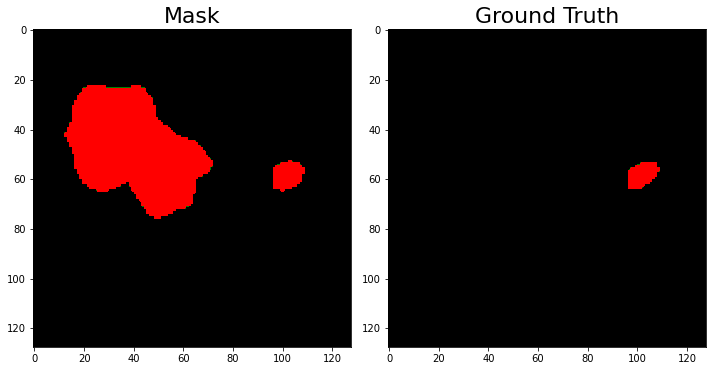

DICE for patient benign_172_seg.png: 0.081 


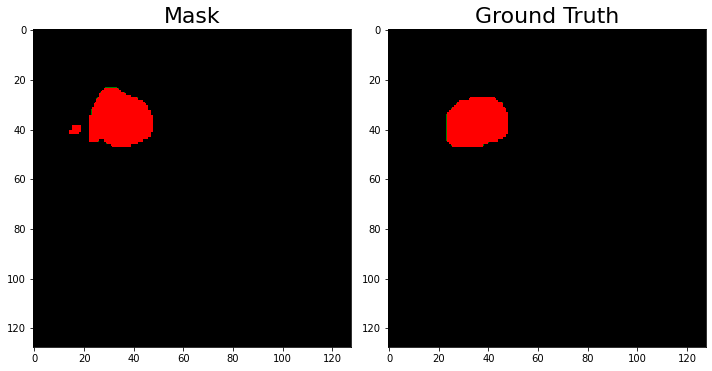

DICE for patient benign_84_seg.png: 0.888 


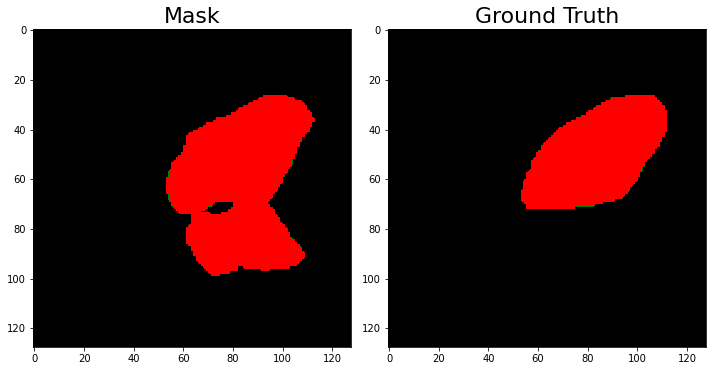

DICE for patient benign_335_seg.png: 0.75 


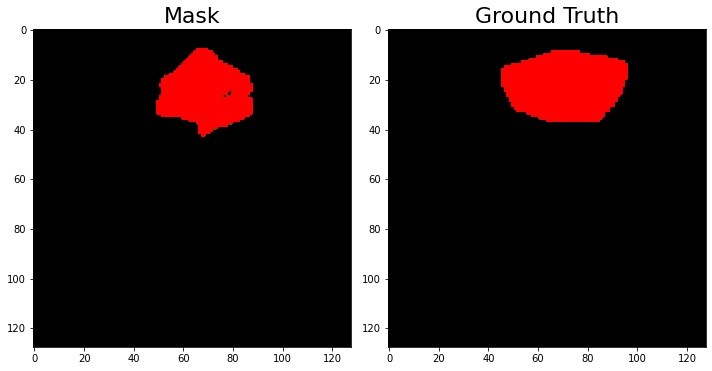

DICE for patient benign_45_seg.png: 0.79 


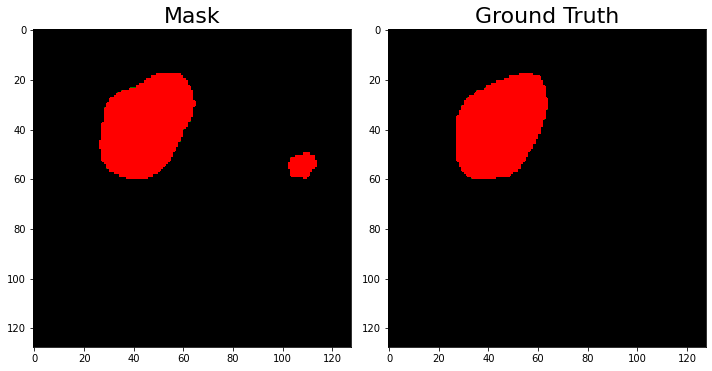

DICE for patient benign_382_seg.png: 0.947 


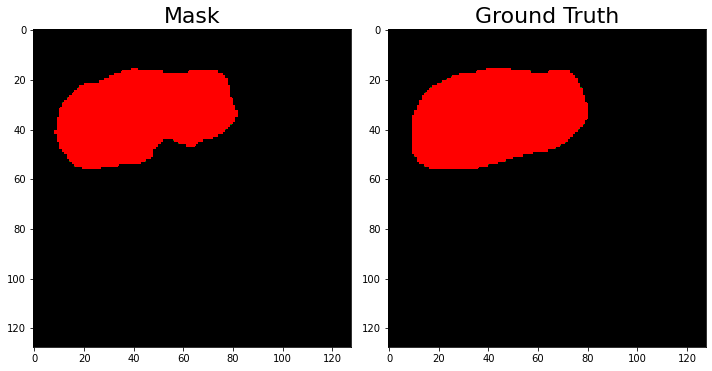

DICE for patient malignant_174_seg.png: 0.951 


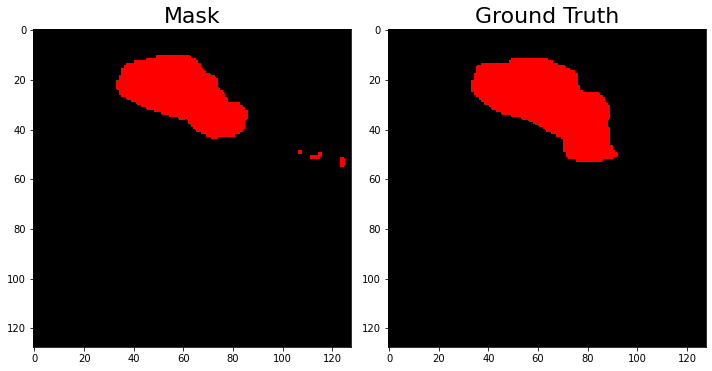

DICE for patient benign_431_seg.png: 0.829 


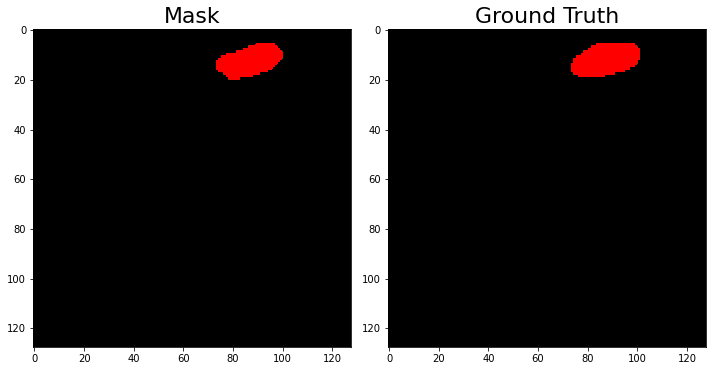

DICE for patient malignant_76_seg.png: 0.913 


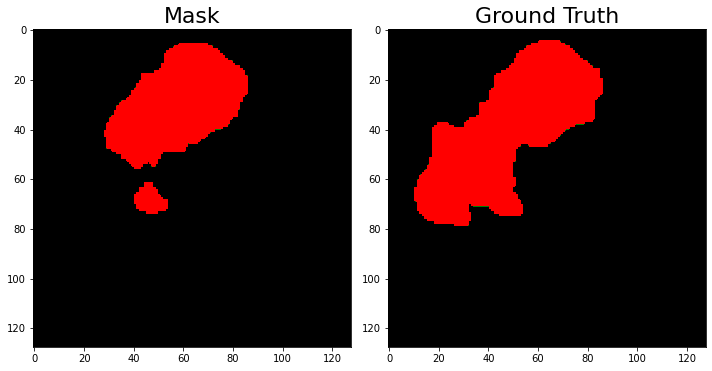

DICE for patient benign_118_seg.png: 0.767 


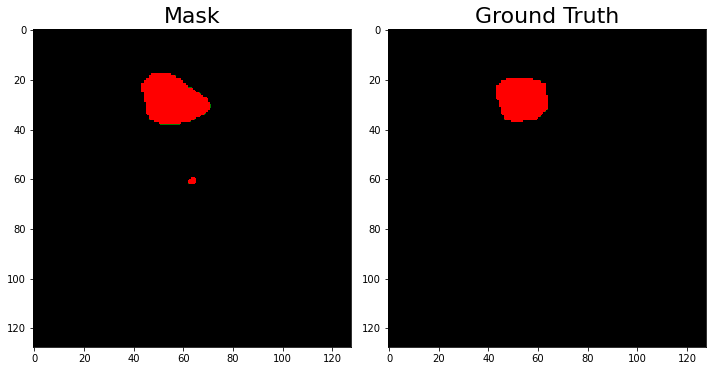

DICE for patient benign_378_seg.png: 0.825 


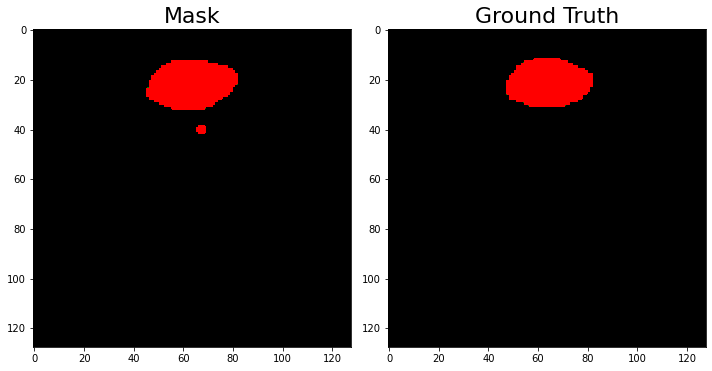

DICE for patient benign_345_seg.png: 0.929 


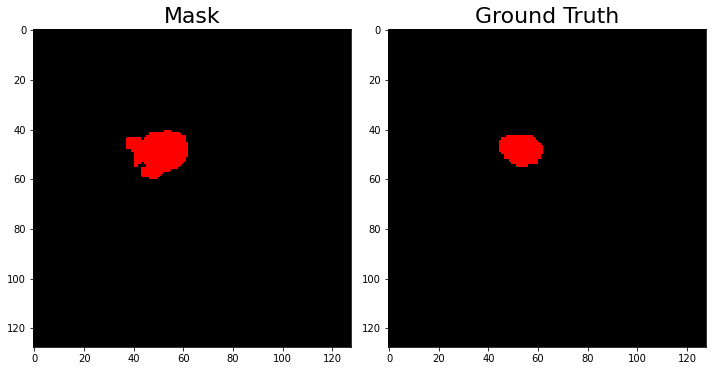

DICE for patient benign_194_seg.png: 0.692 


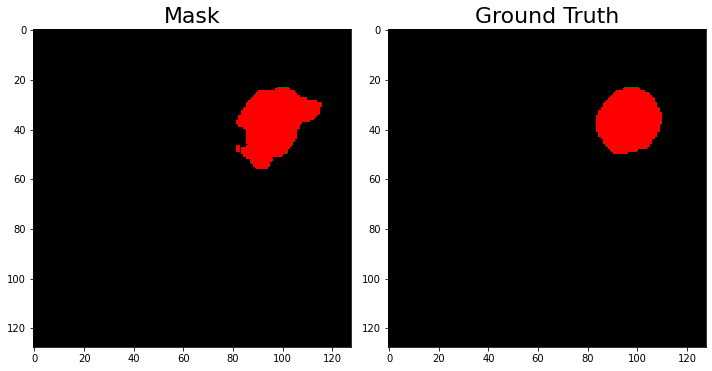

DICE for patient benign_373_seg.png: 0.848 


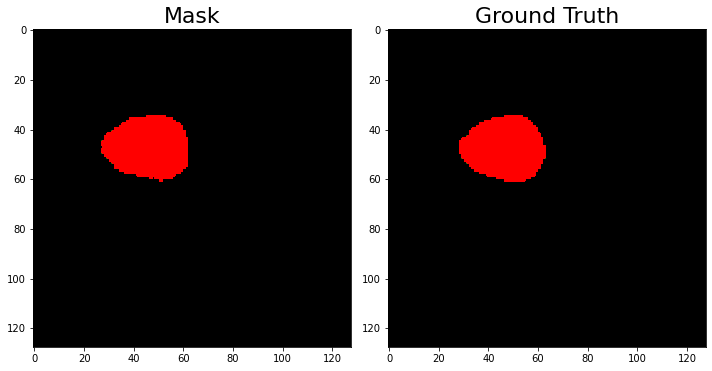

DICE for patient benign_339_seg.png: 0.964 


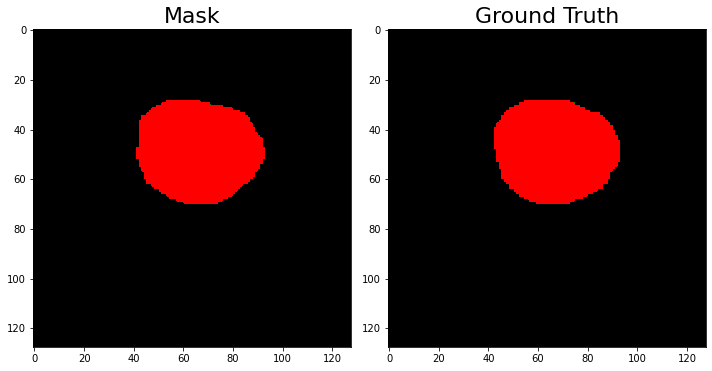

DICE for patient benign_385_seg.png: 0.975 


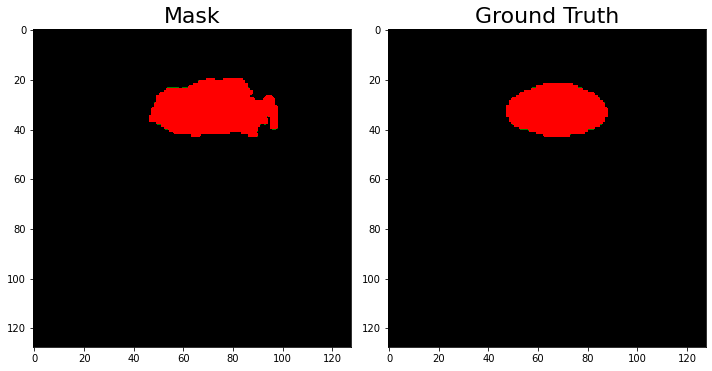

DICE for patient malignant_187_seg.png: 0.836 


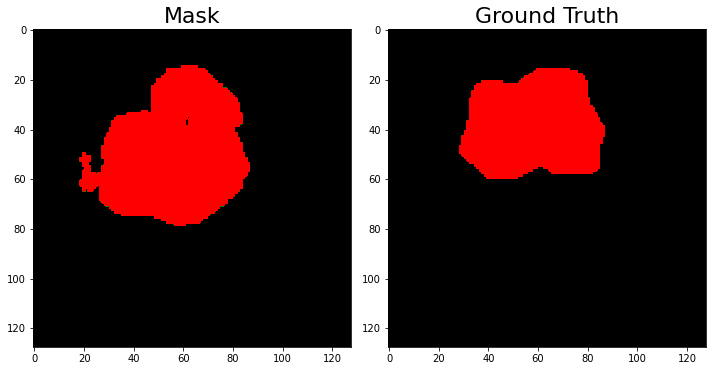

DICE for patient malignant_197_seg.png: 0.714 


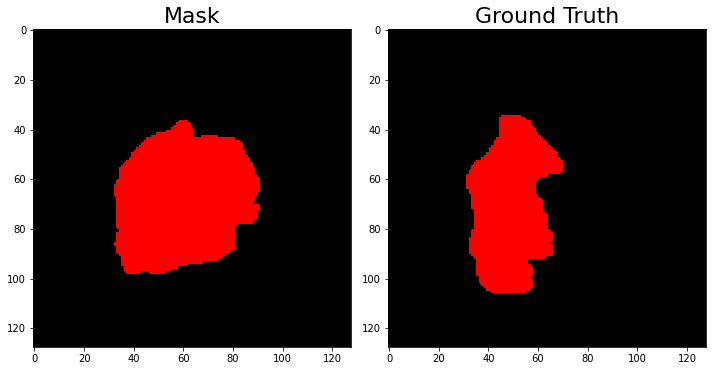

DICE for patient malignant_161_seg.png: 0.679 


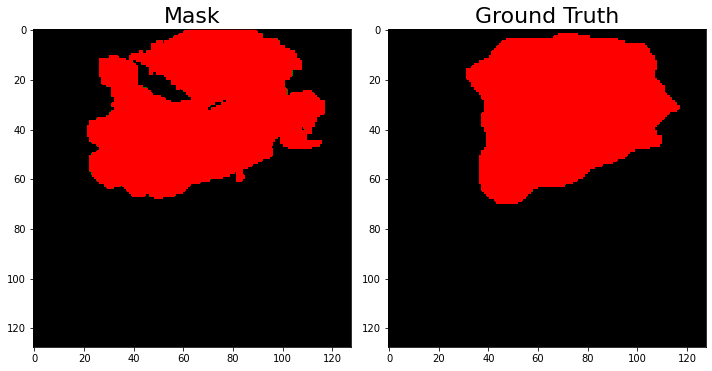

DICE for patient benign_367_seg.png: 0.864 


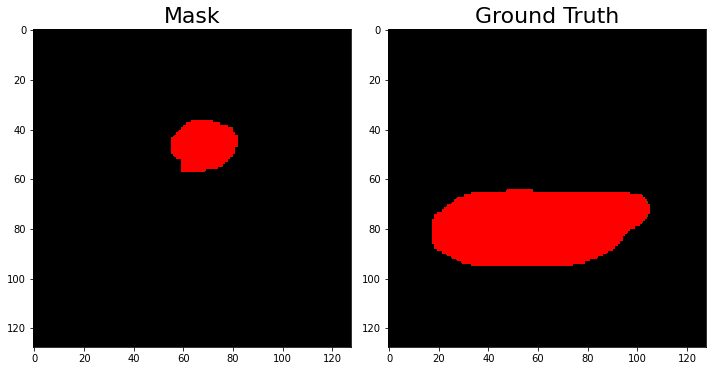

DICE for patient benign_435_seg.png: 0.0 


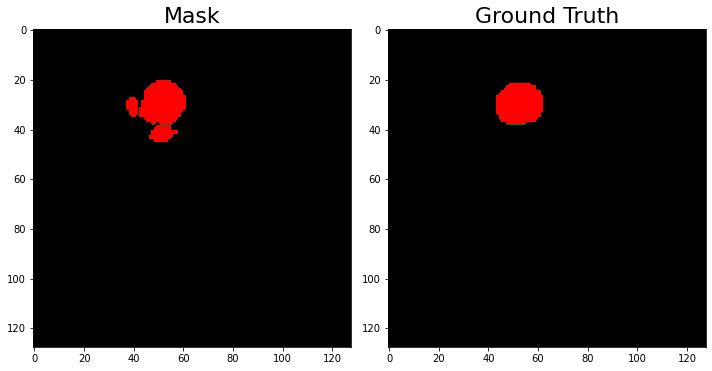

DICE for patient malignant_182_seg.png: 0.811 


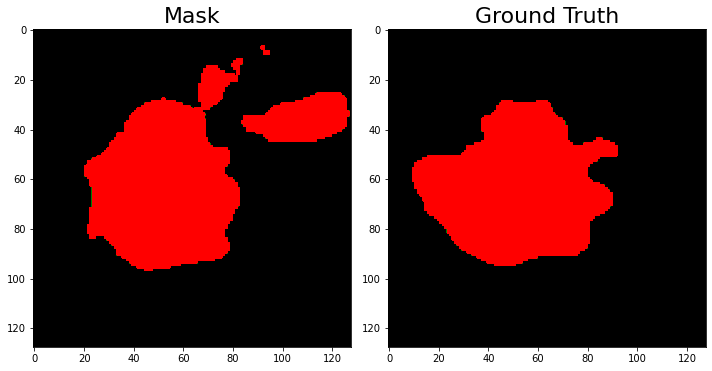

DICE for patient malignant_133_seg.png: 0.804 


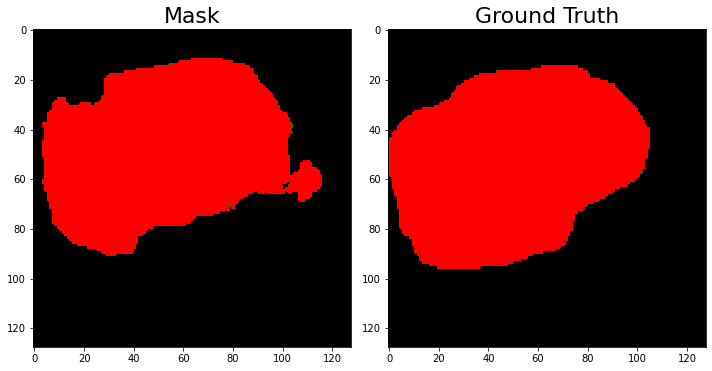

DICE for patient benign_342_seg.png: 0.897 


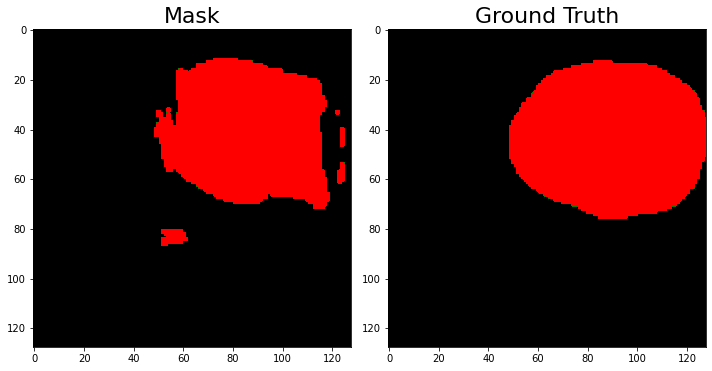

DICE for patient malignant_85_seg.png: 0.856 


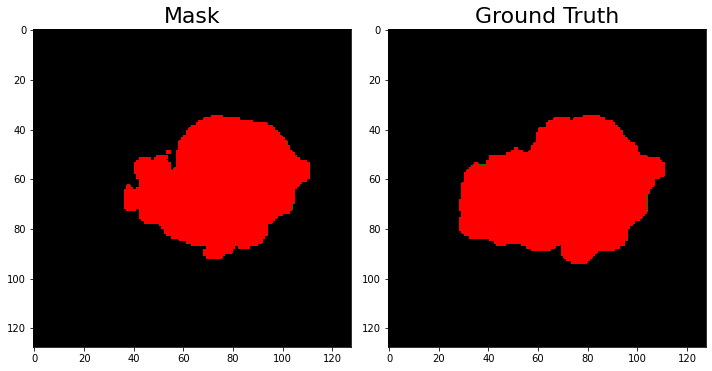

DICE for patient benign_286_seg.png: 0.881 


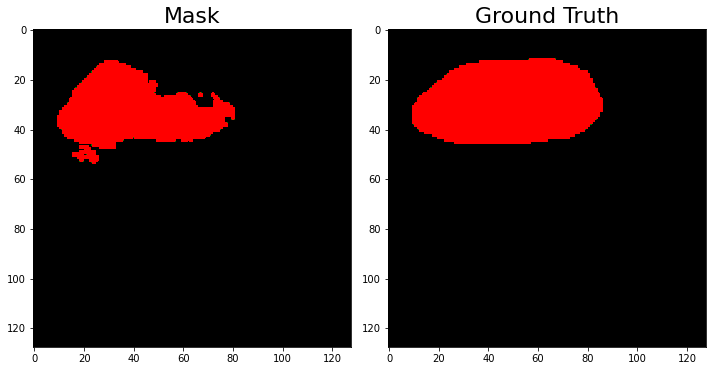

DICE for patient malignant_137_seg.png: 0.773 


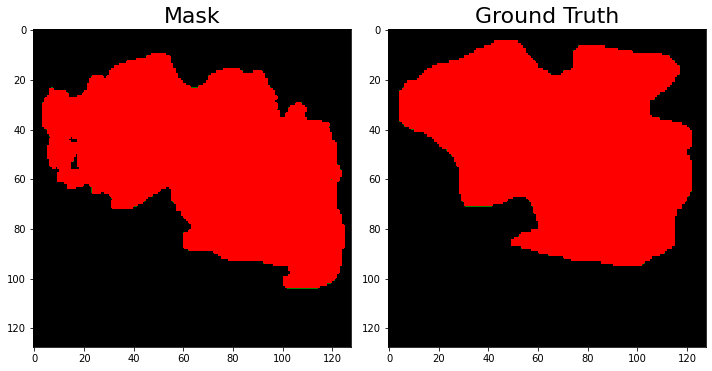

DICE for patient malignant_91_seg.png: 0.855 


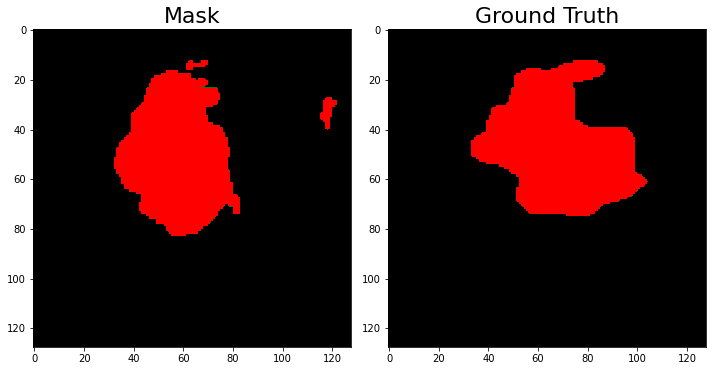

DICE for patient malignant_30_seg.png: 0.703 


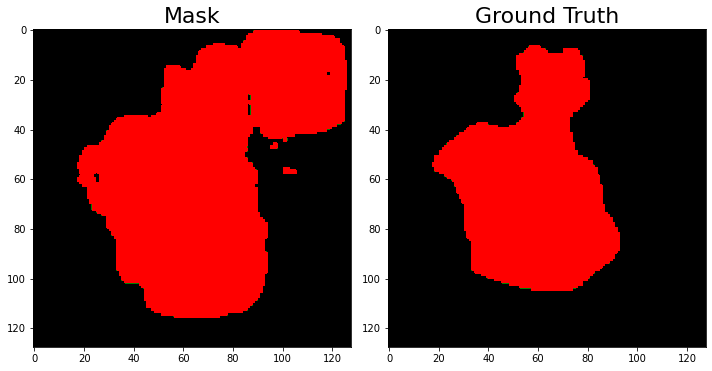

DICE for patient benign_372_seg.png: 0.733 


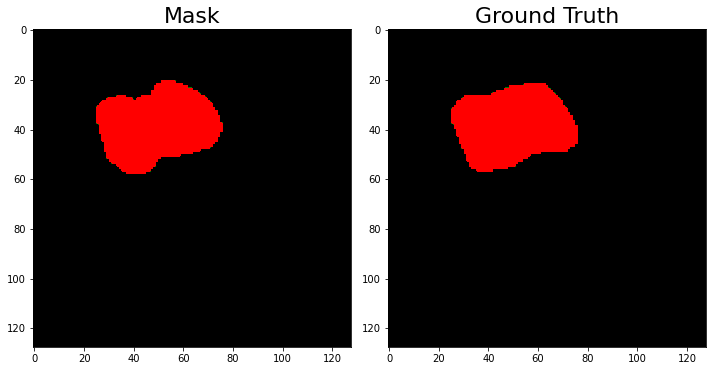

DICE for patient benign_147_seg.png: 0.95 


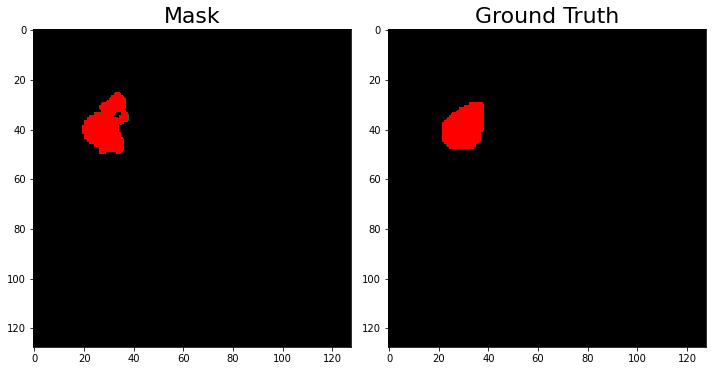

DICE for patient malignant_151_seg.png: 0.775 


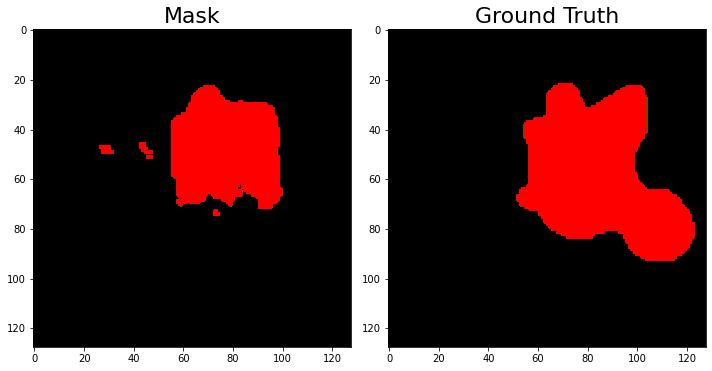

DICE for patient benign_126_seg.png: 0.691 


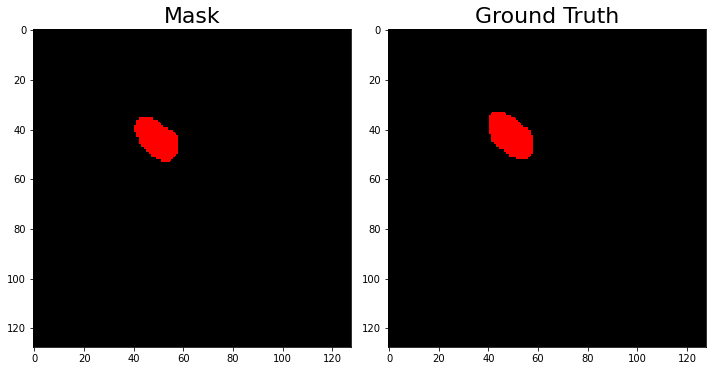

DICE for patient benign_83_seg.png: 0.9 


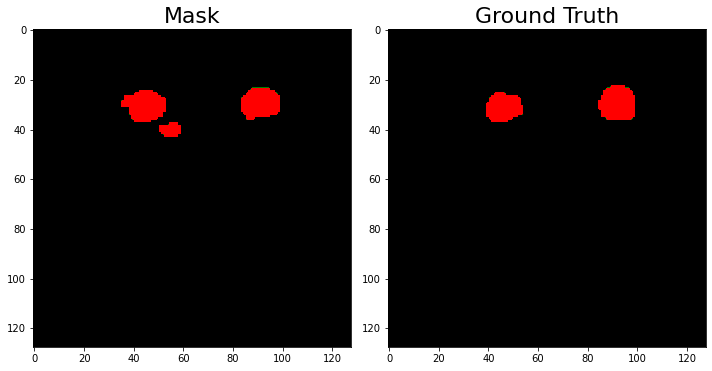

DICE for patient malignant_105_seg.png: 0.825 


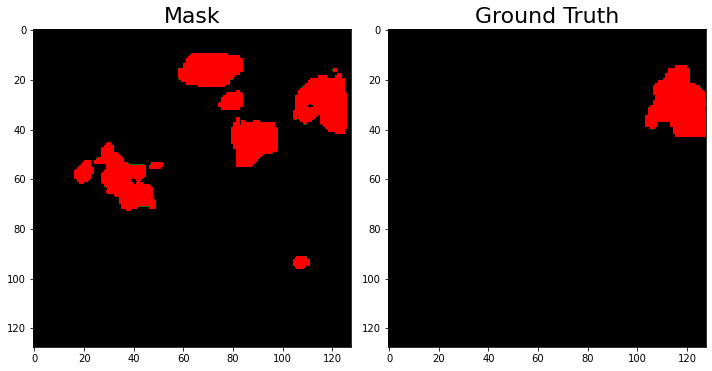

DICE for patient benign_66_seg.png: 0.37 


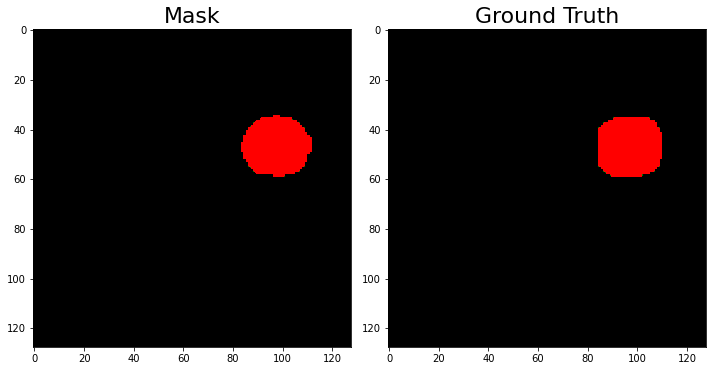

DICE for patient benign_337_seg.png: 0.951 


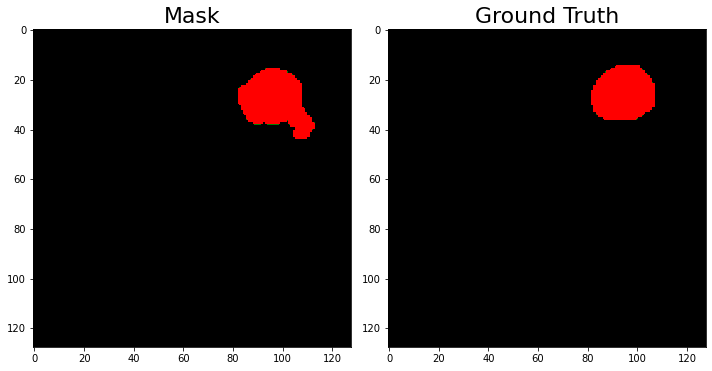

DICE for patient benign_356_seg.png: 0.82 


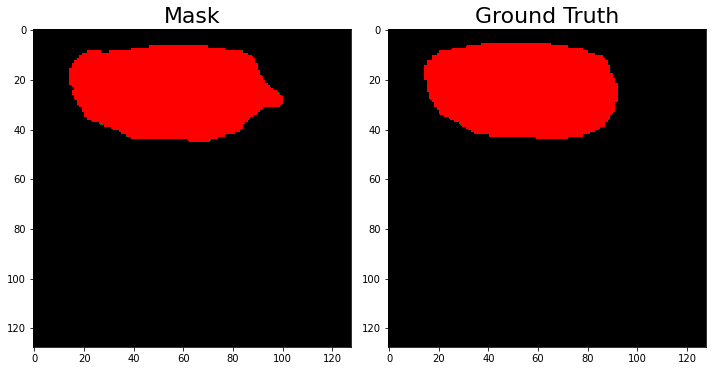

DICE for patient benign_188_seg.png: 0.957 


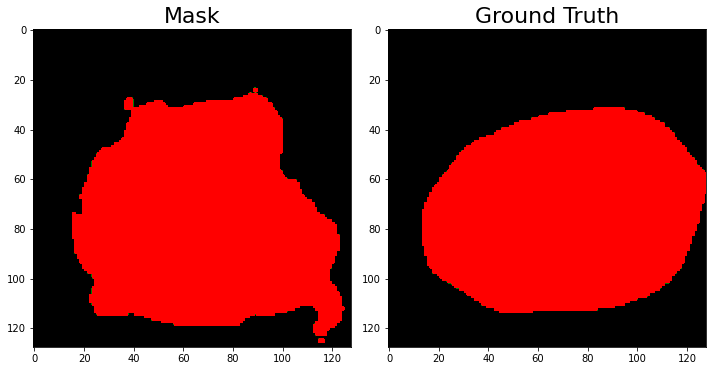

DICE for patient benign_109_seg.png: 0.868 


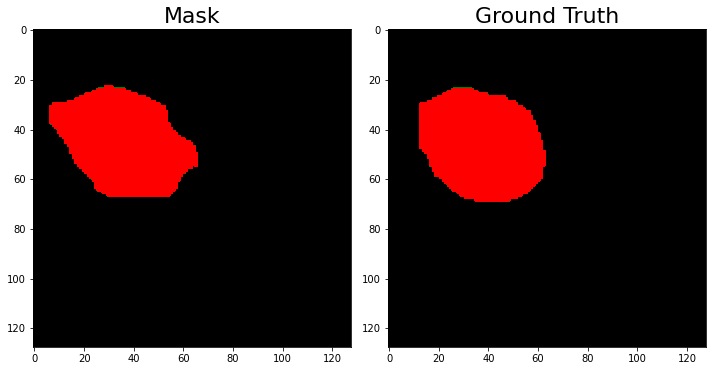

DICE for patient malignant_31_seg.png: 0.936 


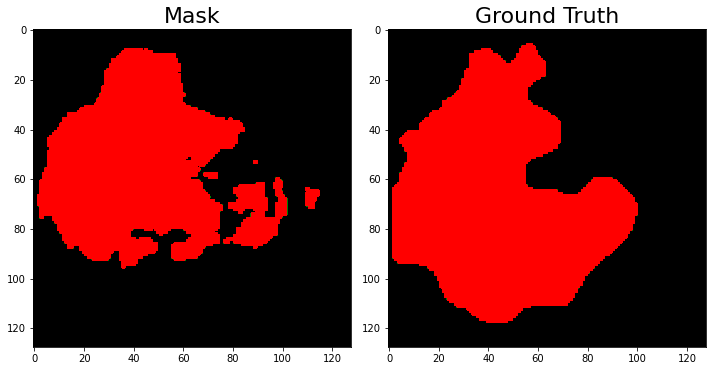

DICE for patient benign_417_seg.png: 0.762 


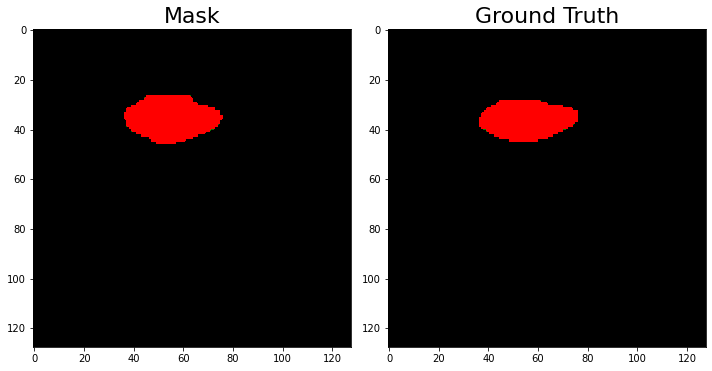

DICE for patient benign_173_seg.png: 0.923 


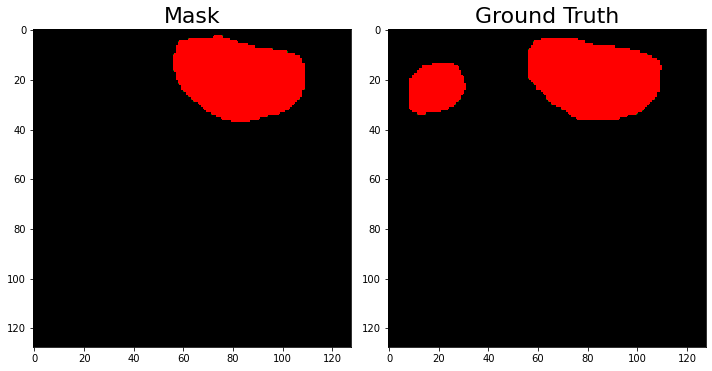

DICE for patient benign_69_seg.png: 0.868 


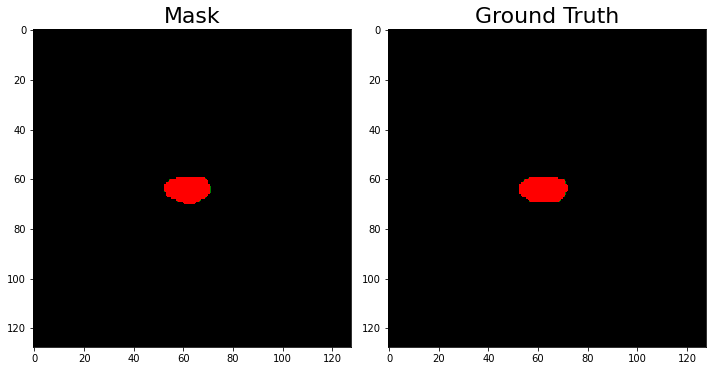

DICE for patient benign_405_seg.png: 0.943 


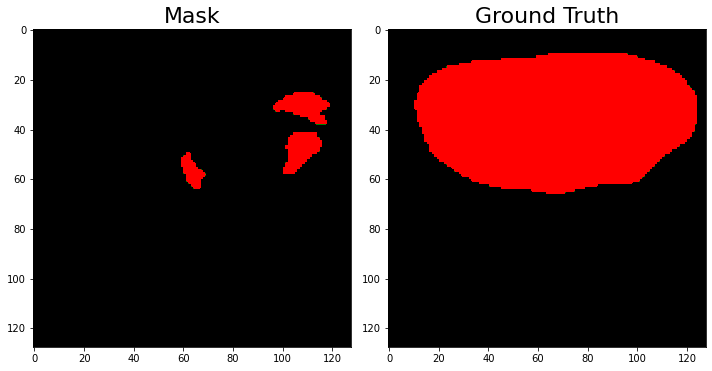

DICE for patient malignant_208_seg.png: 0.125 


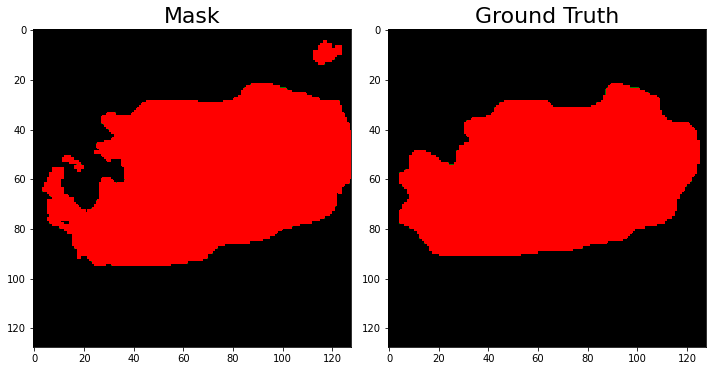

DICE for patient benign_191_seg.png: 0.904 


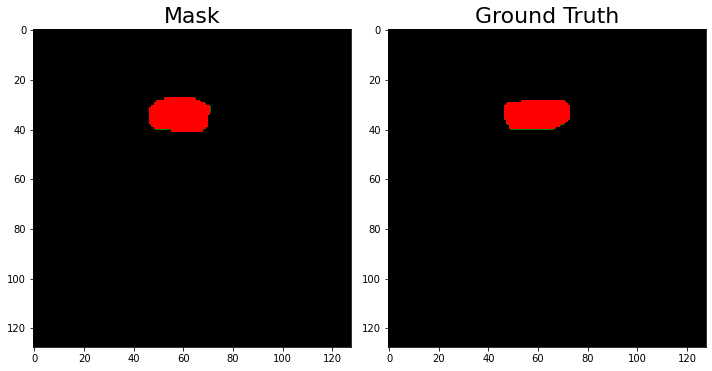

DICE for patient benign_74_seg.png: 0.889 


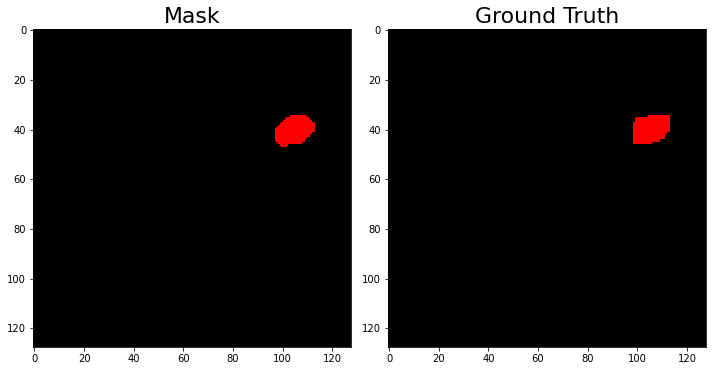

DICE for patient malignant_33_seg.png: 0.919 


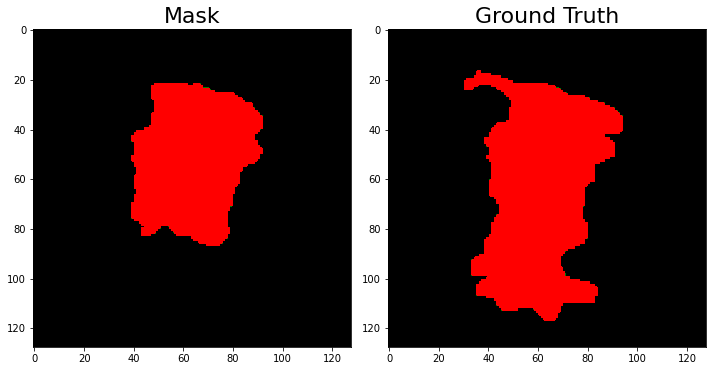

DICE for patient benign_347_seg.png: 0.776 


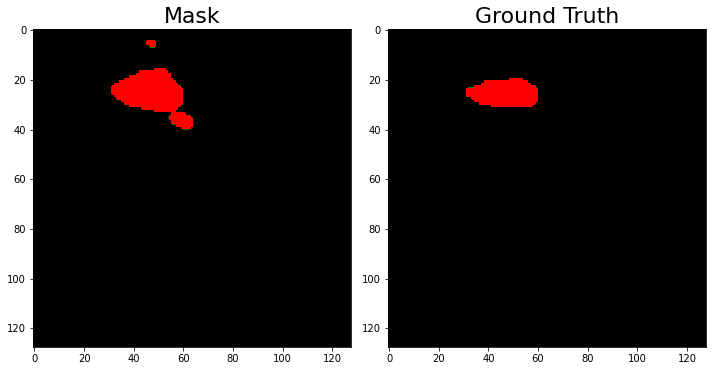

DICE for patient malignant_36_seg.png: 0.766 


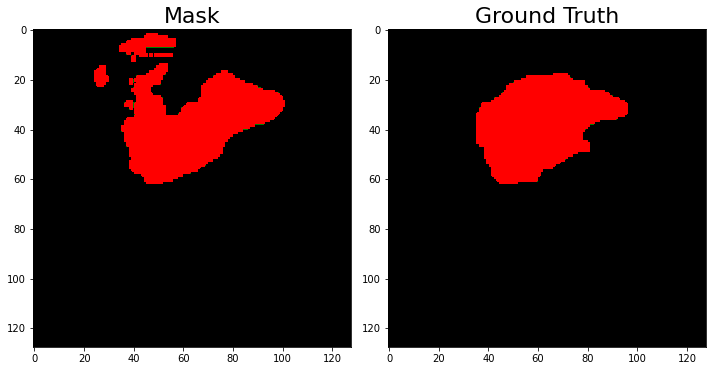

DICE for patient benign_117_seg.png: 0.782 


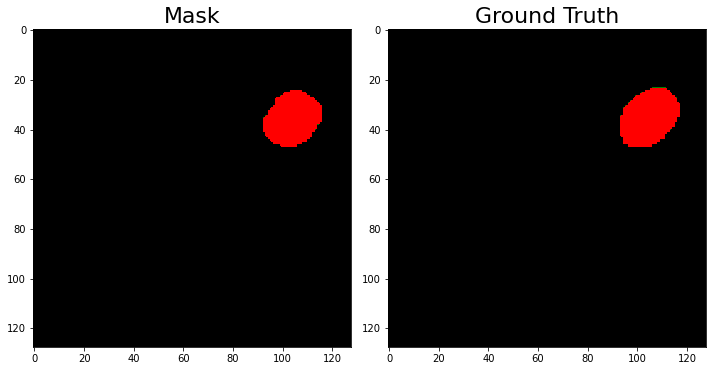

DICE for patient benign_311_seg.png: 0.936 


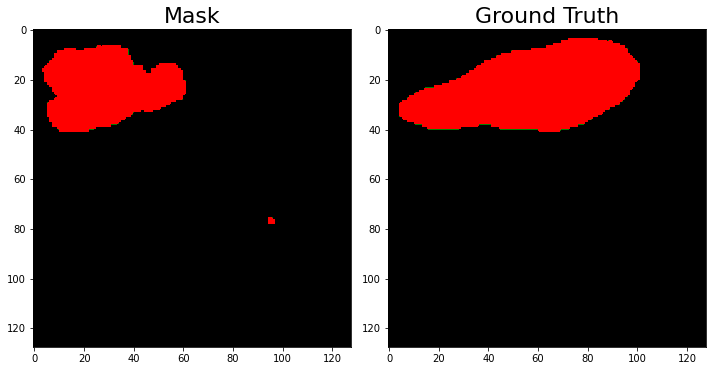

DICE for patient benign_397_seg.png: 0.473 


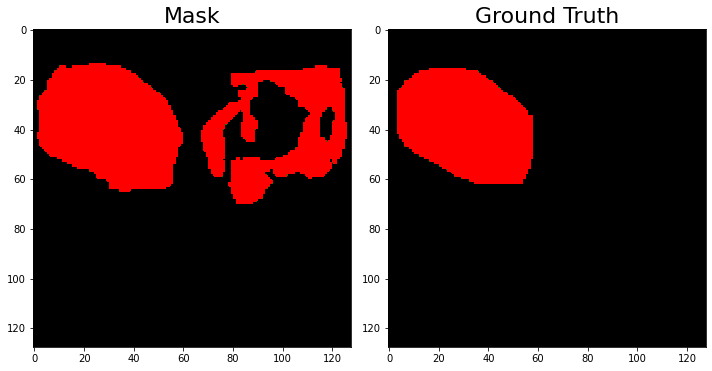

DICE for patient malignant_21_seg.png: 0.706 


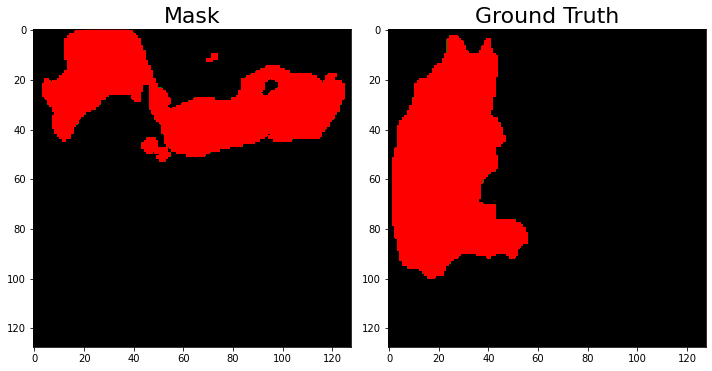

DICE for patient malignant_152_seg.png: 0.234 


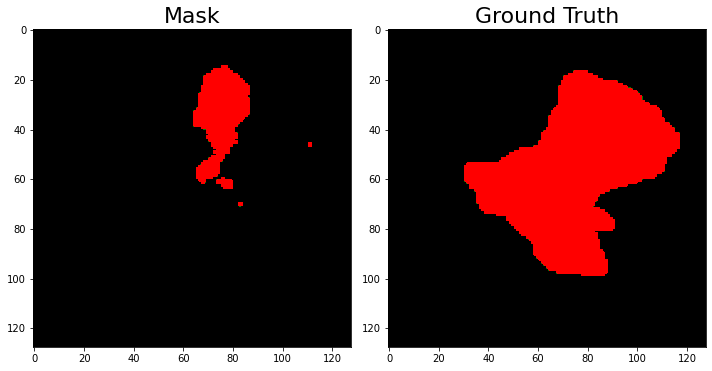

DICE for patient malignant_75_seg.png: 0.268 


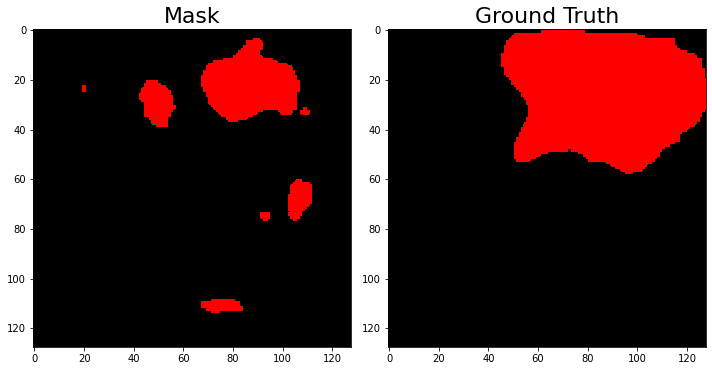

DICE for patient benign_68_seg.png: 0.35 


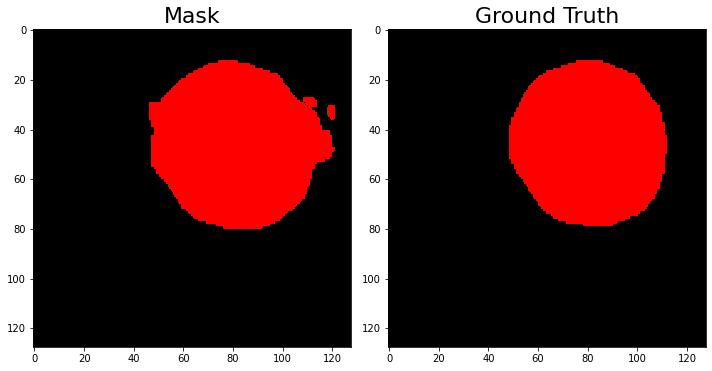

DICE for patient malignant_59_seg.png: 0.948 


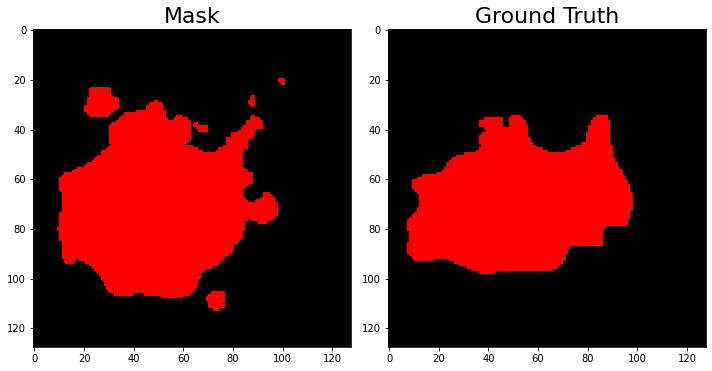

DICE for patient malignant_173_seg.png: 0.851 


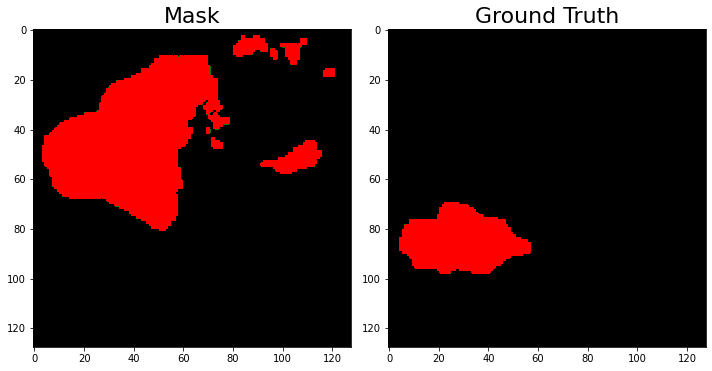

DICE for patient malignant_179_seg.png: 0.0 


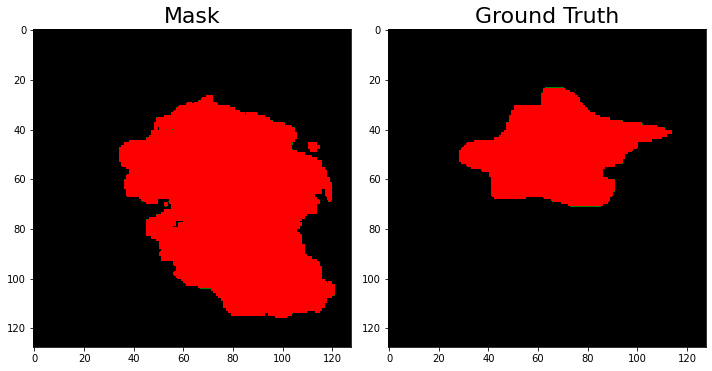

DICE for patient benign_55_seg.png: 0.534 


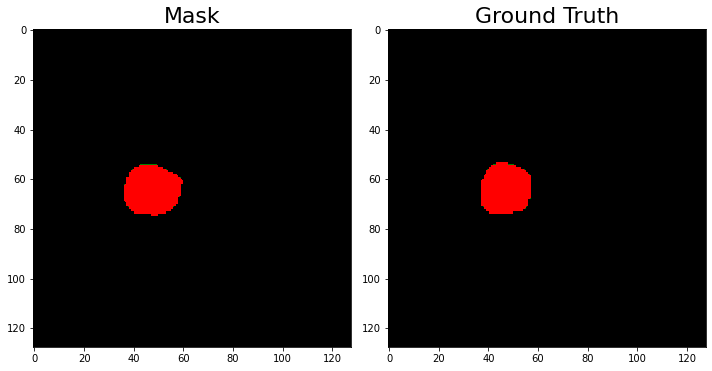

DICE for patient benign_80_seg.png: 0.932 


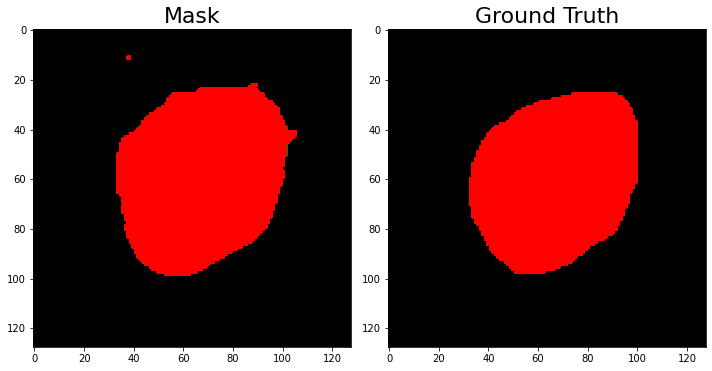

DICE for patient benign_353_seg.png: 0.957 


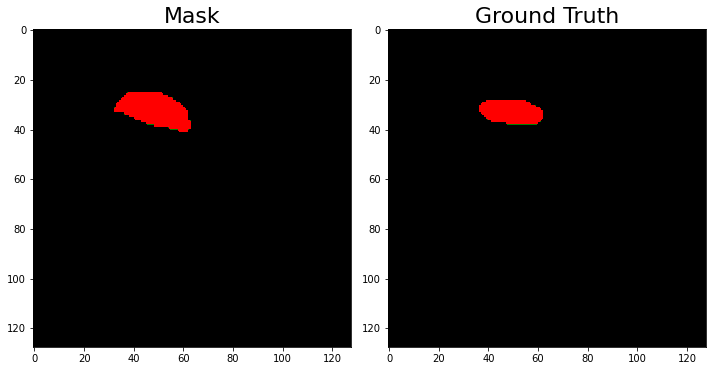

DICE for patient malignant_64_seg.png: 0.768 


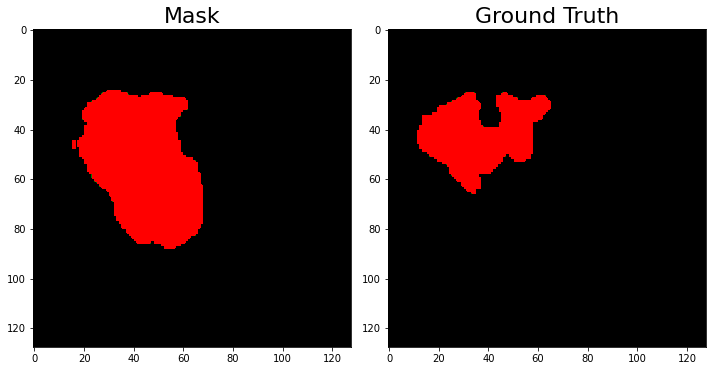

DICE for patient benign_70_seg.png: 0.59 


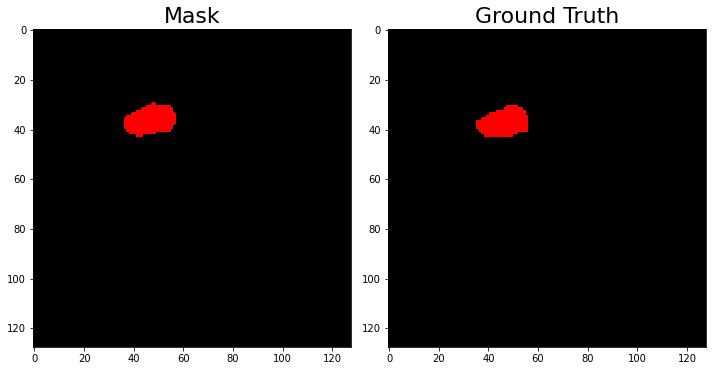

DICE for patient malignant_188_seg.png: 0.884 


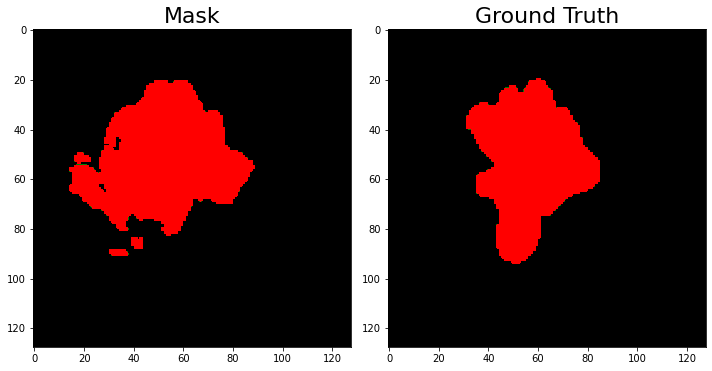

DICE for patient malignant_125_seg.png: 0.797 


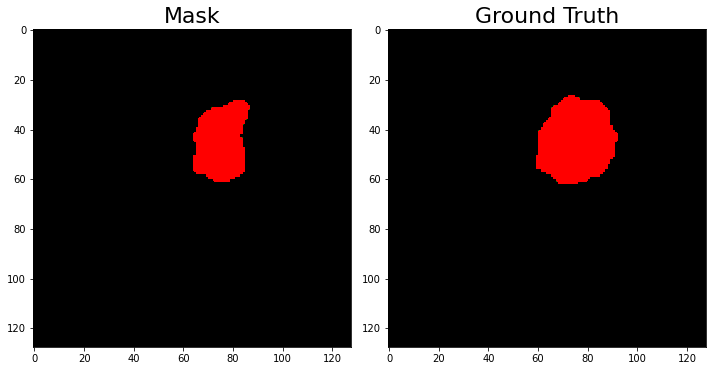

DICE for patient malignant_124_seg.png: 0.777 


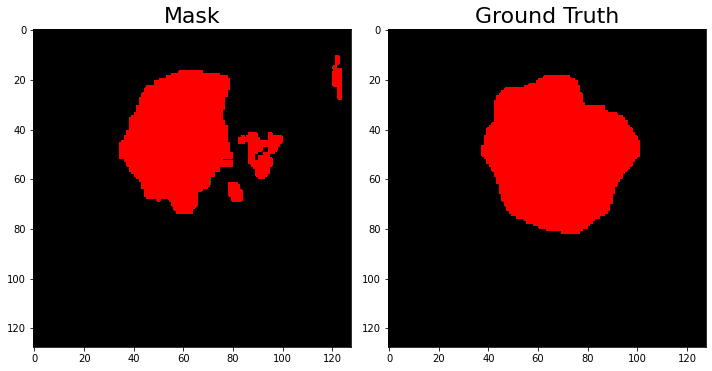

DICE for patient malignant_176_seg.png: 0.748 


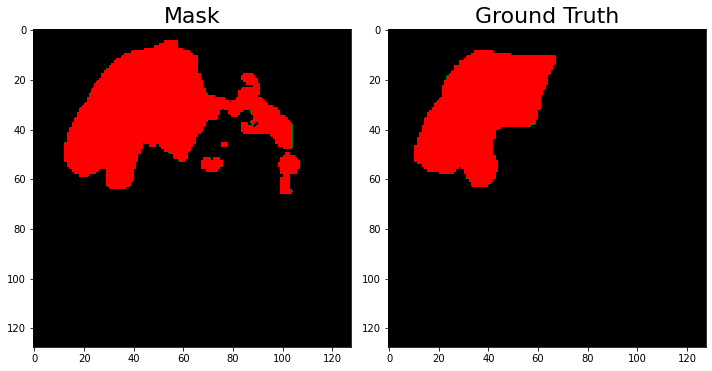

DICE for patient malignant_130_seg.png: 0.752 


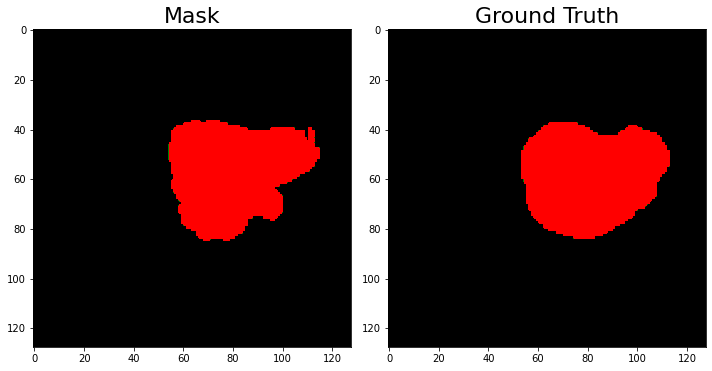

In [119]:
dices = []
from numpy import logical_and as l_and, logical_not as l_not

for fold in range(0, 4):
    root = f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_010705_Muli_FBSBTSUNET_24_batch2/fold_{fold}/segs/"
    for n, p in enumerate(os.listdir(root)):
    #     if p != 'malignant_120':
    #         continue

        gt = cv2.imread(root_gt + f"{p.split('_')[0]}_id_{p.split('_')[1]}_mask.png", 0)
        seg = cv2.imread(root + f"/{p}", 0)

        dice =  dice_score(tp, fp, fn, gt, seg)
        dices.append(dice)
        print(f"DICE for patient {p}: {round(dice, 3)} ")
        tp = float(np.sum(l_and(seg, gt)))
        tn = float(np.sum(l_and(l_not(seg), l_not(gt))))
        fp = float(np.sum(l_and(seg, l_not(gt))))
        fn = float(np.sum(l_and(l_not(seg), gt)))

        # Create a figure and subplots
        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 8))

        # Plot second subplot
        axs[0].imshow(seg, cmap=cmap, norm=norm)
        axs[0].set_title('Mask', fontsize=22)


        axs[1].imshow(gt, cmap=cmap, norm=norm)
        axs[1].set_title('Ground Truth', fontsize=22)

        # Adjust spacing between subplots
        plt.tight_layout()

        # Display the plot
        plt.show()

## Ensambling

### classification

In [245]:
# model0 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_111609_Multi_fbsbtsunet_24_batch_2_alpha_9/"

model0 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230518_134944_multi_fbsbtsunet_batch_2_alpha0.75/"
model1 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_010705_Multi_fbsbtsunet_24_batch_2_alpha_8/"
model2 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_124400_Multi_fbsbtsunet_24_batch_2_alpha_7/"

In [252]:
f, a, sen, spe, pre = [], [], [], [], []
for fold in range(0, 4):
    results_model_0 = pd.read_csv(model0 + f"fold_{fold}/results_classification.csv").rename(columns={'predicted_label': 'predicted_label_model_0'})
    results_model_1 = pd.read_csv(model1 + f"fold_{fold}/results_classification.csv").rename(columns={'predicted_label': 'predicted_label_model_1'})
    results_model_2 = pd.read_csv(model2 + f"fold_{fold}/results_classification.csv").rename(columns={'predicted_label': 'predicted_label_model_2'})

    merged = results_model_0.merge(results_model_1.merge(results_model_2, on=['patient_id', 'ground_truth']), on=['patient_id', 'ground_truth'])
    merged['majority'] = merged[['predicted_label_model_0','predicted_label_model_1','predicted_label_model_2']].mode(axis=1)[0]
    
    print(f"Fold {fold}")
    for c in ['predicted_label_model_0','predicted_label_model_1','predicted_label_model_2', 'majority']:
        cm = confusion_matrix(y_true=merged.ground_truth, y_pred=merged[c]).ravel()
        tn, fp, fn, tp = cm.ravel()

        print(f"\tF1 score: {f1_score(tp, fp, fn):.3f}\t\t Accuracy {accuracy(tp, tn, fp, fn):.3f}")
        
        if c == 'majority':
            f.append(f1_score(tp, fp, fn))
            a.append(accuracy(tp, tn, fp, fn))
            sen.append(sentitivity(tp, fn))
            spe.append(specificity(tn, fp))
            pre.append(precision(tp, fp))

print(f"\n\n Voting:\n\tF1 score: {np.mean(f):.3f}\n\t Accuracy {np.mean(a):.3f}\n\t Sensitivity {np.mean(sen):.3f}\n\t Specificity {np.mean(spe):.3f}\n\t Precision {np.mean(pre):.3f}")

Fold 0
	F1 score: 0.750		 Accuracy 0.794
	F1 score: 0.795		 Accuracy 0.825
	F1 score: 0.819		 Accuracy 0.845
	F1 score: 0.819		 Accuracy 0.845
Fold 1
	F1 score: 0.676		 Accuracy 0.773
	F1 score: 0.723		 Accuracy 0.763
	F1 score: 0.436		 Accuracy 0.680
	F1 score: 0.636		 Accuracy 0.753
Fold 2
	F1 score: 0.757		 Accuracy 0.812
	F1 score: 0.787		 Accuracy 0.802
	F1 score: 0.780		 Accuracy 0.812
	F1 score: 0.805		 Accuracy 0.833
Fold 3
	F1 score: 0.742		 Accuracy 0.760
	F1 score: 0.767		 Accuracy 0.792
	F1 score: 0.810		 Accuracy 0.833
	F1 score: 0.809		 Accuracy 0.823


 Voting:
	F1 score: 0.767
	 Accuracy 0.814
	 Sensitivity 0.756
	 Specificity 0.856
	 Precision 0.801


### segmentation

In [224]:
root_gt = "/home/carlos/Documentos/proyectos/breast_cancer/Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/masks/"

model0 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_111609_Multi_fbsbtsunet_24_batch_2_alpha_9/fold_0/segs/"
model1 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_010705_Multi_fbsbtsunet_24_batch_2_alpha_8/fold_0/segs/"
model2 = "/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_124400_Multi_fbsbtsunet_24_batch_2_alpha_7/fold_0/segs/"

In [229]:
def compute_dice(gt, seg):
    tp = float(np.sum(l_and(seg, gt)))
    tn = float(np.sum(l_and(l_not(seg), l_not(gt))))
    fp = float(np.sum(l_and(seg, l_not(gt))))
    fn = float(np.sum(l_and(l_not(seg), gt)))
    dice =  dice_score(tp, fp, fn, gt, seg)
    
    return dice

In [242]:
for fold in range(0, 4):
    model0 = f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_111609_Multi_fbsbtsunet_24_batch_2_alpha_9/fold_{fold}/segs/"
    model1 = f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_010705_Multi_fbsbtsunet_24_batch_2_alpha_8/fold_{fold}/segs/"
    model2 = f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20230418_124400_Multi_fbsbtsunet_24_batch_2_alpha_7/fold_{fold}/segs/"
    dices = []
    for n, (im0, im1, im2) in enumerate(zip(sorted(os.listdir(model0)), sorted(os.listdir(model1)), sorted(os.listdir(model2)))):
    #     print(im1, im2, im3)

    #     if im1.split('_')[-1] == '7.png':

        gt = cv2.imread(root_gt + f"{im1.split('_')[0]}_id_{im1.split('_')[1]}_mask.png", 0)
        seg0 = cv2.imread(model0 + f"{im0}", 0)
        seg1 = cv2.imread(model1 + f"{im1}", 0)
        seg2 = cv2.imread(model2 + f"{im2}", 0)

        arr = np.stack((seg0, seg1, seg2), axis=0)
        seg = scipy.stats.mode(arr, axis=0).mode[0]

        dice_0 =  compute_dice(gt, seg0)
        dice_1 =  compute_dice(gt, seg1)
        dice_2 =  compute_dice(gt, seg2)
        dice =  compute_dice(gt, seg)

        dices.append([dice_0, dice_1, dice_2, dice])

    results = pd.DataFrame(dices, columns=['dice_0', 'dice_1', 'dice_2', 'dice'])
    print(results.mean())


/tmp/ipykernel_633422/395733737.py:17: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  seg = scipy.stats.mode(arr, axis=0).mode[0]


dice_0    0.796835
dice_1    0.797191
dice_2    0.787230
dice      0.803992
dtype: float64


/tmp/ipykernel_633422/395733737.py:17: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  seg = scipy.stats.mode(arr, axis=0).mode[0]


dice_0    0.789864
dice_1    0.776947
dice_2    0.745066
dice      0.782815
dtype: float64


/tmp/ipykernel_633422/395733737.py:17: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  seg = scipy.stats.mode(arr, axis=0).mode[0]


dice_0    0.762337
dice_1    0.743063
dice_2    0.733971
dice      0.754142
dtype: float64


/tmp/ipykernel_633422/395733737.py:17: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  seg = scipy.stats.mode(arr, axis=0).mode[0]


dice_0    0.741974
dice_1    0.764682
dice_2    0.752073
dice      0.761907
dtype: float64


In [243]:
np.mean([0.803992, 0.782815, 0.754142, 0.761907])

0.775714

## Results by class

### Segmentation

In [47]:
results = []
for fold in range(0, 4):
    root = f"/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/20230526_234058_Multi_FBS_BTS_UNet_24_alpha_0.85_batch_2/fold_{fold}/"
    df = pd.read_csv(f"{root}results_segmentation.csv")
    df["fold"] = fold
    results.append(df)

results = pd.concat(results)

In [48]:
grouped_results = results.drop(columns=['patient_id']).groupby(["fold","class"]).mean().reset_index()
grouped_results

,fold,class,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision
0,0,benign,11.986092,0.840096,0.899343,0.985756,0.980943,0.766774,0.819389
1,0,malignant,17.538786,0.738248,0.762938,0.953366,0.915661,0.639109,0.826408
2,1,benign,9.323325,0.784712,0.825429,0.985677,0.972240,0.695571,0.807549
3,1,malignant,11.700330,0.752995,0.698275,0.979983,0.938383,0.638139,0.897789
4,2,benign,13.029781,0.805431,0.847282,0.985377,0.972232,0.716301,0.841552
5,2,malignant,23.963252,0.723390,0.745771,0.955076,0.933423,0.607328,0.782204
6,3,benign,12.053308,0.829318,0.860058,0.989554,0.972884,0.747812,0.874610
7,3,malignant,23.958471,0.635355,0.621197,0.955792,0.900913,0.512963,0.789357


In [49]:
grouped_results.groupby('class').mean()

,fold,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision
class,,,,,,,,
benign,1.5,11.598127,0.814889,0.858028,0.986591,0.974575,0.731614,0.835775
malignant,1.5,19.290210,0.712497,0.707045,0.961054,0.922095,0.599385,0.823939


In [50]:
grouped_results.groupby('class').std()

,fold,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision
class,,,,,,,,
benign,1.290994,1.589766,0.024790,0.031034,0.001982,0.004256,0.031792,0.029477
malignant,1.290994,5.896432,0.052829,0.063431,0.012660,0.017163,0.059475,0.052908


In [27]:
grouped_results.sort_values('class').T

,0,2,4,6,1,3,5,7
fold,0,1,2,3,0,1,2,3
class,benign,benign,benign,benign,malignant,malignant,malignant,malignant
Haussdorf distance,11.986092,9.323325,13.029781,12.053308,17.538786,11.70033,23.963252,23.958471
DICE,0.840096,0.784712,0.805431,0.829318,0.738248,0.752995,0.72339,0.635355
Sensitivity,0.899343,0.825429,0.847282,0.860058,0.762938,0.698275,0.745771,0.621197
Specificity,0.985756,0.985677,0.985377,0.989554,0.953366,0.979983,0.955076,0.955792
Accuracy,0.980943,0.97224,0.972232,0.972884,0.915661,0.938383,0.933423,0.900913
Jaccard index,0.766774,0.695571,0.716301,0.747812,0.639109,0.638139,0.607328,0.512963
Precision,0.819389,0.807549,0.841552,0.87461,0.826408,0.897789,0.782204,0.789357


### Classification

In [41]:
results = []
for fold in range(0, 4):
    root = f"/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/20230526_234058_Multi_FBS_BTS_UNet_24_alpha_0.85_batch_2/fold_{fold}/"
    df = pd.read_csv(f"{root}results_classification.csv")
    df["fold"] = fold
    results.append(df)

results = pd.concat(results)

In [45]:
results

,patient_id,ground_truth,predicted_label,fold
0,23,0.0,0.0,0
1,26,0.0,0.0,0
2,27,0.0,0.0,0
3,29,0.0,0.0,0
4,34,0.0,0.0,0
...,...,...,...,...
91,187,1.0,1.0,3
92,188,1.0,1.0,3
93,191,1.0,1.0,3
94,197,1.0,1.0,3


In [43]:
grouped_results = results.drop(columns=['patient_id']).groupby(["fold"]).mean().reset_index()
grouped_results

,fold,ground_truth,predicted_label
0,0,0.422680,0.505155
1,1,0.422680,0.443299
2,2,0.427083,0.447917
3,3,0.427083,0.364583


In [44]:
grouped_results.groupby('class').mean()

KeyError: 'class'

# Get All results from multitask alphas

## Segmentation

In [51]:
final_seg_results = []
for folder in os.listdir("/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification"):
    results = []
    alpha = folder.split("_")[-3]
    for fold in range(0, 4):
        root = f"/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/{folder}/fold_{fold}/"
        df = pd.read_csv(f"{root}results_segmentation.csv")
        df = df.drop(columns=['patient_id'])
        df["fold"] = fold
        results.append(df)

    results = pd.concat(results)
    results = results.groupby(["fold"]).mean().reset_index().drop(columns=['fold']).T
    results.columns = ["1", "2", "3", "4"]
    results.index = results.index.set_names(['metric'])
    results = results.reset_index()
    results["average"] = results[["1", "2", "3", "4"]].mean(axis=1)
    results["std"] = results[["1", "2", "3", "4"]].std(axis=1)
    results['alpha'] = alpha
    final_seg_results.append(results)

final_seg_results = pd.concat(final_seg_results)
final_seg_results["alpha"] = final_seg_results["alpha"].astype(float)
final_seg_results = final_seg_results.sort_values("alpha")

In [52]:
final_seg_results[final_seg_results.alpha == 0.85]

,metric,1,2,3,4,average,std,alpha
6,Precision,0.822270,0.845692,0.815939,0.837816,0.830429,0.013712,0.85
5,Jaccard index,0.712812,0.671295,0.669760,0.647512,0.675345,0.027240,0.85
4,Accuracy,0.953350,0.957929,0.955657,0.942146,0.952271,0.007004,0.85
3,Specificity,0.972065,0.983270,0.972436,0.975135,0.975727,0.005212,0.85
2,Sensitivity,0.843346,0.771684,0.803472,0.756971,0.793868,0.038270,0.85
0,Haussdorf distance,14.333107,10.328039,17.699285,17.137804,14.874559,3.369736,0.85
1,DICE,0.797047,0.771306,0.770393,0.746480,0.771306,0.020654,0.85


In [53]:
import plotly.express as px

fig = px.line(final_seg_results[final_seg_results.metric != "Haussdorf distance"], 
              x="alpha", y="average", color='metric', symbol="metric")
fig.update_layout(template="simple_white")
fig.show()

## classification

In [14]:
final_class_results = []
for folder in os.listdir("/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification"): 
    class_results = []
    alpha = folder.split("_")[-3]
    for fold in range(0, 4):
        root = f"/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/{folder}/fold_{fold}/"
        df = pd.read_csv(f"{root}results_classification.csv")

        cm = confusion_matrix(y_true=np.array(df.ground_truth), y_pred=np.array(df.predicted_label))

        tn, fp, fn, tp = cm.ravel()
        tmp = pd.DataFrame({
            'Precision': [precision(tp, fp)],
            'Sensitivity': [specificity(tn, fp)],
            'Specificity': [sentitivity(tp, fn)],
            'Accuracy': [accuracy(tp, tn, fp, fn)],
            'F1score': [f1_score(tp, fp, fn)]
        })
        class_results.append(tmp)


    class_results = pd.concat(class_results).fillna(0).T
    class_results.columns = ["1", "2", "3", "4"]
    class_results['alpha'] = alpha
    class_results.index = class_results.index.set_names(['metric'])
    class_results = class_results.reset_index()
    class_results["average"] = class_results[["1", "2", "3", "4"]].mean(axis=1)
    final_class_results.append(class_results)
    
final_class_results = pd.concat(final_class_results)
final_class_results["alpha"] = final_class_results["alpha"].astype(float)
final_class_results = final_class_results.sort_values("alpha")

In [24]:
final_class_results[final_class_results.alpha == 0.85]

,metric,1,2,3,4,alpha,average
0,Precision,0.734694,0.720930,0.720930,0.885714,0.85,0.765567
4,F1score,0.800000,0.738095,0.738095,0.815789,0.85,0.772995
3,Accuracy,0.814433,0.773196,0.770833,0.854167,0.85,0.803157
2,Specificity,0.878049,0.756098,0.756098,0.756098,0.85,0.786585
1,Sensitivity,0.767857,0.785714,0.781818,0.927273,0.85,0.815666


In [15]:
import plotly.express as px

fig = px.line(final_class_results, x="alpha", y="average", color='metric', symbol="metric")
fig.update_layout(template="simple_white")
fig.show()

In [16]:
a = final_class_results.groupby("alpha")["average"].mean().reset_index()
a.columns = ["alpha", "average all classification metrics"]
b = final_seg_results[final_seg_results.metric != "Haussdorf distance"].groupby("alpha")["average"].mean().reset_index()
b.columns = ["alpha", "average all segmentation metrics"]

merged = a.merge(b, on="alpha")
merged["total average"] = merged.drop(columns="alpha").mean(axis=1)
merged = merged.set_index("alpha").unstack().reset_index()
merged.columns = ["metric", "alpha", "average"]
# merged.sample(5)

In [17]:
maximum = merged[merged.metric == "total average"].sort_values("average", ascending=False).reset_index(drop=True).head(1)
max_alpha = maximum.at[0, 'alpha']
max_value = round(maximum.at[0, 'average'], 3)

In [18]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.line(merged, x="alpha", y="average", color='metric', symbol="metric")
fig.add_trace(go.Scatter(x=[max_alpha], y=[max_value], mode = 'markers', 
                         marker=dict(size=8, symbol="diamond", line=dict(width=2, color="DarkSlateGrey")),
                         name=f"Maximum (alpha={max_alpha}): {max_value}"))
fig.update_layout(template="simple_white")
fig.show()

# Get last epochs

In [372]:
log_path = "/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/20230418_124400_Multi_FBS_BTS_UNet_24_alpha_0.7_batch_2/fold_1/execution_fold_1.log"

In [373]:
with open(log_path) as f:
    lines = f.readlines()

In [381]:
a = [line for line in lines if 'EPOCH' in line]
last_epoch = int(a[-1].split("--")[1].replace("- EPOCH", "").strip()) -100
last_epoch

148

In [388]:
import glob
last_epochs = []

all_logs_path = glob.glob('/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Multi-task-segmentation-classification/*/*/execution_*.log')
for log in all_logs_path:
    with open(log) as f:
        lines = f.readlines()
    a = [line for line in lines if 'EPOCH' in line]
    try:
        last_epoch = int(a[-1].split("--")[1].replace("- EPOCH", "").strip()) -100
        last_epochs.append(last_epoch)
    except:
        pass

(array([10., 13., 23., 12., 16.,  4.,  1.,  2.,  1.,  1.]),
 array([  5. ,  67.6, 130.2, 192.8, 255.4, 318. , 380.6, 443.2, 505.8,
        568.4, 631. ]),
 <BarContainer object of 10 artists>)

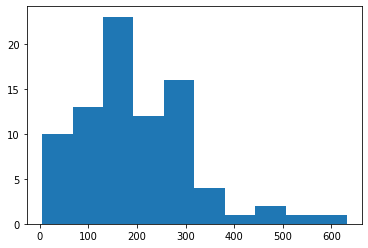

In [390]:
plt.hist(last_epochs)

# Creacion dataset curated BUSI

In [427]:
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'

df = pd.read_excel("/home/carlos/Documentos/proyectos/breast_cancer/Results/Experiments/Top_imagenes_repetidas_v4.xlsx")
df.drop(columns=['top_4', 'tipologia 4', 'top_5'], inplace=True)
df.head(3)

,image_reference,top_1,tipologia 1,top_2,tipologia 2,top_3,tipologia 3,value_1,value_2,value_3,value_4,value_5
0,1_benign,318_benign,igual,117_malignant,diferente,119_benign,NaN,0.578746,0.202663,0.202404,0.202078,0.193532
1,2_benign,319_benign,igual,154_malignant,diferente,21_benign,NaN,0.190063,0.162633,0.159130,0.157569,0.152292
2,3_benign,320_benign,igual,3_malignant,diferente,116_malignant,NaN,0.804594,0.199222,0.197616,0.196770,0.196200


In [445]:
a = df[['image_reference','top_1', 'top_2','top_3']].set_index('image_reference').unstack().reset_index()
a.columns = ["top", "image_reference", "other_image"]
b = df[['image_reference','tipologia 1', 'tipologia 2', 'tipologia 3']].set_index('image_reference').unstack().reset_index()
a["result"] = b[0]
df_processed = a[['image_reference', 'other_image', 'top', 'result']]
df_processed

,image_reference,other_image,top,result
0,1_benign,318_benign,top_1,igual
1,2_benign,319_benign,top_1,igual
2,3_benign,320_benign,top_1,igual
3,4_benign,321_benign,top_1,igual
4,5_benign,322_benign,top_1,igual
...,...,...,...,...
2335,129_normal,181_malignant,top_3,NaN
2336,130_normal,18_malignant,top_3,NaN
2337,131_normal,37_malignant,top_3,NaN
2338,132_normal,61_benign,top_3,NaN


## Imagenes diferentes

In [397]:
df_unicas = df[df["tipologia 1"] == "diferente"]
print(df_unicas.shape)

(450, 15)


## Imagenes duplicadas

In [449]:
# df_duplicadas = df[df["tipologia 1"] != "diferente"]
# print(df_duplicadas.shape)

# df_duplicadas[['image_reference_id', 'image_reference_type']]  = df_duplicadas["image_reference"].str.split("_", expand=True)
# df_duplicadas[['top_1_id', 'top_1_type']]  = df_duplicadas["top_1"].str.split("_", expand=True)
# df_duplicadas[['top_2_id', 'top_2_type']]  = df_duplicadas["top_2"].str.split("_", expand=True)
# df_duplicadas[['top_3_id', 'top_3_type']]  = df_duplicadas["top_3"].str.split("_", expand=True)
# df_duplicadas[['top_4_id', 'top_4_type']]  = df_duplicadas["top_4"].str.split("_", expand=True)
# df_duplicadas[['top_5_id', 'top_5_type']]  = df_duplicadas["top_5"].str.split("_", expand=True)

# df_duplicadas.head(2)

In [491]:
df_duplicadas = df_processed[df_processed['result'] == 'igual']
df_duplicadas[['image_reference_id', 'image_reference_type']]  = df_duplicadas["image_reference"].str.split("_", expand=True)
df_duplicadas[['other_image_id', 'other_image_type']]  = df_duplicadas["other_image"].str.split("_", expand=True)
df_duplicadas.image_reference.nunique()

330

### Duplicadas y con clases incongruentes

In [420]:
# df_duplicadas_incongruentes = df_duplicadas[
#     (df_duplicadas["image_reference_type"] != df_duplicadas["top_1_type"]) |
#     (df_duplicadas["image_reference_type"] != df_duplicadas["top_2_type"]) |
#     (df_duplicadas["image_reference_type"] != df_duplicadas["top_3_type"]) |
#     (df_duplicadas["image_reference_type"] != df_duplicadas["top_4_type"]) |
#     (df_duplicadas["image_reference_type"] != df_duplicadas["top_5_type"])
# ]
# print(df_duplicadas_incongruentes.shape)
# df_duplicadas_incongruentes.head(3)

(289, 27)


,image_reference,top_1,tipologia 1,top_2,tipologia 2,top_3,tipologia 3,top_4,tipologia 4,top_5,...,top_1_id,top_1_type,top_2_id,top_2_type,top_3_id,top_3_type,top_4_id,top_4_type,top_5_id,top_5_type
0,1_benign,318_benign,igual,117_malignant,diferente,119_benign,NaN,116_benign,NaN,122_benign,...,318,benign,117,malignant,119,benign,116,benign,122,benign
1,2_benign,319_benign,igual,154_malignant,diferente,21_benign,NaN,114_benign,NaN,122_benign,...,319,benign,154,malignant,21,benign,114,benign,122,benign
2,3_benign,320_benign,igual,3_malignant,diferente,116_malignant,NaN,18_malignant,NaN,7_malignant,...,320,benign,3,malignant,116,malignant,18,malignant,7,malignant


In [492]:
df_duplicadas_incongruentes = df_duplicadas[df_duplicadas['image_reference_type'] != df_duplicadas['other_image_type']]
images_incongruentes = list(set(df_duplicadas_incongruentes['image_reference'].tolist() + 
                                df_duplicadas_incongruentes['other_image'].tolist()))
print(len(images_incongruentes))
df_duplicadas_incongruentes
# [int(a) for a in df_duplicadas_incongruentes[df_duplicadas_incongruentes['image_reference_type'] == 'normal']['image_reference_id'].tolist()]

19


,image_reference,other_image,top,result,image_reference_id,image_reference_type,other_image_id,other_image_type
41,42_benign,51_malignant,top_1,igual,42,benign,51,malignant
130,131_benign,51_malignant,top_1,igual,131,benign,51,malignant
268,269_benign,1_normal,top_1,igual,269,benign,1,normal
332,333_benign,77_malignant,top_1,igual,333,benign,77,malignant
398,399_benign,93_malignant,top_1,igual,399,benign,93,malignant
405,406_benign,94_malignant,top_1,igual,406,benign,94,malignant
432,433_benign,145_malignant,top_1,igual,433,benign,145,malignant
436,437_benign,34_normal,top_1,igual,437,benign,34,normal
487,51_malignant,131_benign,top_1,igual,51,malignant,131,benign
488,52_malignant,85_benign,top_1,igual,52,malignant,85,benign


In [495]:
df_duplicadas_no_incongruentes = df_duplicadas[~(
    (df_duplicadas['image_reference'].isin(images_incongruentes)) |
    (df_duplicadas['other_image'].isin(images_incongruentes))
)]

images_no_incongruentes = list(set(df_duplicadas_no_incongruentes['image_reference'].tolist() + 
                                df_duplicadas_no_incongruentes['other_image'].tolist()))
print(len(images_no_incongruentes))

df_duplicadas_no_incongruentes

311


,image_reference,other_image,top,result,image_reference_id,image_reference_type,other_image_id,other_image_type
0,1_benign,318_benign,top_1,igual,1,benign,318,benign
1,2_benign,319_benign,top_1,igual,2,benign,319,benign
2,3_benign,320_benign,top_1,igual,3,benign,320,benign
3,4_benign,321_benign,top_1,igual,4,benign,321,benign
4,5_benign,322_benign,top_1,igual,5,benign,322,benign
...,...,...,...,...,...,...,...,...
2263,57_normal,67_normal,top_3,igual,57,normal,67,normal
2267,61_normal,44_normal,top_3,igual,61,normal,44,normal
2268,62_normal,49_normal,top_3,igual,62,normal,49,normal
2273,67_normal,57_normal,top_3,igual,67,normal,57,normal


In [500]:
# sorted(list(set([int(a) for a in df_duplicadas_no_incongruentes[df_duplicadas_no_incongruentes['image_reference_type'] == 'normal']['image_reference_id'].tolist()])))

In [524]:
df = pd.read_csv("/home/carlos/Documentos/proyectos/breast_cancer/Datasets/Dataset_BUSI_with_GT_postprocessed_128/mapping.csv")
df

,img_path,mask_path,class,id,dim1,dim2,tumor_pixels,y_max,y_min,x_max,x_min,y_size,x_size
0,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,1,128,128,60,44,37,78,66,7,12
1,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,2,128,128,584,82,61,61,24,21,37
2,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,3,128,128,432,59,40,104,74,19,30
3,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,4,128,128,168,43,32,78,19,11,59
4,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,5,128,128,201,65,50,69,52,15,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,129,128,128,0,0,0,0,0,0,0
776,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,130,128,128,0,0,0,0,0,0,0
777,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,131,128,128,0,0,0,0,0,0,0
778,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,132,128,128,0,0,0,0,0,0,0


In [527]:
df

,img_path,mask_path,class,id,dim1,dim2,tumor_pixels,y_max,y_min,x_max,x_min,y_size,x_size
0,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,1,128,128,60,44,37,78,66,7,12
1,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,2,128,128,584,82,61,61,24,21,37
2,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,3,128,128,432,59,40,104,74,19,30
3,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,4,128,128,168,43,32,78,19,11,59
4,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,5,128,128,201,65,50,69,52,15,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,129,128,128,0,0,0,0,0,0,0
776,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,130,128,128,0,0,0,0,0,0,0
777,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,131,128,128,0,0,0,0,0,0,0
778,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,132,128,128,0,0,0,0,0,0,0


In [544]:
mapping_out, mapping_out_complementary = filter_train_cases(filter_incongruent_cases(df))

In [545]:
mapping_out.shape

(450, 13)

In [546]:
mapping_out_complementary.shape

(311, 13)

In [506]:
def filter_incongruent_cases(mapping):
    logging.info("Filtering anomalous cases")
    mapping_out = mapping.copy()
    anomalous_cases = {
        'benign': [42, 131, 269, 333, 399, 406, 433, 437, 85, 164, 333],
        'malignant': [51, 52, 77, 78, 93, 94, 145, 51, 52],
        'normal': [1, 34]
    }

    for cls, ids in anomalous_cases.items():
        mapping_out = mapping_out[~((mapping_out['class'] == cls) & (mapping_out['id'].isin(ids)))]

    return mapping_out

In [537]:
def filter_train_cases(mapping):
#     logging.info("Filtering anomalous cases")
    mapping_out = mapping.copy()
    anomalous_cases = {
        'benign': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 25, 30, 33, 35, 37, 38, 44,
                   50, 51, 52, 58, 60, 62, 64, 65, 81, 86, 96, 99, 105, 110, 127, 128, 129, 130, 132, 133, 134, 135,
                   136, 138, 139, 140, 141, 150, 151, 152, 153, 154, 155, 156, 157, 158, 163, 177, 197, 199, 200, 201,
                   202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222,
                   223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242,
                   244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263,
                   264, 265, 266, 267, 268, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 284, 285,
                   287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306,
                   307, 308, 309, 310, 312, 316, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331,
                   332, 395, 396, 400, 404, 411, 412, 413, 415, 419, 421, 422, 423, 424, 425, 426],
        'malignant': [4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 17, 18, 34, 39, 42, 65, 66, 80, 81, 88, 92, 95, 96, 97, 98, 99,
                      106, 107, 109, 110, 111, 112, 114, 116, 118, 119, 123, 128, 129],
        'normal': [5, 13, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 35, 38, 39, 40, 41, 42, 43, 44,
                   45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 67, 68, 69, 81, 97,
                   98, 104, 107, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132]
    }

    
    for cls, ids in anomalous_cases.items():
        mapping_out = mapping_out[~((mapping_out['class'] == cls) & (mapping_out['id'].isin(ids)))]
        
    mapping_out_complementary = mapping.loc[~mapping.index.isin(mapping_out.index)]

    return mapping_out, mapping_out_complementary

# Proposal

In [114]:
load_config = []
for i in range(4):
    data = pd.read_csv(f"/home/carlos/Documentos/proyectos/breast_cancer/runs/20231121_181739_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_segmentation.csv")
    data['fold'] = i
    load_config.append(data)
load_config = pd.concat(load_config)
load_config.head(2)

,patient_id,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision,class,fold
0,23,1.000000,0.925750,0.868148,0.999682,0.994263,0.861765,0.991540,benign,0
1,26,1.414214,0.969712,0.955019,0.997828,0.992310,0.941204,0.984863,benign,0


In [115]:
root = "/home/carlos/Documentos/proyectos/breast_cancer/"

exp1 = "runs/20231114_230901_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"
exp2 = "runs/20231120_231841_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"
exp3 = "runs/20231121_170505_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"
exp4 = "runs/20231121_174211_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"
exp5 = "runs/20231121_181739_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"
# exp6 = "runs/20231115_150345_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal"



exps = [exp1, exp2, exp3, exp4, exp5]

root_images = f"Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/images/"
root_gt = f"Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/masks/"


In [116]:


def plot_postprocessing(imgs):
    # Create a figure and subplots
    fig, axs = plt.subplots(nrows=1, ncols=8, figsize=(20, 4))


    # Plot first subplot
    axs[0].imshow(imgs[0], cmap='gray')
    axs[0].set_title('Image', fontsize=22)
    
    # Plot first subplot
    axs[1].imshow(imgs[1])
    axs[1].set_title('Ground Truth', fontsize=22)

    # Plot second subplot
    axs[2].imshow(imgs[2])
    axs[2].set_title('No modules', fontsize=22)

    axs[3].imshow(imgs[3])
    axs[3].set_title('Class weigthed', fontsize=22)

    axs[4].imshow(imgs[4])
    axs[4].set_title('Overwrite seg', fontsize=22)

    axs[5].imshow(imgs[5])
    axs[5].set_title('Overwrite class', fontsize=22)

    axs[6].imshow(imgs[6])
    axs[6].set_title('Oversampled', fontsize=22)
    
    axs[7].imshow(imgs[7])
    axs[7].set_title('Removed disconected', fontsize=22)

    # Adjust spacing between subplots
    plt.tight_layout()

    # Display the plot
    plt.show()

## Malignant

### no afectacion

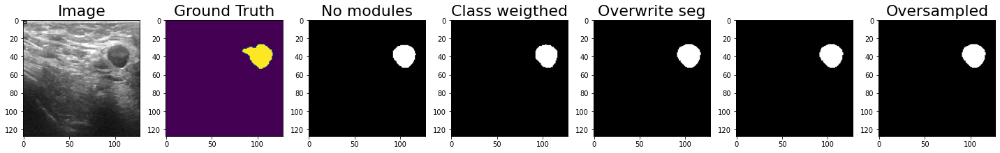

In [51]:
patient_type = 'malignant'
number = '28'
fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]

image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)
ground_truth = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
imgs = [image] + [ground_truth] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]

plot_postprocessing(imgs)

### Mejora en la forma

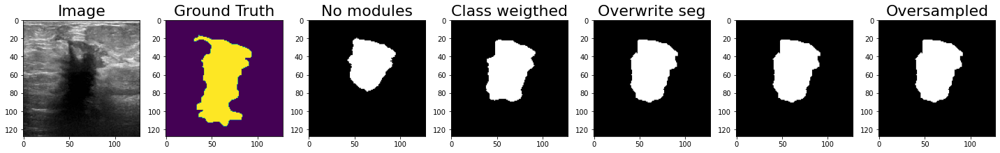

In [53]:
patient_type = 'malignant'
number = '33'
fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)
ground_truth = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
imgs = [image] + [ground_truth] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]

plot_postprocessing(imgs)

### Algunos empeoramientos finalmente se corrigen con el balanceo

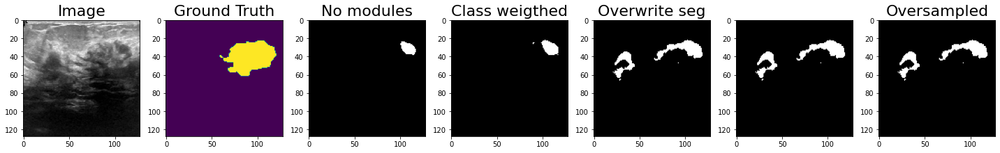

In [54]:
patient_type = 'malignant'
number = '41'
fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)
ground_truth = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
imgs = [image] + [ground_truth] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]

plot_postprocessing(imgs)

### fill holes (aun tenemos mejora)

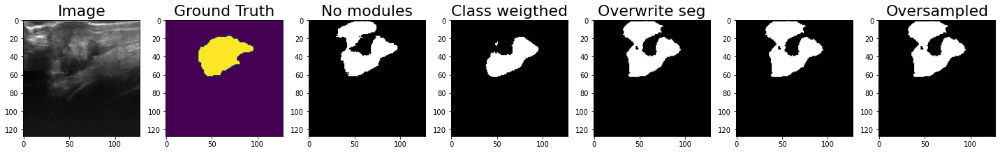

In [55]:
patient_type = 'malignant'
number = '36'
fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)
ground_truth = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
imgs = [image] + [ground_truth] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]

plot_postprocessing(imgs)

### unicamente un caso critico pasando de maligna a normal

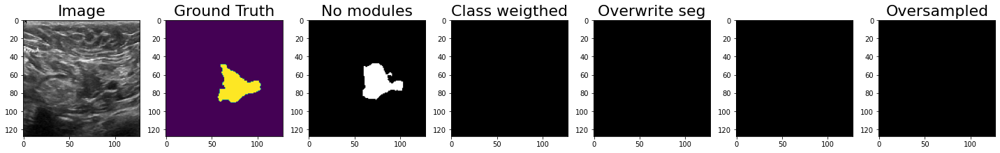

In [56]:
patient_type = 'malignant'
number = '11'
fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)
ground_truth = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
imgs = [image] + [ground_truth] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]

plot_postprocessing(imgs)

In [101]:
def filter_small_components(segmented_image):
    # Perform connected component analysis
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(segmented_image, connectivity=8)

    # Calculate a dynamic threshold based on the statistics
    threshold_area = max(stats[1:, cv2.CC_STAT_AREA].mean() * 0.5, 10)  # Adjust the multiplier or minimum threshold as needed

    # Filter out small connected components by setting their pixels to zero
    filtered_image = segmented_image.copy()
    for label in range(1, num_labels):
        area = stats[label, cv2.CC_STAT_AREA]
        if area < threshold_area:
            filtered_image[labels == label] = 0

    return filtered_image


def fill_small_holes_with_inpaint(segmented_image):
    # Invert the image (holes are represented as 0 in OpenCV)
    inverted_image = cv2.bitwise_not(segmented_image)

    # Threshold the inverted image to create a mask of the areas to be inpainted
    ret, mask = cv2.threshold(inverted_image, 1, 255, cv2.THRESH_BINARY)

    # Apply inpainting to fill small holes
    filled_image = cv2.inpaint(segmented_image, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA)

    return filled_image

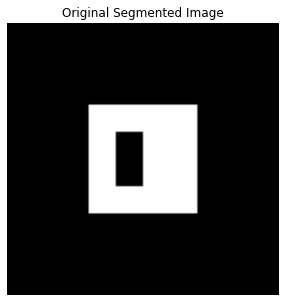

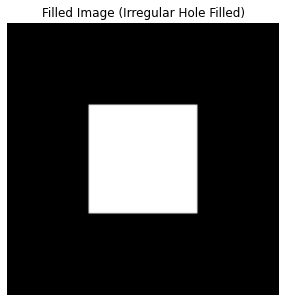

In [120]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def fill_irregular_hole(segmented_image, fill_value=255):
    
    if np.all(segmented_image == 0):
        return segmented_image
    # Find contours of holes
    contours, _ = cv2.findContours(segmented_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Find the contour with the largest area (the assumed hole)
    largest_contour = max(contours, key=cv2.contourArea)

    # Fill the largest contour (hole) with the specified value
    filled_image = segmented_image.copy()
    cv2.drawContours(filled_image, [largest_contour], -1, fill_value, thickness=cv2.FILLED)

    return filled_image

# Creating a synthetic segmented image with an irregular hole in the center
segmented_image = np.zeros((100, 100), dtype=np.uint8)
segmented_image[30:70, 30:70] = 255
segmented_image[40:60, 40:50] = 0  # Creating an irregular hole in the center

# Display the original segmented image
plt.figure(figsize=(5, 5))
plt.imshow(segmented_image, cmap='gray')
plt.title('Original Segmented Image')
plt.axis('off')
plt.show()

# Fill the irregular hole with the specified value and display the result
filled_result = fill_irregular_hole(segmented_image, fill_value=255)

plt.figure(figsize=(5, 5))
plt.imshow(filled_result, cmap='gray')
plt.title('Filled Image (Irregular Hole Filled)')
plt.axis('off')
plt.show()




Patient:  1 			DICE:  0.893


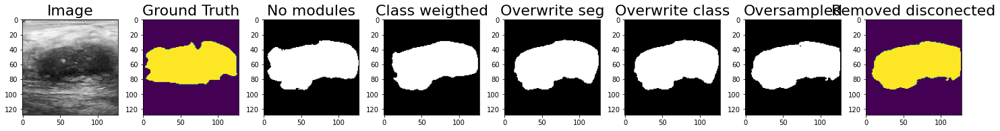

Patient:  2 			DICE:  0.833


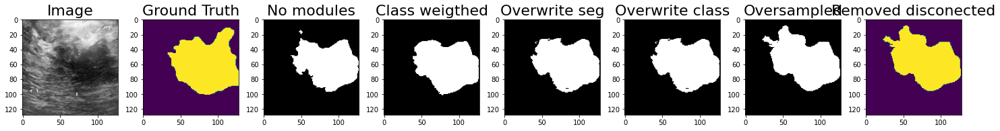

Patient:  3 			DICE:  0.752


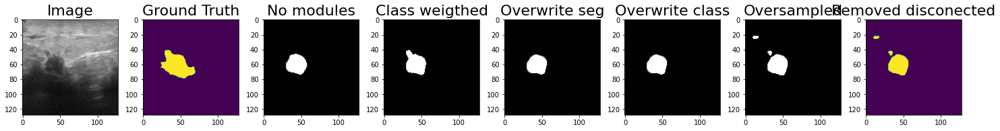

Patient:  6 			DICE:  0.521


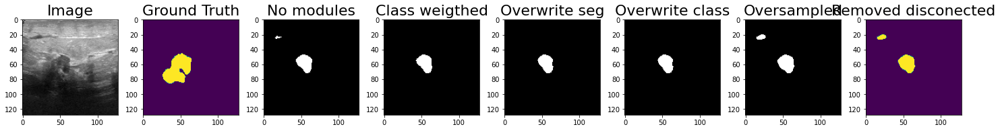

Patient:  16 			DICE:  0.749


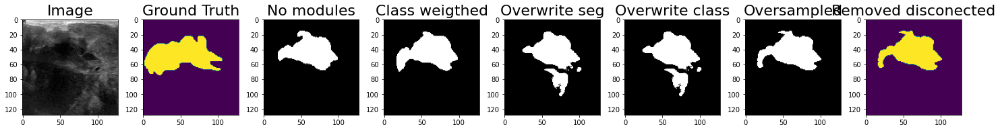

Patient:  19 			DICE:  0.826


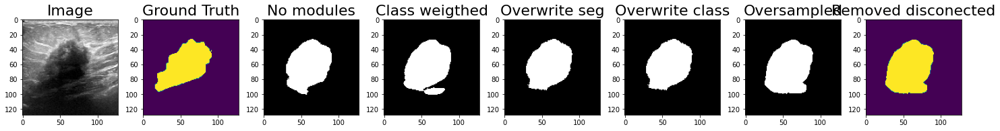

Patient:  20 			DICE:  0.783


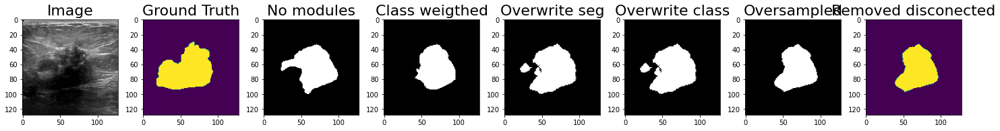

Patient:  21 			DICE:  0.406


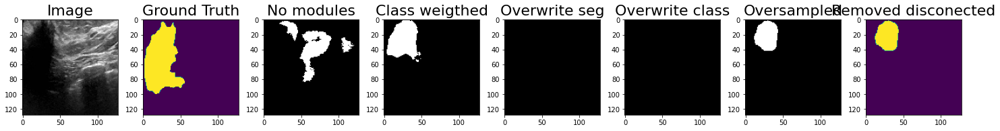

Patient:  22 			DICE:  0.794


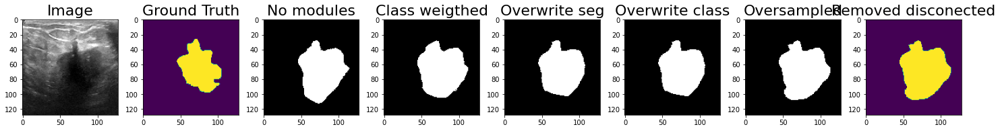

Patient:  23 			DICE:  0.788


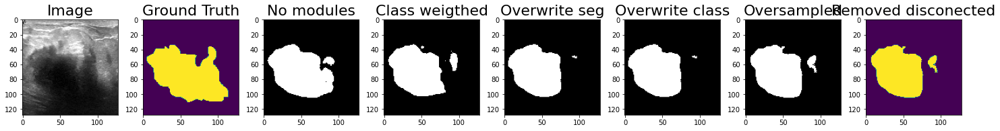

Patient:  24 			DICE:  0.871


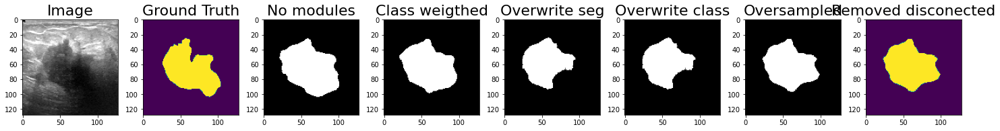

Patient:  25 			DICE:  0.818


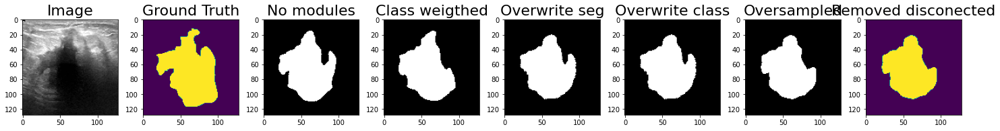

Patient:  26 			DICE:  0.934


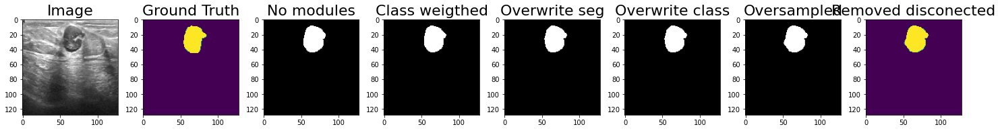

Patient:  27 			DICE:  0.884


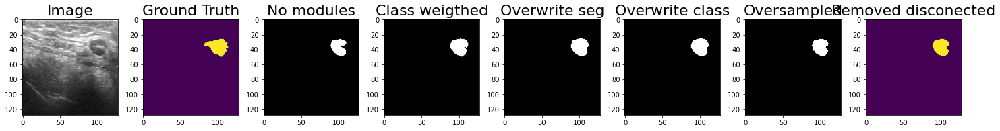

Patient:  28 			DICE:  0.927


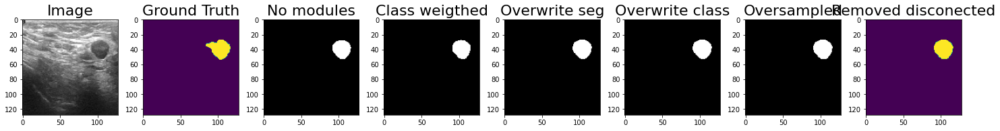

Patient:  29 			DICE:  0.79


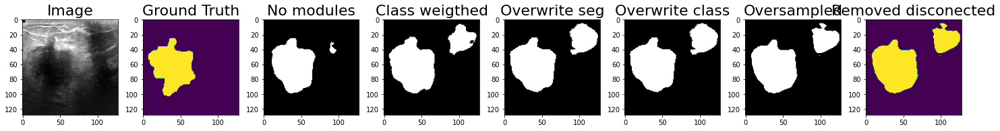

Patient:  30 			DICE:  0.902


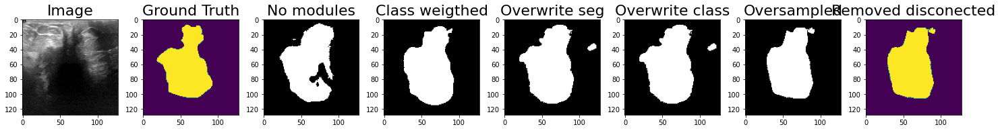

Patient:  31 			DICE:  0.686


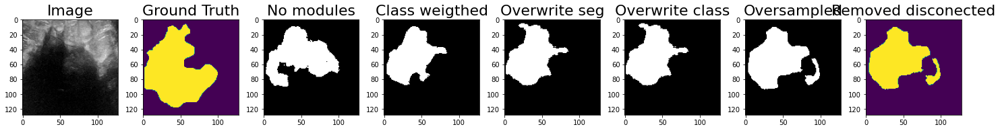

Patient:  32 			DICE:  0.877


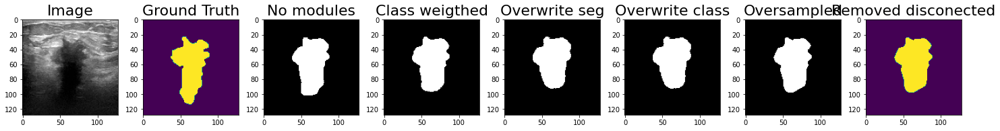

Patient:  33 			DICE:  0.804


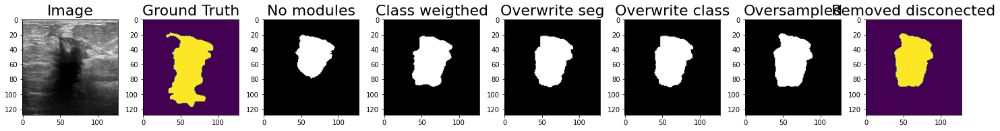

Patient:  35 			DICE:  0.942


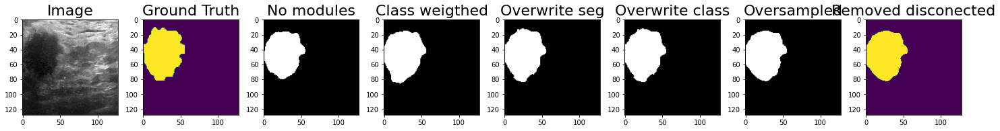

Patient:  36 			DICE:  0.725


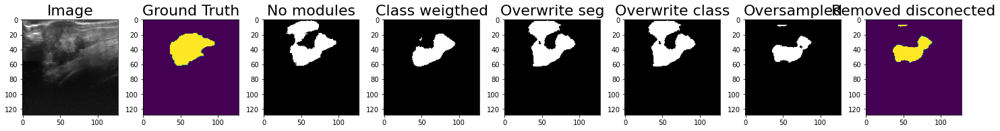

Patient:  37 			DICE:  0.614


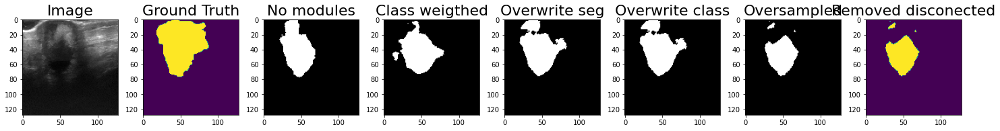

Patient:  38 			DICE:  0.927


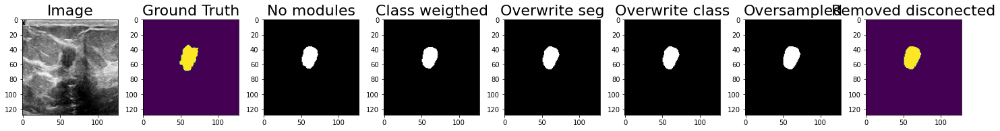

Patient:  40 			DICE:  0.932


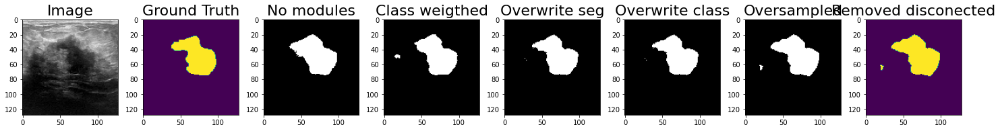

Patient:  41 			DICE:  0.245


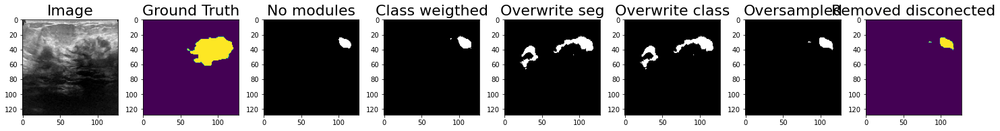

Patient:  43 			DICE:  0.159


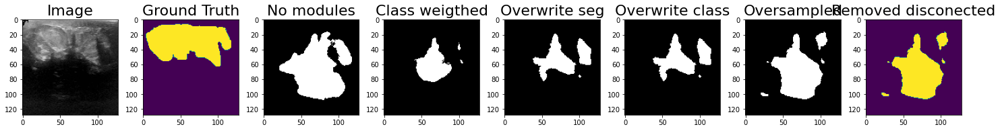

Patient:  44 			DICE:  0.571


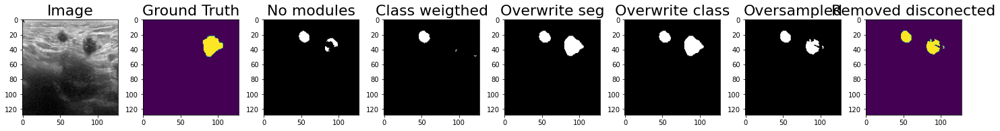

Patient:  45 			DICE:  0.022


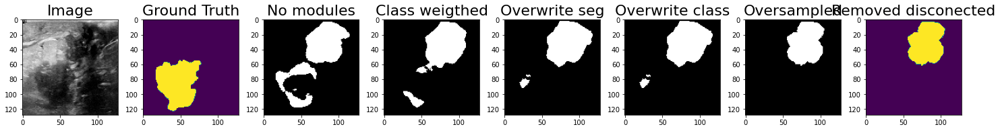

Patient:  46 			DICE:  0.776


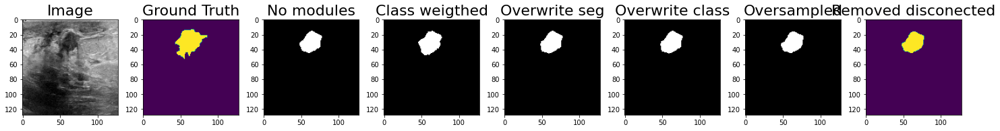

Patient:  47 			DICE:  0.886


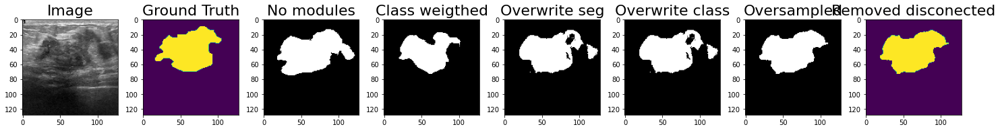

Patient:  48 			DICE:  0.926


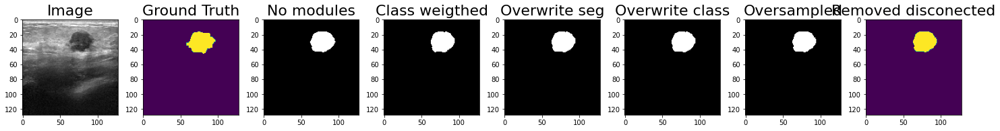

Patient:  49 			DICE:  0.85


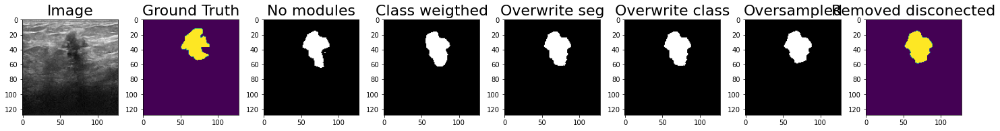

Patient:  50 			DICE:  0.474


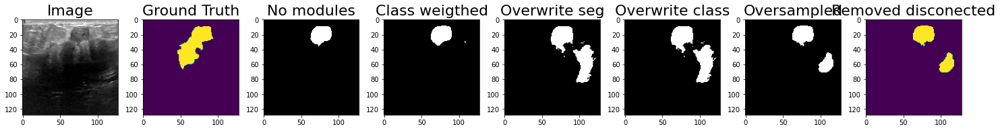

Patient:  53 			DICE:  0.869


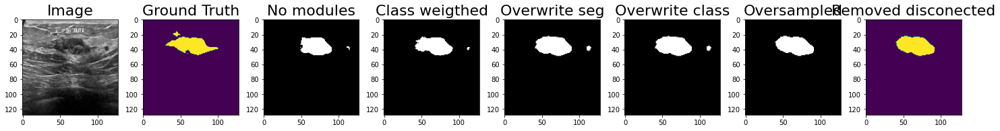

Patient:  54 			DICE:  0.908


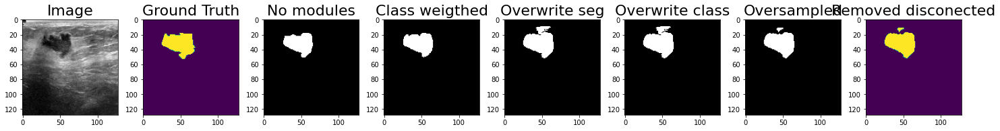

Patient:  55 			DICE:  0.925


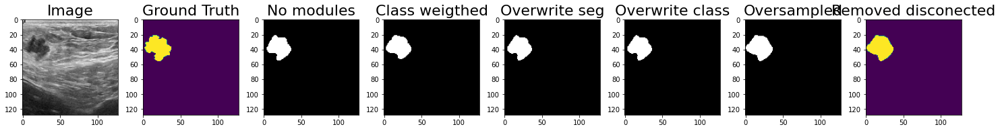

Patient:  56 			DICE:  0.912


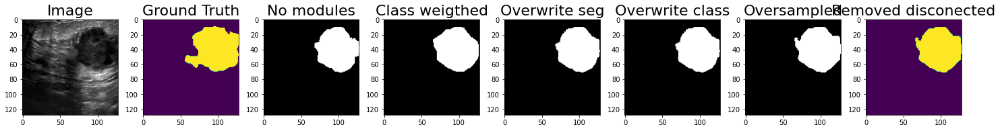

Patient:  57 			DICE:  0.851


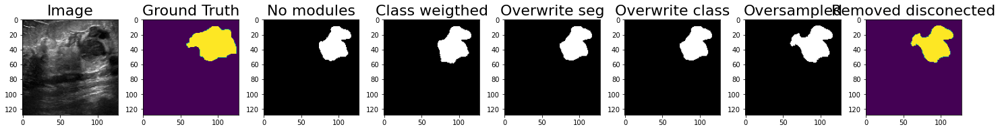

Patient:  58 			DICE:  0.923


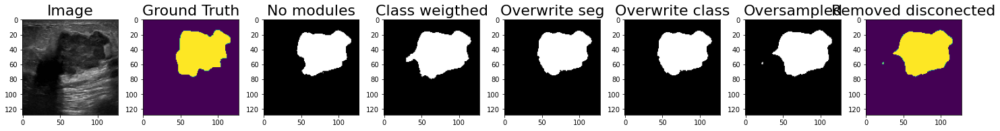

Patient:  59 			DICE:  0.908


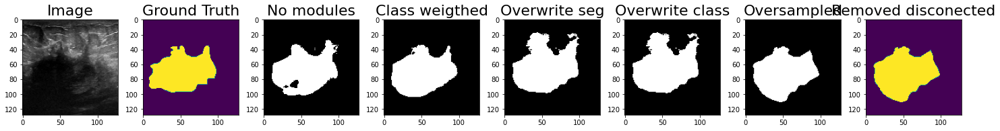

Patient:  60 			DICE:  0.787


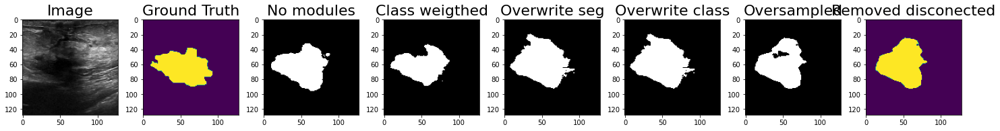

Patient:  61 			DICE:  0.678


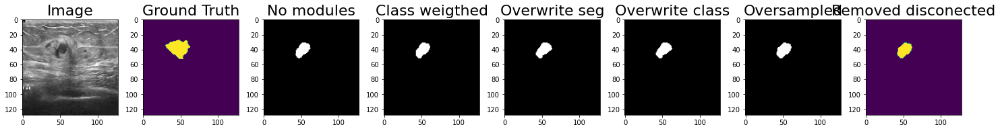

Patient:  62 			DICE:  0.854


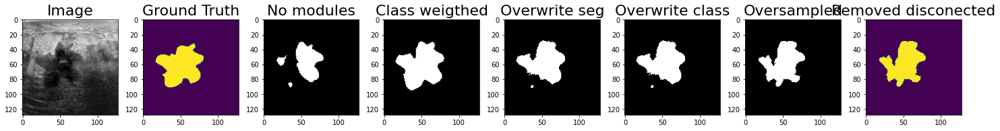

Patient:  63 			DICE:  0.901


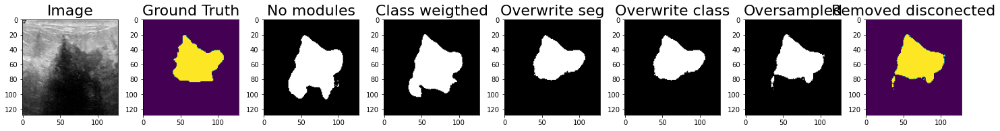

Patient:  64 			DICE:  0.692


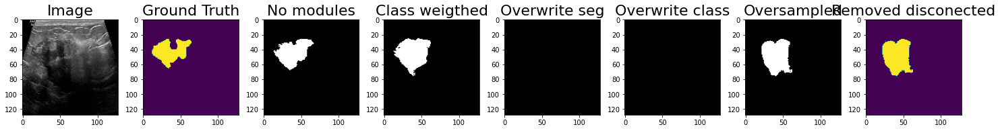

Patient:  67 			DICE:  0.578


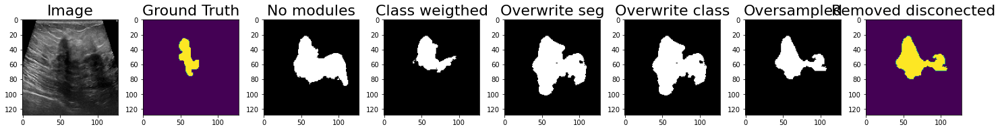

Patient:  68 			DICE:  0.492


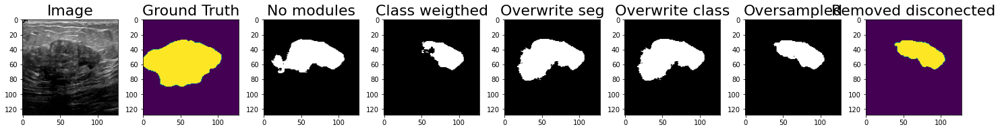

Patient:  69 			DICE:  0.85


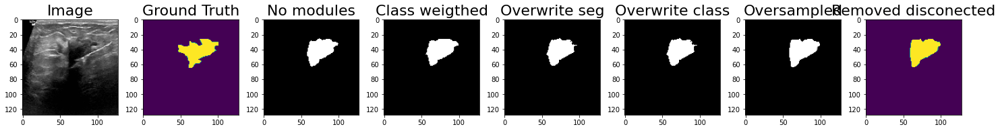

Patient:  70 			DICE:  0.877


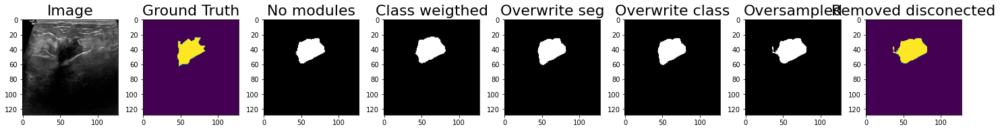

Patient:  71 			DICE:  0.872


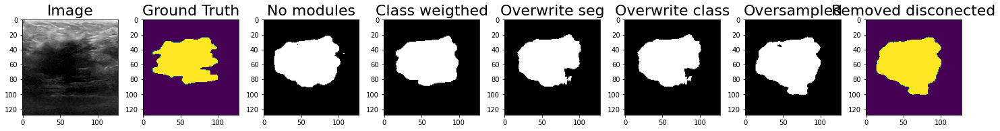

Patient:  72 			DICE:  0.706


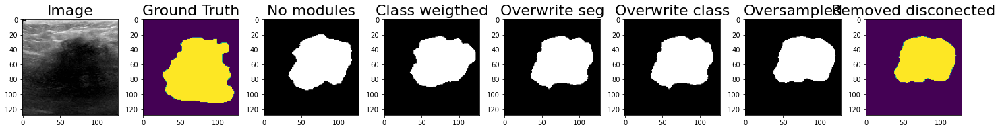

Patient:  73 			DICE:  0.869


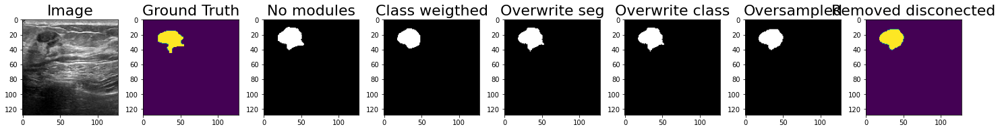

Patient:  74 			DICE:  0.79


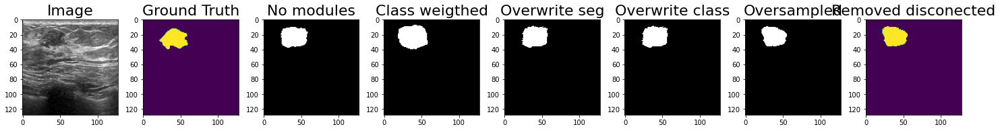

Patient:  75 			DICE:  0.009


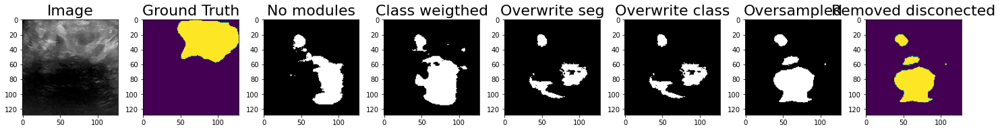

Patient:  76 			DICE:  0.615


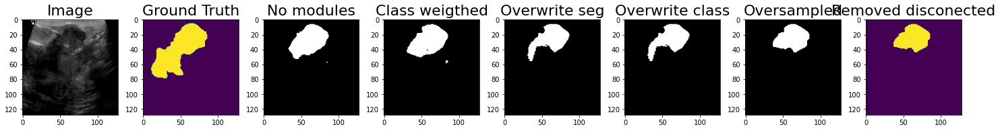

Patient:  79 			DICE:  0.849


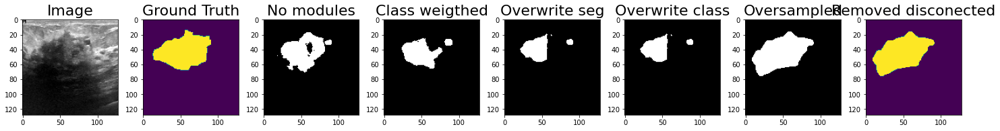

Patient:  82 			DICE:  0.672


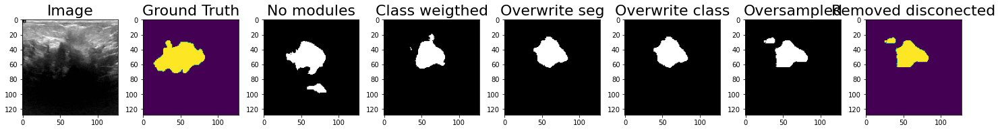

Patient:  83 			DICE:  0.872


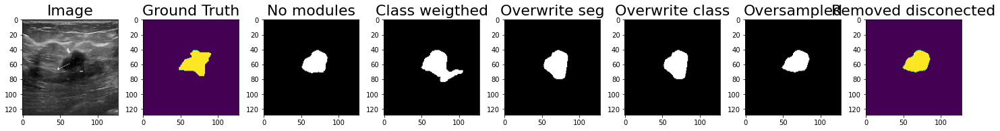

Patient:  84 			DICE:  0.741


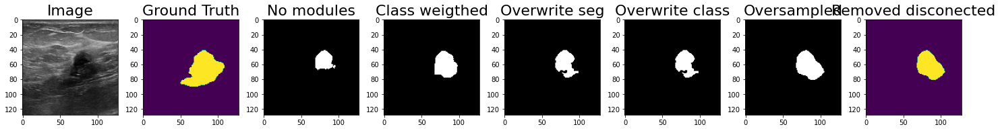

Patient:  85 			DICE:  0.936


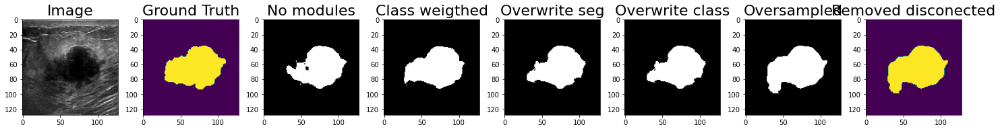

Patient:  86 			DICE:  0.867


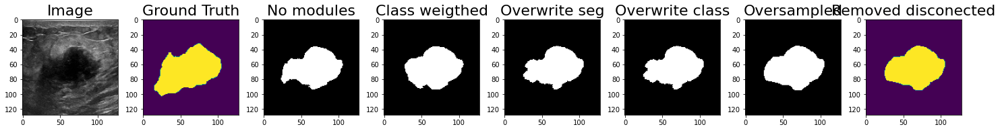

Patient:  87 			DICE:  0.967


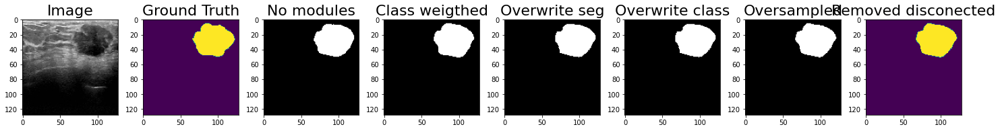

Patient:  89 			DICE:  0.081


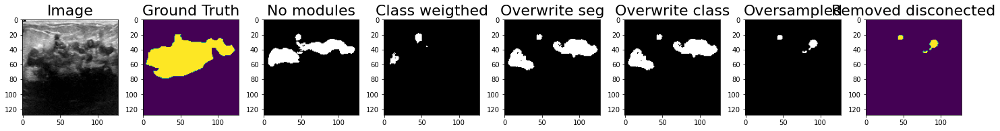

Patient:  90 			DICE:  0.39


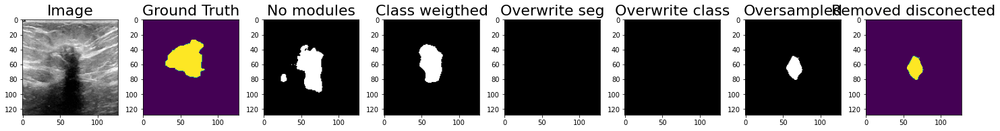

Patient:  91 			DICE:  0.681


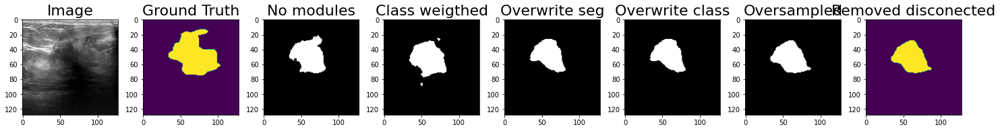

Patient:  100 			DICE:  0.657


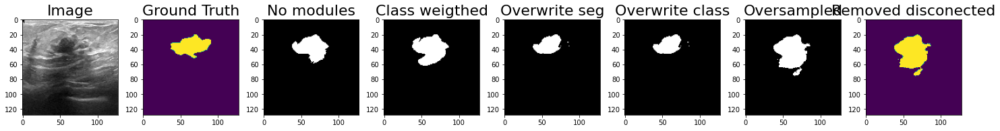

Patient:  101 			DICE:  0.796


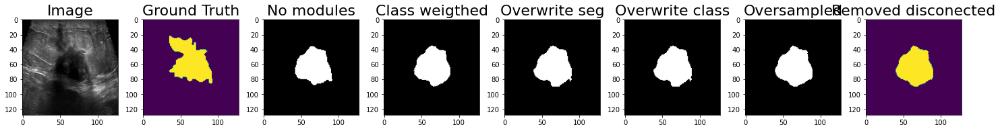

Patient:  102 			DICE:  0.883


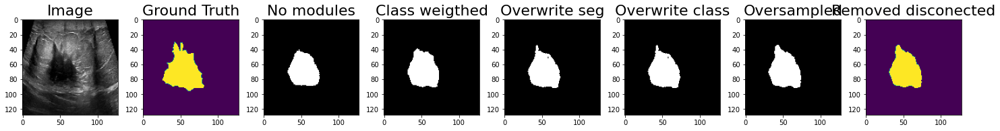

Patient:  103 			DICE:  0.84


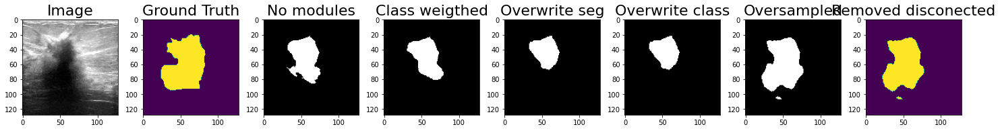

Patient:  104 			DICE:  0.823


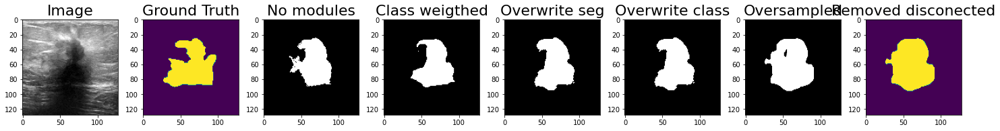

Patient:  115 			DICE:  0.849


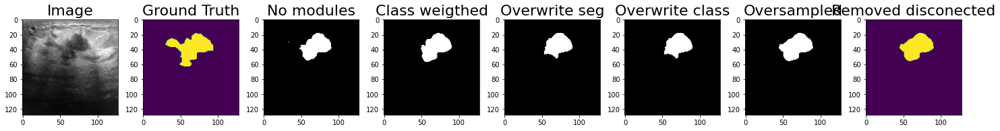

Patient:  117 			DICE:  0.634


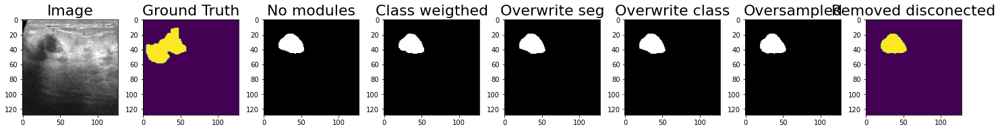

Patient:  120 			DICE:  0.891


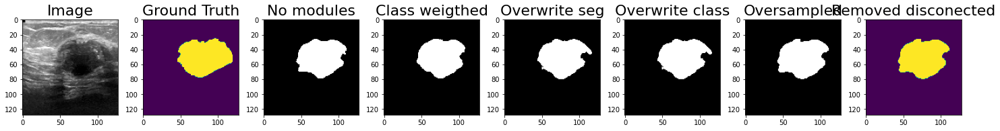

Patient:  121 			DICE:  0.852


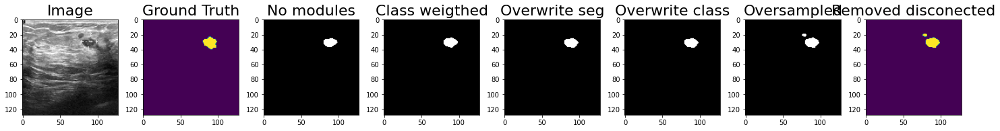

Patient:  122 			DICE:  0.932


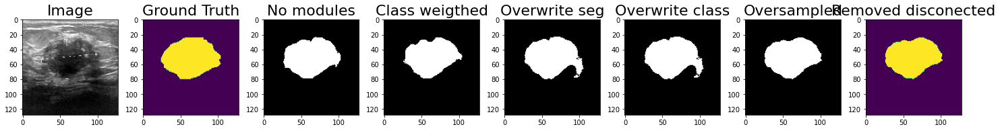

Patient:  124 			DICE:  0.902


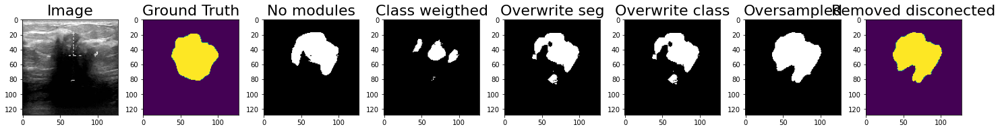

Patient:  125 			DICE:  0.698


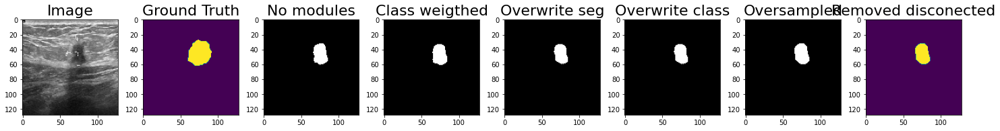

Patient:  126 			DICE:  0.711


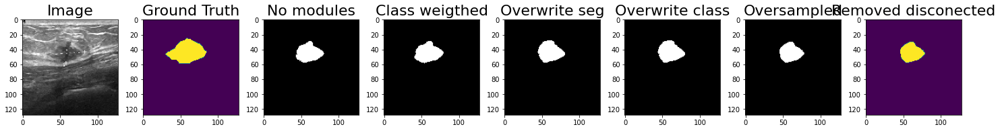

Patient:  127 			DICE:  0.868


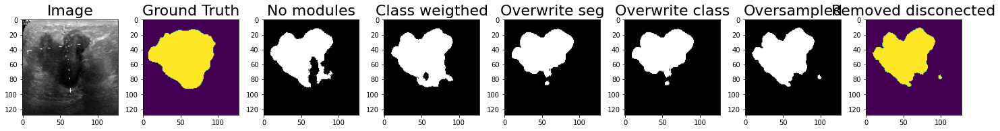

Patient:  130 			DICE:  0.936


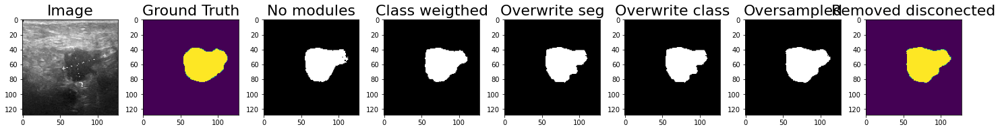

Patient:  131 			DICE:  0.93


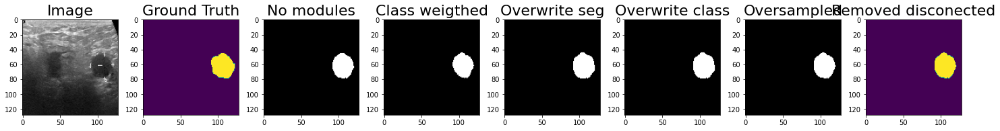

Patient:  132 			DICE:  0.927


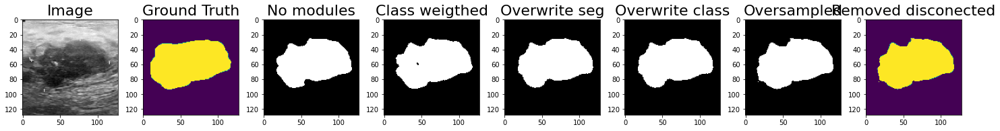

Patient:  133 			DICE:  0.86


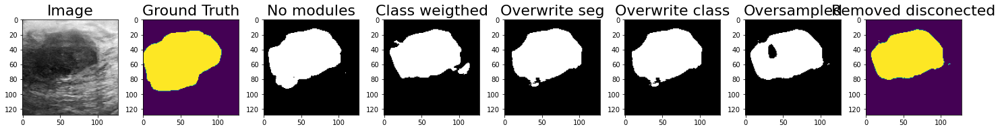

Patient:  134 			DICE:  0.773


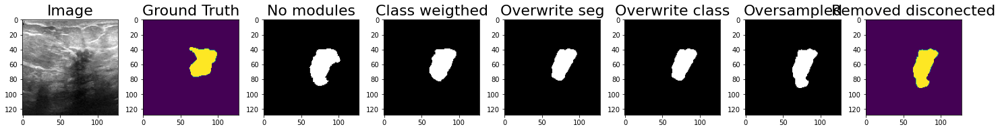

Patient:  135 			DICE:  0.901


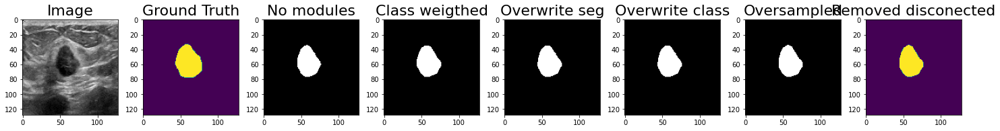

Patient:  136 			DICE:  0.759


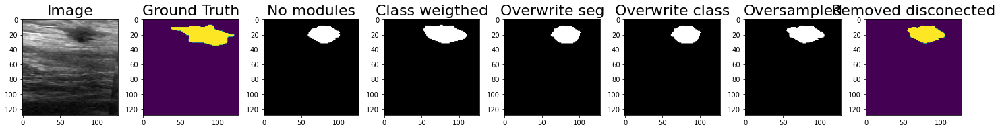

Patient:  137 			DICE:  0.854


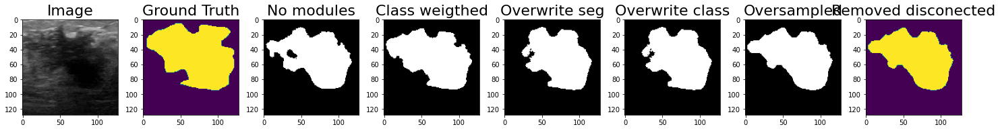

Patient:  138 			DICE:  0.074


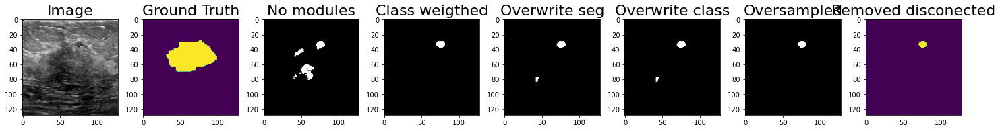

Patient:  139 			DICE:  0.925


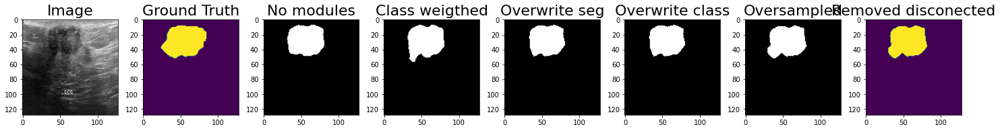

Patient:  140 			DICE:  0.789


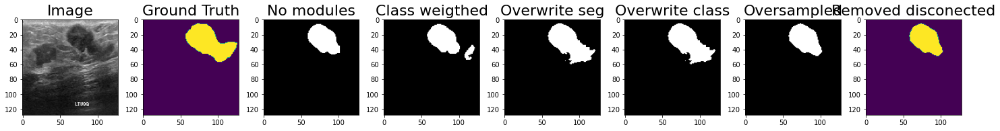

Patient:  141 			DICE:  0.861


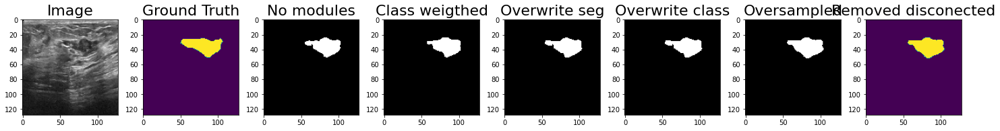

Patient:  142 			DICE:  0.862


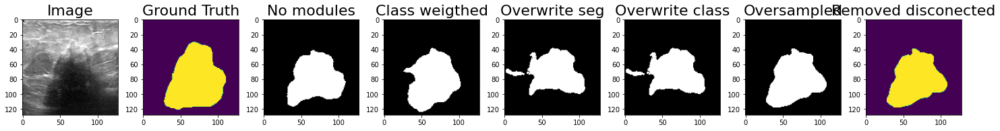

Patient:  143 			DICE:  0.847


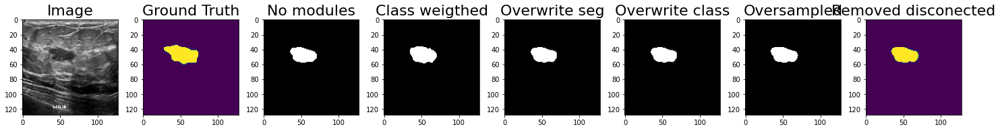

Patient:  144 			DICE:  0.863


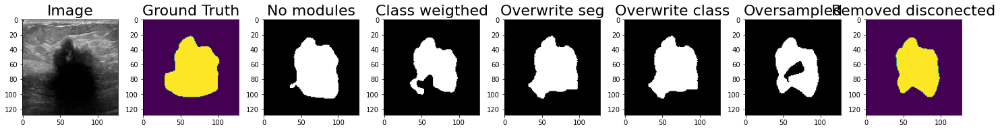

Patient:  146 			DICE:  0.943


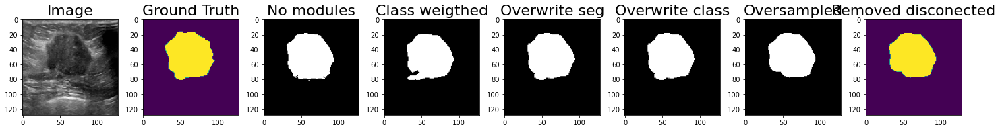

Patient:  147 			DICE:  0.272


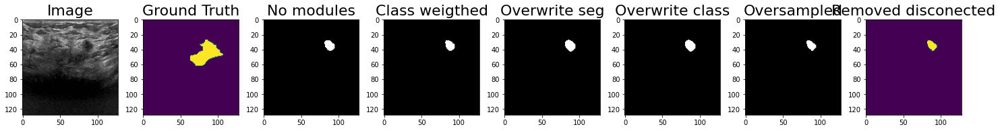

Patient:  148 			DICE:  0.844


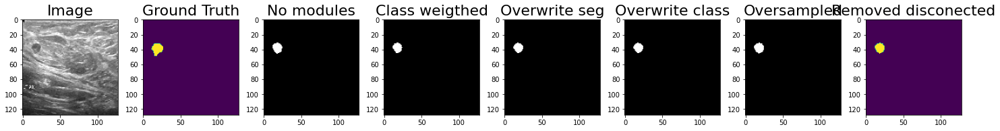

Patient:  149 			DICE:  0.477


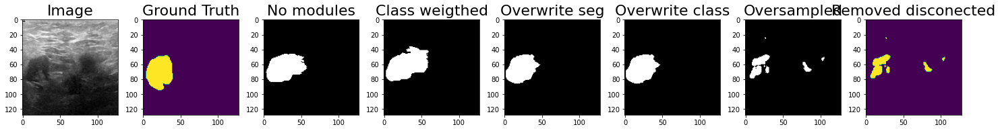

Patient:  150 			DICE:  0.89


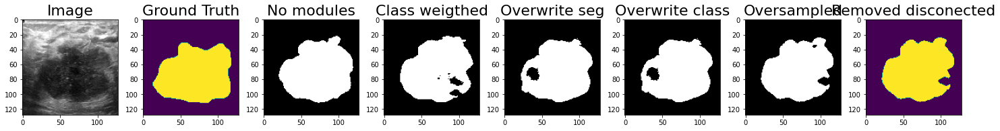

Patient:  151 			DICE:  0.687


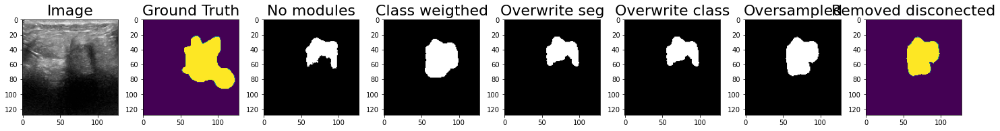

Patient:  152 			DICE:  0.156


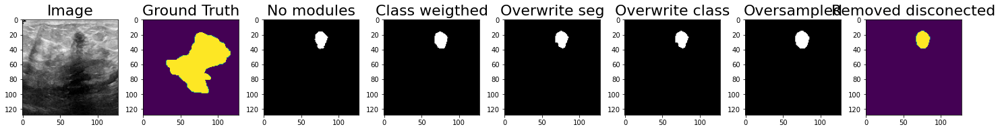

Patient:  153 			DICE:  0.843


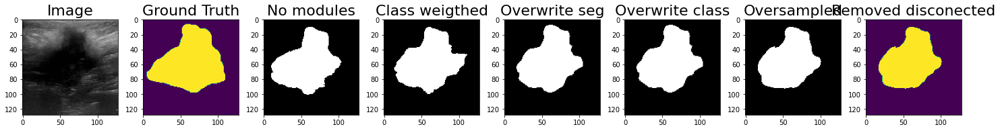

Patient:  154 			DICE:  0.907


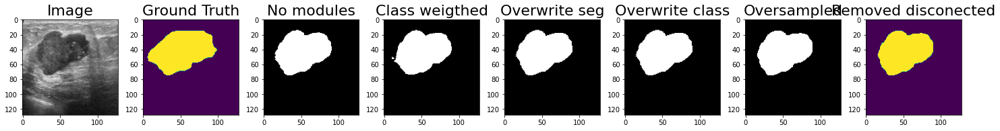

Patient:  155 			DICE:  0.852


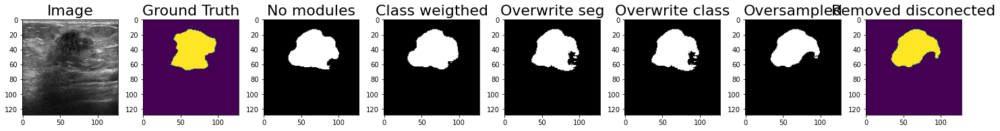

Patient:  156 			DICE:  0.627


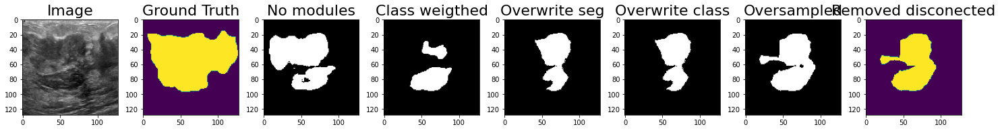

Patient:  157 			DICE:  0.012


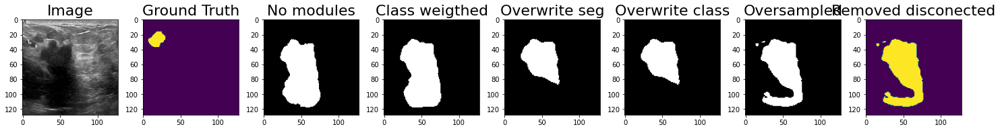

Patient:  158 			DICE:  0.481


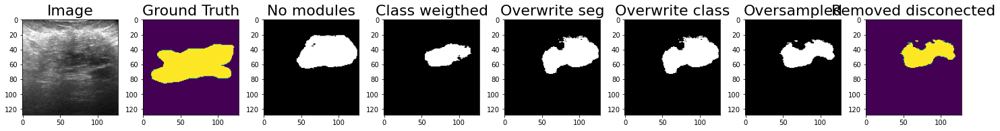

Patient:  159 			DICE:  0.549


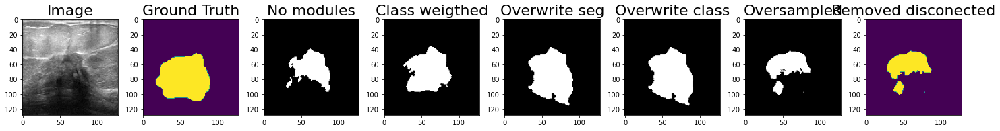

Patient:  160 			DICE:  0.542


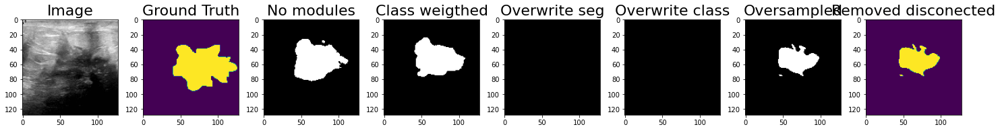

Patient:  161 			DICE:  0.724


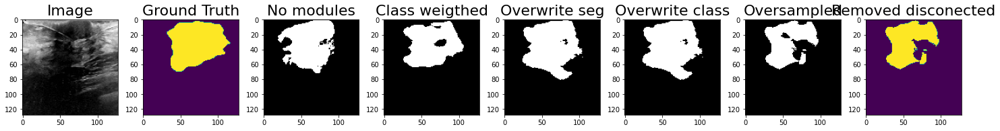

Patient:  162 			DICE:  0.909


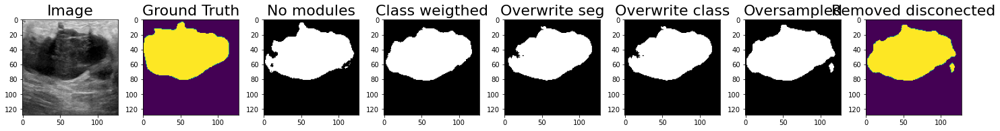

Patient:  163 			DICE:  0.956


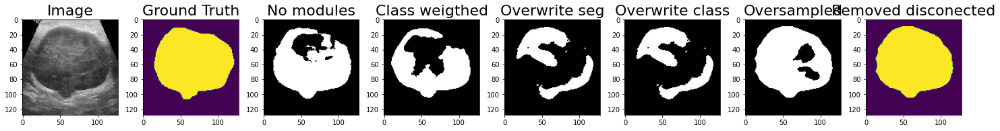

Patient:  164 			DICE:  0.631


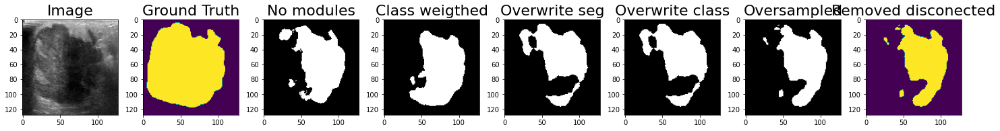

Patient:  165 			DICE:  0.857


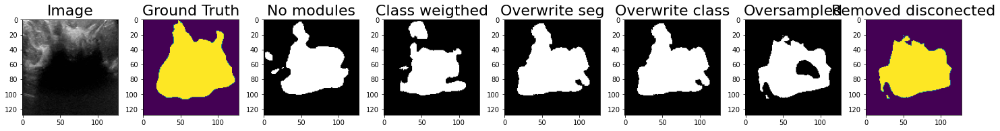

Patient:  166 			DICE:  0.766


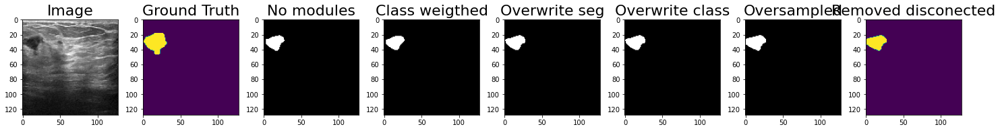

Patient:  167 			DICE:  0.947


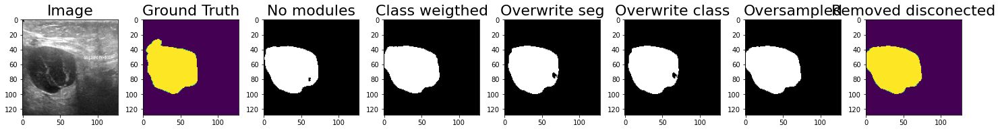

Patient:  168 			DICE:  0.898


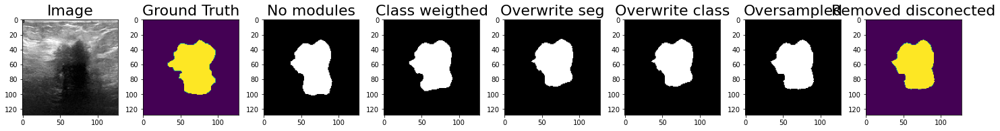

Patient:  169 			DICE:  0.045


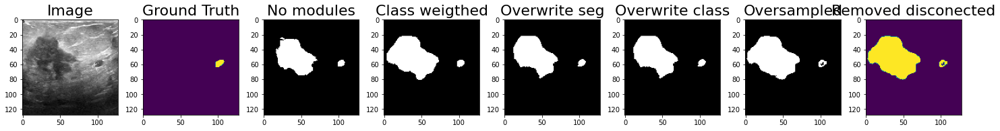

Patient:  170 			DICE:  0.869


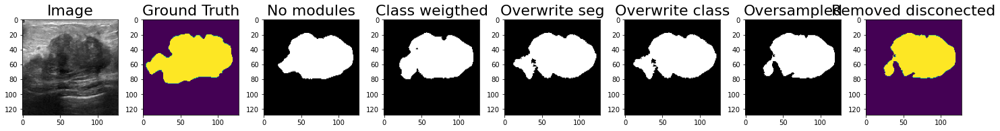

Patient:  171 			DICE:  0.706


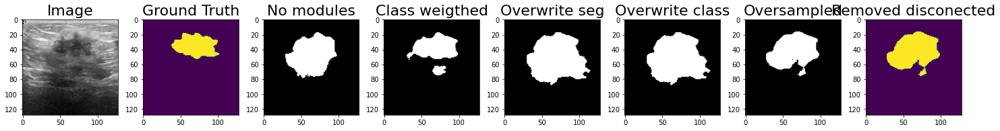

Patient:  172 			DICE:  0.936


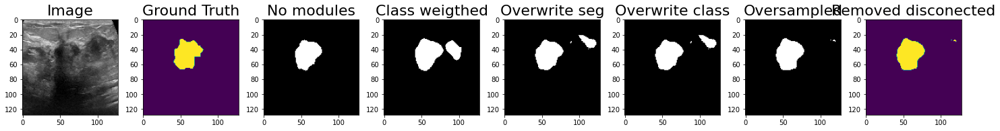

Patient:  174 			DICE:  0.85


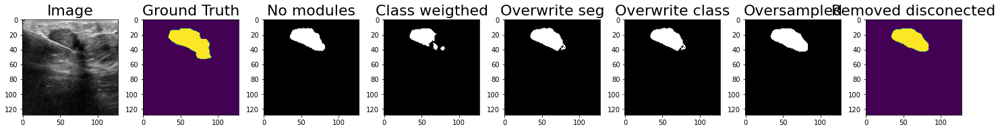

Patient:  175 			DICE:  0.66


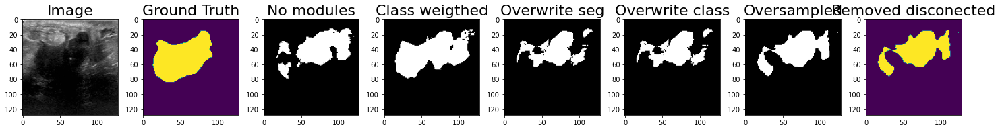

Patient:  176 			DICE:  0.824


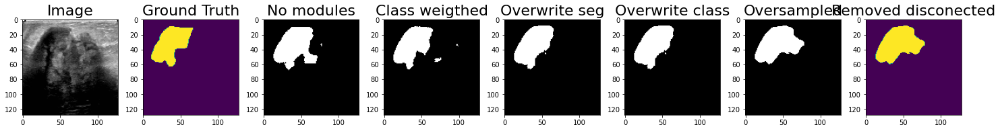

Patient:  177 			DICE:  0.346


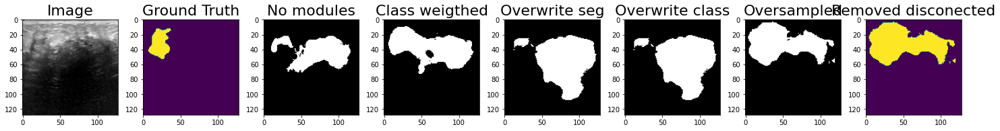

Patient:  178 			DICE:  0.016


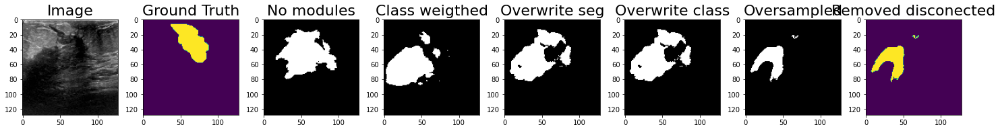

Patient:  179 			DICE:  0.632


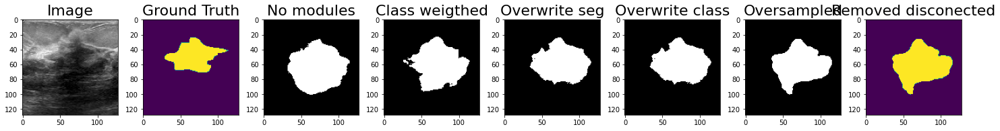

Patient:  180 			DICE:  0.606


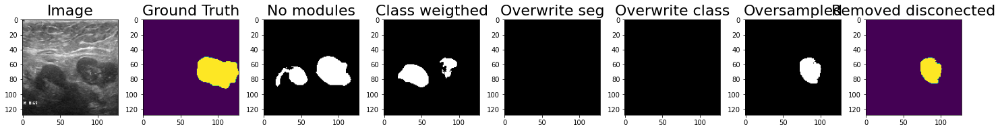

Patient:  181 			DICE:  0.0


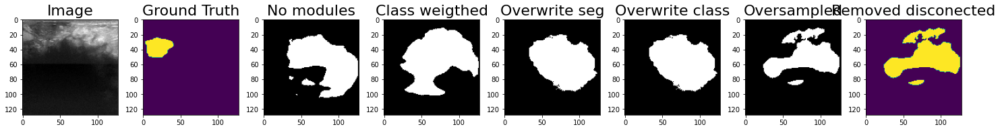

Patient:  182 			DICE:  0.892


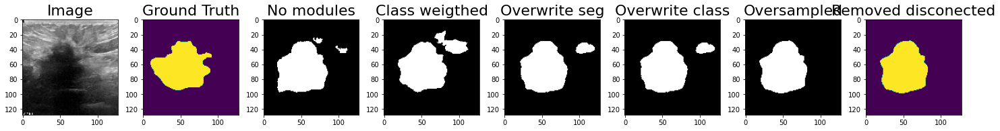

Patient:  183 			DICE:  0.936


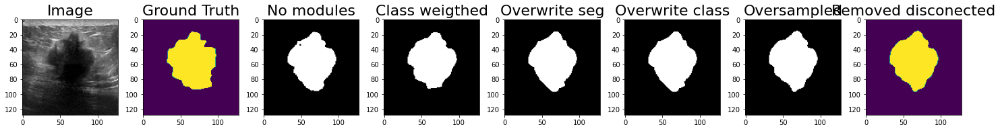

Patient:  184 			DICE:  0.83


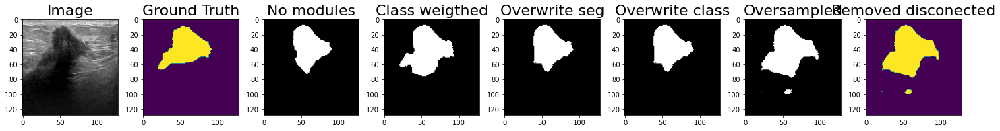

Patient:  185 			DICE:  0.925


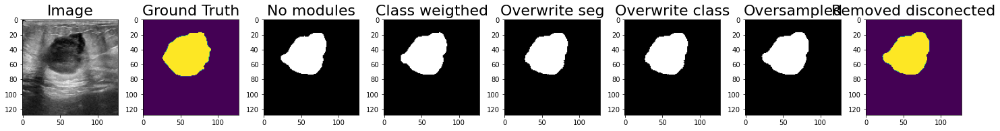

Patient:  186 			DICE:  0.863


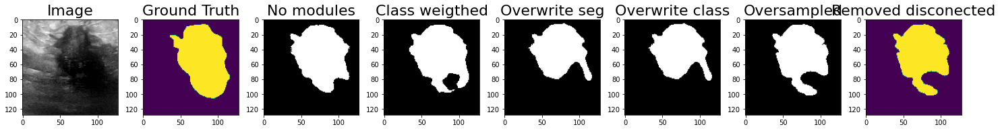

Patient:  187 			DICE:  0.556


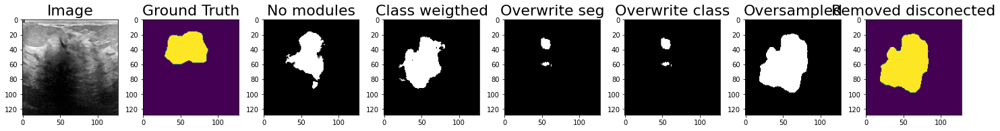

Patient:  188 			DICE:  0.854


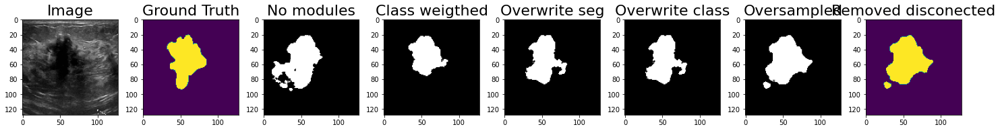

Patient:  189 			DICE:  0.099


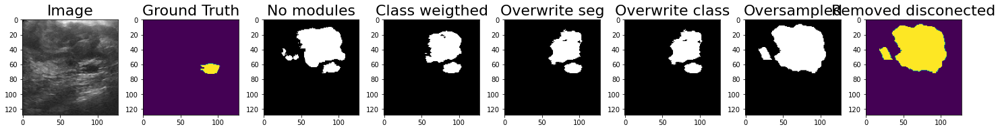

Patient:  190 			DICE:  0.891


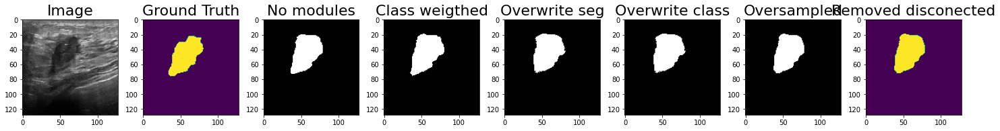

Patient:  192 			DICE:  0.777


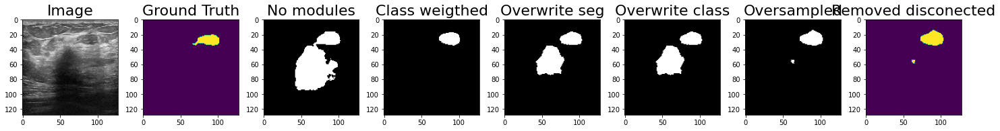

Patient:  193 			DICE:  0.861


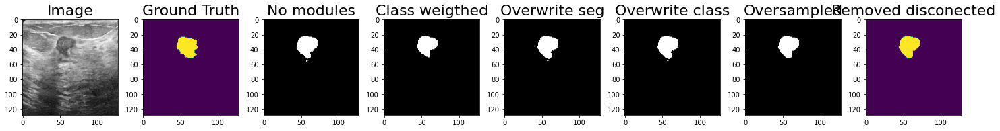

Patient:  194 			DICE:  0.733


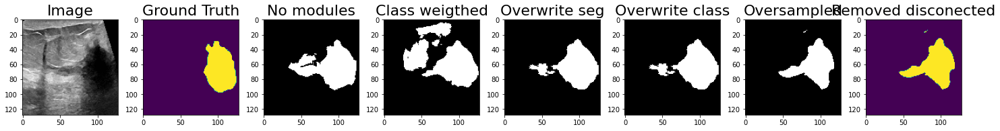

Patient:  195 			DICE:  0.831


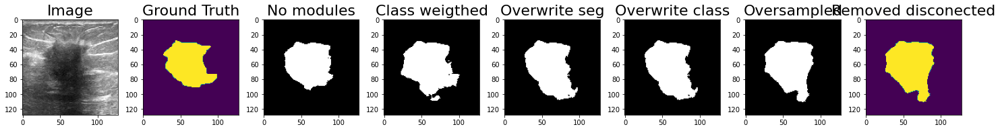

Patient:  196 			DICE:  0.903


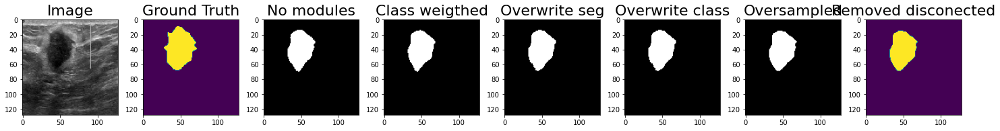

Patient:  197 			DICE:  0.675


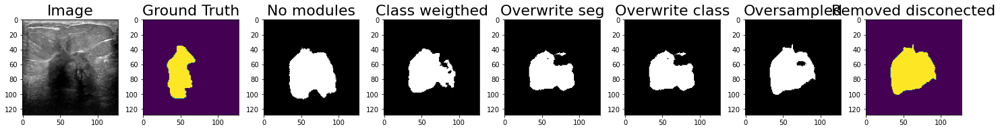

Patient:  198 			DICE:  0.0


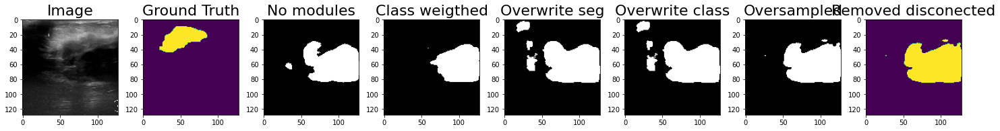

Patient:  199 			DICE:  0.499


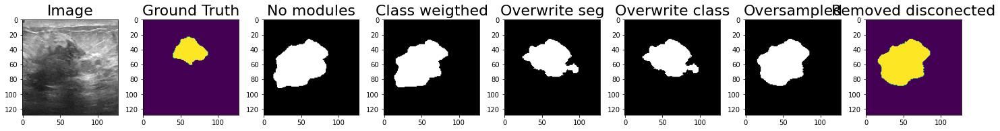

Patient:  200 			DICE:  0.692


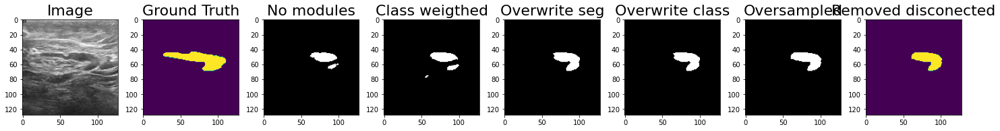

Patient:  201 			DICE:  0.853


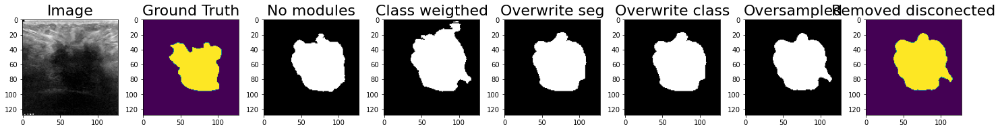

Patient:  202 			DICE:  0.923


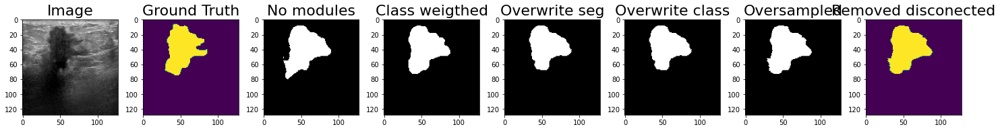

Patient:  203 			DICE:  0.715


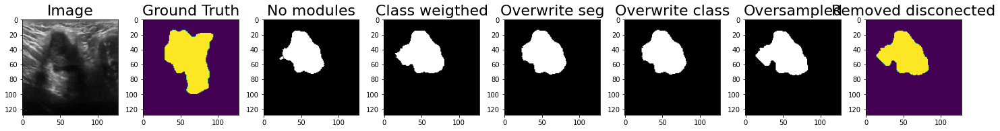

Patient:  204 			DICE:  0.58


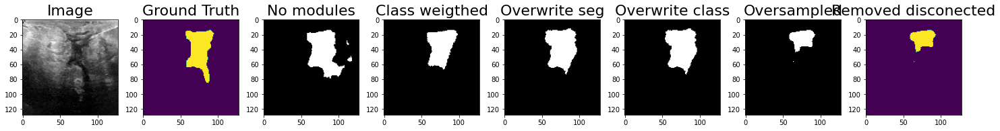

Patient:  205 			DICE:  0.9


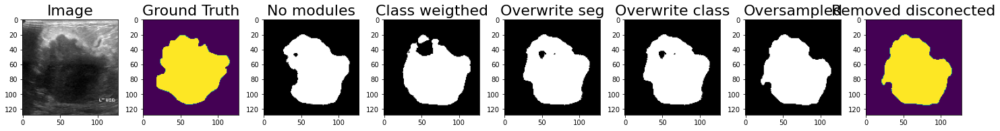

Patient:  206 			DICE:  0.953


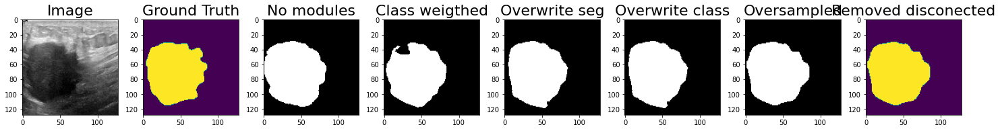

Patient:  207 			DICE:  0.923


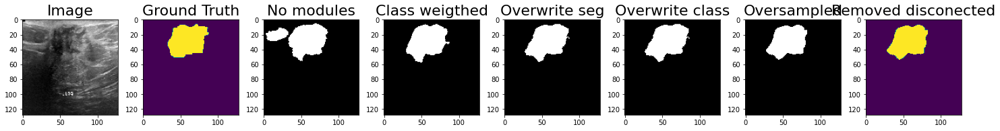

Patient:  208 			DICE:  0.943


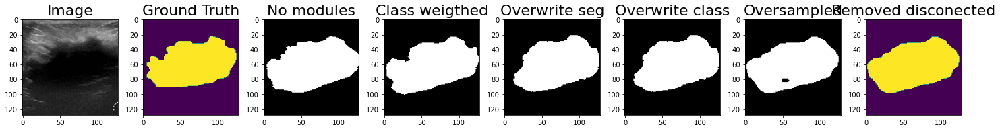

Patient:  209 			DICE:  0.812


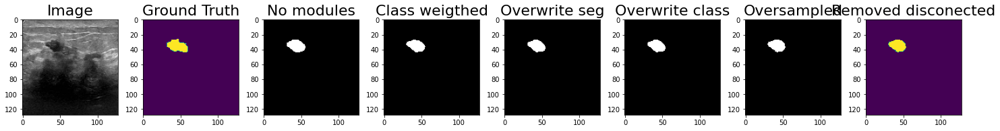

Patient:  210 			DICE:  0.895


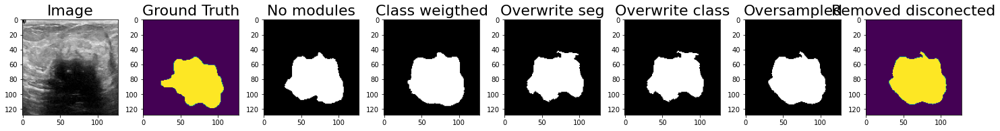

0.7333964840588748


In [117]:
from skimage import io, morphology

patient_type = 'malignant'
result = []
for i in range(500):
    try:
        number = f'{i}'
        fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
        image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)

        gt = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
        imgs = [image] + [gt] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]
        filtered_image = fill_irregular_hole(imgs[-1][:, :, 0])

        imgs = imgs + [filtered_image]
        tp = float(np.sum(l_and(imgs[-1], gt)))
        tn = float(np.sum(l_and(l_not(imgs[-1]), l_not(gt))))
        fp = float(np.sum(l_and(imgs[-1], l_not(gt))))
        fn = float(np.sum(l_and(l_not(imgs[-1]), gt)))
        dice =  dice_score(tp, fp, fn, gt, imgs[-1])

        print("Patient: ", i, "\t\t\tDICE: ", round(dice, 3))
 
        plot_postprocessing(imgs)
        
        result.append(dice)
    except Exception as e:
        pass
print(np.mean(result))

## Normales

Patient:  2 			DICE:  1


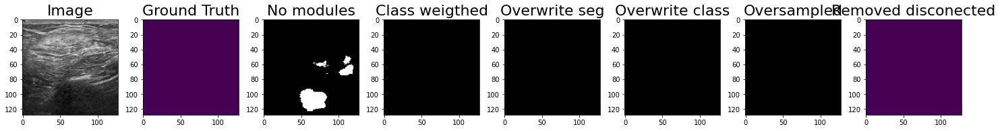

Patient:  3 			DICE:  0


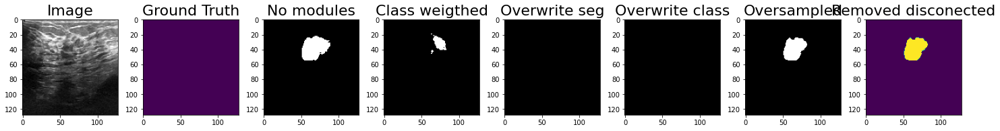

Patient:  4 			DICE:  1


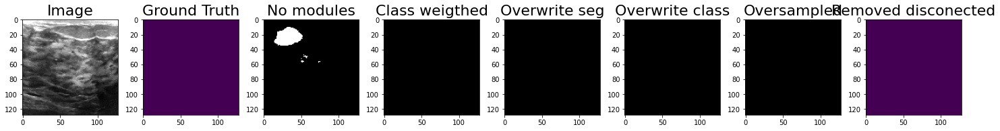

Patient:  6 			DICE:  1


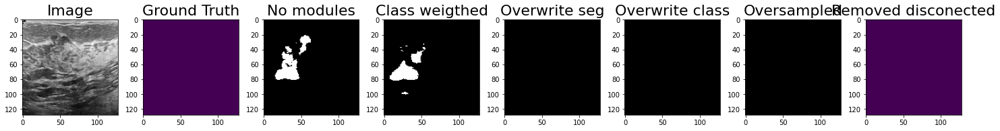

Patient:  7 			DICE:  1


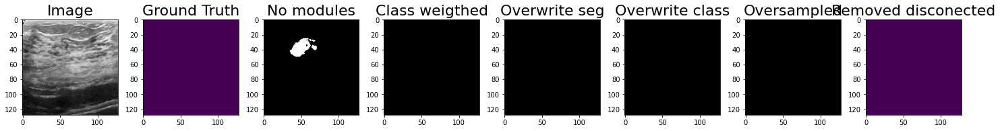

Patient:  8 			DICE:  1


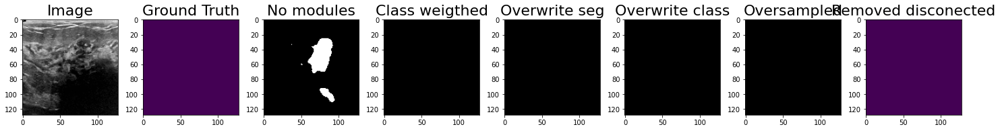

Patient:  9 			DICE:  1


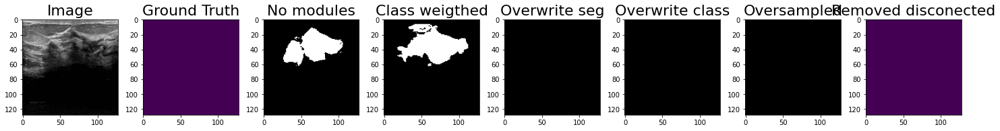

Patient:  10 			DICE:  1


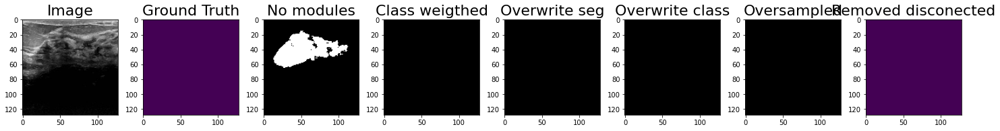

Patient:  11 			DICE:  1


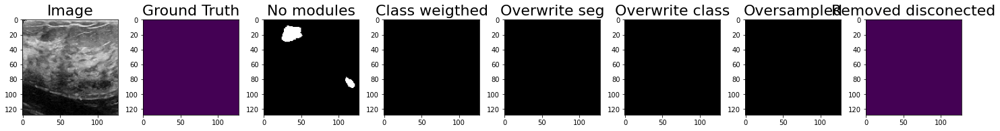

Patient:  12 			DICE:  1


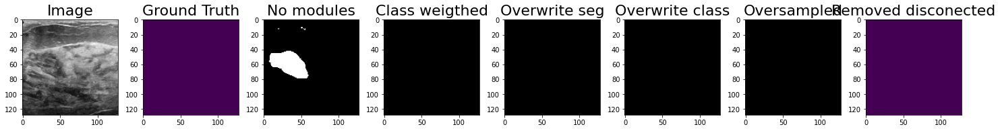

Patient:  14 			DICE:  1


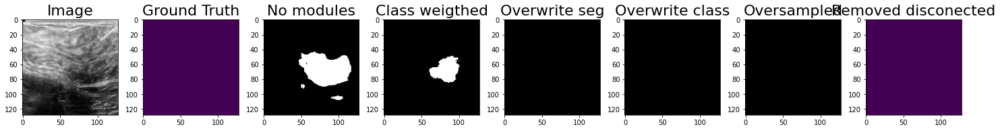

Patient:  15 			DICE:  1


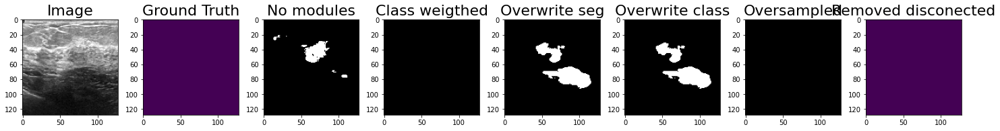

Patient:  16 			DICE:  1


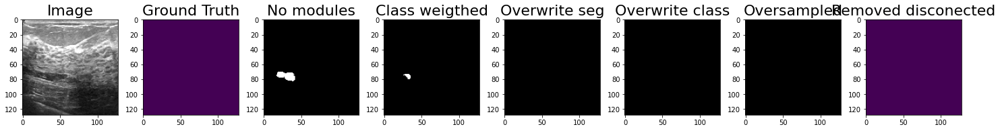

Patient:  17 			DICE:  1


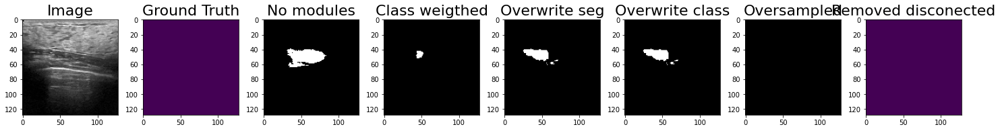

Patient:  18 			DICE:  1


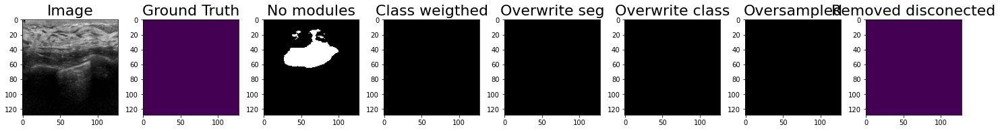

Patient:  36 			DICE:  1


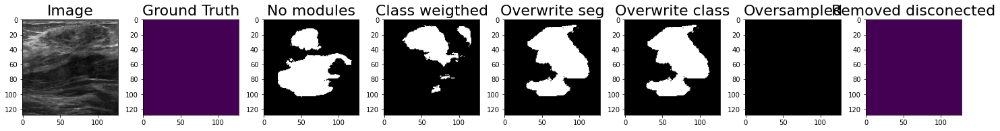

Patient:  37 			DICE:  1


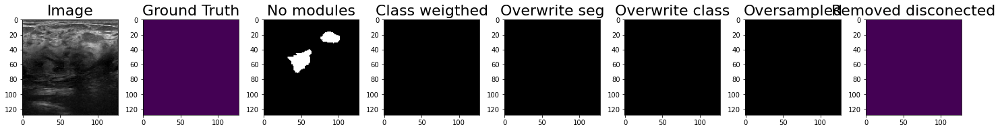

Patient:  65 			DICE:  1


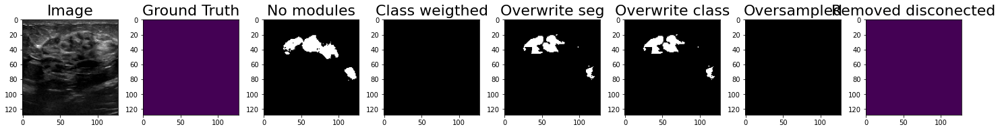

Patient:  66 			DICE:  1


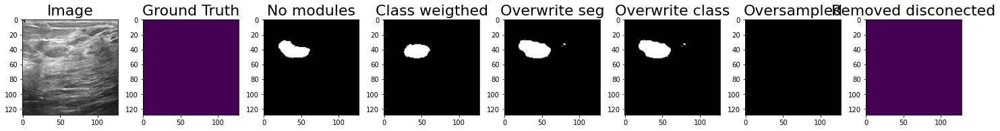

Patient:  70 			DICE:  1


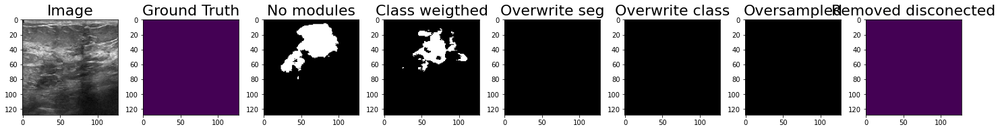

Patient:  71 			DICE:  1


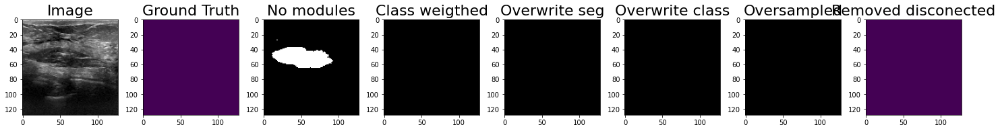

Patient:  72 			DICE:  1


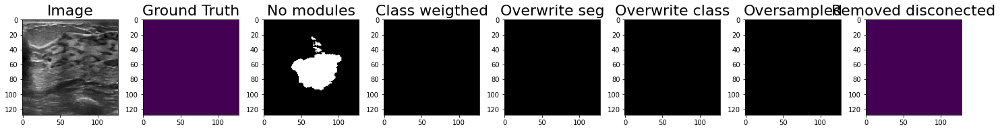

Patient:  73 			DICE:  1


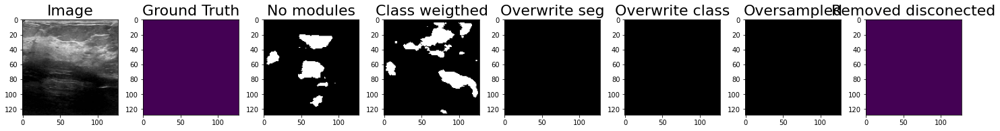

Patient:  74 			DICE:  1


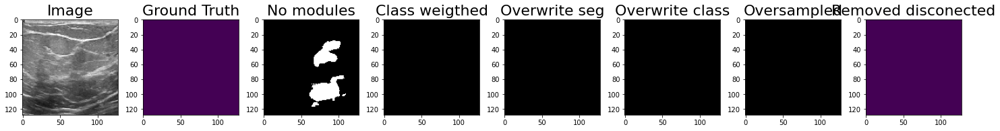

Patient:  75 			DICE:  0


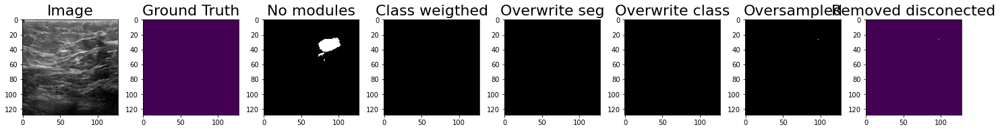

Patient:  76 			DICE:  1


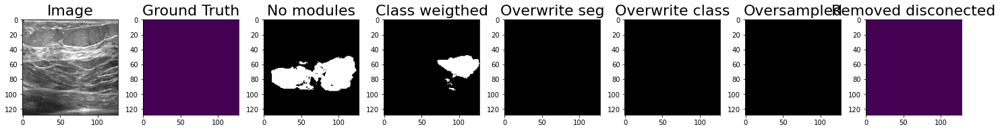

Patient:  77 			DICE:  1


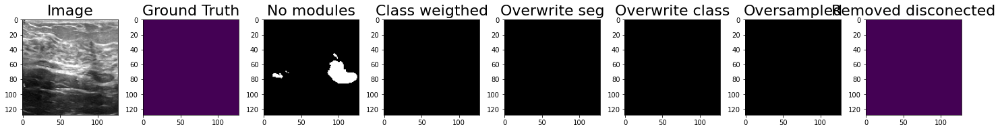

Patient:  78 			DICE:  1


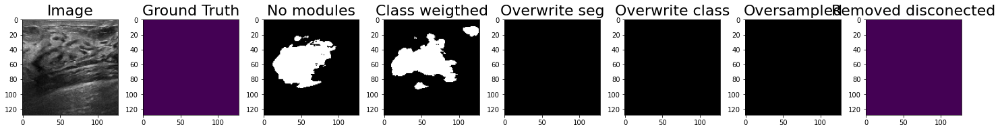

Patient:  79 			DICE:  1


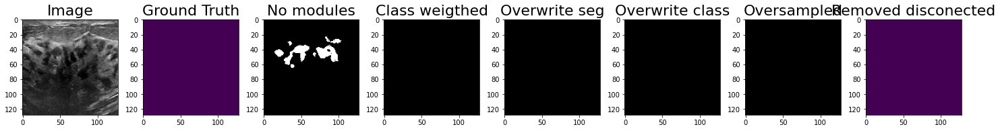

Patient:  80 			DICE:  1


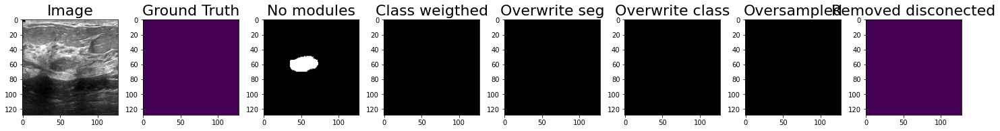

Patient:  82 			DICE:  1


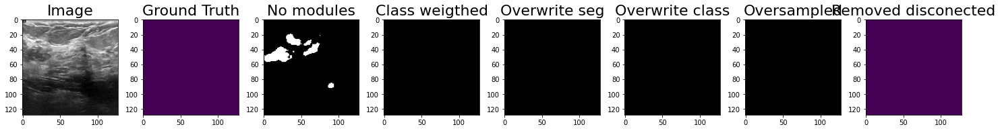

Patient:  83 			DICE:  1


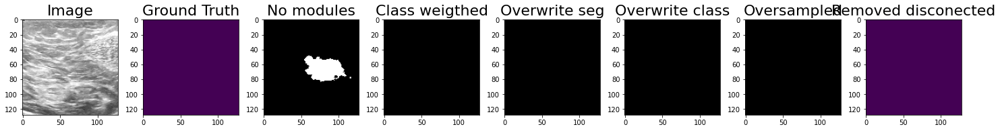

Patient:  84 			DICE:  1


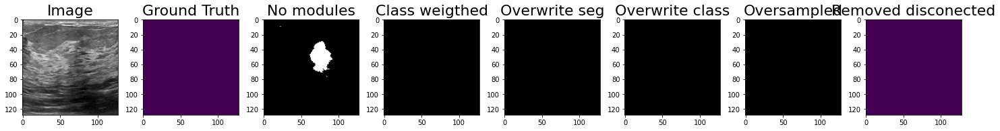

Patient:  85 			DICE:  1


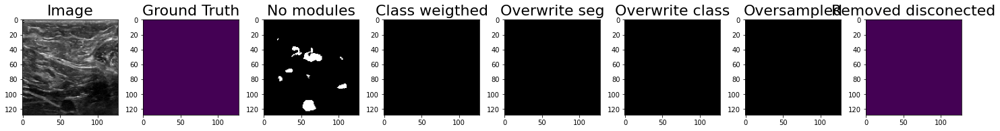

Patient:  86 			DICE:  1


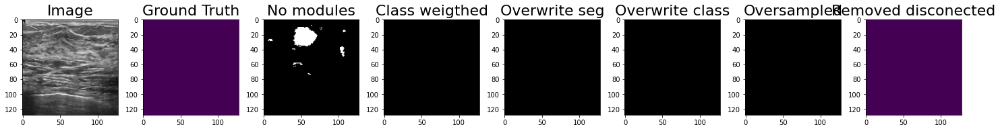

Patient:  87 			DICE:  1


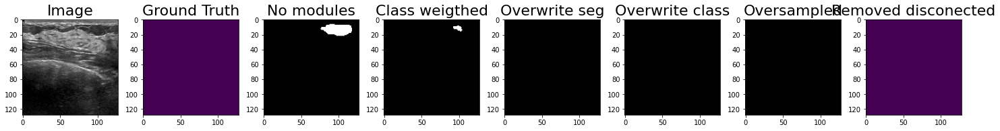

Patient:  88 			DICE:  1


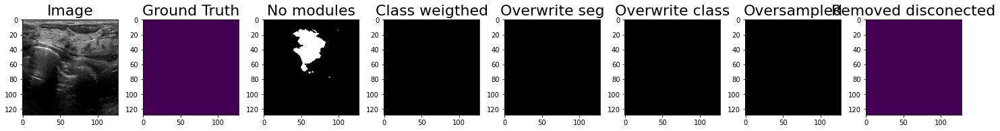

Patient:  89 			DICE:  1


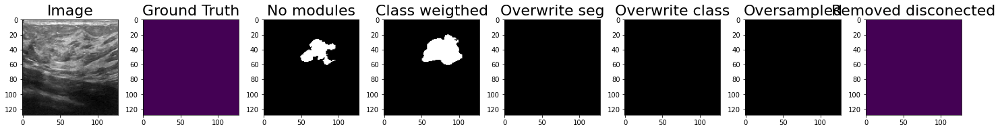

Patient:  90 			DICE:  1


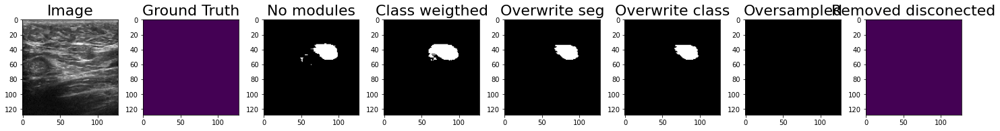

Patient:  91 			DICE:  1


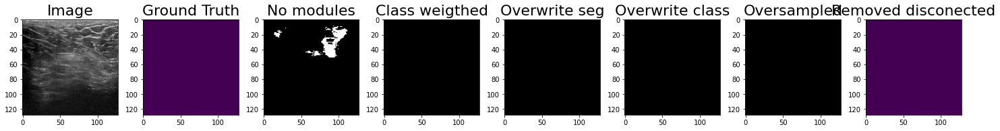

Patient:  92 			DICE:  1


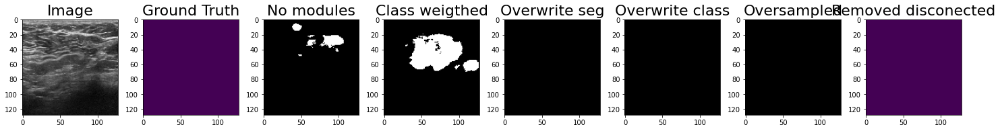

Patient:  93 			DICE:  1


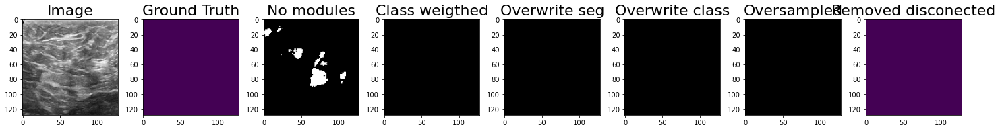

Patient:  94 			DICE:  1


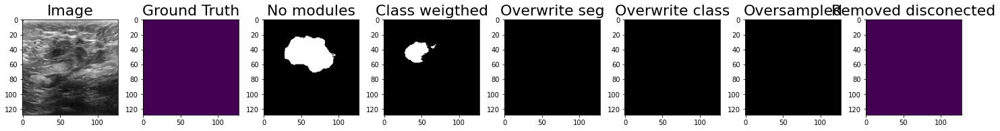

Patient:  95 			DICE:  1


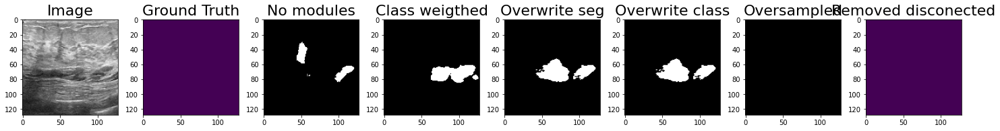

Patient:  96 			DICE:  1


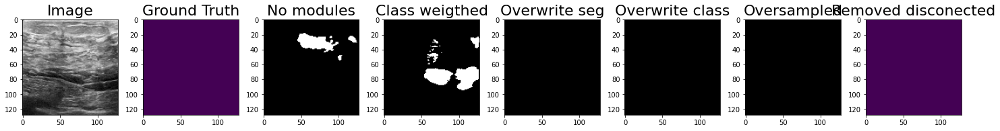

Patient:  99 			DICE:  1


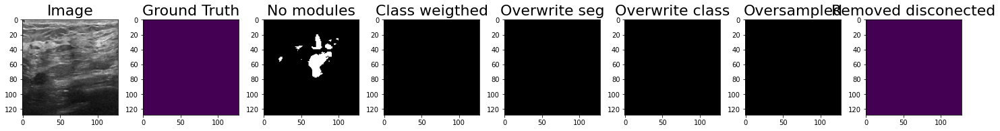

Patient:  100 			DICE:  1


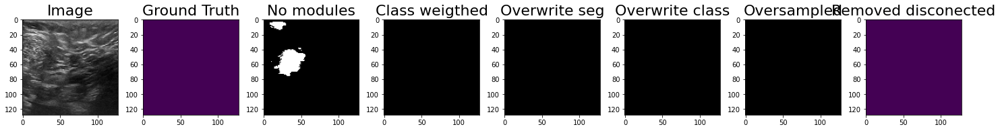

Patient:  101 			DICE:  1


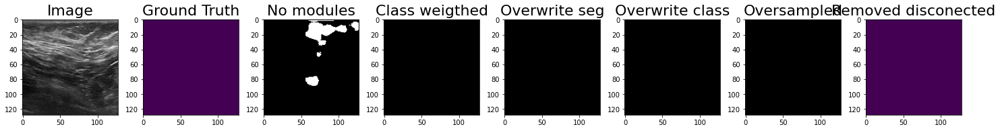

Patient:  102 			DICE:  1


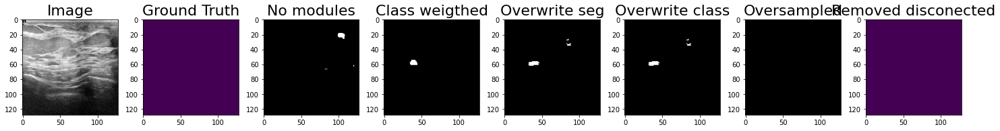

Patient:  103 			DICE:  1


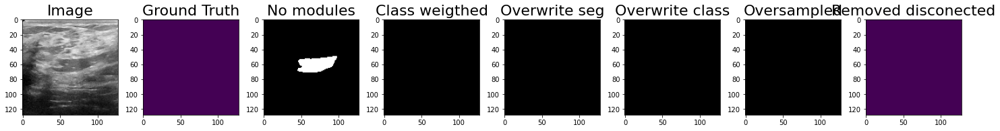

Patient:  105 			DICE:  1


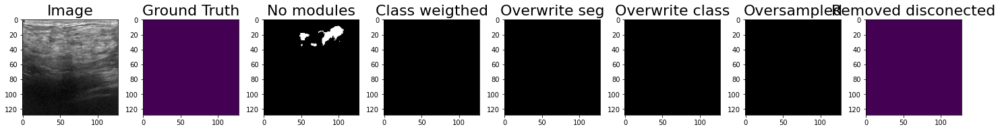

Patient:  106 			DICE:  1


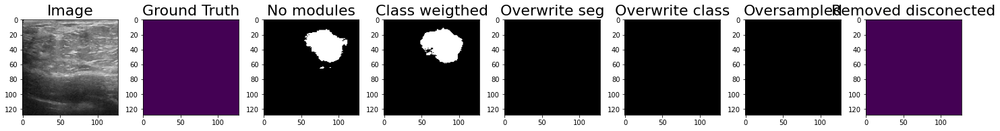

Patient:  108 			DICE:  1


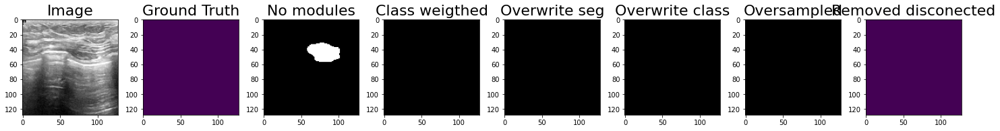

Patient:  109 			DICE:  1


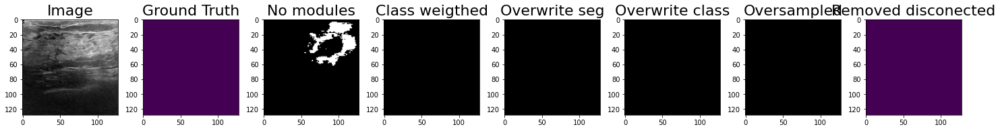

Patient:  110 			DICE:  1


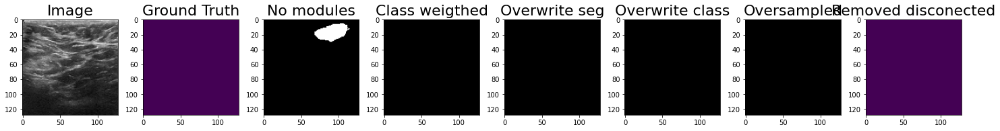

Patient:  111 			DICE:  1


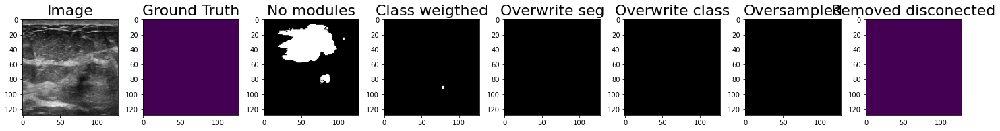

Patient:  112 			DICE:  0


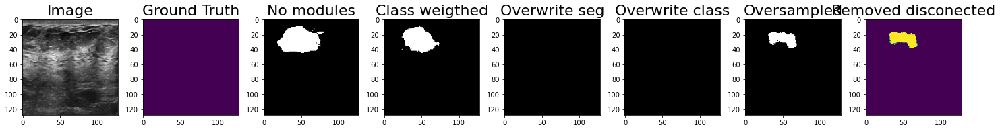

Patient:  113 			DICE:  0


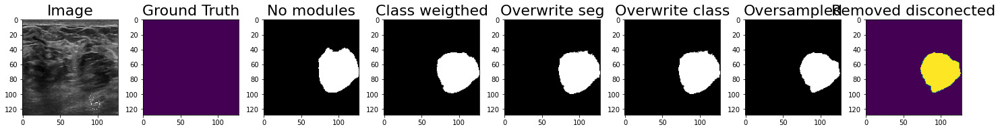

Patient:  114 			DICE:  1


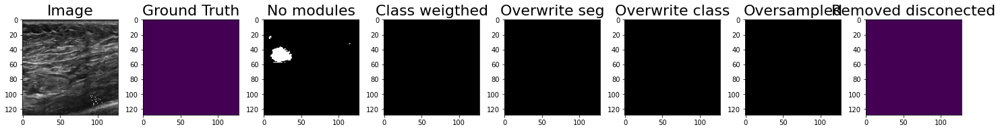

Patient:  115 			DICE:  1


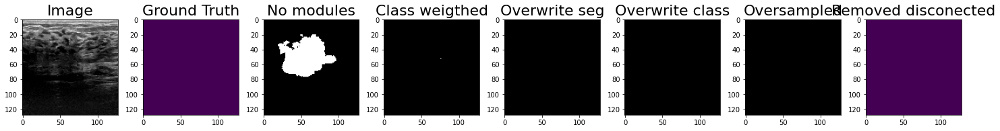

Patient:  116 			DICE:  1


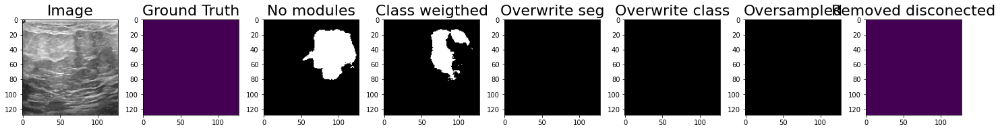

Patient:  117 			DICE:  1


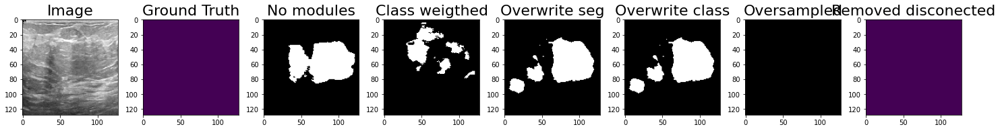

Patient:  118 			DICE:  1


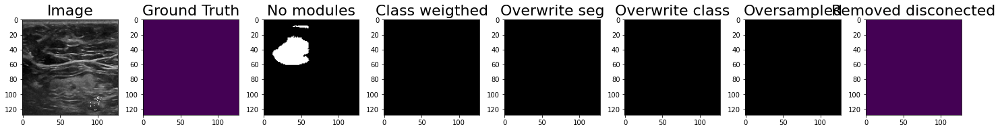

Patient:  133 			DICE:  1


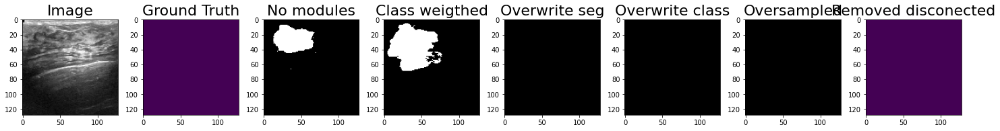

0.9375


In [121]:
from skimage import io, morphology

patient_type = 'normal'
result = []
for i in range(500):
    try:
        number = f'{i}'
        fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
        image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)

        gt = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
        imgs = [image] + [gt] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]
        filtered_image = fill_irregular_hole(imgs[-1][:, :, 0])

        imgs = imgs + [filtered_image]
        tp = float(np.sum(l_and(imgs[-1], gt)))
        tn = float(np.sum(l_and(l_not(imgs[-1]), l_not(gt))))
        fp = float(np.sum(l_and(imgs[-1], l_not(gt))))
        fn = float(np.sum(l_and(l_not(imgs[-1]), gt)))
        dice =  dice_score(tp, fp, fn, gt, imgs[-1])

        print("Patient: ", i, "\t\t\tDICE: ", round(dice, 3))
 
        plot_postprocessing(imgs)
        
        result.append(dice)
    except Exception as e:
        pass
print(np.mean(result))

## Benign

Patient:  20 			DICE:  0.932


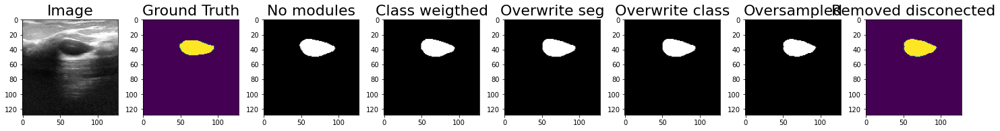

Patient:  22 			DICE:  0.908


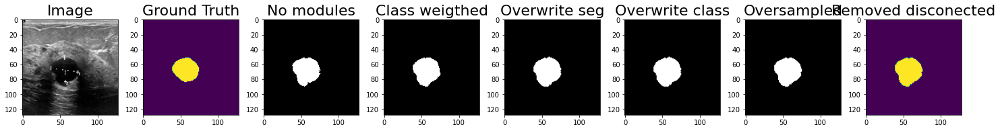

Patient:  23 			DICE:  0.926


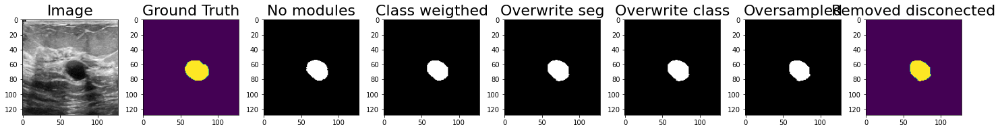

Patient:  24 			DICE:  0.925


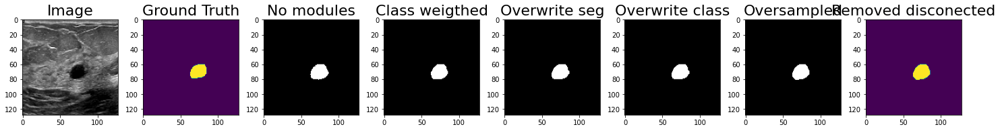

Patient:  26 			DICE:  0.97


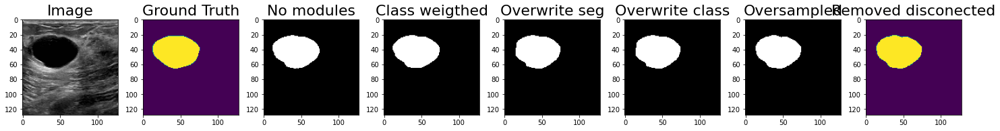

Patient:  27 			DICE:  0.938


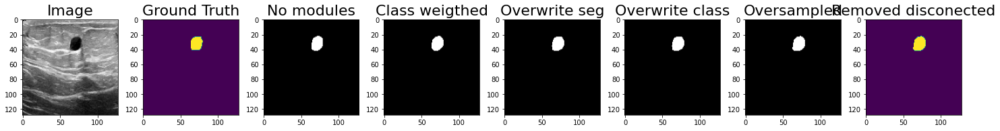

Patient:  28 			DICE:  0.947


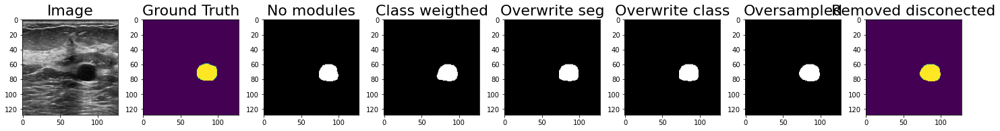

Patient:  29 			DICE:  0.718


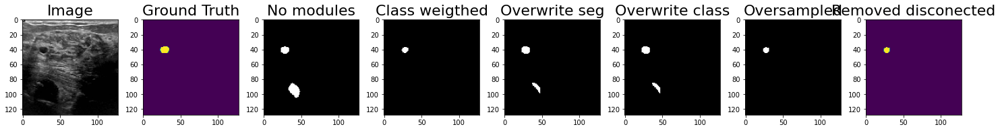

Patient:  31 			DICE:  0.921


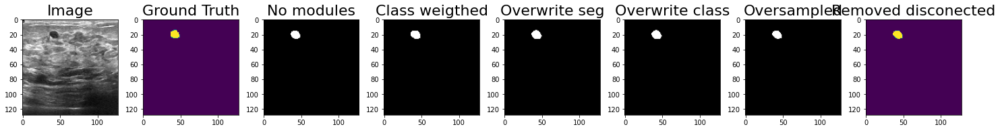

Patient:  32 			DICE:  0.0


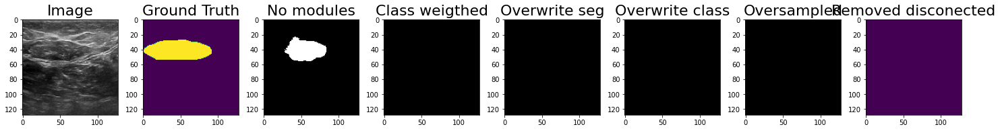

Patient:  34 			DICE:  0.97


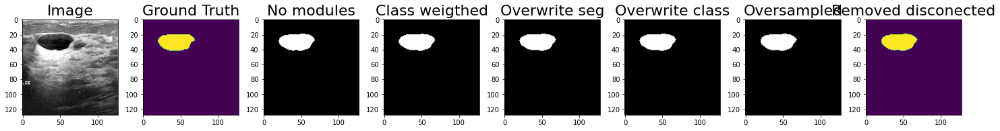

Patient:  36 			DICE:  0.94


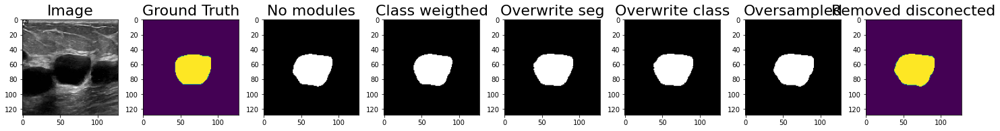

Patient:  39 			DICE:  0.846


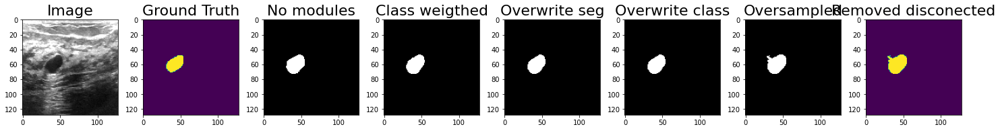

Patient:  40 			DICE:  0.938


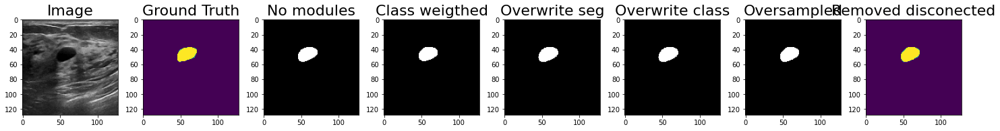

Patient:  41 			DICE:  0.778


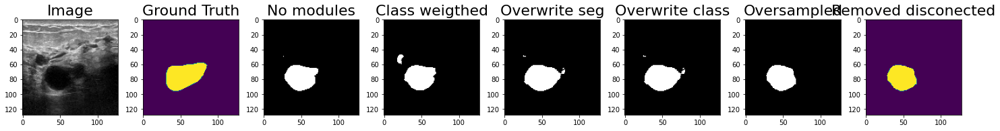

Patient:  43 			DICE:  0.906


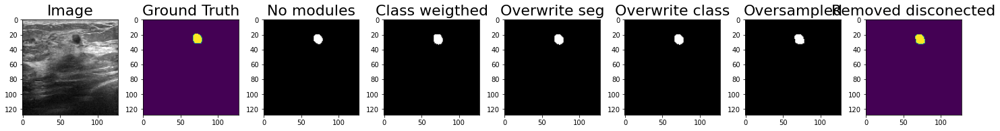

Patient:  45 			DICE:  0.899


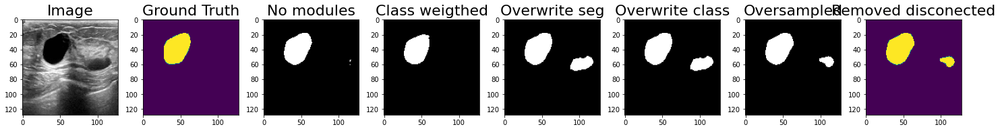

Patient:  46 			DICE:  0.947


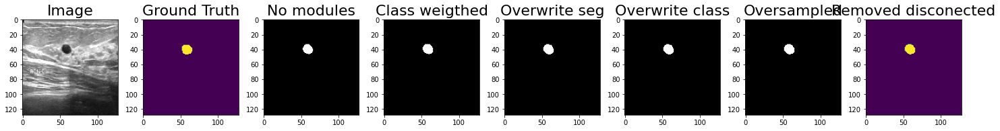

Patient:  47 			DICE:  0.919


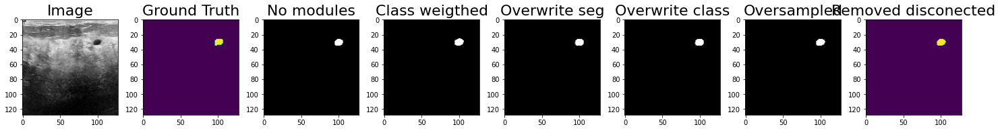

Patient:  48 			DICE:  0.948


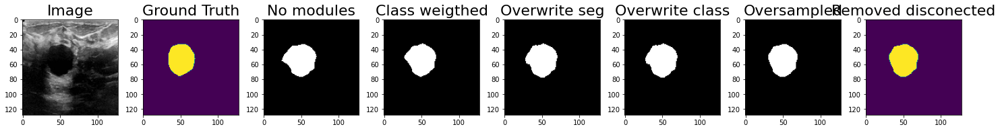

Patient:  49 			DICE:  0.956


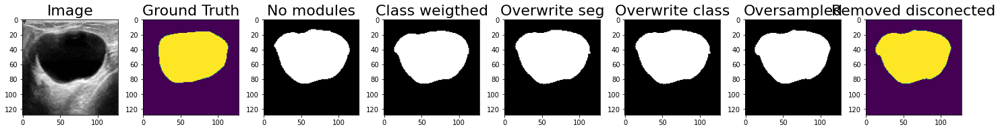

Patient:  53 			DICE:  0.939


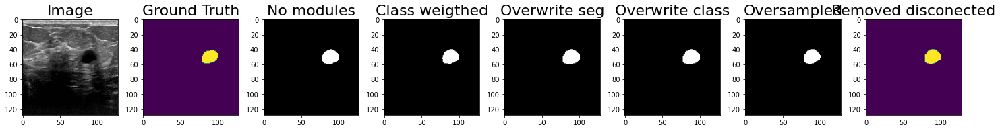

Patient:  54 			DICE:  0.913


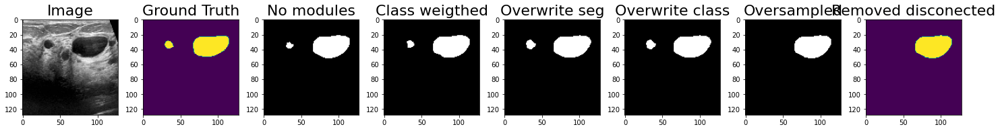

Patient:  55 			DICE:  0.941


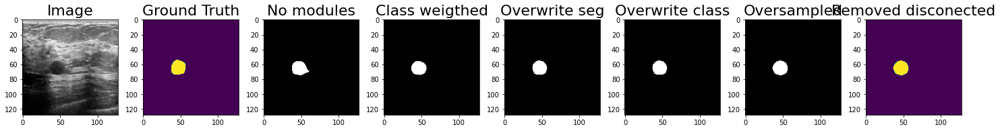

Patient:  56 			DICE:  0.91


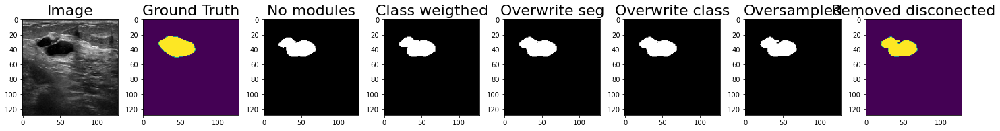

Patient:  57 			DICE:  0.938


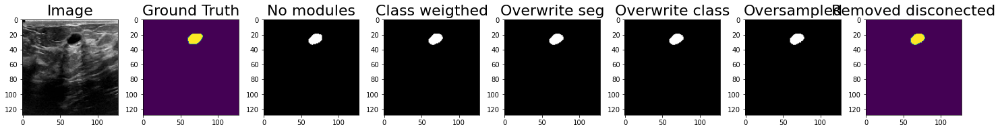

Patient:  59 			DICE:  0.915


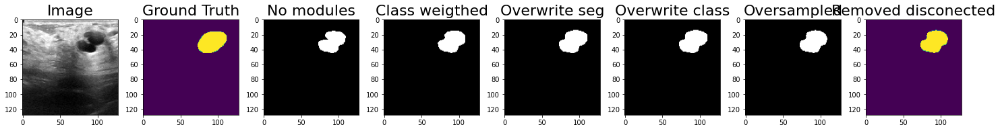

Patient:  61 			DICE:  0.0


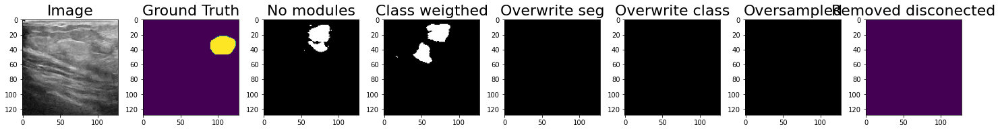

Patient:  63 			DICE:  0.91


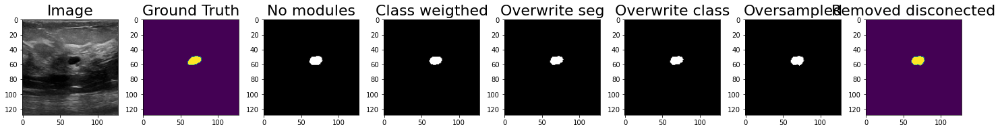

Patient:  66 			DICE:  0.944


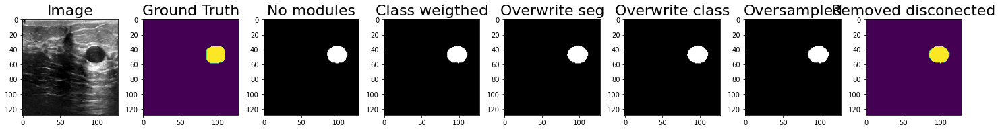

Patient:  67 			DICE:  0.887


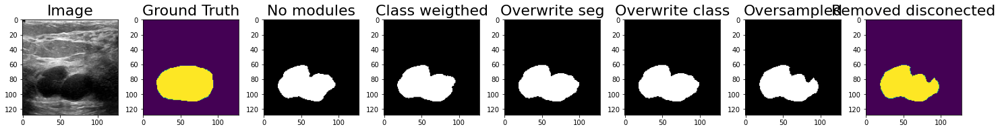

Patient:  68 			DICE:  0.951


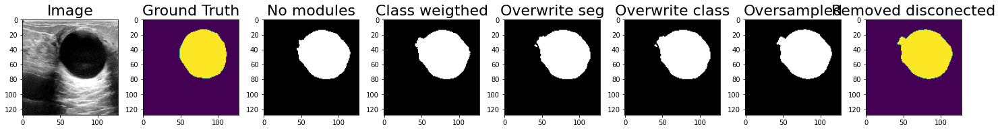

Patient:  69 			DICE:  0.891


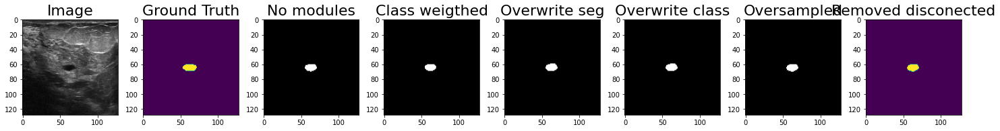

Patient:  70 			DICE:  0.896


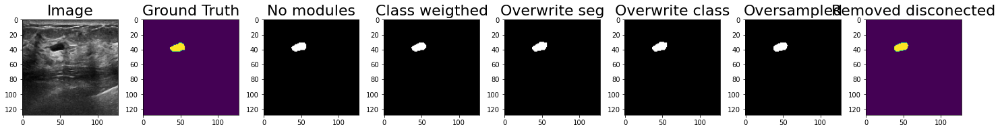

Patient:  71 			DICE:  0.787


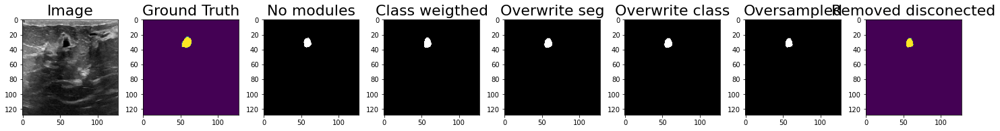

Patient:  72 			DICE:  0.942


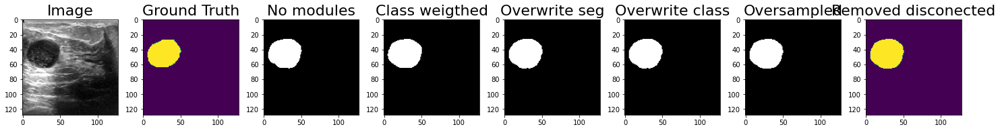

Patient:  73 			DICE:  0.926


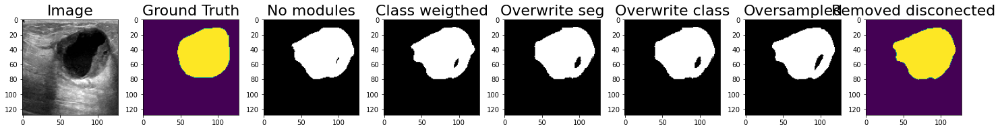

Patient:  74 			DICE:  0.942


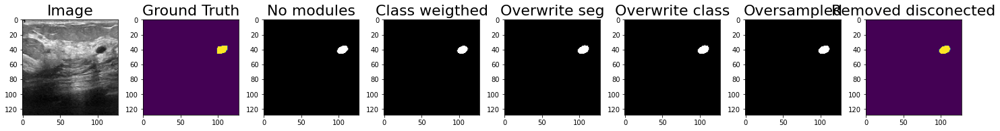

Patient:  75 			DICE:  0.955


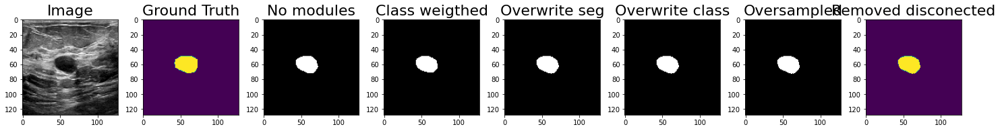

Patient:  76 			DICE:  0.93


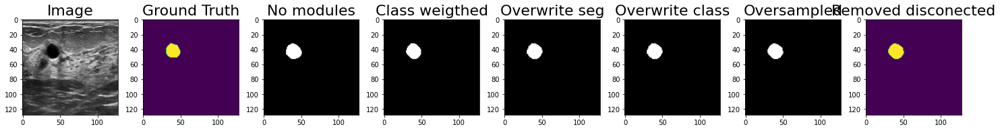

Patient:  77 			DICE:  0.838


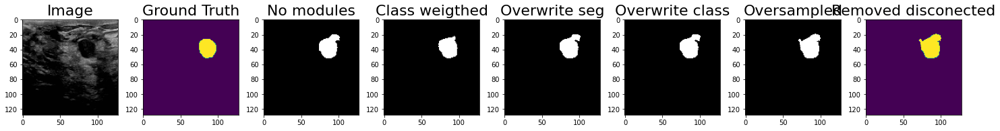

Patient:  78 			DICE:  0.916


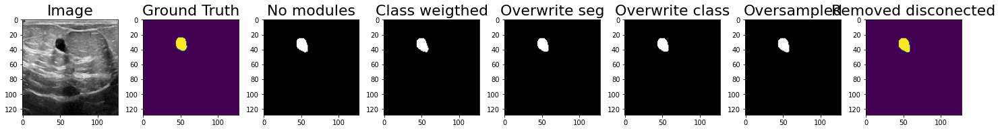

Patient:  79 			DICE:  0.923


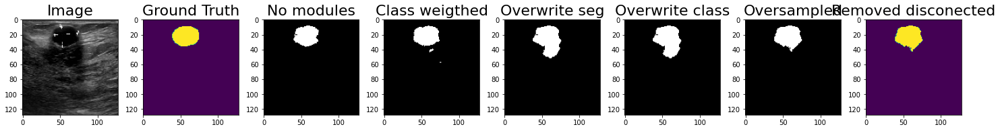

Patient:  80 			DICE:  0.943


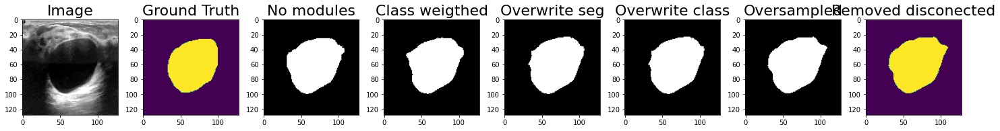

Patient:  82 			DICE:  0.963


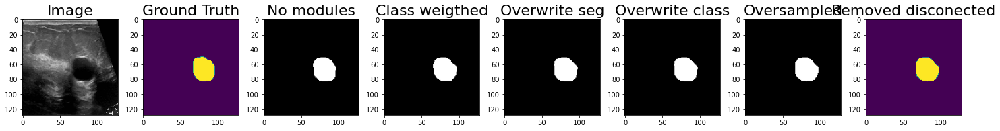

Patient:  83 			DICE:  0.864


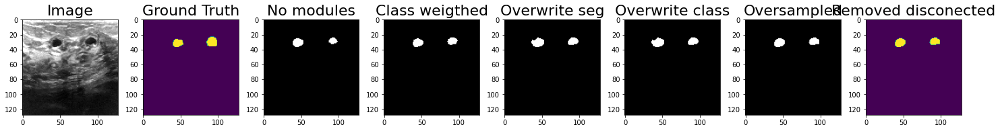

Patient:  84 			DICE:  0.631


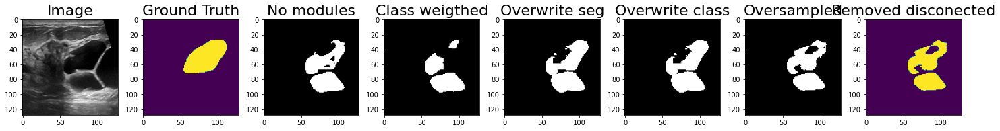

Patient:  87 			DICE:  0.825


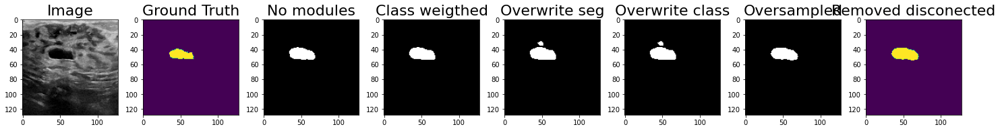

Patient:  88 			DICE:  0.669


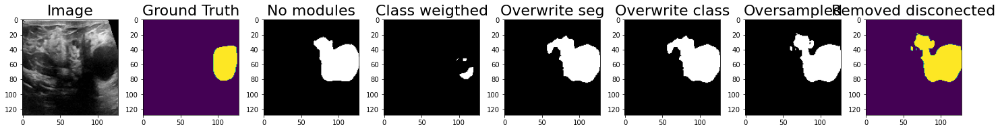

Patient:  89 			DICE:  0.943


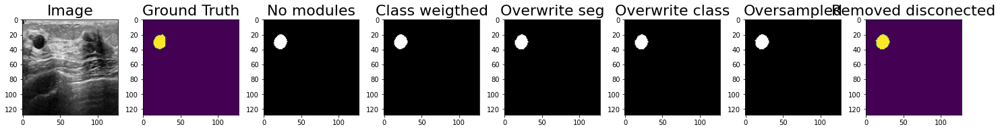

Patient:  90 			DICE:  0.898


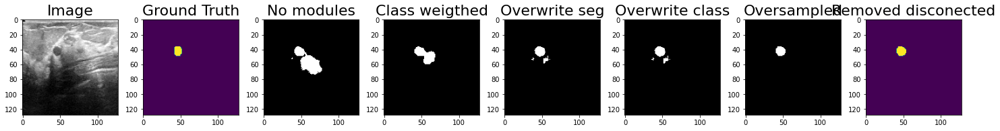

Patient:  91 			DICE:  0.798


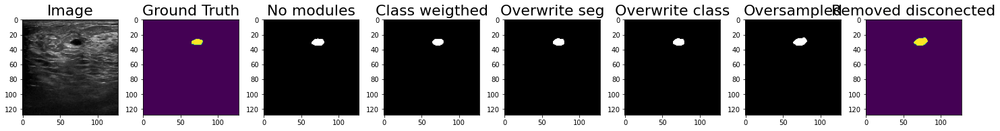

Patient:  92 			DICE:  0.93


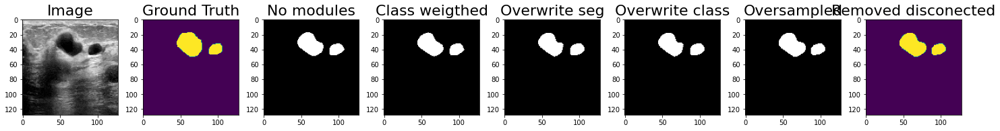

Patient:  93 			DICE:  0.602


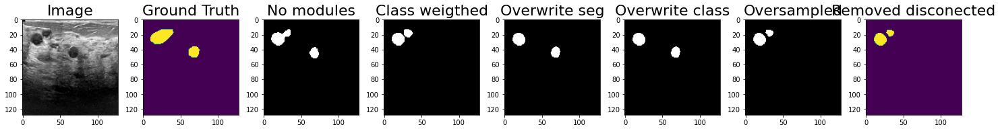

Patient:  94 			DICE:  0.628


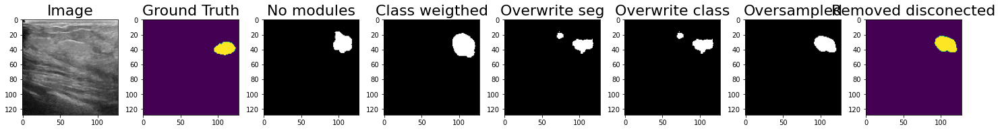

Patient:  95 			DICE:  0.931


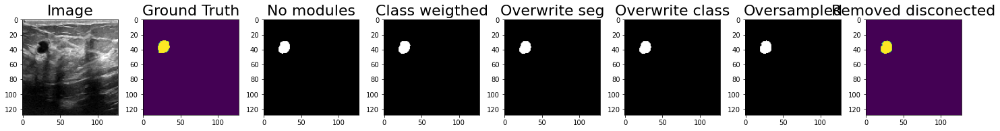

Patient:  97 			DICE:  0.0


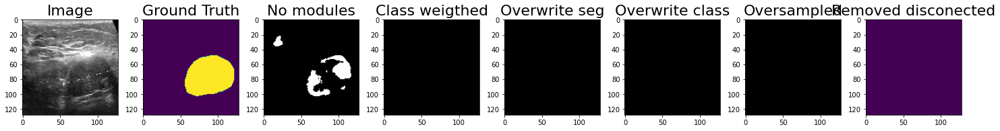

Patient:  98 			DICE:  0.922


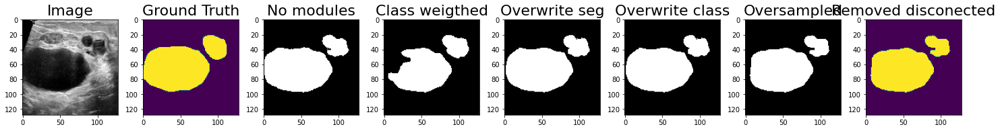

Patient:  100 			DICE:  0.897


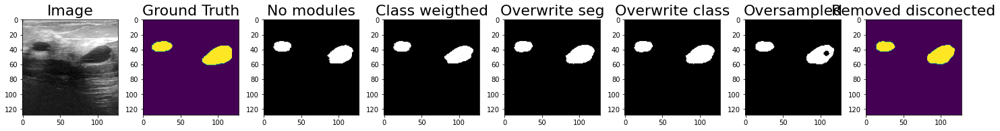

Patient:  101 			DICE:  0.949


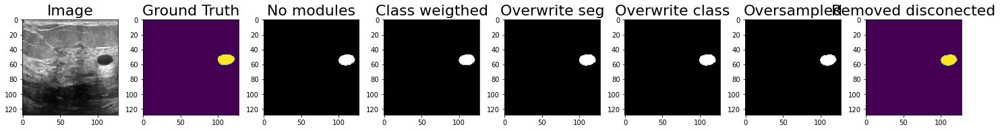

Patient:  102 			DICE:  0.968


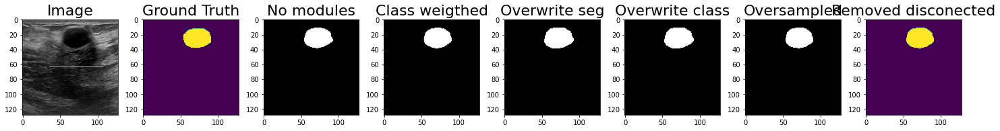

Patient:  103 			DICE:  0.949


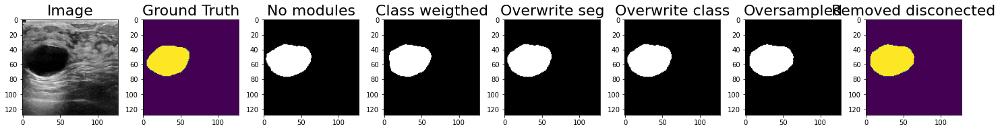

Patient:  104 			DICE:  0.931


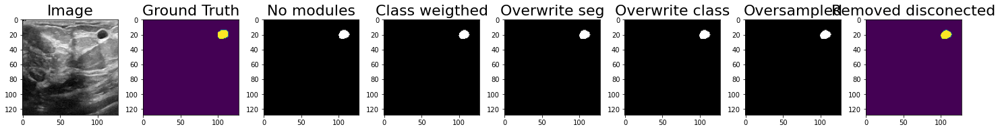

Patient:  106 			DICE:  0.952


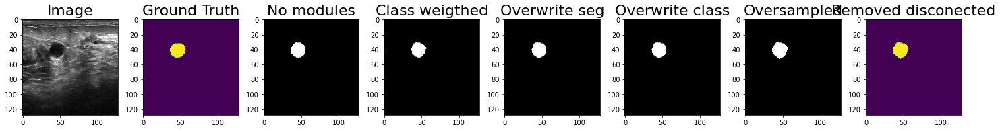

Patient:  107 			DICE:  0.931


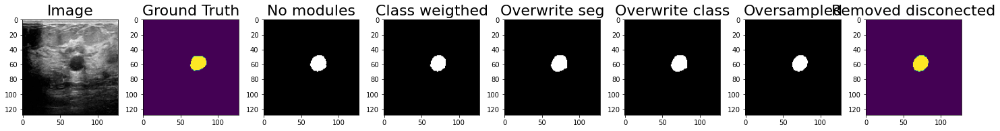

Patient:  108 			DICE:  0.0


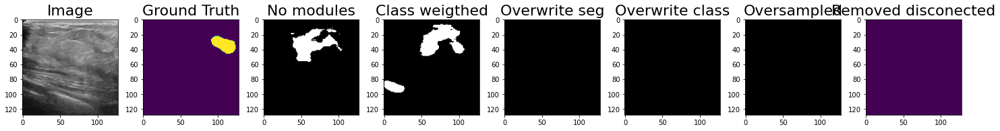

Patient:  109 			DICE:  0.865


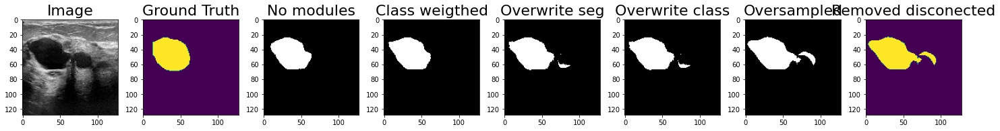

Patient:  111 			DICE:  0.859


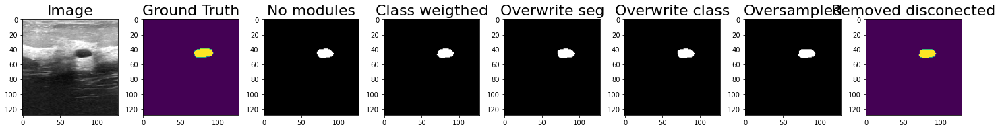

Patient:  112 			DICE:  0.842


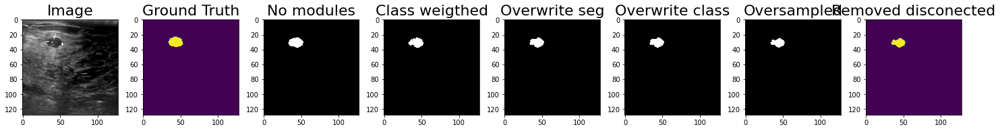

Patient:  113 			DICE:  0.97


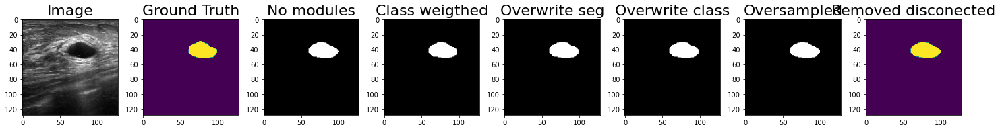

Patient:  114 			DICE:  0.0


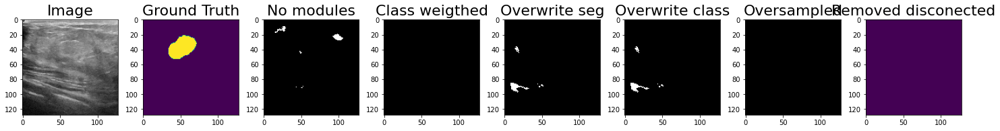

Patient:  115 			DICE:  0.908


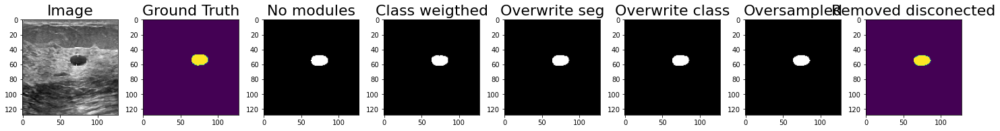

Patient:  116 			DICE:  0.0


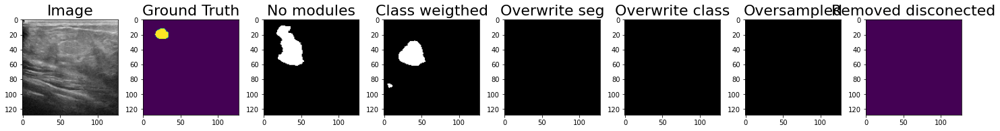

Patient:  117 			DICE:  0.938


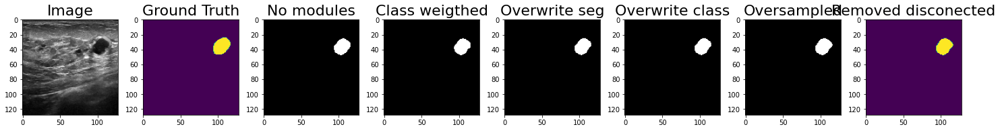

Patient:  118 			DICE:  0.827


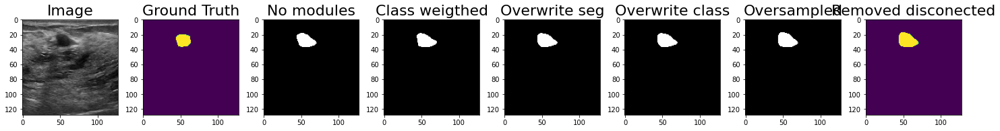

Patient:  119 			DICE:  0.0


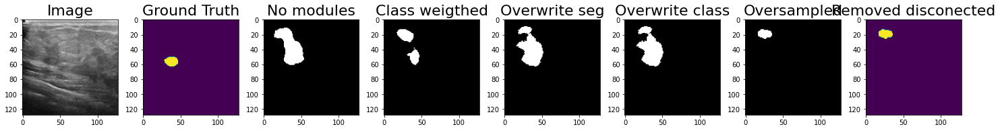

Patient:  120 			DICE:  0.327


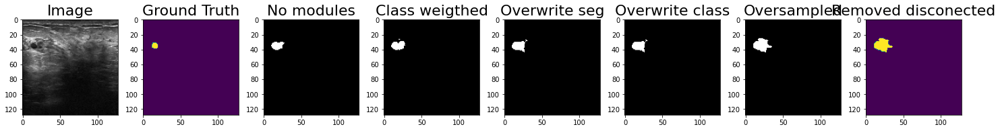

Patient:  121 			DICE:  0.943


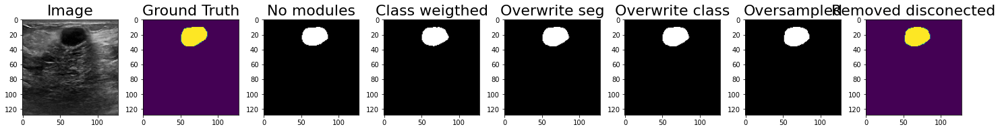

Patient:  122 			DICE:  0.758


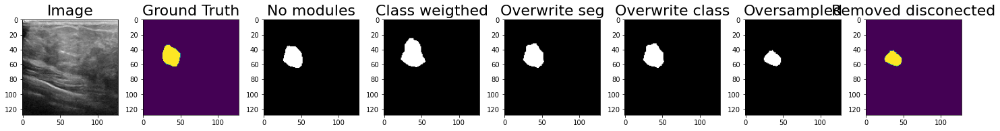

Patient:  123 			DICE:  0.932


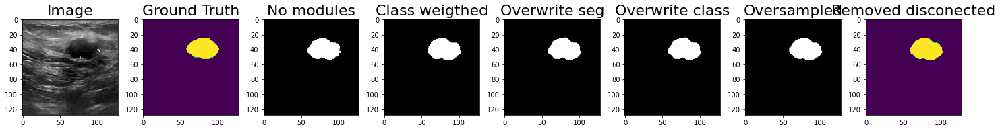

Patient:  124 			DICE:  0.766


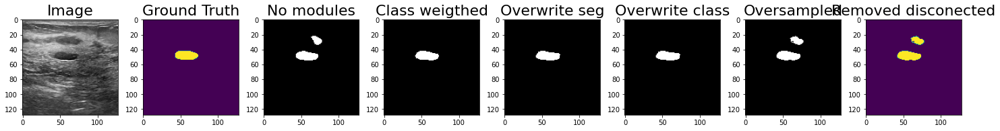

Patient:  125 			DICE:  0.948


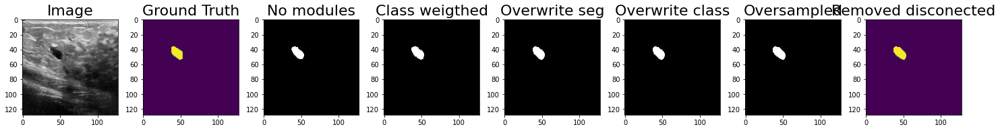

Patient:  126 			DICE:  0.906


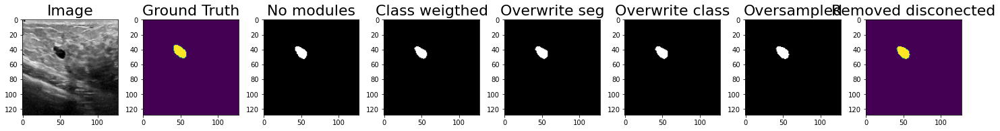

Patient:  137 			DICE:  0.685


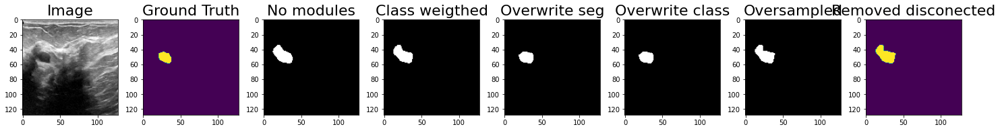

Patient:  142 			DICE:  0.918


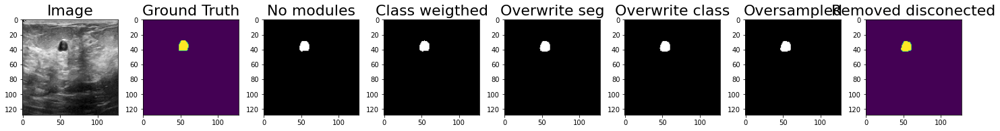

Patient:  143 			DICE:  0.908


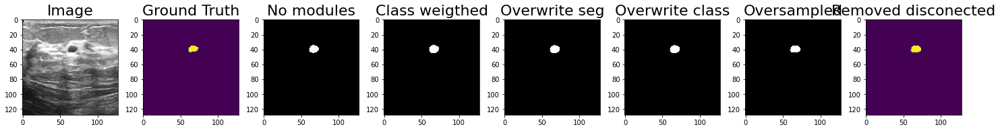

Patient:  144 			DICE:  0.913


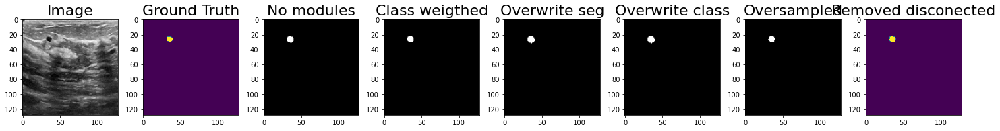

Patient:  145 			DICE:  0.895


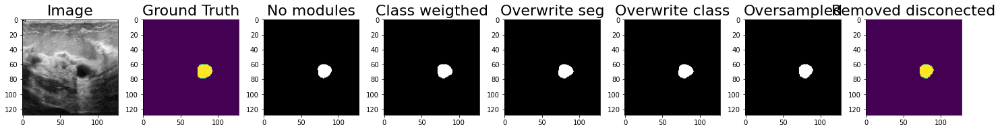

Patient:  146 			DICE:  0.935


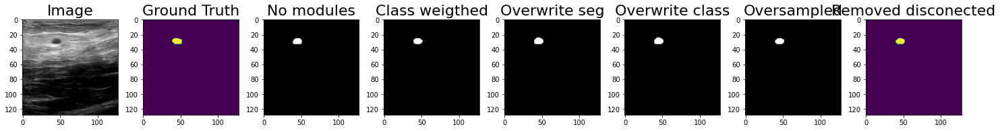

Patient:  147 			DICE:  0.813


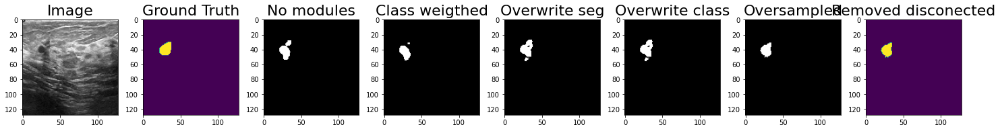

Patient:  148 			DICE:  0.957


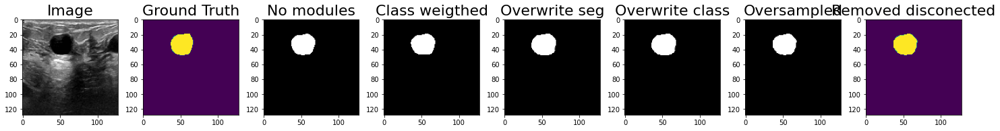

Patient:  149 			DICE:  0.932


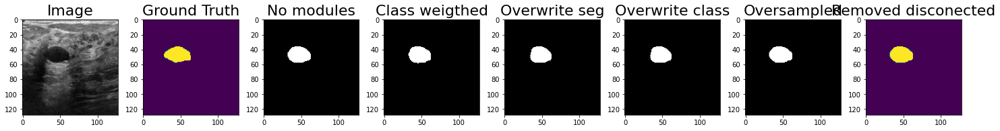

Patient:  159 			DICE:  0.564


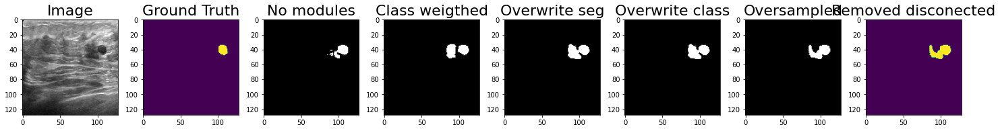

Patient:  160 			DICE:  0.921


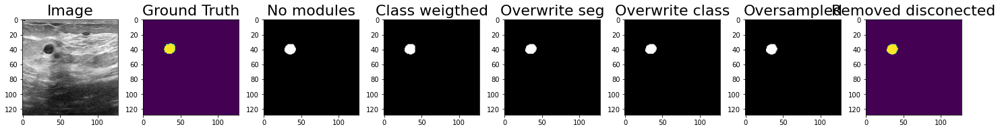

Patient:  161 			DICE:  0.925


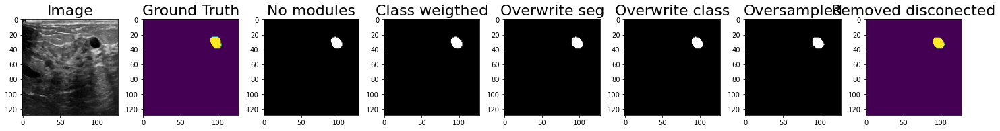

Patient:  162 			DICE:  0.879


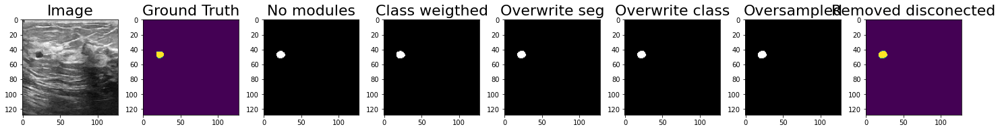

Patient:  165 			DICE:  0.812


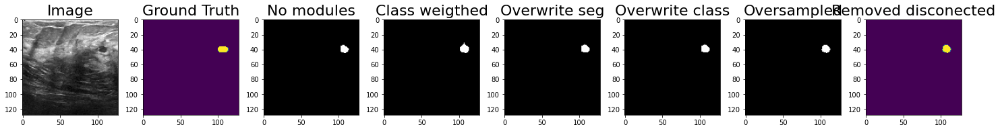

Patient:  166 			DICE:  0.907


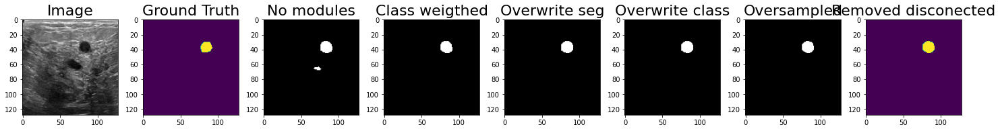

Patient:  167 			DICE:  0.919


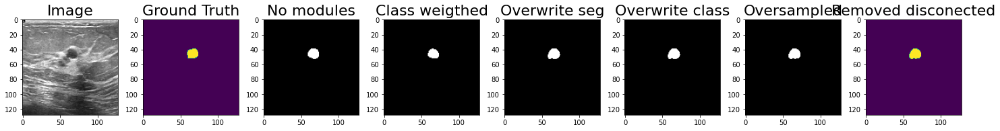

Patient:  168 			DICE:  0.959


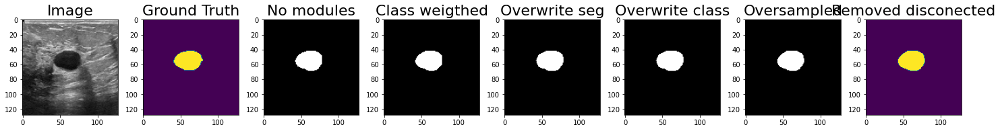

Patient:  169 			DICE:  0.0


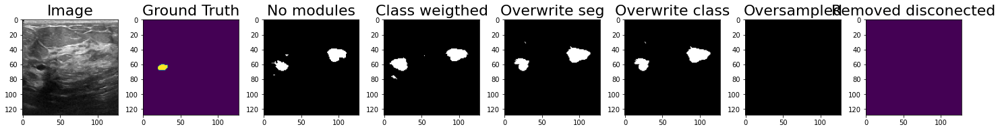

Patient:  170 			DICE:  0.779


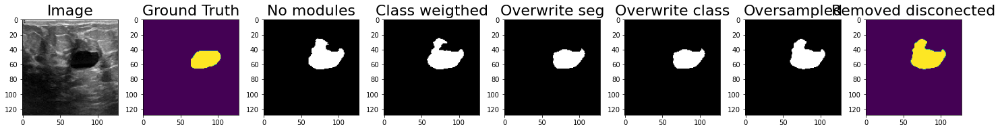

Patient:  171 			DICE:  0.822


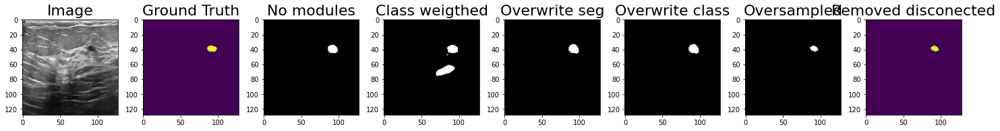

Patient:  172 			DICE:  0.843


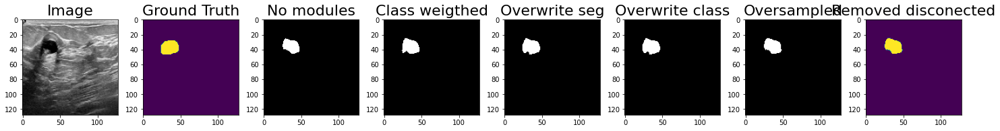

Patient:  173 			DICE:  0.854


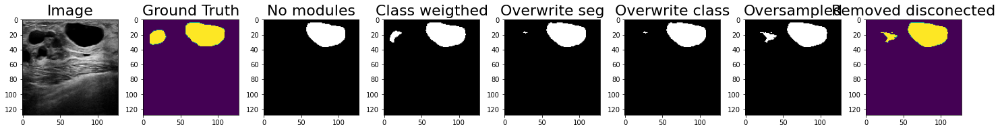

Patient:  174 			DICE:  0.977


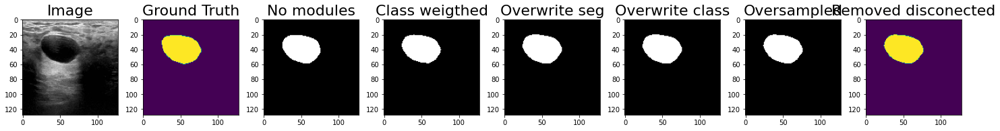

Patient:  175 			DICE:  0.928


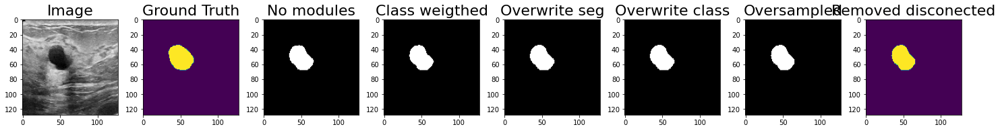

Patient:  176 			DICE:  0.845


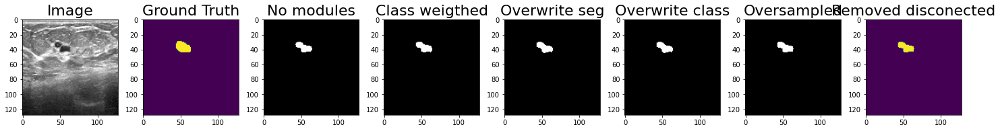

Patient:  178 			DICE:  0.86


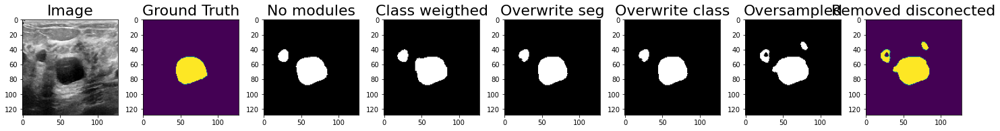

Patient:  179 			DICE:  0.786


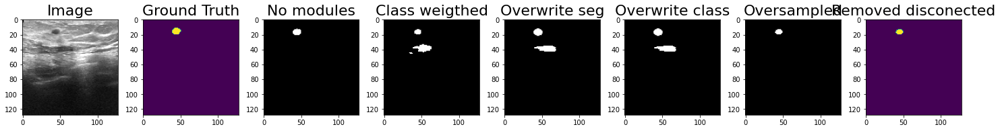

Patient:  180 			DICE:  0.96


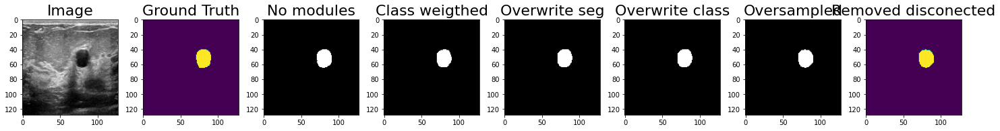

Patient:  181 			DICE:  0.857


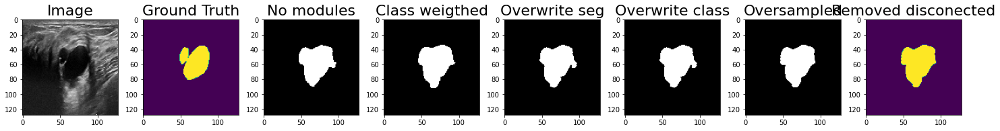

Patient:  182 			DICE:  0.873


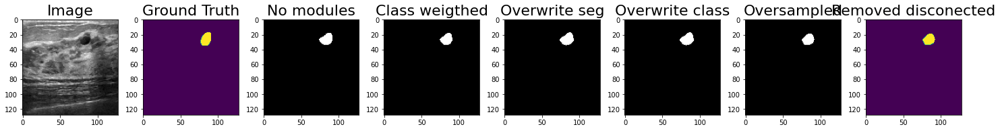

Patient:  183 			DICE:  0.392


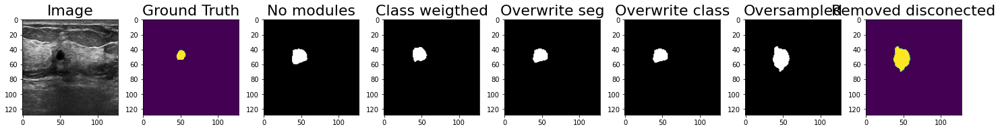

Patient:  184 			DICE:  0.965


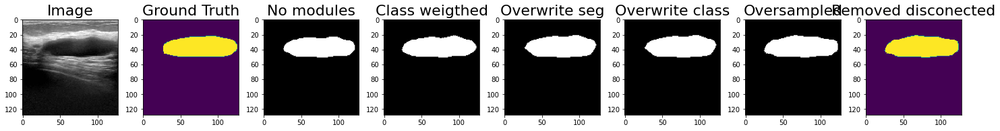

Patient:  185 			DICE:  0.945


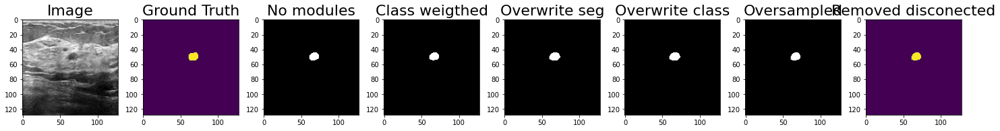

Patient:  186 			DICE:  0.958


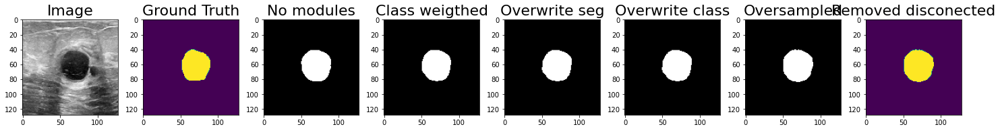

Patient:  187 			DICE:  0.803


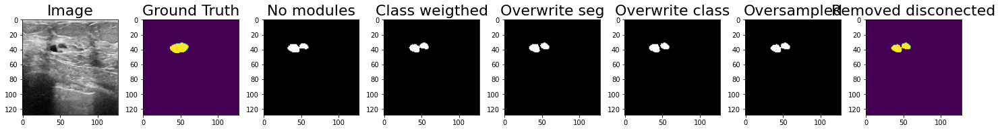

Patient:  188 			DICE:  0.27


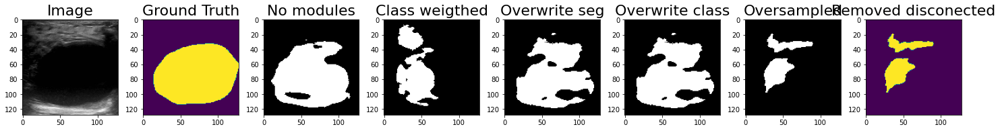

Patient:  189 			DICE:  0.925


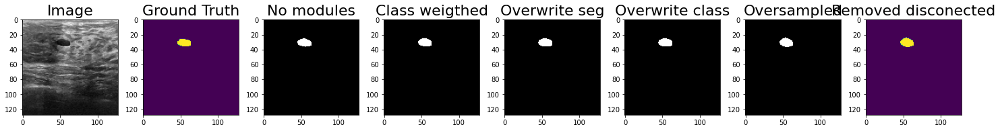

Patient:  190 			DICE:  0.931


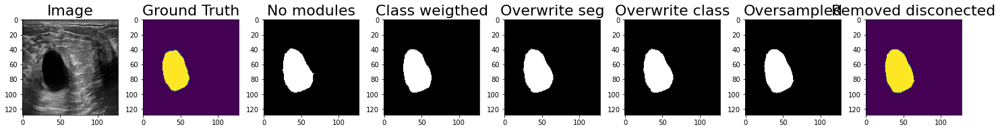

Patient:  191 			DICE:  0.895


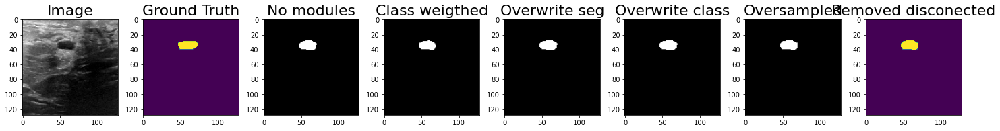

Patient:  192 			DICE:  0.962


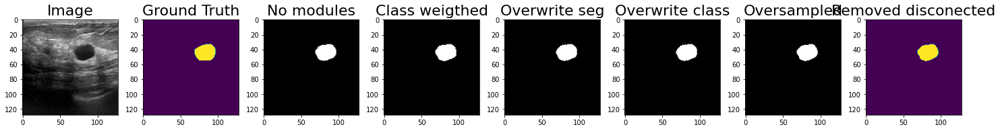

Patient:  193 			DICE:  0.912


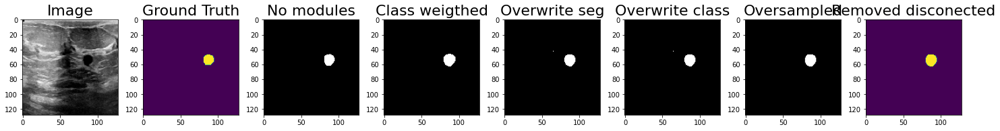

Patient:  194 			DICE:  0.731


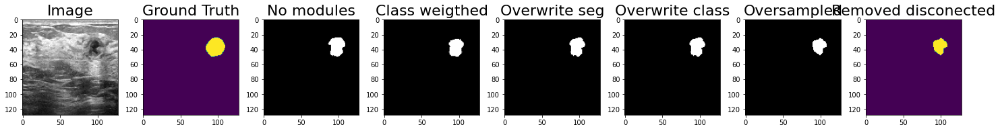

Patient:  195 			DICE:  0.673


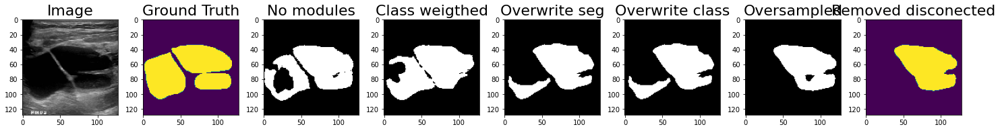

Patient:  196 			DICE:  0.0


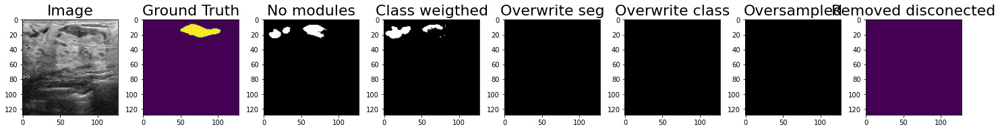

Patient:  198 			DICE:  0.944


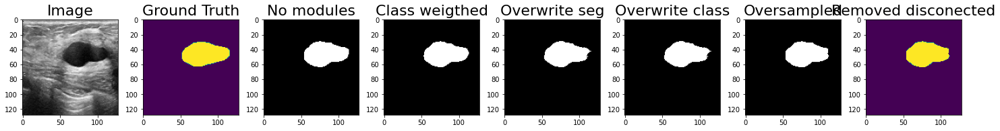

Patient:  212 			DICE:  0.0


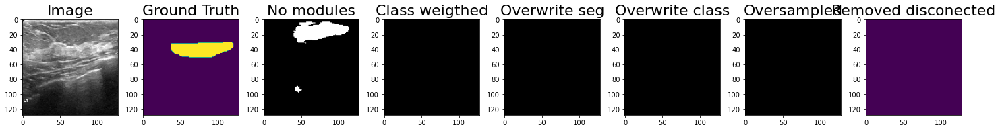

Patient:  243 			DICE:  0.0


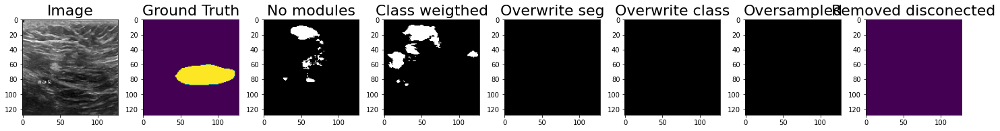

Patient:  283 			DICE:  0.898


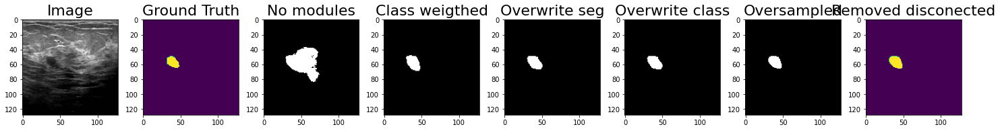

Patient:  286 			DICE:  0.348


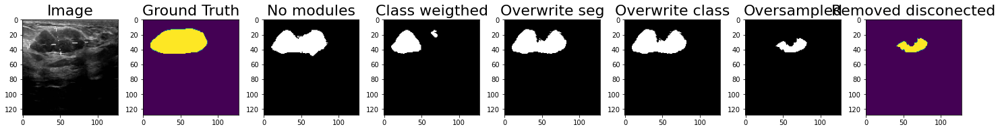

Patient:  311 			DICE:  0.0


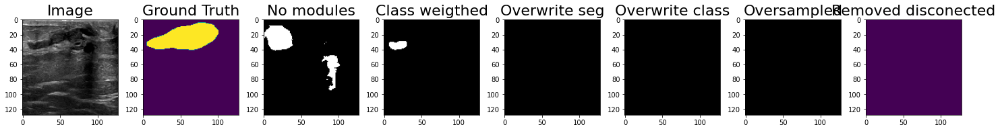

Patient:  313 			DICE:  0.0


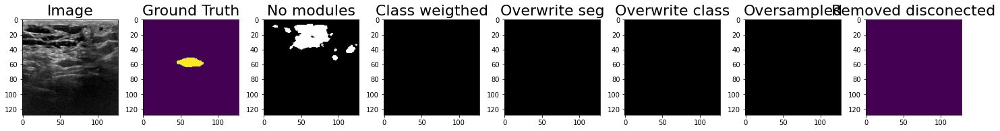

Patient:  314 			DICE:  0.383


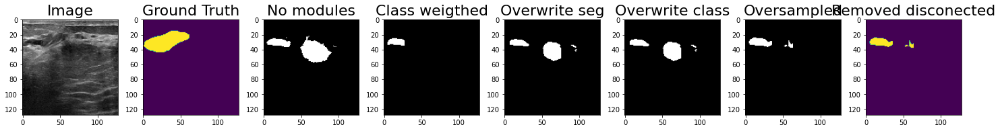

Patient:  315 			DICE:  0.581


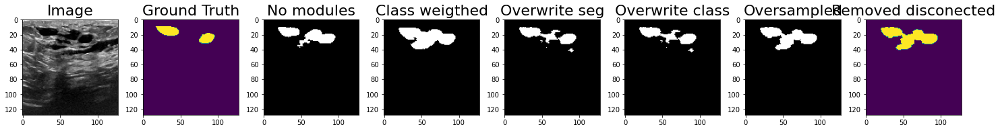

Patient:  317 			DICE:  0.506


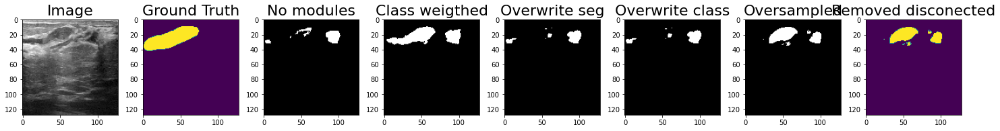

Patient:  334 			DICE:  0.909


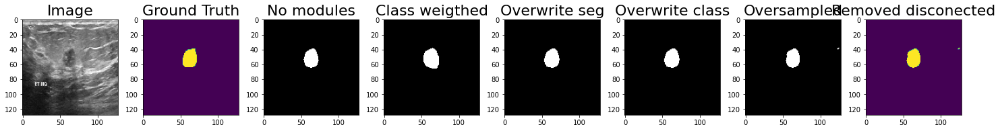

Patient:  335 			DICE:  0.0


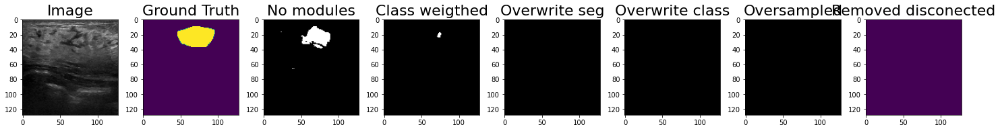

Patient:  336 			DICE:  0.0


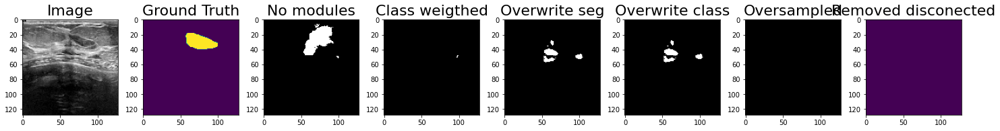

Patient:  337 			DICE:  0.854


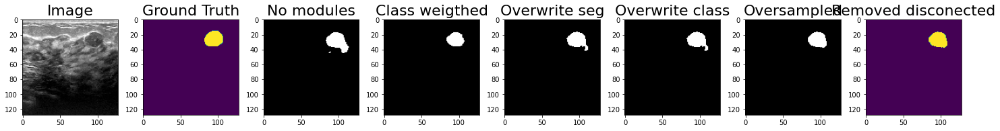

Patient:  338 			DICE:  0.931


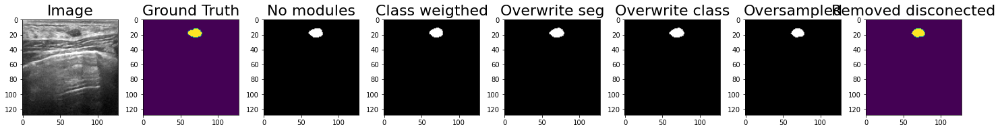

Patient:  339 			DICE:  0.963


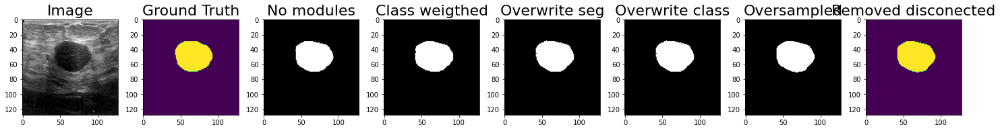

Patient:  340 			DICE:  0.883


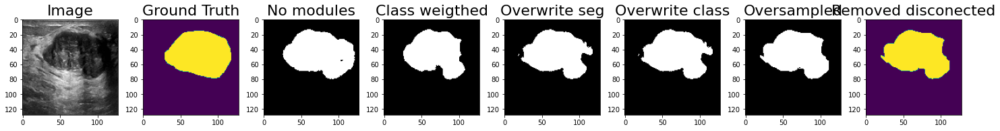

Patient:  341 			DICE:  0.928


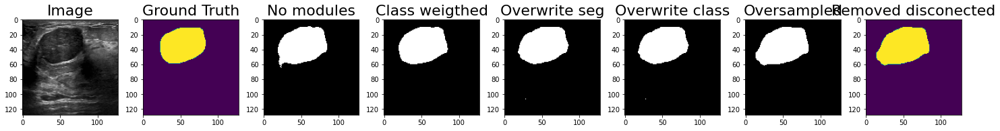

Patient:  342 			DICE:  0.0


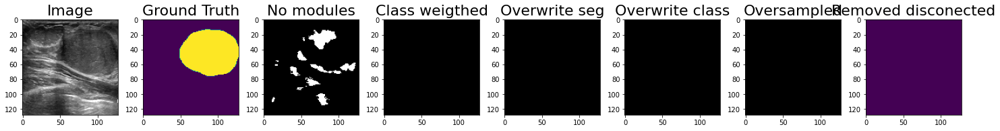

Patient:  343 			DICE:  0.891


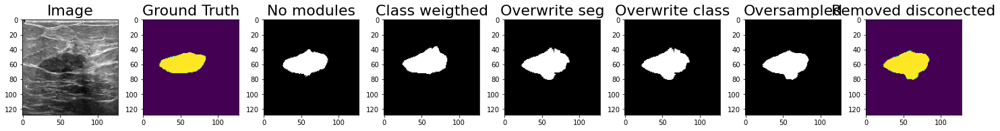

Patient:  344 			DICE:  0.0


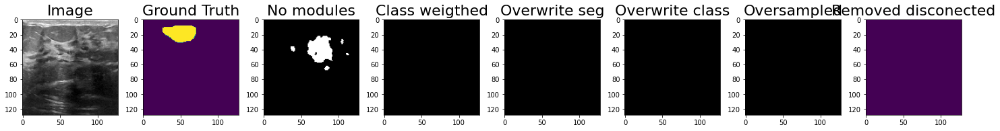

Patient:  345 			DICE:  0.571


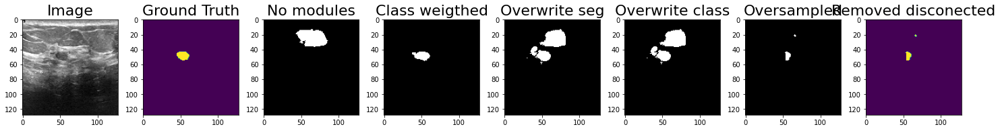

Patient:  346 			DICE:  0.268


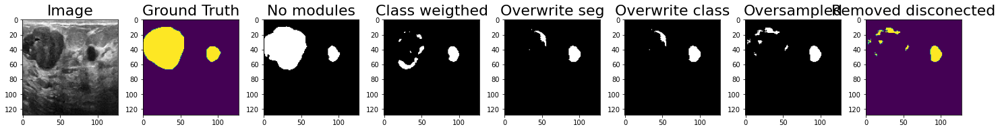

Patient:  347 			DICE:  0.83


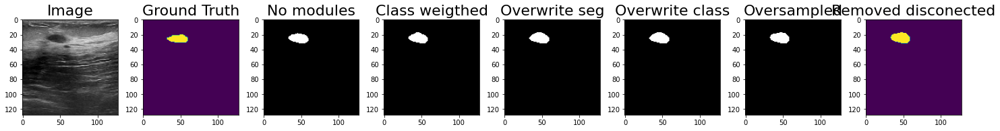

Patient:  348 			DICE:  0.953


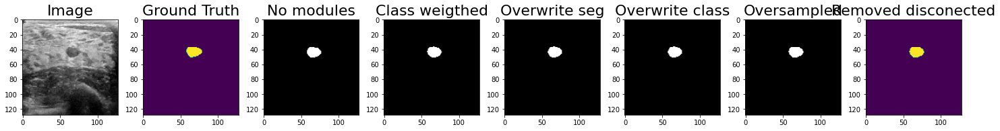

Patient:  349 			DICE:  0.89


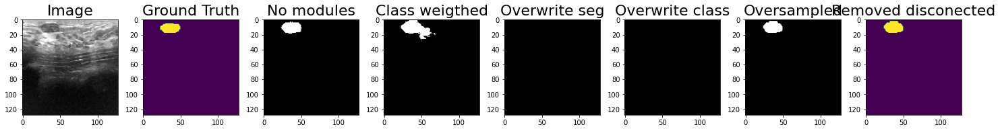

Patient:  350 			DICE:  0.938


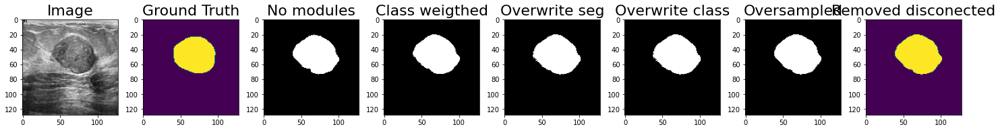

Patient:  351 			DICE:  0.0


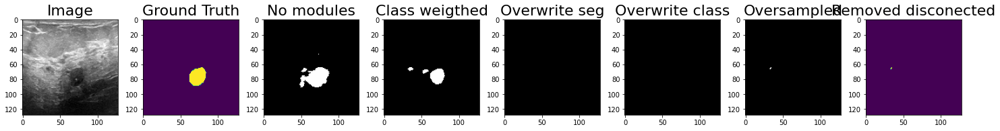

Patient:  352 			DICE:  0.954


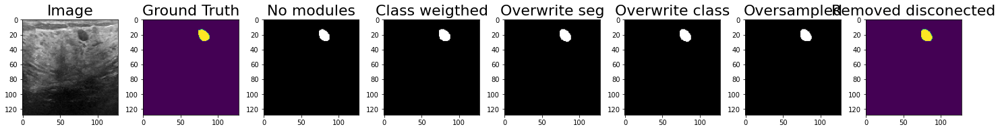

Patient:  353 			DICE:  0.872


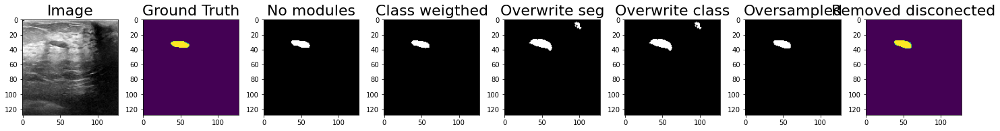

Patient:  354 			DICE:  0.934


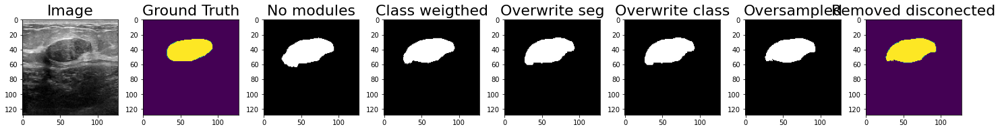

Patient:  355 			DICE:  0.939


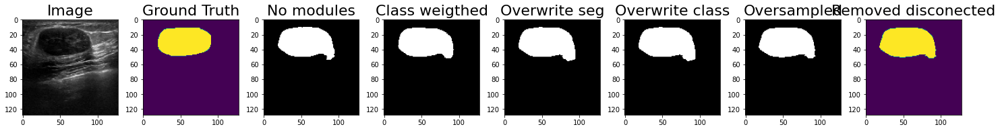

Patient:  356 			DICE:  0.911


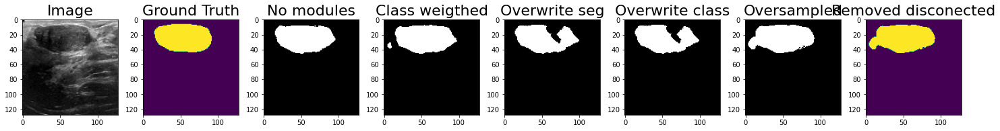

Patient:  357 			DICE:  0.936


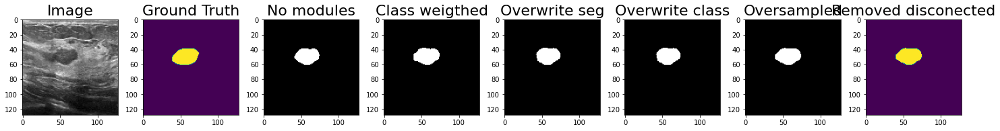

Patient:  358 			DICE:  0.817


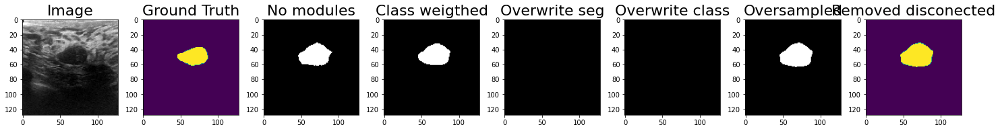

Patient:  359 			DICE:  0.327


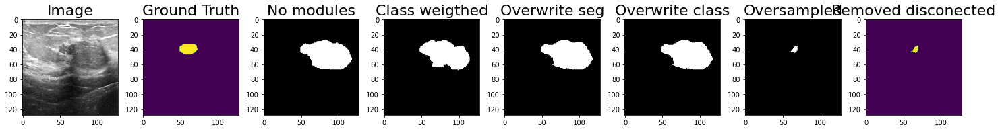

Patient:  360 			DICE:  0.628


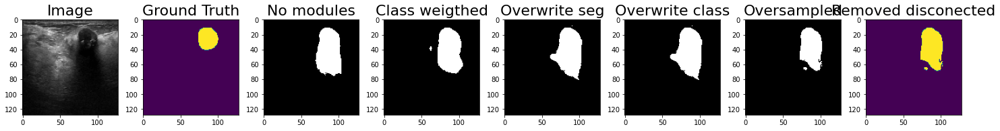

Patient:  361 			DICE:  0.915


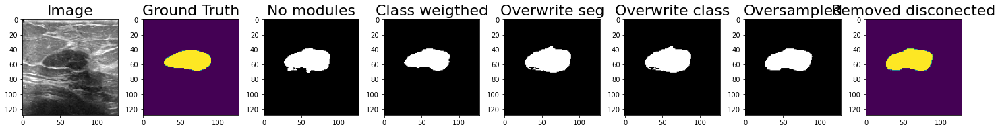

Patient:  362 			DICE:  0.892


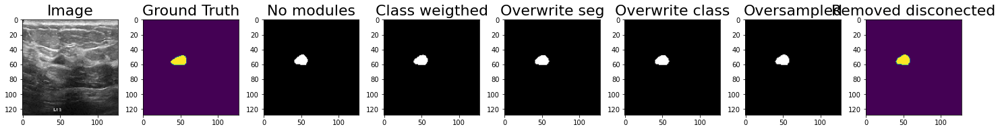

Patient:  363 			DICE:  0.896


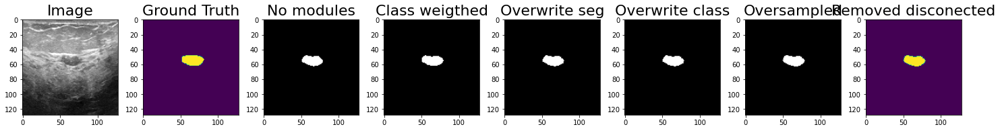

Patient:  364 			DICE:  0.871


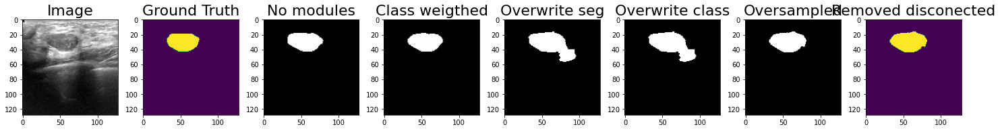

Patient:  365 			DICE:  0.954


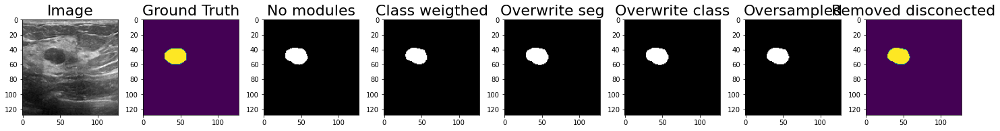

Patient:  366 			DICE:  0.91


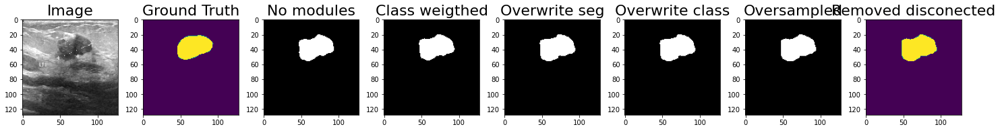

Patient:  367 			DICE:  0.0


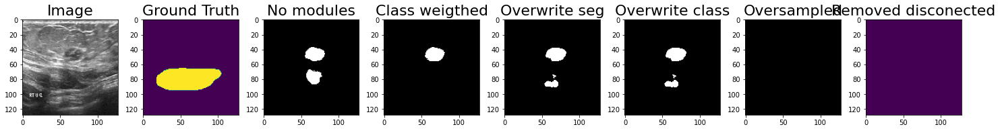

Patient:  368 			DICE:  0.93


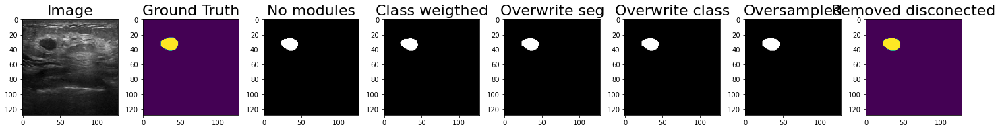

Patient:  369 			DICE:  0.907


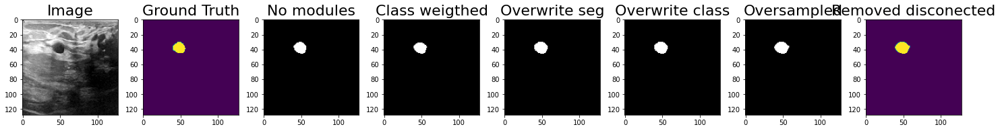

Patient:  370 			DICE:  0.931


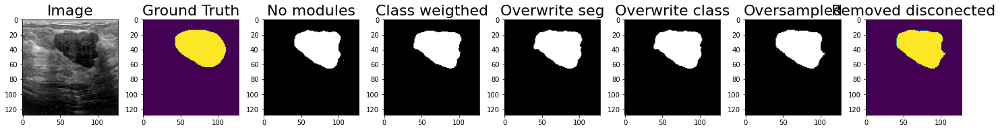

Patient:  371 			DICE:  0.366


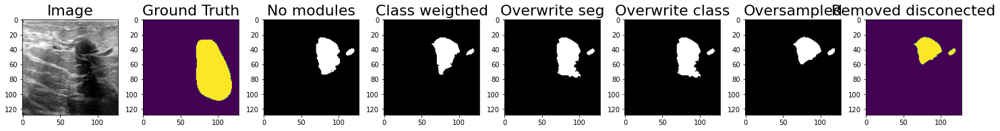

Patient:  372 			DICE:  0.948


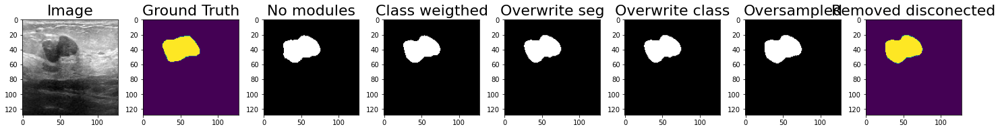

Patient:  373 			DICE:  0.839


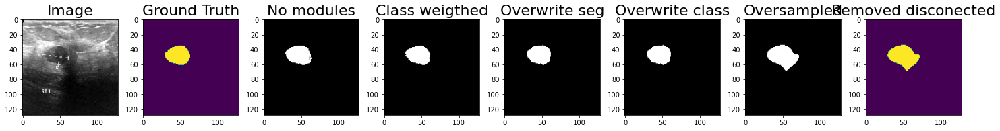

Patient:  374 			DICE:  0.819


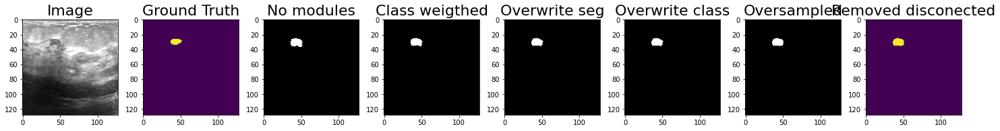

Patient:  375 			DICE:  0.911


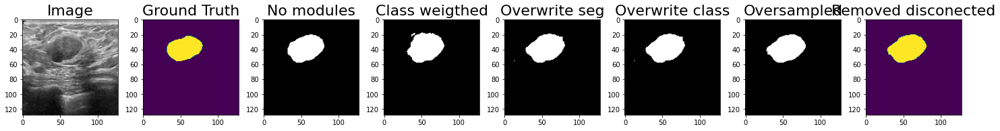

Patient:  376 			DICE:  0.931


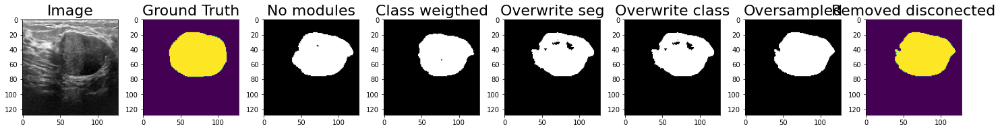

Patient:  377 			DICE:  0.0


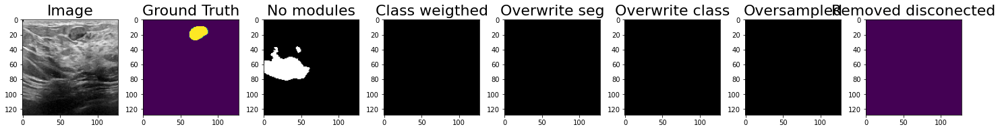

Patient:  378 			DICE:  0.944


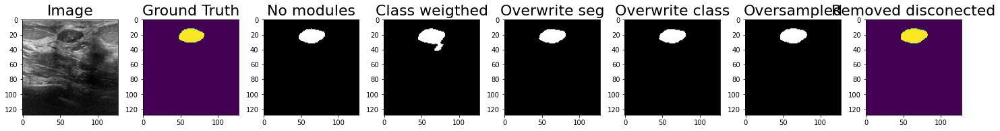

Patient:  379 			DICE:  0.0


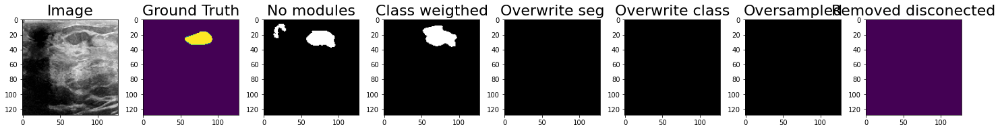

Patient:  380 			DICE:  0.92


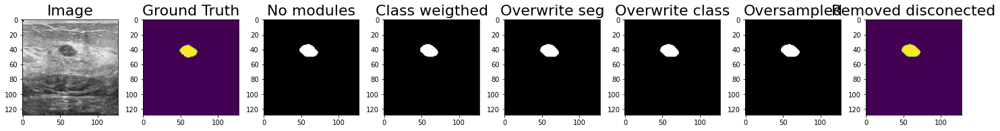

Patient:  381 			DICE:  0.955


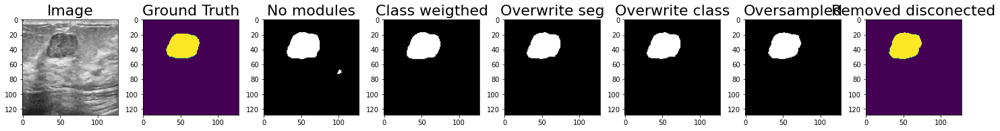

Patient:  382 			DICE:  0.516


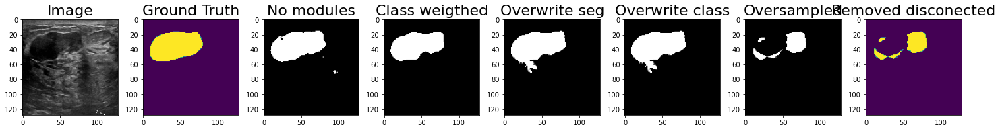

Patient:  383 			DICE:  0.811


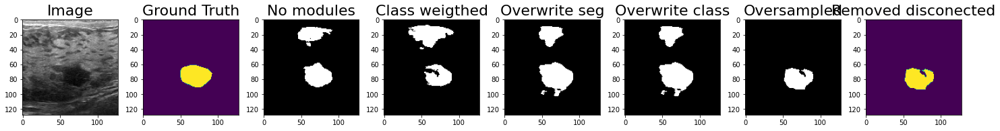

Patient:  384 			DICE:  0.413


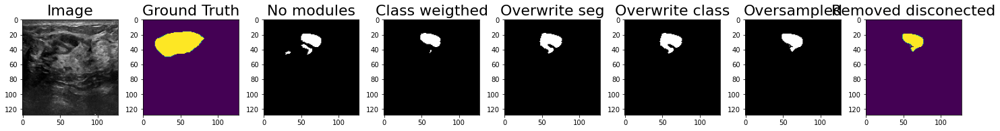

Patient:  385 			DICE:  0.935


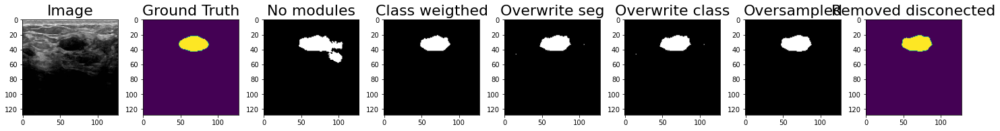

Patient:  386 			DICE:  0.937


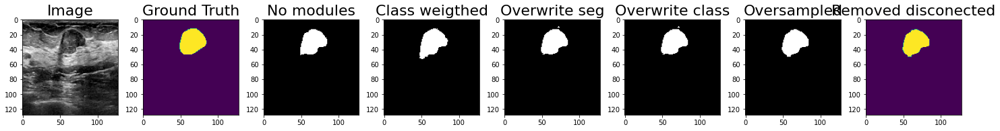

Patient:  387 			DICE:  0.958


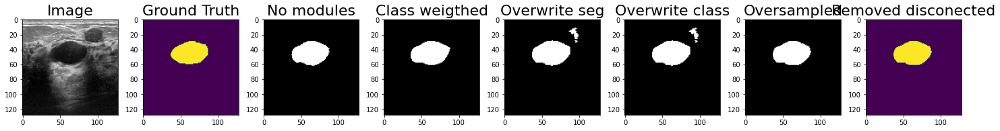

Patient:  388 			DICE:  0.912


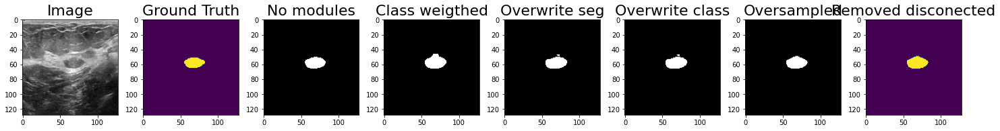

Patient:  389 			DICE:  0.908


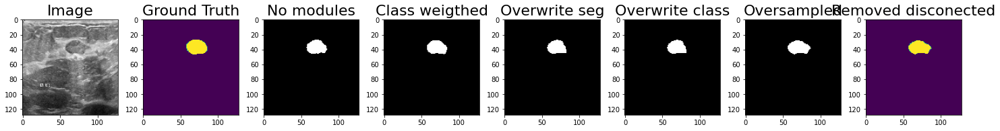

Patient:  390 			DICE:  0.955


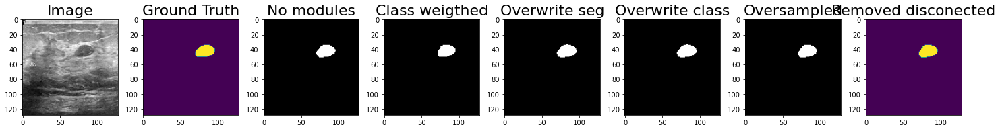

Patient:  391 			DICE:  0.627


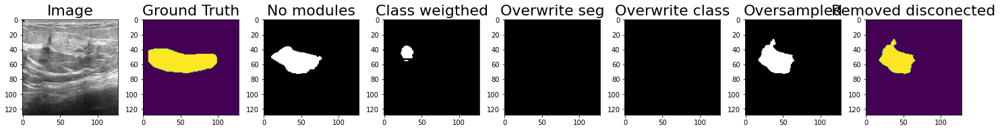

Patient:  392 			DICE:  0.134


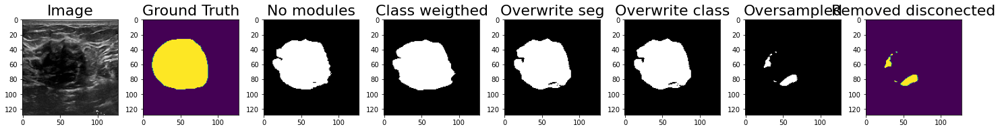

Patient:  393 			DICE:  0.821


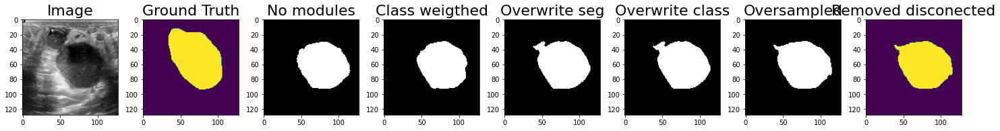

Patient:  394 			DICE:  0.0


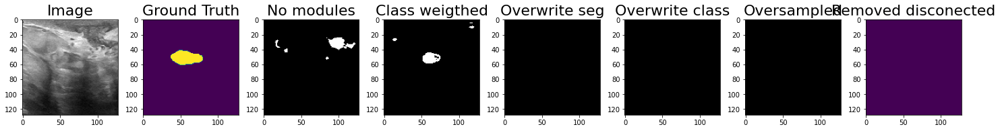

Patient:  397 			DICE:  0.938


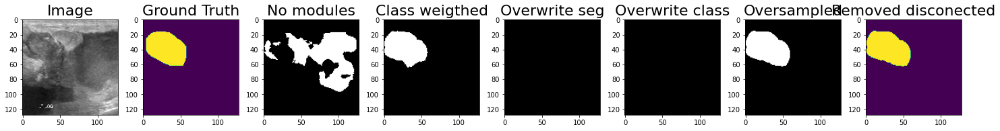

Patient:  398 			DICE:  0.0


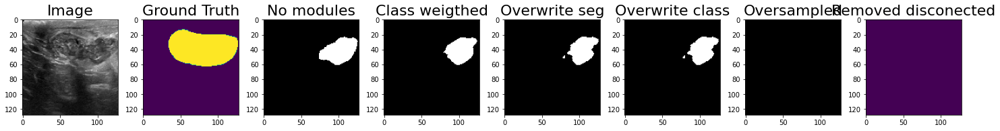

Patient:  401 			DICE:  0.848


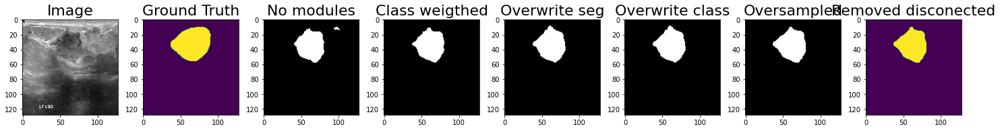

Patient:  402 			DICE:  0.0


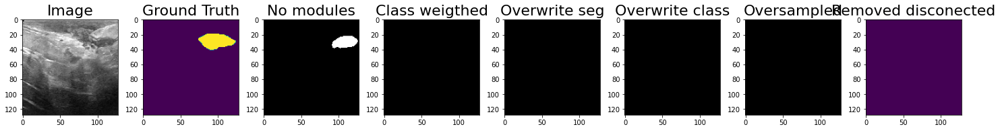

Patient:  403 			DICE:  0.938


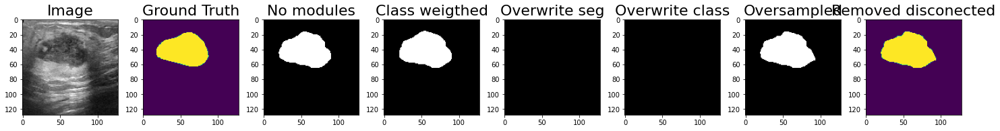

Patient:  405 			DICE:  0.082


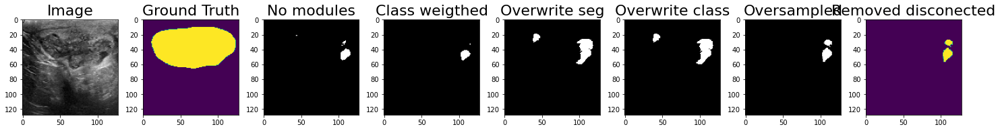

Patient:  407 			DICE:  0.0


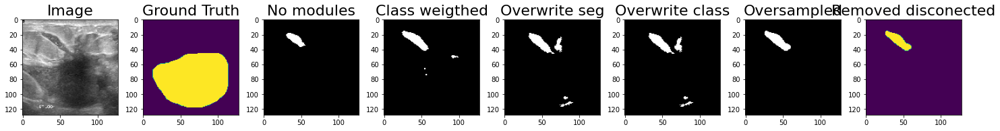

Patient:  408 			DICE:  0.0


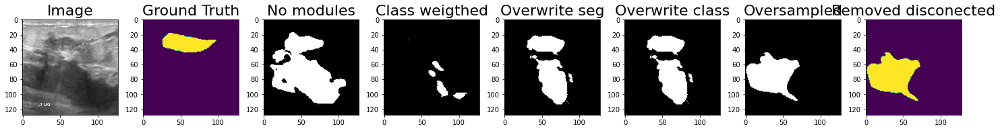

Patient:  409 			DICE:  0.569


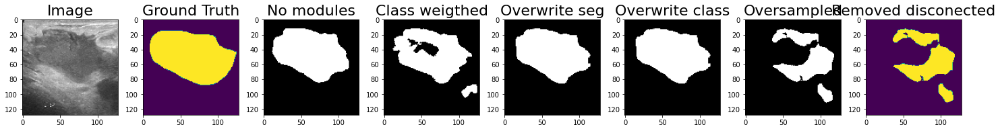

Patient:  410 			DICE:  0.86


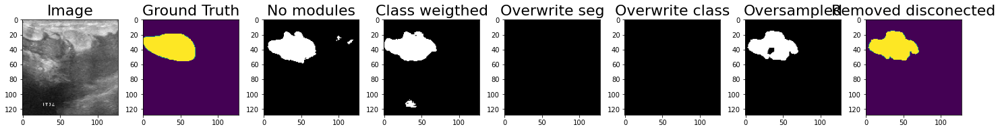

Patient:  414 			DICE:  0.0


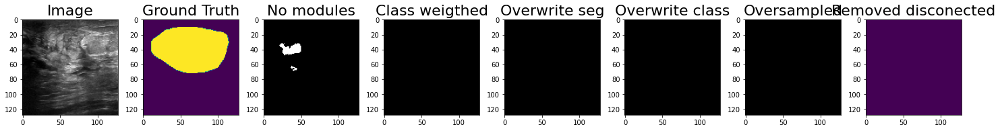

Patient:  416 			DICE:  0.0


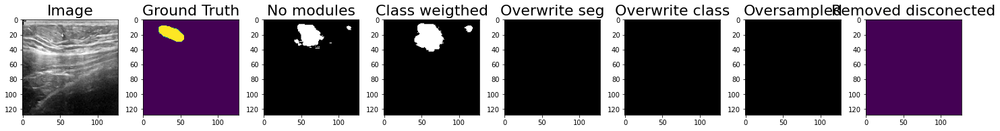

Patient:  417 			DICE:  0.884


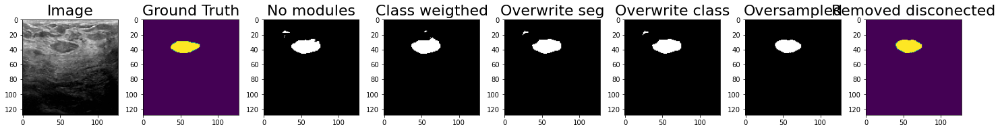

Patient:  418 			DICE:  0.883


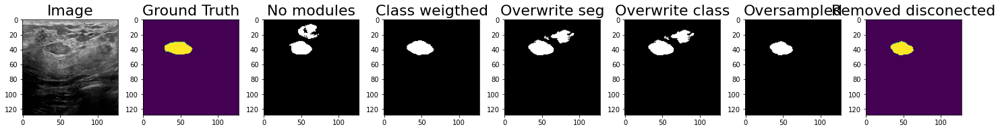

Patient:  420 			DICE:  0.865


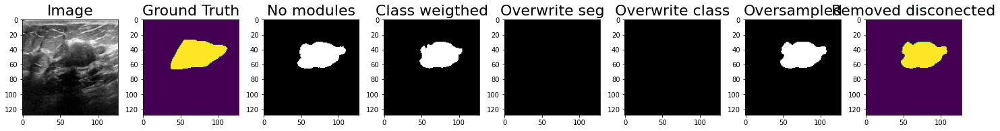

Patient:  427 			DICE:  0.403


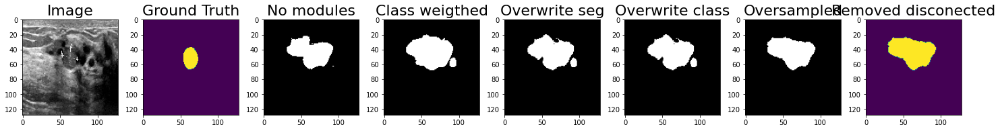

Patient:  428 			DICE:  0.0


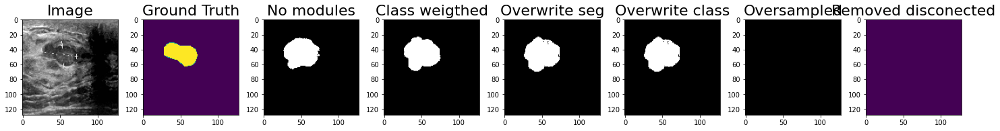

Patient:  429 			DICE:  0.87


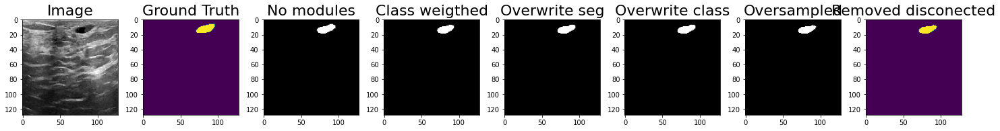

Patient:  430 			DICE:  0.849


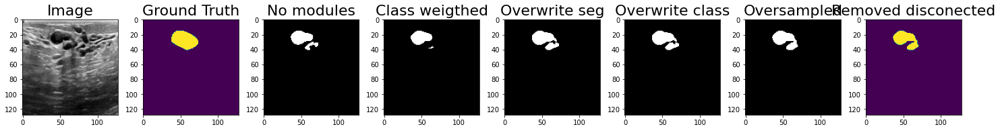

Patient:  431 			DICE:  0.916


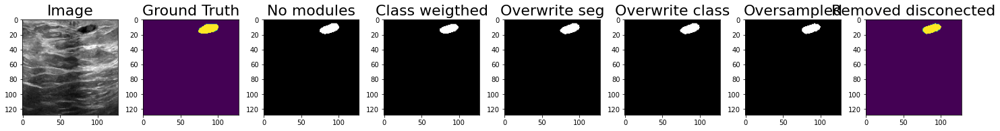

Patient:  432 			DICE:  0.96


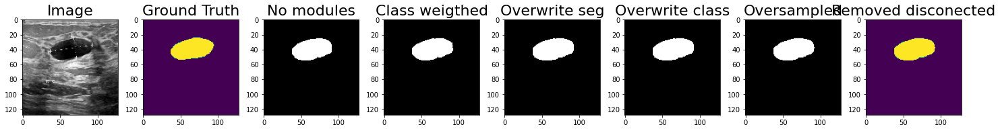

Patient:  434 			DICE:  0.954


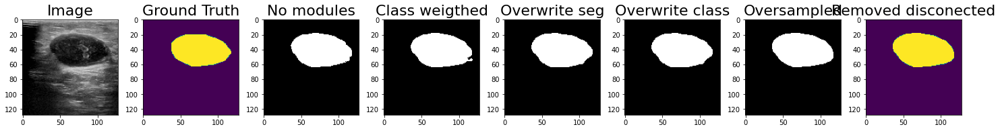

Patient:  435 			DICE:  0.823


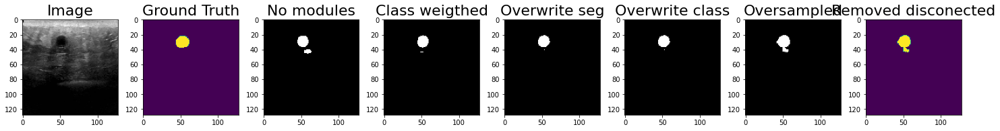

Patient:  436 			DICE:  0.807


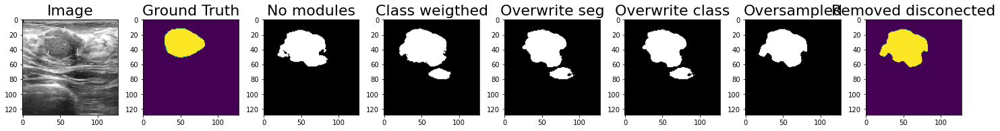

0.7339082634339192


In [122]:
from skimage import io, morphology

patient_type = 'benign'
result = []
for i in range(500):
    try:
        number = f'{i}'
        fold = load_config[(load_config.patient_id == int(number)) & (load_config["class"] == patient_type)]['fold'].values[0]
        image = cv2.imread(root_images + f"{patient_type}_id_{number}.png", 0)

        gt = cv2.imread(root_gt + f"{patient_type}_id_{number}_mask.png", 0)
        imgs = [image] + [gt] + [cv2.imread(root + exp + f"/fold_{fold}/segs/{patient_type}_{number}_seg.png") for exp in exps]
        filtered_image = fill_irregular_hole(imgs[-1][:, :, 0])

        imgs = imgs + [filtered_image]
        tp = float(np.sum(l_and(imgs[-2][:,:,0], gt)))
        tn = float(np.sum(l_and(l_not(imgs[-2][:,:,0]), l_not(gt))))
        fp = float(np.sum(l_and(imgs[-2][:,:,0], l_not(gt))))
        fn = float(np.sum(l_and(l_not(imgs[-2][:,:,0]), gt)))
        dice =  dice_score(tp, fp, fn, gt, imgs[-2][:,:,0])

        print("Patient: ", i, "\t\t\tDICE: ", round(dice, 3))
 
        plot_postprocessing(imgs)
        
        result.append(dice)
    except Exception as e:
        pass
print(np.mean(result))

# Cuantitativos

## Segmentation

In [36]:
exper1 = []
for i in range(4):
    data = pd.read_csv(f"runs/20231114_230901_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_segmentation.csv")
    data['fold'] = i
    exper1.append(data)
exper1 = pd.concat(exper1)

# grouped = exper1.groupby(['class', 'fold']).agg(np.nanmean).reset_index()
grouped = exper1.groupby(['class']).agg(np.nanmean).reset_index()
grouped

,class,patient_id,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision,fold
0,benign,220.391892,12.009513,0.780009,0.848940,0.984829,0.969796,0.698643,0.815393,1.490991
1,malignant,114.993902,15.889115,0.719293,0.717358,0.962728,0.925541,0.609252,0.811909,1.500000
2,normal,72.000000,NaN,0.000000,NaN,0.917883,0.917883,0.000000,NaN,1.500000


In [38]:
exper1[exper1["class"] == 'normal']

,patient_id,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision,class,fold
97,8,NaN,0.0,NaN,0.925354,0.925354,0.0,NaN,normal,0
98,16,NaN,0.0,NaN,0.987061,0.987061,0.0,NaN,normal,0
99,18,NaN,0.0,NaN,0.883057,0.883057,0.0,NaN,normal,0
100,75,NaN,0.0,NaN,0.974060,0.974060,0.0,NaN,normal,0
101,77,NaN,0.0,NaN,0.948486,0.948486,0.0,NaN,normal,0
...,...,...,...,...,...,...,...,...,...,...
107,109,NaN,0.0,NaN,0.915466,0.915466,0.0,NaN,normal,3
108,112,NaN,0.0,NaN,0.906250,0.906250,0.0,NaN,normal,3
109,113,NaN,0.0,NaN,0.846985,0.846985,0.0,NaN,normal,3
110,114,NaN,0.0,NaN,0.973816,0.973816,0.0,NaN,normal,3


In [131]:
exper2 = []
for i in range(4):
    data = pd.read_csv(f"runs/20231121_181739_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_segmentation.csv")
#     data = pd.read_csv(f"runs/20231120_231841_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_segmentation.csv")
    data['fold'] = i
    exper2.append(data)
exper2 = pd.concat(exper2)

grouped = exper2.groupby(['class', 'fold']).agg(np.nanmean).reset_index()
grouped = grouped.groupby(['class']).agg(np.nanmean).reset_index()
grouped

,class,fold,patient_id,Haussdorf distance,DICE,Sensitivity,Specificity,Accuracy,Jaccard index,Precision
0,benign,1.5,220.541315,5.716952,0.733859,0.861827,0.992065,0.968853,0.659427,0.877704
1,malignant,1.5,114.993902,14.012772,0.705276,0.721638,0.969626,0.927815,0.599976,0.841560
2,normal,1.5,72.000000,NaN,0.937500,NaN,0.996888,0.996888,0.937500,NaN


## Classification

In [133]:
exper1 = []
for i in range(4):
    data = pd.read_csv(f"runs/20231114_230901_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_classification.csv")
    data['fold'] = i
    exper1.append(data)
exper1 = pd.concat(exper1)
exper1
# grouped = exper1.groupby(['class', 'fold']).mean().reset_index()
# grouped = grouped.groupby(['class']).mean().reset_index()
# grouped

,patient_id,ground_truth,predicted_label,fold
0,23,0,0,0
1,26,0,0,0
2,27,0,0,0
3,29,0,0,0
4,34,0,0,0
...,...,...,...,...
107,109,2,2,3
108,112,2,1,3
109,113,2,1,3
110,114,2,2,3


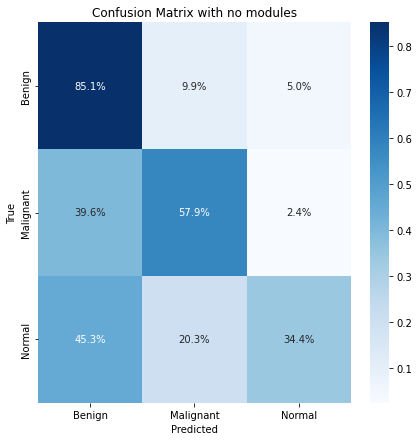

In [144]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Example DataFrame with y_true and y_pred columns containing non-encoded labels
data = {
    'y_true': exper1.ground_truth,
    'y_pred': exper1.predicted_label
}
df = pd.DataFrame(data)

# Compute the confusion matrix
cm = confusion_matrix(df['y_true'], df['y_pred'])

# Normalize the confusion matrix
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize along rows

# Plot the normalized confusion matrix
labels = ['Benign', 'Malignant', 'Normal']  # Class labels
plt.figure(figsize=(7, 7))
sns.heatmap(cm_normalized, annot=True, cmap='Blues', fmt='.1%', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix with no modules')
plt.show()

In [137]:
exper2 = []
for i in range(4):
    data = pd.read_csv(f"runs/20231121_181739_Multi_FSB_BTS_UNet_new_24_alpha_0.85_batch_2_benign_malignant_normal/fold_{i}/results_classification.csv")
    data['fold'] = i
    exper2.append(data)
exper2 = pd.concat(exper2)
exper2
# grouped = exper1.groupby(['class', 'fold']).mean().reset_index()
# grouped = grouped.groupby(['class']).mean().reset_index()
# grouped

,patient_id,ground_truth,predicted_label,fold
0,23,0,0,0
1,26,0,0,0
2,27,0,0,0
3,29,0,0,0
4,34,0,0,0
...,...,...,...,...
107,109,2,2,3
108,112,2,0,3
109,113,2,0,3
110,114,2,2,3


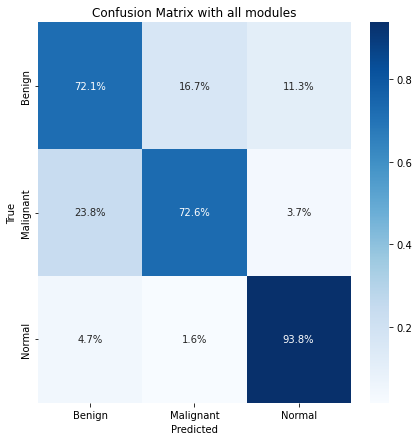

In [143]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Example DataFrame with y_true and y_pred columns containing non-encoded labels
data = {
    'y_true': exper2.ground_truth,
    'y_pred': exper2.predicted_label
}
df = pd.DataFrame(data)

# Compute the confusion matrix
cm = confusion_matrix(df['y_true'], df['y_pred'])

# Normalize the confusion matrix
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize along rows

# Plot the normalized confusion matrix
labels = ['Benign', 'Malignant', 'Normal']  # Class labels
plt.figure(figsize=(7, 7))
sns.heatmap(cm_normalized, annot=True, cmap='Blues', fmt='.1%', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix with all modules')
plt.show()